# MultiOmics RNA + ATAC for Chao dataset (MORNAATACC) technical documentation
## Multiomics RNAseq & ATACseq on EAE model

<hr>

**This notebook is the following of MORNAATACC_7 notebook**

<hr>

In [ ]:
#Memory needed for a full run : 256Gb

In [17]:
#Early1               = P21208_1003_EAE_ARC
#PeakCtrl2            = P21208_1004_EAE_ARC
#Peak2                = P21208_1005_EAE_ARC
#LateCtrl1            = MORNAATACC_1002 (P21520_1002)
#Late1                = MORNAATACC_1003 (P21520_1003)
#Early2               = P23605_1001
#EarlyCtrl2           = P23605_1002
#Peak3                = P23605_1003
#PeakCtrl3            = P23605_1004
#EarlyCtrl3           = P24115_1001
#EarlyFemale3         = P24115_1002
#EarlyMale3           = P24115_1003
#Late2                = P25316_1001
#LateCtrl2            = P25316_1002
#Late3                = P25316_1003
#LateCtrl3            = P25316_1004
#PeakMale4            = P27208_1001
#PeakFemale4          = P27208_1002
#LateMale4            = P27208_1003
#LateFemale4          = P27208_1004
#Naive1               = P26203_1003
#Naive2               = P26203_1004
#Peak5                = P29557_1001
#Late5                = P29557_1002
#Naive3               = P29557_1004
#EarlyCtrl4           = P29557_1005
#EarlyCtrlMale5       = P29557_1006
#EarlyCtrlFemale5     = P29557_1007
#Early4               = P29557_1008
#EarlyMale5           = P29557_1009
#EarlyFemale5         = P29557_1010

## 0. Environment status

In [1]:
%use

Subkernel,Kernel Name,Language,Language Module,Interpreter
Bash,bash,bash,sos_bash,/usr/bin/python3
Bash,calysto_bash,bash,sos_bash,python
Python3,python3,python,sos_python,python
R,ir,R,sos_r,/usr/lib/R/bin/R
SoS,sos,sos,,/usr/bin/python3


In [2]:
lsb_release -a

No LSB modules are available.
Distributor ID:	Ubuntu
Description:	Ubuntu 20.04 LTS
Release:	20.04
Codename:	focal


In [3]:
lscpu

Architecture:        x86_64
CPU op-mode(s):      32-bit, 64-bit
Byte Order:          Little Endian
Address sizes:       46 bits physical, 48 bits virtual
CPU(s):              16
On-line CPU(s) list: 0-15
Thread(s) per core:  1
Core(s) per socket:  8
Socket(s):           2
NUMA node(s):        2
Vendor ID:           GenuineIntel
CPU family:          6
Model:               63
Model name:          Intel(R) Xeon(R) CPU E5-2630 v3 @ 2.40GHz
Stepping:            2
CPU MHz:             1206.591
CPU max MHz:         3200.0000
CPU min MHz:         1200.0000
BogoMIPS:            4799.57
Virtualization:      VT-x
L1d cache:           512 KiB
L1i cache:           512 KiB
L2 cache:            4 MiB
L3 cache:            40 MiB
NUMA node0 CPU(s):   0-7
NUMA node1 CPU(s):   8-15
Flags:               fpu vme de pse tsc msr pae mce cx8 apic sep mtrr pge mca cm
                     ov pat pse36 clflush dts acpi mmx fxsr sse sse2 ss ht tm pb
                     e syscall nx pdpe1gb rdtscp lm constant_tsc

In [4]:
grep MemTotal /proc/meminfo | awk '{print $2 / 1024}'

257675


In [5]:
apt list --installed

Listing... Done
adduser/focal,now 3.118ubuntu2 all [installed]
apt-transport-https/focal-security,now 2.0.2ubuntu0.2 all [installed]
apt/focal-security,now 2.0.2ubuntu0.2 amd64 [installed]
autoconf/focal,now 2.69-11.1 all [installed,automatic]
automake/focal,now 1:1.16.1-4ubuntu6 all [installed,automatic]
autotools-dev/focal,now 20180224.1 all [installed,automatic]
base-files/focal,now 11ubuntu5 amd64 [installed]
base-passwd/focal,now 3.5.47 amd64 [installed]
bash/focal,now 5.0-6ubuntu1 amd64 [installed,upgradable to: 5.0-6ubuntu1.2]
binutils-common/focal-security,now 2.34-6ubuntu1.3 amd64 [installed,automatic]
binutils-x86-64-linux-gnu/focal-security,now 2.34-6ubuntu1.3 amd64 [installed,automatic]
binutils/focal-security,now 2.34-6ubuntu1.3 amd64 [installed,automatic]
bsdutils/focal,now 1:2.34-0.1ubuntu9 amd64 [installed,upgradable to: 1:2.34-0.1ubuntu9.3]
build-essential/focal,now 12.8ubuntu1 amd64 [installed]
bzip2/focal,now 1.0.8-2 amd64 [installed,automatic]
ca-certificates-java/f

In [7]:
pip list

Package              Version             
-------------------- --------------------
anndata              0.8.0               
ansiwrap             0.8.4               
anyio                3.6.1               
argon2-cffi          21.3.0              
argon2-cffi-bindings 21.2.0              
asttokens            2.0.5               
attrs                21.4.0              
Babel                2.10.3              
backcall             0.2.0               
bash-kernel          0.7.2               
beautifulsoup4       4.11.1              
bleach               5.0.1               
calysto-bash         0.2.2               
certifi              2019.11.28          
cffi                 1.15.1              
chardet              3.0.4               
click                8.1.3               
cycler               0.11.0              
Cython               0.29.26             
dbus-python          1.2.16              
debugpy              1.6.0               
decorator            5.1.1        

In [8]:
jupyter --version

Selected Jupyter core packages...
IPython          : 8.4.0
ipykernel        : 6.15.0
ipywidgets       : 7.7.1
jupyter_client   : 7.3.4
jupyter_core     : 4.10.0
jupyter_server   : 1.17.0
jupyterlab       : 3.1.17
nbclient         : 0.5.13
nbconvert        : 6.4.4
nbformat         : 5.4.0
notebook         : 6.4.12
qtconsole        : 5.3.1
traitlets        : 5.3.0


In [1]:
#conda env export -n jupyter

## 1. Loading environments

### 1.1 R Packages

In [1]:
library(Seurat)
library(Signac)
library(EnsDb.Mmusculus.v79)
library(BSgenome.Mmusculus.UCSC.mm10)
library(dplyr)
library(stringr)
library(harmony)
library(clustree)
library(data.table)
library(biomaRt)
library(cowplot)
library(randomForest)
library(mlbench)
library(caret)
library(e1071)
library(ggplot2)
library(tidyverse)
library(pheatmap)
library(grid)
library(gridExtra)
library(patchwork)
library(biovizBase)
library(ggrepel)
library(viridis)
library(reshape2)
library(hues)
library(clusterProfiler)
library(org.Mm.eg.db)
library(ggnewscale)
library(circlize)
library(scales)
library(lisi)
library(corrplot)

#Multicore
library(future)

#conda dependencies trouble
library(enrichplot)
library(ReactomePA)

#Doublet determination
library(DoubletFinder)

library(textclean)
library(mclust)

#ArchR
library(ArchR)
library(TxDb.Mmusculus.UCSC.mm10.knownGene)

library(muscat)
library(SingleCellExperiment)
library(scater)
library(cowplot)
library(UpSetR)
library(limma)
library(Matrix.utils)
library(purrr)
library(DESeq2)
library(EnhancedVolcano)

Loading required package: SeuratObject

Loading required package: sp


Attaching package: ‘SeuratObject’


The following object is masked from ‘package:base’:

    intersect


Loading required package: ensembldb

Loading required package: BiocGenerics


Attaching package: ‘BiocGenerics’


The following object is masked from ‘package:SeuratObject’:

    intersect


The following objects are masked from ‘package:stats’:

    IQR, mad, sd, var, xtabs


The following objects are masked from ‘package:base’:

    Filter, Find, Map, Position, Reduce, anyDuplicated, aperm, append,
    as.data.frame, basename, cbind, colnames, dirname, do.call,
    duplicated, eval, evalq, get, grep, grepl, intersect, is.unsorted,
    lapply, mapply, match, mget, order, paste, pmax, pmax.int, pmin,
    pmin.int, rank, rbind, rownames, sapply, setdiff, sort, table,
    tapply, union, unique, unsplit, which.max, which.min


Loading required package: GenomicRanges

Loading required package: stats4

Loading require

In [2]:
sessionInfo()

R version 4.3.2 (2023-10-31)
Platform: x86_64-pc-linux-gnu (64-bit)
Running under: Ubuntu 22.04 LTS

Matrix products: default
BLAS:   /usr/lib/x86_64-linux-gnu/blas/libblas.so.3.10.0 
LAPACK: /usr/lib/x86_64-linux-gnu/lapack/liblapack.so.3.10.0

locale:
 [1] LC_CTYPE=C.UTF-8    LC_NUMERIC=C        LC_TIME=C          
 [4] LC_COLLATE=C        LC_MONETARY=C       LC_MESSAGES=C      
 [7] LC_PAPER=C          LC_NAME=C           LC_ADDRESS=C       
[10] LC_TELEPHONE=C      LC_MEASUREMENT=C    LC_IDENTIFICATION=C

time zone: Etc/UTC
tzcode source: system (glibc)

attached base packages:
[1] grid      stats4    stats     graphics  grDevices utils     datasets 
[8] methods   base     

other attached packages:
 [1] EnhancedVolcano_1.20.0                   
 [2] DESeq2_1.42.1                            
 [3] Matrix.utils_0.9.8                       
 [4] limma_3.58.1                             
 [5] UpSetR_1.4.0                             
 [6] scater_1.30.1                            
 [7] 

### 1.2 Functions

In [3]:
PrctCellExpringGene <- function(object, genes, group.by = "all"){
    if(group.by == "all"){
        prct = unlist(lapply(genes,calc_helper, object=object))
        result = data.frame(Markers = genes, Cell_proportion = prct)
        return(result)
    }

    else{        
        list = SplitObject(object, group.by)
        factors = names(list)

        results = lapply(list, PrctCellExpringGene, genes=genes)
        for(i in 1:length(factors)){
        results[[i]]$Feature = factors[i]
        }
        combined = do.call("rbind", results)
        return(combined)
    }
}

calc_helper <- function(object,genes){
    counts = object[['RNA']]@counts
    ncells = ncol(counts)
    if(genes %in% row.names(counts)){
    sum(counts[genes,]>0)/ncells
    }else{return(NA)}
}

NbCellExpringGene <- function(object, genes, group.by = "all"){
    if(group.by == "all"){
        nb = unlist(lapply(genes,calc_helper_nb, object=object))
        result = data.frame(Markers = genes, Cell_nb = nb)
        return(result)
    }

    else{        
        list = SplitObject(object, group.by)
        factors = names(list)

        results = lapply(list, NbCellExpringGene, genes=genes)
        for(i in 1:length(factors)){
        results[[i]]$Feature = factors[i]
        }
        combined = do.call("rbind", results)
        return(combined)
    }
}

calc_helper_nb <- function(object,genes){
    counts = object[['RNA']]@counts
    if(genes %in% row.names(counts)){
    length(counts[genes,][counts[genes,] > 0])
    }else{return(NA)}
}

DoMultiBarHeatmap <- function (object, features = NULL, cells = NULL, group.by = "ident", additional.group.by = NULL, additional.group.sort.by = NULL,  cols.use = NULL, group.bar = TRUE, disp.min = -2.5, disp.max = NULL, layer = "scale.data", assay = NULL, label = TRUE, size = 5.5, hjust = 0, angle = 45, raster = TRUE, draw.lines = TRUE, lines.width = NULL, group.bar.height = 0.02, combine = TRUE){

  cells <- cells %||% colnames(x = object)
  if (is.numeric(x = cells)) {
    cells <- colnames(x = object)[cells]
  }
  assay <- assay %||% DefaultAssay(object = object)
  DefaultAssay(object = object) <- assay
  features <- features %||% VariableFeatures(object = object)
  ## Why reverse???
  features <- rev(x = unique(x = features))
  disp.max <- disp.max %||% ifelse(test = layer == "scale.data", yes = 2.5, no = 6)
  possible.features <- rownames(x = LayerData(object = object, assay = assay, layer = layer))
  if (any(!features %in% possible.features)) {
    bad.features <- features[!features %in% possible.features]
    features <- features[features %in% possible.features]
    if (length(x = features) == 0) {
      stop("No requested features found in the ", layer,
      " slot for the ", assay, " assay.")
    }
    warning("The following features were omitted as they were not found in the ", layer, " slot for the ", assay, " assay: ", paste(bad.features, collapse = ", "))
  }

  if (!is.null(additional.group.sort.by)) {
    if (any(!additional.group.sort.by %in% additional.group.by)) {
      bad.sorts <- additional.group.sort.by[!additional.group.sort.by %in% additional.group.by]
      additional.group.sort.by <- additional.group.sort.by[additional.group.sort.by %in% additional.group.by]
      if (length(x = bad.sorts) > 0) {
        warning("The following additional sorts were omitted as they were not a subset of additional.group.by : ",
        paste(bad.sorts, collapse = ", "))
      }
    }
  }

  data <- as.data.frame(x = as.matrix(x = t(x = LayerData(object = object, assay = assay, layer = layer)[features, cells, drop = FALSE])))

  object <- suppressMessages(expr = StashIdent(object = object, save.name = "ident"))
  group.by <- group.by %||% "ident"
  groups.use <- object[[c(group.by, additional.group.by[!additional.group.by %in% group.by])]][cells, , drop = FALSE]
  plots <- list()
  for (i in group.by) {
    data.group <- data
    if (!is.null(additional.group.by)) {
      additional.group.use <- additional.group.by[additional.group.by!=i]
      if (!is.null(additional.group.sort.by)){
        additional.sort.use = additional.group.sort.by[additional.group.sort.by != i]
      } else {
        additional.sort.use = NULL
      }
    } else {
      additional.group.use = NULL
      additional.sort.use = NULL
    }

    group.use <- groups.use[, c(i, additional.group.use), drop = FALSE]

    for(colname in colnames(group.use)){
      if (!is.factor(x = group.use[[colname]])) {
        group.use[[colname]] <- factor(x = group.use[[colname]])
      }
    }

    if (draw.lines) {
      lines.width <- lines.width %||% ceiling(x = nrow(x = data.group) * 0.0025)
      placeholder.cells <- sapply(X = 1:(length(x = levels(x = group.use[[i]])) * lines.width), FUN = function(x) {
        return(Seurat:::RandomName(length = 20))
      })
      placeholder.groups <- data.frame(rep(x = levels(x = group.use[[i]]), times = lines.width))
      group.levels <- list()
      group.levels[[i]] = levels(x = group.use[[i]])
      for (j in additional.group.use) {
        group.levels[[j]] <- levels(x = group.use[[j]])
        placeholder.groups[[j]] = NA
      }

      colnames(placeholder.groups) <- colnames(group.use)
      rownames(placeholder.groups) <- placeholder.cells

      group.use <- sapply(group.use, as.vector)
      rownames(x = group.use) <- cells

      group.use <- rbind(group.use, placeholder.groups)

      for (j in names(group.levels)) {
        group.use[[j]] <- factor(x = group.use[[j]], levels = group.levels[[j]])
      }

      na.data.group <- matrix(data = NA, nrow = length(x = placeholder.cells), ncol = ncol(x = data.group), dimnames = list(placeholder.cells, colnames(x = data.group)))
      data.group <- rbind(data.group, na.data.group)
    }

    order_expr <- paste0('order(', paste(c(i, additional.sort.use), collapse=','), ')')
    group.use = with(group.use, group.use[eval(parse(text=order_expr)), , drop=F])

    plot <- Seurat:::SingleRasterMap(data = data.group, raster = raster, disp.min = disp.min, disp.max = disp.max, feature.order = features, cell.order = rownames(x = group.use), group.by = group.use[[i]])

    if (group.bar) {
      pbuild <- ggplot_build(plot = plot)
      group.use2 <- group.use
      cols <- list()
      na.group <- Seurat:::RandomName(length = 20)
      for (colname in rev(x = colnames(group.use2))) {
        if (colname == i) {
          colid = paste0('Identity (', colname, ')')
        } else {
          colid = colname
        }

        # Default
        cols[[colname]] <- c(scales::hue_pal()(length(x = levels(x = group.use[[colname]]))))

        #Overwrite if better value is provided
        if (!is.null(cols.use[[colname]])) {
          req_length = length(x = levels(group.use))
          if (length(cols.use[[colname]]) < req_length){
            warning("Cannot use provided colors for ", colname, " since there aren't enough colors.")
          } else {
            if (!is.null(names(cols.use[[colname]]))) {
              if (all(levels(group.use[[colname]]) %in% names(cols.use[[colname]]))) {
                cols[[colname]] <- as.vector(cols.use[[colname]][levels(group.use[[colname]])])
              } else {
                warning("Cannot use provided colors for ", colname, " since all levels (", paste(levels(group.use[[colname]]), collapse=","), ") are not represented.")
              }
            } else {
              cols[[colname]] <- as.vector(cols.use[[colname]])[c(1:length(x = levels(x = group.use[[colname]])))]
            }
          }
        }

        # Add white if there's lines
        if (draw.lines) {
          levels(x = group.use2[[colname]]) <- c(levels(x = group.use2[[colname]]), na.group)
          group.use2[placeholder.cells, colname] <- na.group
          cols[[colname]] <- c(cols[[colname]], "#FFFFFF")
        }
        names(x = cols[[colname]]) <- levels(x = group.use2[[colname]])

        y.range <- diff(x = pbuild$layout$panel_params[[1]]$y.range)
        y.pos <- max(pbuild$layout$panel_params[[1]]$y.range) + y.range * 0.015
        y.max <- y.pos + group.bar.height * y.range
        pbuild$layout$panel_params[[1]]$y.range <- c(pbuild$layout$panel_params[[1]]$y.range[1], y.max)

        plot <- suppressMessages(plot +
          annotation_raster(raster = t(x = cols[[colname]][group.use2[[colname]]]),  xmin = -Inf, xmax = Inf, ymin = y.pos, ymax = y.max) +
          annotation_custom(grob = grid::textGrob(label = colid, hjust = 0, gp = gpar(cex = 0.75)), ymin = mean(c(y.pos, y.max)), ymax = mean(c(y.pos, y.max)), xmin = Inf, xmax = Inf) +
          coord_cartesian(ylim = c(0, y.max), clip = "off")
        )


        if ((colname == i) && label) {
          x.max <- max(pbuild$layout$panel_params[[1]]$x.range)
          x.divs <- pbuild$layout$panel_params[[1]]$x.major %||% pbuild$layout$panel_params[[1]]$x$break_positions()
          group.use$x <- x.divs

          label.x.pos <- tapply(X = group.use$x, INDEX = group.use[[colname]], FUN = median) * x.max
          label.x.pos <- data.frame(group = names(x = label.x.pos), label.x.pos)
          plot <- plot + geom_text(stat = "identity", data = label.x.pos, aes_string(label = "group", x = "label.x.pos"), y = y.max + y.max *  0.03 * 0.5, angle = angle, hjust = hjust, size = size)
          plot <- suppressMessages(plot + coord_cartesian(ylim = c(0, y.max + y.max * 0.002 * max(nchar(x = levels(x = group.use[[colname]]))) * size), clip = "off"))
        }
      }
    }
    plot <- plot + theme(line = element_blank())
    plots[[i]] <- plot
  }
  if (combine) {
    plots <- CombinePlots(plots = plots)
  }
  return(plots)
}

#####################################################
# Function for getting the marker peaks from the Seurat
# object, based on the current ident
#####################################################
getMarkerPeaks <- function(obj, doublets, n_peaks = 100, min_cells = 200){

  n_clusters = length(unique(as.vector(Idents(obj))))
  
  cells <- Cells(obj)
  
  # remove the doublet cells for better marker peaks
  obj <- subset(obj, cells = cells[!cells %in% doublets])
  
  obj@assays$ATAC@data@x <- obj@assays$ATAC@counts@x
  
  # default preporcessing o Signac applied
  obj <- RunTFIDF(obj, verbose = F)
  obj <- FindTopFeatures(obj, min.cutoff = NULL, verbose = F)
  obj <- RunSVD(
    object = obj,
    reduction.key = 'SVD_',
    reduction.name = 'svd',
    seed.use = 1,
    verbose = F
  )
  
  # get the marker peaks between all clusters
  da_peaks <- FindAllMarkers(
    object = obj,
    slot = "data",
    min.pct = 0.1,
    only.pos = TRUE,
    test.use = 'LR',
    min.cells.group = min_cells,
    verbose = F
  )
  
  # only keep the significant peaks
  metadata = lapply(unique(da_peaks$cluster), function(x){
    return(data.frame(da_peaks[da_peaks$p_val_adj < 0.05 & da_peaks$cluster == x,]))
  })
  
  names(metadata) <- paste0("Cluster_", unique(da_peaks$cluster))
  
  rm(da_peaks)
  
  meta_peaks = data.frame()
  
  for (i in names(metadata)) {
    
    cur_meta = data.frame(metadata[[i]])
    cur_meta$peaks = row.names(metadata[[i]])
    cur_meta$cluster = i
    row.names(cur_meta) = c()
    
    meta_peaks = rbind(meta_peaks, cur_meta)
    
    rm(cur_meta)
    
  }
  
  # sort the peaks based on the fold changes and signifigance, choose ones with high FC first
  meta_peaks = meta_peaks[order(meta_peaks$avg_logFC, -meta_peaks$p_val_adj, decreasing = T),]
  
  marker_peaks_set = data.frame(matrix(ncol=2,nrow=0, dimnames=list(NULL, c("gene", "cluster"))))
  
  # extract 100 marker peaks for each cluster
  while(nrow(marker_peaks_set) < n_peaks*n_clusters) {
    
    temp = meta_peaks[1, c("gene", "cluster")]
    
    marker_peaks_set = rbind(marker_peaks_set, temp)
    
    meta_peaks = meta_peaks[which(meta_peaks$gene != temp$gene),]
    
    if(length(which(marker_peaks_set$cluster == temp$cluster)) == n_peaks){
      meta_peaks = meta_peaks[which(meta_peaks$cluster != temp$cluster),]
    }
    
    rm(temp)
  }
  
  marker_peaks_set = marker_peaks_set[!is.na(marker_peaks_set$gene),]
  
  marker_peaks_set$cluster= factor(marker_peaks_set$cluster, levels = str_sort(unique(marker_peaks_set$cluster), numeric = T))
  marker_peaks_set = marker_peaks_set[order(marker_peaks_set$cluster),]
  
  rm(meta_peaks)
  
  colnames(marker_peaks_set)[1]<- "peaks"
  
  return(marker_peaks_set)
}

############################################
# get the readcount distribution profile for
# the singlet cells of every cluster
############################################
annotateDoublets <- function(obj, marker_peaks, doublets, k = 15){

  # get the read count distributions on the cluster specific marker peaks for all of the cells
  cell.values <- getCellValues(obj, cells = Cells(obj), marker_peaks_set = marker_peaks, doublets = doublets, k = k)
  
  #get the profile for the singlet cells of each cluster
  singlet.profile <- getProfiles(cell.values)
 
  # just annotate the doublets
  doublets <- cell.values %>% 
    subset(doublet == "doublet")
  
  clusters <- doublets %>% dplyr::select(starts_with("Cluster_")) %>% colnames()
  
  # look at every cluster in the data
  a.class <- lapply(clusters, function(clus){
    
    # just select the doublets that have the current cluster
    # as its most dominant cluster
    t.doublets <- doublets %>%
      subset(a.homotypic == clus, select = clusters)
    
    # get the profile of the current cluster
    t.profile <- singlet.profile[,clus]
    
    # calculate the distance of doublet cell distributions to
    # the profile of the current cluster
    t.dist <- apply(t.doublets, 1, function(cell){
      return(dist(rbind(cell, t.profile)))
    })
    
    # fit a GMM using the mclust package with no class limitations
    fit <- Mclust(t.dist, verbose = F)
    t.class <- fit$classification
    
    t.doublets$dist <- t.dist[rownames(t.doublets)]
    t.doublets$class <- t.class[rownames(t.doublets)]
    t.doublets$max.class <- names(which.max(fit[["parameters"]][["mean"]]))
    t.doublets$num.class <- length(unique(fit$classification))
    return(t.doublets[,c("dist", "class", "max.class", "num.class")])
  }) %>% bind_rows()
  
  doublets$class <- a.class[rownames(doublets),"class"]
  doublets$max.class <- a.class[rownames(doublets),"max.class"]
  doublets$num.class <- a.class[rownames(doublets),"num.class"]
  
  doublets <- lapply(rownames(doublets), function(cell){
    probs <- doublets[cell, clusters]
    
    # only classify the doublets that belong to the final class 
    # doublets[cell,"type"] <- ifelse(doublets[cell,"class"]== doublets[cell,"max.class"], "heterotypic", "homotypic")
    doublets[cell,"d.type"] <- ifelse(doublets[cell,"class"]== doublets[cell,"max.class"] & doublets[cell,"num.class"] > 1,
                                    "heterotypic", "homotypic")
    
    # report the top clusters based on type of the doublet; if homotypic just one, if heterotypic top 2 clusters
    doublets[cell, "d.annotation"] <- ifelse(doublets[cell,"d.type"] == "homotypic",
                                             names(probs)[order(probs, decreasing = T)[1]],
                                             paste(sort(names(probs)[order(probs, decreasing = T)[1:2]]), collapse = ".")) 
    
    return(doublets[cell,!(colnames(doublets) %in% c("a.heterotypic", "a.homotypic", "ident", "class", "max.class","num.class")), drop = FALSE])
  }) %>% bind_rows()

  return(doublets)
}

#####################################################
# Function to get the ditsribution of read counts on
# the marker peaks of clusters
#####################################################
getReadCountDistributions <- function(marker_peaks, read_counts){
  
  t_read_counts = data.frame(merge(marker_peaks, 100*read_counts, by.x = "peaks", by.y = 0, sort = F))
  names(t_read_counts) <- sub("^X", "", names(t_read_counts))
  t_read_counts$ids = unclass(t_read_counts$cluster)
  
  probs = matrix(nrow = ncol(read_counts), ncol = length(unique(t_read_counts$cluster)))
  
  row.names(probs) <- colnames(read_counts)
  colnames(probs) <- unique(t_read_counts$cluster)
  
  for (i in 1:nrow(probs)) {
    density_data = vector()
    
    for(j in 1:nrow(t_read_counts))
      density_data = c(density_data, rep(t_read_counts$ids[j], t_read_counts[j,row.names(probs)[i]]))
    
    for(j in 1:ncol(probs)){
      if(j==1)
        probs[i,j] = ecdf(density_data)(j)
      else
        probs[i,j] = (ecdf(density_data)(j) - ecdf(density_data)((j-1)))
    }
    
  }
  
  return(data.frame(probs))
}

#####################################################
# Function to plot the read count distributions of
# the given cells
#####################################################
plotReadCountDistributions <- function(probs, folder_path){
  
  if(!dir.exists(folder_path))
    dir.create(folder_path)
  
  sapply(rownames(probs), function(x){long_probs = gather(as.data.frame(bind_rows(probs[x,])), cell_type, probability, factor_key = TRUE)
  ggplot(data=long_probs, aes(x=cell_type, y=probability)) +
    geom_col() +
    theme(axis.text.x = element_text(angle = 90)) +
    ggtitle(x) + xlab("Cluster") + ylab("Score") + ylim(0,1) +
    ggsave(filename = paste0(folder_path, "/Probs_", x, ".pdf"))})
  
}

#####################################################
# Function to add read count distributions for the 
# cells in the provided in te Seurat object with the
# provided marker peaks
#####################################################
getCellValues <- function(obj, cells, marker_peaks_set, doublets, k = 15){
  
  obj@assays$ATAC@data@x <- obj@assays$ATAC@counts@x
  
  obj <- RunTFIDF(obj, verbose = F)
  obj <- FindTopFeatures(obj, min.cutoff = NULL, verbose = F)
  obj <- RunSVD(
    object = obj,
    reduction.key = 'SVD_',
    reduction.name = 'svd',
    seed.use = 1,
    verbose = F
  )
  
  # get the neighbor graph of the cells for aggregation
  obj <- FindNeighbors(obj, reduction = "svd", dims = 1:50, k.param = k+1, verbose = F)
  
  cell_annotations <- lapply(cells, function(cell){
    
    # extract the k neighbors of the current cell
    neighbors <- names(obj@graphs$ATAC_nn[cell, obj@graphs$ATAC_nn[cell,] > 0])
    
    # extract the reads for the cell and its k-nearest neighbors
    reads <- Matrix::as.matrix(subset(obj, cells = neighbors, features = marker_peaks_set$peaks)@assays[["ATAC"]]@counts)
    
    no_clusters <- length(unique(marker_peaks_set$cluster))
    
    results = data.frame(matrix(nrow = 0, ncol = no_clusters+1)) %>%
      `colnames<-`(value = c("cell_id", as.character(unique(marker_peaks_set$cluster))))
    
    results[cell,"cell_id"] = cell
    
    # aggregate the reads for the cell by taking the mean with k-nn
    reads <- data.frame(apply(reads, 1, mean)) %>%
      `colnames<-`(value = cell)
    
    if(colSums(reads) == 0){
      results[,-1] <- 0
      
      results[cell, "a.heterotypic"] <- NA
      results[cell, "a.homotypic"] <- NA
        
      return(results)
    }
    
    # calculate the read count distribution of the cell on the marker peaks
    doublet_probs <- reads %>%
      getReadCountDistributions(marker_peaks_set,.) %>% data.frame()
    
    results[cell, colnames(doublet_probs)] <- doublet_probs
    
    # report the 2 clusters that have the highest score
    results[cell, "a.heterotypic"] <- paste(names(doublet_probs)[order(doublet_probs, decreasing = T)[1:2]], collapse = ".")
    
    #report the cluster with highest score
    results[cell, "a.homotypic"] <- names(which.max(doublet_probs))
    
    return(results)
  }) %>% do.call(rbind, .)
  
  # append the type of the cells
  cell_annotations <- mutate(cell_annotations, doublet = ifelse(cell_id %in% doublets, "doublet", "singlet"))
  row.names(cell_annotations) <- cell_annotations$cell_id
  
  cell_annotations[, "ident"] <- Idents(obj)[rownames(cell_annotations)]
  
  return(cell_annotations)
}

#####################################################
# get the read count distribution profile for the
# singlet cells of every cluster
#####################################################
getProfiles <- function(cell.values){

  # get the singlet cells
  singlets <- cell.values %>%
    subset(doublet == "singlet")
  
  clusters <- singlets %>% dplyr::select(starts_with("Cluster_")) %>% colnames()
  
  # for each cluster in the data find the average profile from singlets
  t.profile <- sapply(clusters, function(clus){
    t.singlets <- singlets %>%
      subset(a.homotypic == clus & paste0("Cluster_", ident) == clus, select = clusters)
    
    t.profile <- apply(t.singlets,2,mean)
    return(t.profile)
  })
  
  return(t.profile)
  
}

save_pheatmap_pdf <- function(x, filename, width=7, height=7) {
    stopifnot(!missing(x))
    stopifnot(!missing(filename))
    pdf(filename, width=width, height=height)
    grid::grid.newpage()
    grid::grid.draw(x$gtable)
    dev.off()
}

### 1.3 Set up R parameters

In [4]:
#Set up global parameters
OS_path <- "/sing_data/"
macs2_path = "/usr/local/bin/macs2"
amulet_path = "/AMULET"
#Conda Monod
#OS_path <- "/datb/gcb/gcb_bh/"
#macs2_path = "/home/bastien/miniconda3/envs/jupyter_MORNAATACC/bin/macs2"
#amulet_path = "/home/bastien/AMULET"

OS_path_datasets <- paste0(OS_path, "Data/MORNAATACC/Alignment/")
OS_path_outputs <- paste0(OS_path, "Data/MORNAATACC/Outputs/")
OS_path_inputs <- paste0(OS_path, "Data/MORNAATACC/Inputs/")
datasets_path <- paste0(OS_path,"Data/Others/Datasets/")

seed <- 424242
options(repr.plot.width=16, repr.plot.height=12)
options(future.globals.maxSize = 8000 * 1024^2)

options(repr.matrix.max.rows=100, repr.matrix.max.cols=100)

In [5]:
#Blue
#DDEAF8
#BBD4F1
#88B4E7
#5695DC
#2A75CB
#1F5898
#153B66

#Green
#E9EDE9
#D2DAD2
#BCC8BC
#A5B6A5
#8FA38F
#789178
#657B65
#536553
#404F40
#2E382E

#Gold
#FFF3D6
#FFE7AD
#FFD470
#FFC233
#F5AB00
#B88100
#7A5600

#Orange
#FDDDD8
#FBBAB1
#F88877
#F5563D
#E92A0C
#AE1F09
#741506

#Brown
#EFE7E6
#E0CECD
#C8A9A7
#B08482
#97615E
#714947
#4B312F

#Purple
#F6EEFC
#ECDCF9
#E2CBF6
#D8B9F3
#CEA8F0
#C596ED
#BB85EA
#B173E7
#A862E4
#9E51E1
#943FDE
#8A2EDC
#8023D1
#7621C0
#6B1EAE
#601B9D
#55188C
#4B157A
#401269
#350F57
#2A0C45
#1F0934
#150623
#0B0312

#Honey
#FFF9EB
#FFF3D6
#FFEDC2
#FFE7AD
#FFE099
#FFDA85
#FFD470
#FFCE5C
#FFC847
#FFC233
#FFBC1F
#FFB60A
#F5AB00
#E09D00
#CC8F00
#B88100
#A37200
#8F6400
#7A5600
#664700
#523900
#3D2B00
#291D00
#140E00

In [6]:
names_Naive <- c("Naive1", "Naive2", "Naive3")
names_Ctrl <- c("EarlyCtrl2", "EarlyCtrl3", "EarlyCtrl4", "EarlyCtrlMale5", "EarlyCtrlFemale5", "PeakCtrl2", "PeakCtrl3", "LateCtrl2", "LateCtrl3")
names_Early <- c("Early1", "Early2", "EarlyFemale3", "EarlyMale3", "Early4", "EarlyMale5", "EarlyFemale5")
names_Peak <- c("Peak2", "Peak3", "PeakMale4", "PeakFemale4", "Peak5")
names_Late <- c("Late1", "Late2","Late3", "LateMale4", "LateFemale4", "Late5")

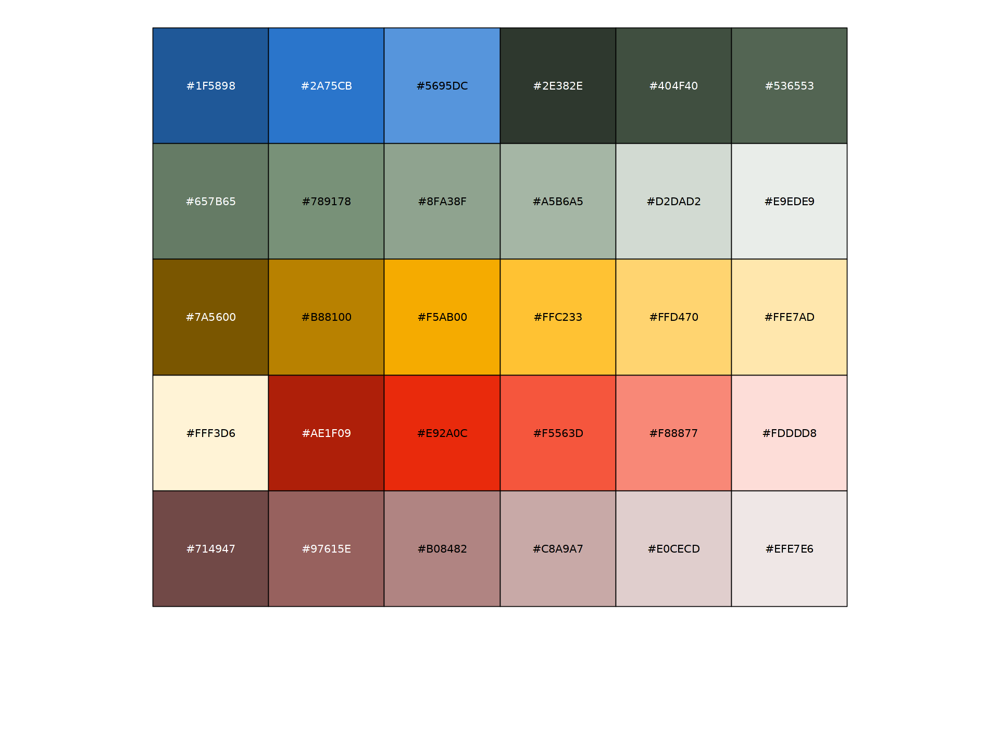

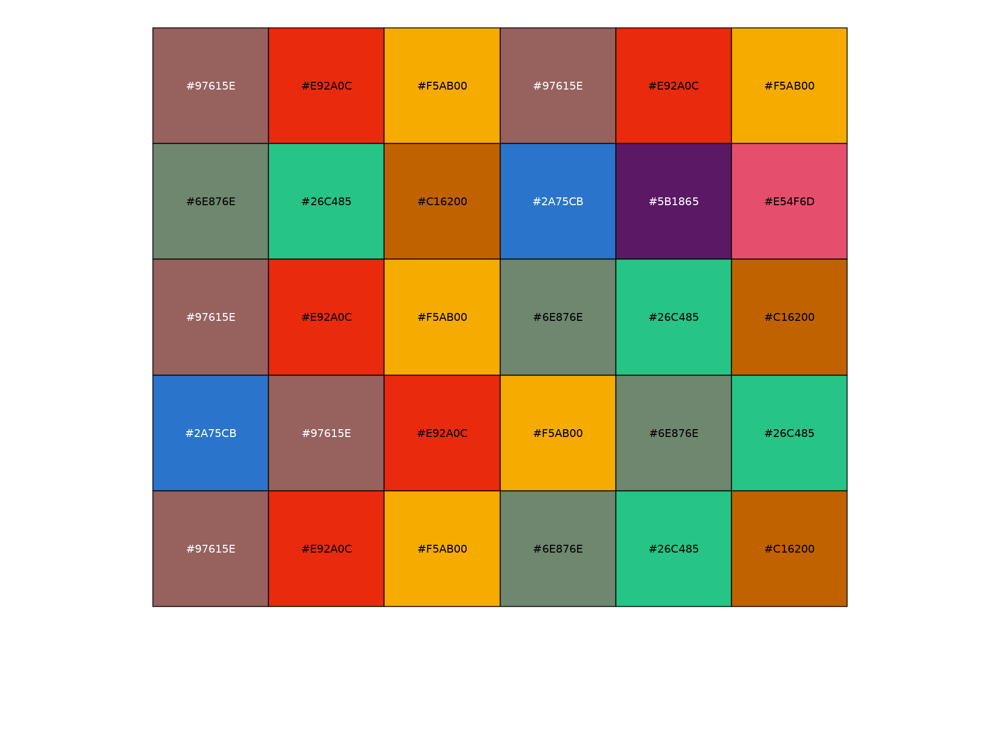

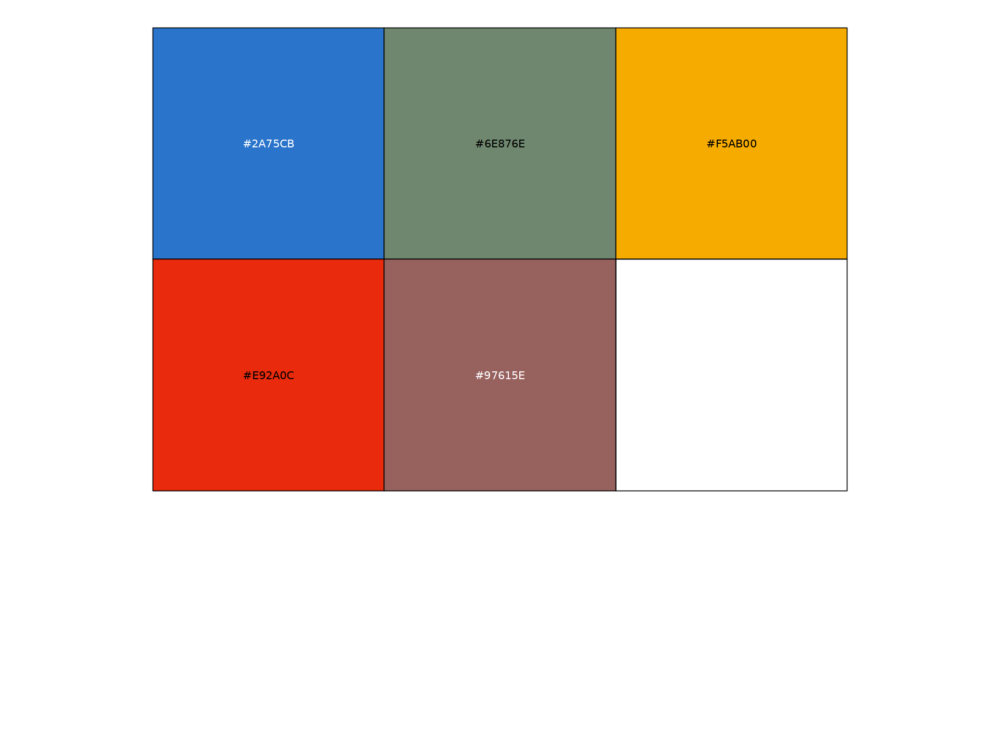

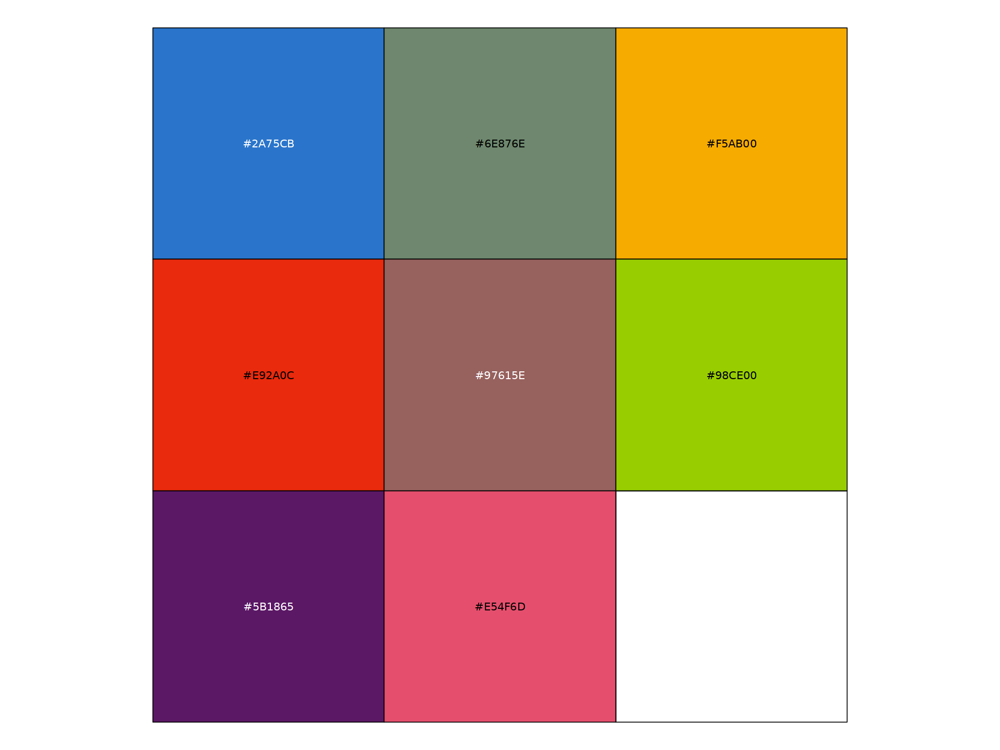

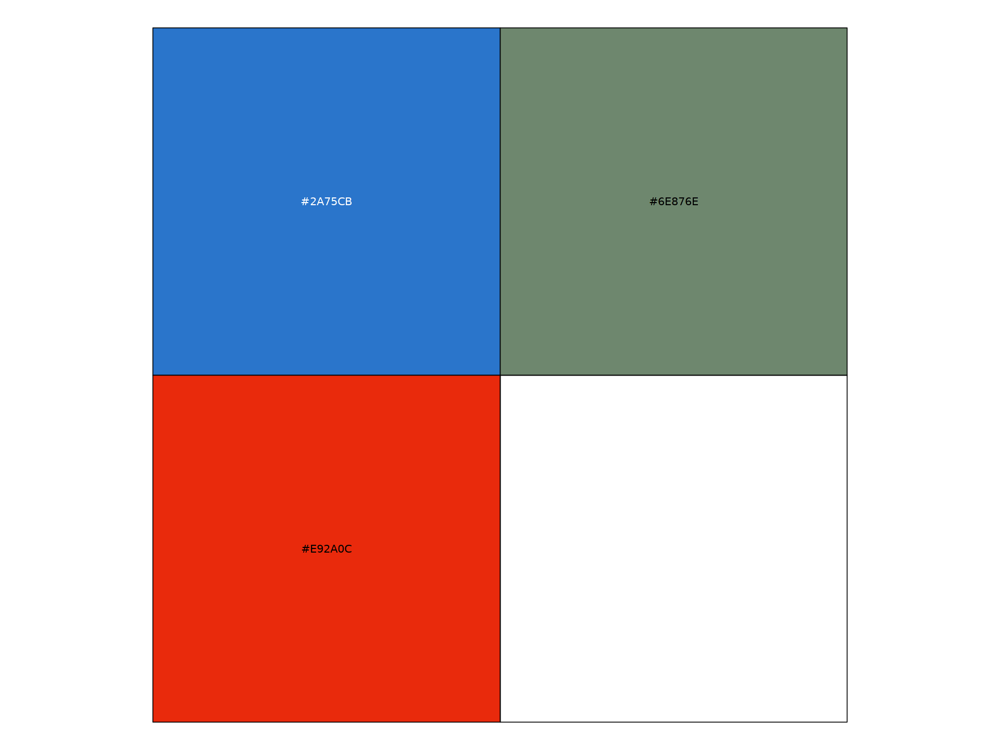

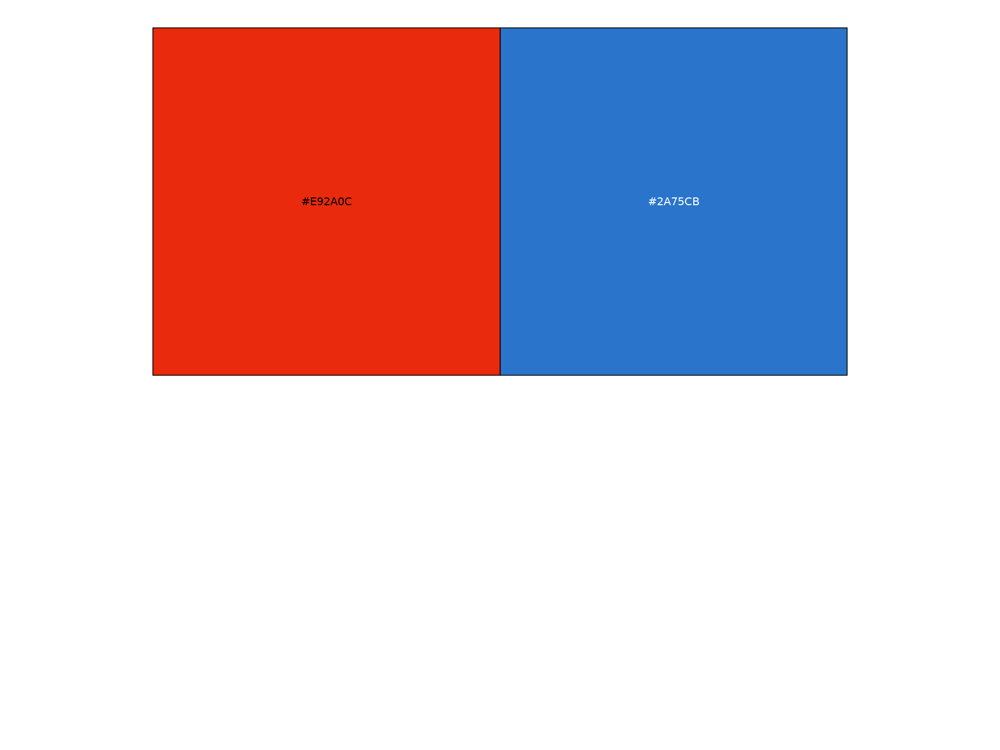

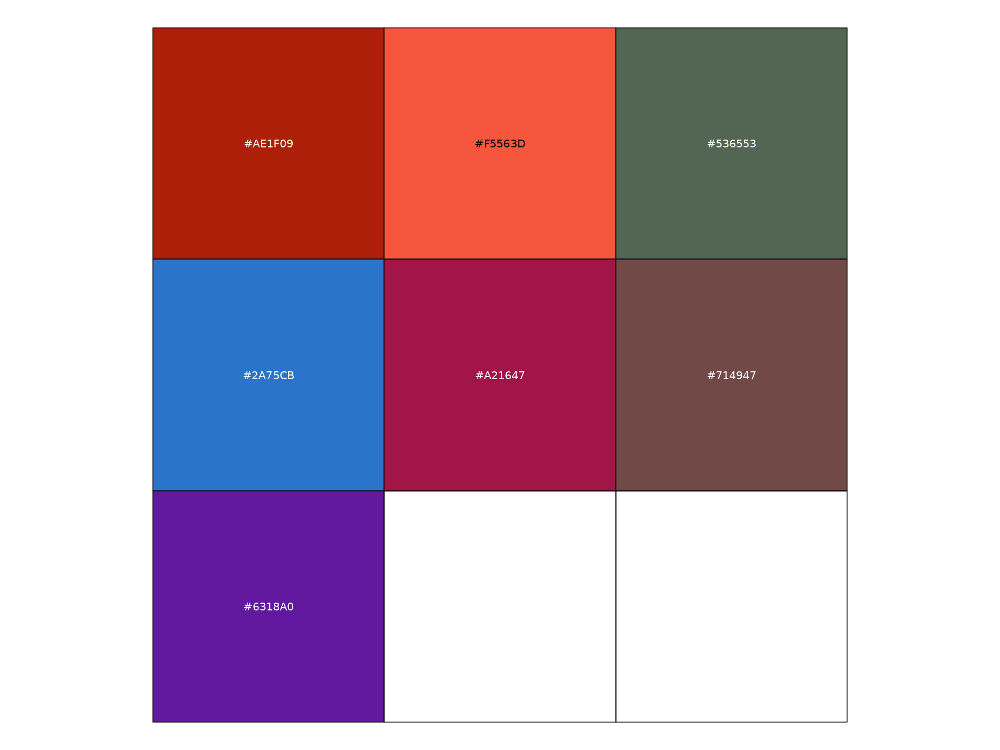

In [7]:
#Colors after removing LateCtrl1
orig.ident_colors <- c("#1F5898", "#2A75CB", "#5695DC", 
                       "#2E382E", "#404F40", "#536553", "#657B65", "#789178", "#8FA38F", "#A5B6A5", "#D2DAD2", "#E9EDE9", 
                       "#7A5600", "#B88100", "#F5AB00", "#FFC233", "#FFD470", "#FFE7AD", "#FFF3D6",
                       "#AE1F09", "#E92A0C", "#F5563D", "#F88877", "#FDDDD8",
                       "#714947", "#97615E", "#B08482", "#C8A9A7", "#E0CECD", "#EFE7E6")
names(orig.ident_colors) <- c("Naive1", "Naive2", "Naive3", 
                              "EarlyCtrl2", "EarlyCtrl3", "EarlyCtrl4", "EarlyCtrlMale5", "EarlyCtrlFemale5", "PeakCtrl2", "PeakCtrl3", "LateCtrl2", "LateCtrl3",
                              "Early1", "Early2", "EarlyFemale3", "EarlyMale3", "Early4", "EarlyMale5", "EarlyFemale5",
                              "Peak2", "Peak3", "PeakMale4", "PeakFemale4", "Peak5",
                              "Late1", "Late2", "Late3", "LateMale4", "LateFemale4", "Late5")
show_col(orig.ident_colors)
orig.ident_colors_contrast <- c("#97615E", "#E92A0C", "#F5AB00",
                                "#97615E", "#E92A0C", "#F5AB00", "#6E876E", "#26C485", "#C16200", "#2A75CB", "#5B1865", "#E54F6D",
                                "#97615E", "#E92A0C", "#F5AB00", "#6E876E", "#26C485", "#C16200", "#2A75CB",
                                "#97615E", "#E92A0C", "#F5AB00", "#6E876E", "#26C485",
                                "#97615E", "#E92A0C", "#F5AB00", "#6E876E", "#26C485", "#C16200")
names(orig.ident_colors_contrast) <- c("Naive1", "Naive2", "Naive3", 
                              "EarlyCtrl2", "EarlyCtrl3", "EarlyCtrl4", "EarlyCtrlMale5", "EarlyCtrlFemale5", "PeakCtrl2", "PeakCtrl3", "LateCtrl2", "LateCtrl3",
                              "Early1", "Early2", "EarlyFemale3", "EarlyMale3", "Early4", "EarlyMale5", "EarlyFemale5",
                              "Peak2", "Peak3", "PeakMale4", "PeakFemale4", "Peak5",
                              "Late1", "Late2", "Late3", "LateMale4", "LateFemale4", "Late5")
show_col(orig.ident_colors_contrast)

orig.ident_merge_colors <- c("#2A75CB", "#6E876E", "#F5AB00", "#E92A0C", "#97615E")
names(orig.ident_merge_colors) <- c("Naive", "Ctrl", "Early", "Peak", "Late")
show_col(orig.ident_merge_colors)

batch_colors <- c("#2A75CB", "#6E876E", "#F5AB00", "#E92A0C", "#97615E", "#98CE00", "#5B1865", "#E54F6D")
names(batch_colors) <- c("B1", "B2", "B3", "B4", "B5", "B6", "B7", "B8")
show_col(batch_colors)

model_colors <- c("#2A75CB", "#6E876E", "#E92A0C")
names(model_colors) <- c("Naive", "Ctrl", "EAE")
show_col(model_colors)

duo_colors <- c("#E92A0C", "#2A75CB")
show_col(duo_colors)

sex_colors <- duo_colors
names(sex_colors) <- c("F", "M")

immune_colors <- c("#A9DFBF", "#FF000080")
names(immune_colors) <- c("NonImmune", "Immune")
#show_col(immune_colors)

immuneAll_colors <- c("lightgrey", "blue", "orange", "red")
names(immuneAll_colors) <- c("None", "RNA", "GenePromAcc", "Both")
#show_col(immuneAll_colors)

doublets_colors <- c("#A9DFBF", "#FF000080")
names(doublets_colors) <- c("Singlet", "Doublet")
#show_col(doublets_colors)

debris_colors <- duo_colors
names(debris_colors) <- c("Percoll", "Debris")

date_tissue_coll_colors <- scales::viridis_pal()(17)
names(date_tissue_coll_colors) <- c('2021_04_30','2021_05_03','2021_05_31','2021_09_30','2021_10_06','2021_11_26','2022_03_09','2022_03_10','2022_08_03','2022_08_24','2023_01_23','2023_02_15','2023_03_22','2023_06_15','2023_06_14','2022_05_12','2022_05_16')
#show_col(date_tissue_coll_colors)

date_exp_colors <- scales::viridis_pal()(7)
names(date_exp_colors) <- c('2021_04_20','2021_09_22','2021_11_17','2022_01_31','2022_07_18','2023_01_09','2023_06_05')
#show_col(date_exp_colors)

EAE_score_mean_colors <- scales::viridis_pal()(7)
names(EAE_score_mean_colors) <- c(0,0.5,2,2.25,2.33,2.5,3)
#show_col(EAE_score_mean_colors)

cellType_colors <- c("#AE1F09", "#F5563D", "#536553", "#2A75CB", "#A21647", "#714947", "#6318A0")
names(cellType_colors) <- c("OPC", "COP", "MOL", "Astro", "Epen", "Micro", "Neuron")
show_col(cellType_colors)

In [8]:
#Set up ATAC annotation
annotations <- GetGRangesFromEnsDb(ensdb = EnsDb.Mmusculus.v79, verbose =FALSE)
ucsc.levels <- str_replace(string=paste("chr",seqlevels(annotations),sep=""), pattern="chrMT", replacement="chrM")
seqlevels(annotations) <- ucsc.levels
genome(annotations) <- "mm10"

Warning message in .merge_two_Seqinfo_objects(x, y):
"The 2 combined objects have no sequence levels in common. (Use
  suppressWarnings() to suppress this warning.)"
Warning message in .merge_two_Seqinfo_objects(x, y):
"The 2 combined objects have no sequence levels in common. (Use
  suppressWarnings() to suppress this warning.)"
Warning message in .merge_two_Seqinfo_objects(x, y):
"The 2 combined objects have no sequence levels in common. (Use
  suppressWarnings() to suppress this warning.)"
Warning message in .merge_two_Seqinfo_objects(x, y):
"The 2 combined objects have no sequence levels in common. (Use
  suppressWarnings() to suppress this warning.)"
Warning message in .merge_two_Seqinfo_objects(x, y):
"The 2 combined objects have no sequence levels in common. (Use
  suppressWarnings() to suppress this warning.)"
Warning message in .merge_two_Seqinfo_objects(x, y):
"The 2 combined objects have no sequence levels in common. (Use
  suppressWarnings() to suppress this warning.)"
Warn

## 2. Loading datasets

In [11]:
MORNAATACC <- readRDS(paste0(OS_path_outputs, "MORNAATACC.rds"))

## 3. Gender analysis

### 3.1 Gender plots

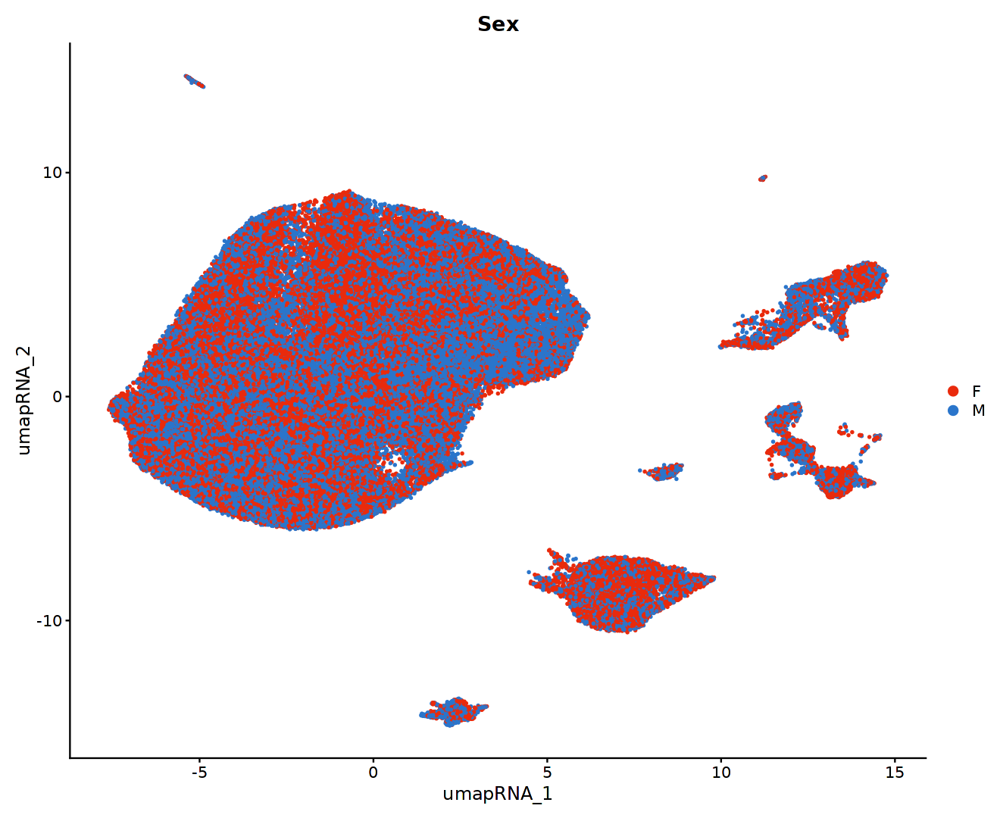

In [10]:
options(repr.plot.width=11, repr.plot.height=9)
DimPlot(MORNAATACC, group.by="Sex", reduction="umap_RNA", shuffle=TRUE, seed=seed, cols=sex_colors, pt.size=0.5, label=FALSE, raster=FALSE)

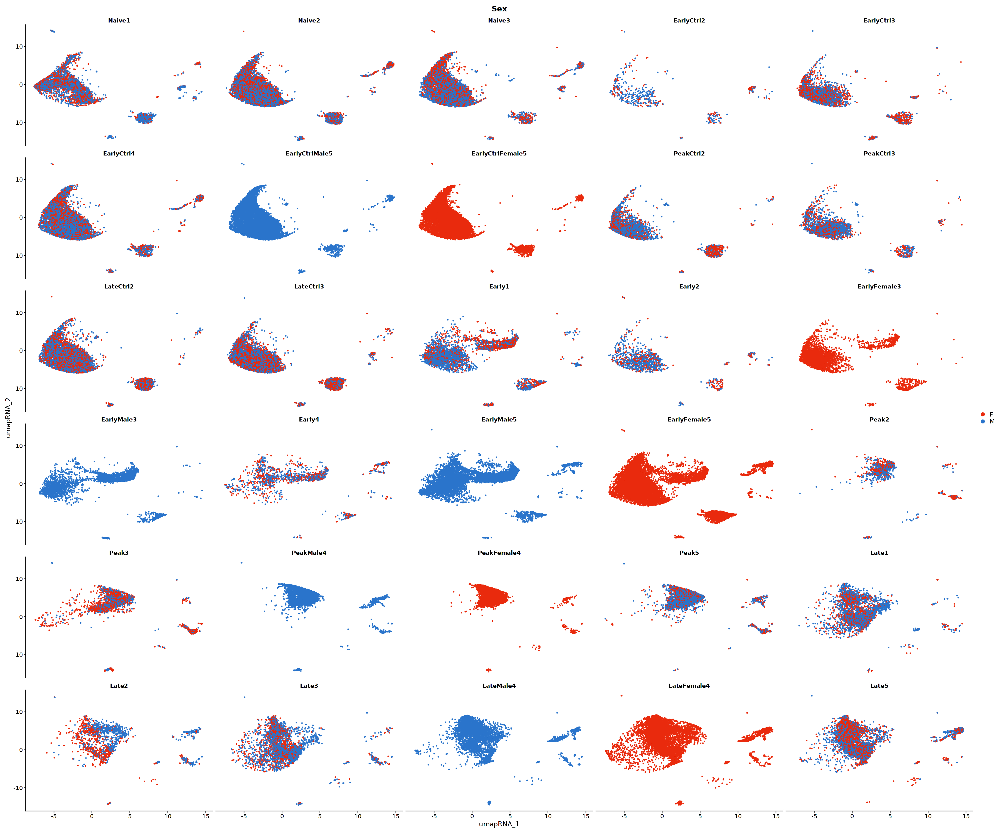

In [11]:
options(repr.plot.width=30, repr.plot.height=25)
DimPlot(MORNAATACC, group.by="Sex", split.by="orig.ident", reduction="umap_RNA", shuffle=TRUE, seed=seed, cols=sex_colors, ncol=5, pt.size=0.5, label=FALSE, raster=FALSE)

In [12]:
t <- table(Cluster=MORNAATACC$seurat_clusters_RNA, Batch=MORNAATACC@meta.data[["Sex"]])
t <- t[,names(sex_colors)]
t_percent <- round(prop.table(t, 2) * 100 ,digits = 2)/ncol(t)

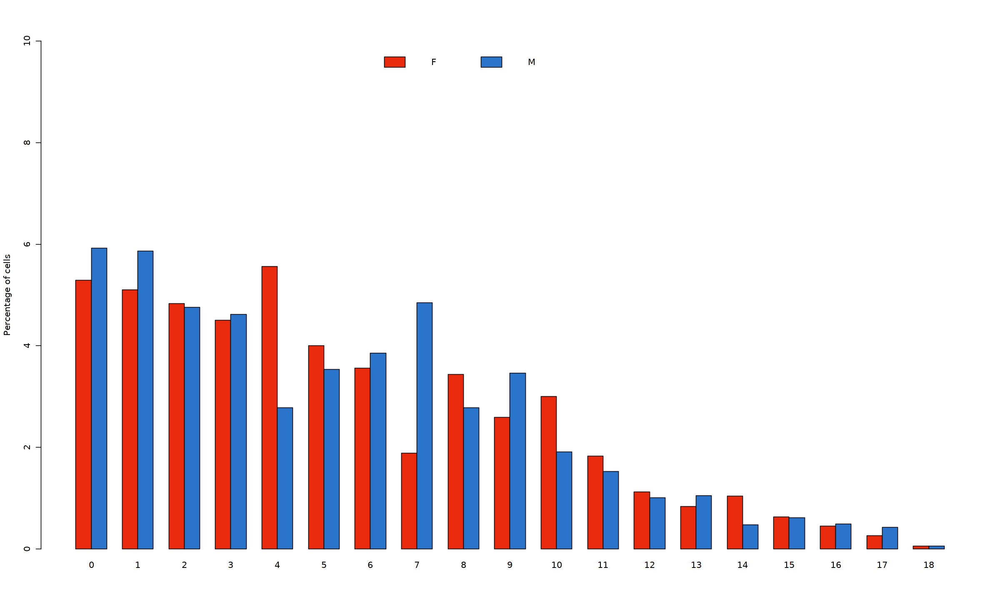

In [13]:
options(repr.plot.width=20, repr.plot.height=12)
barplot(t(t_percent), beside=TRUE, xlab = "", ylab="Percentage of cells", legend = TRUE, ylim = c(0, round_any(as.integer(max(rowSums(t_percent)))-1, 1, f = ceiling)), col = sex_colors, args.legend = list(bty = "n", x = "top", ncol = 3))

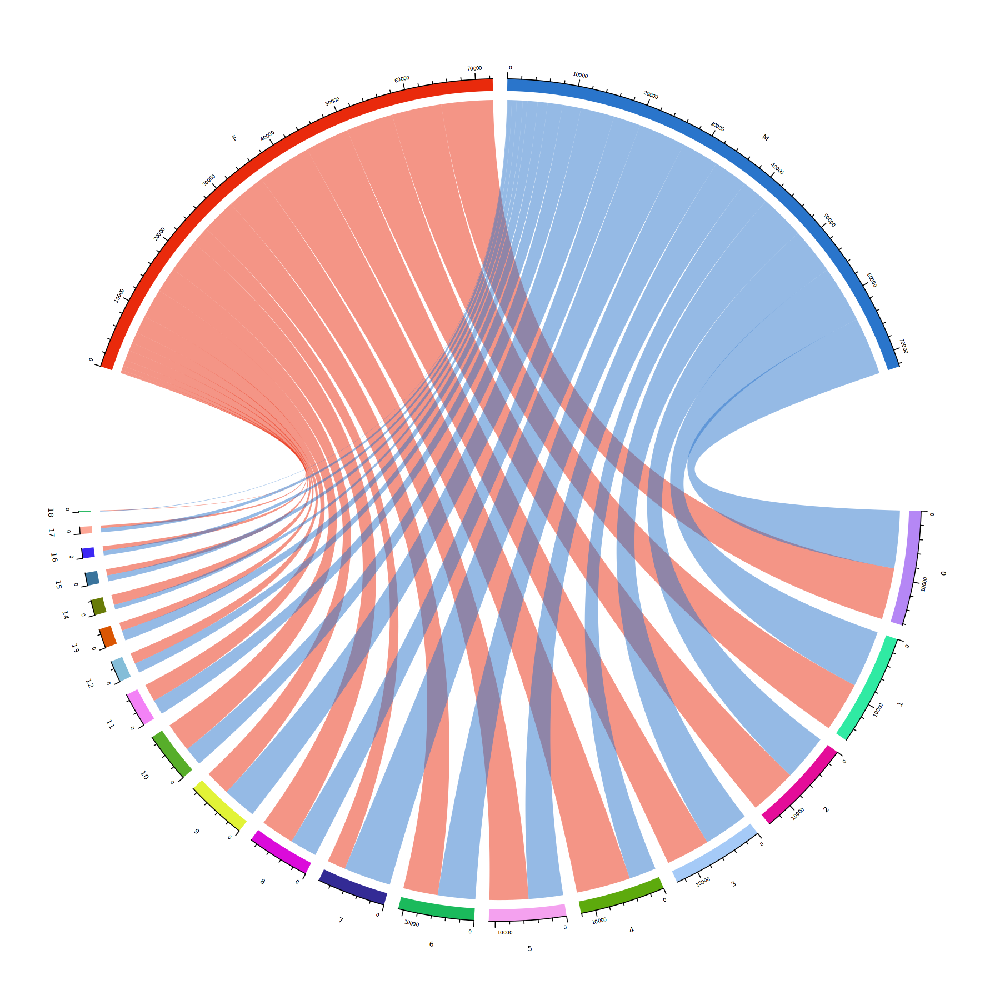

In [14]:
options(repr.plot.width=15, repr.plot.height=15)
set.seed(115)
mat = as.matrix(table(MORNAATACC@meta.data$Sex, MORNAATACC@meta.data$seurat_clusters_RNA))
for (row in 1:nrow(mat)) mat[row,] <- as.integer(mat[row,]/(sum(mat[row,])/min(rowSums(mat))))
circos.clear()
par(cex = 0.8)
chordDiagram(mat, big.gap = 20, small.gap = 2, order = c(colnames(mat), names(sex_colors)), grid.col=rev(sex_colors))

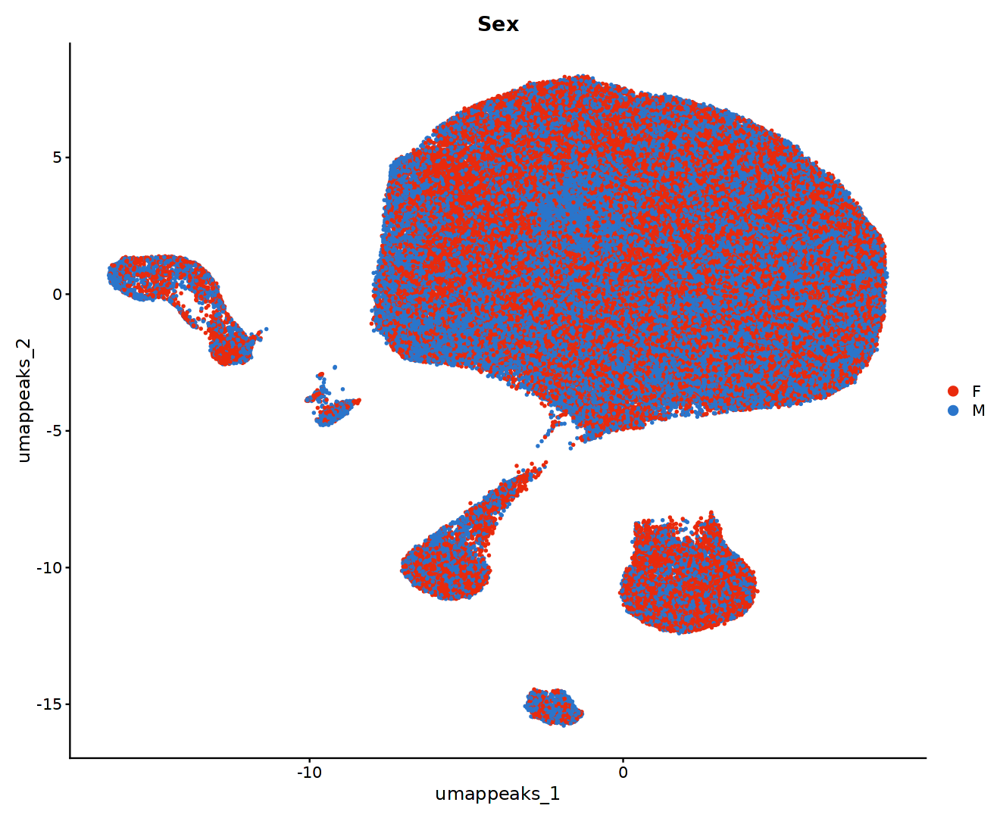

In [15]:
options(repr.plot.width=11, repr.plot.height=9)
DimPlot(MORNAATACC, group.by="Sex", reduction="umap_peaks", shuffle=TRUE, seed=seed, cols=sex_colors, pt.size=0.5, label=FALSE, raster=FALSE)

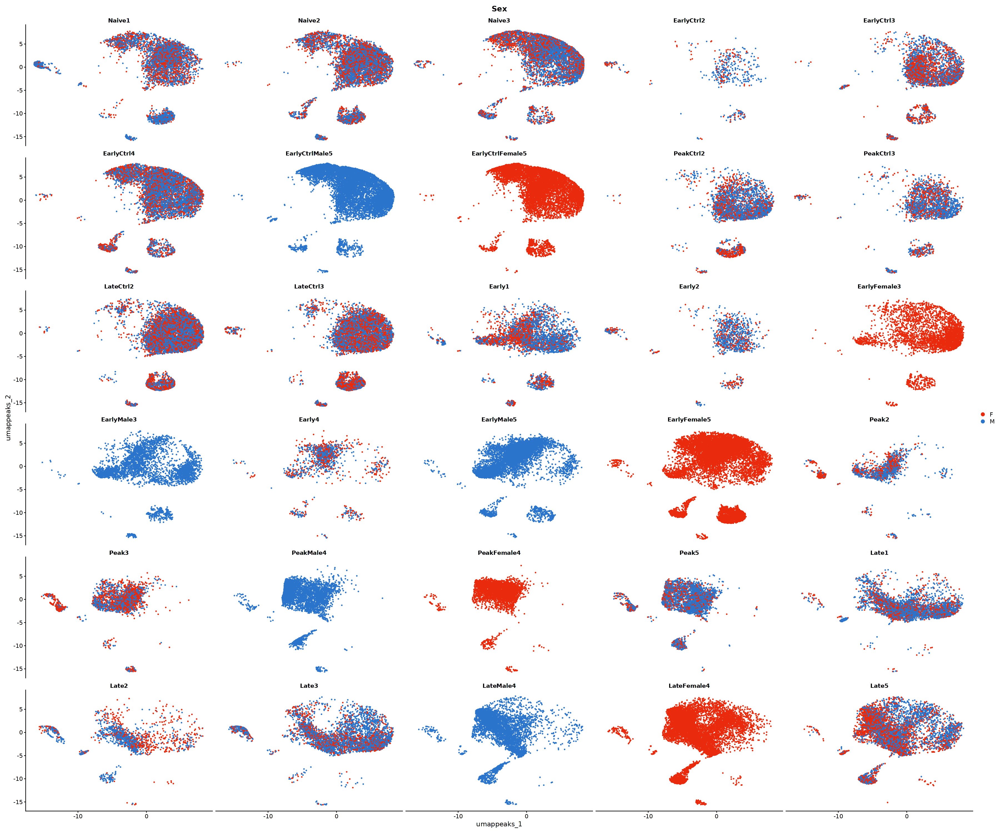

In [16]:
options(repr.plot.width=30, repr.plot.height=25)
DimPlot(MORNAATACC, group.by="Sex", split.by="orig.ident", reduction="umap_peaks", shuffle=TRUE, seed=seed, cols=sex_colors, ncol=5, pt.size=0.5, label=FALSE, raster=FALSE)

In [17]:
t <- table(Cluster=MORNAATACC$seurat_clusters_peaks, Batch=MORNAATACC@meta.data[["Sex"]])
t <- t[,names(sex_colors)]
t_percent <- round(prop.table(t, 2) * 100 ,digits = 2)/ncol(t)

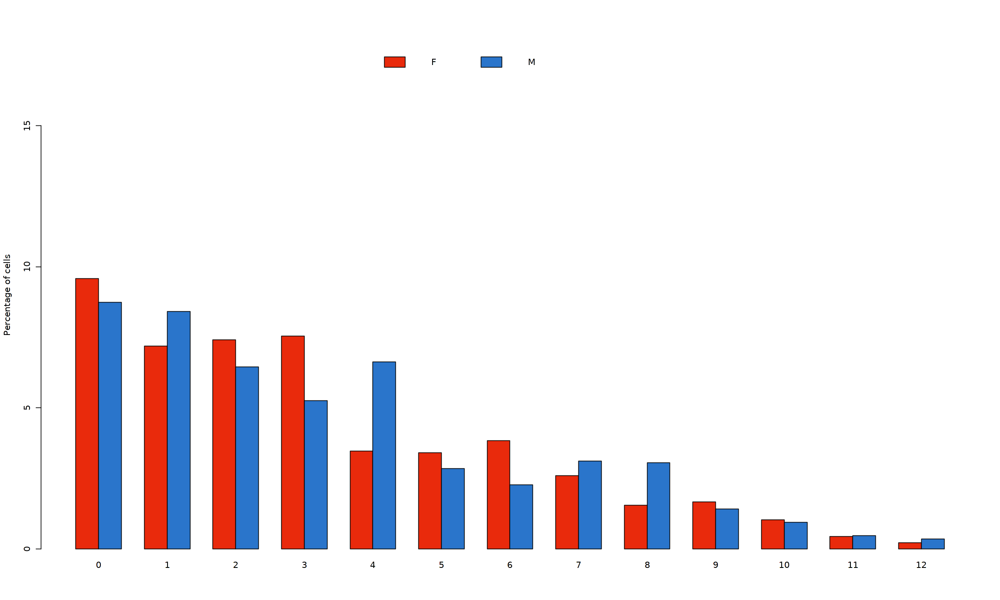

In [18]:
options(repr.plot.width=20, repr.plot.height=12)
barplot(t(t_percent), beside=TRUE, xlab = "", ylab="Percentage of cells", legend = TRUE, ylim = c(0, round_any(as.integer(max(rowSums(t_percent))), 1, f = ceiling)), col = sex_colors, args.legend = list(bty = "n", x = "top", ncol = 3))

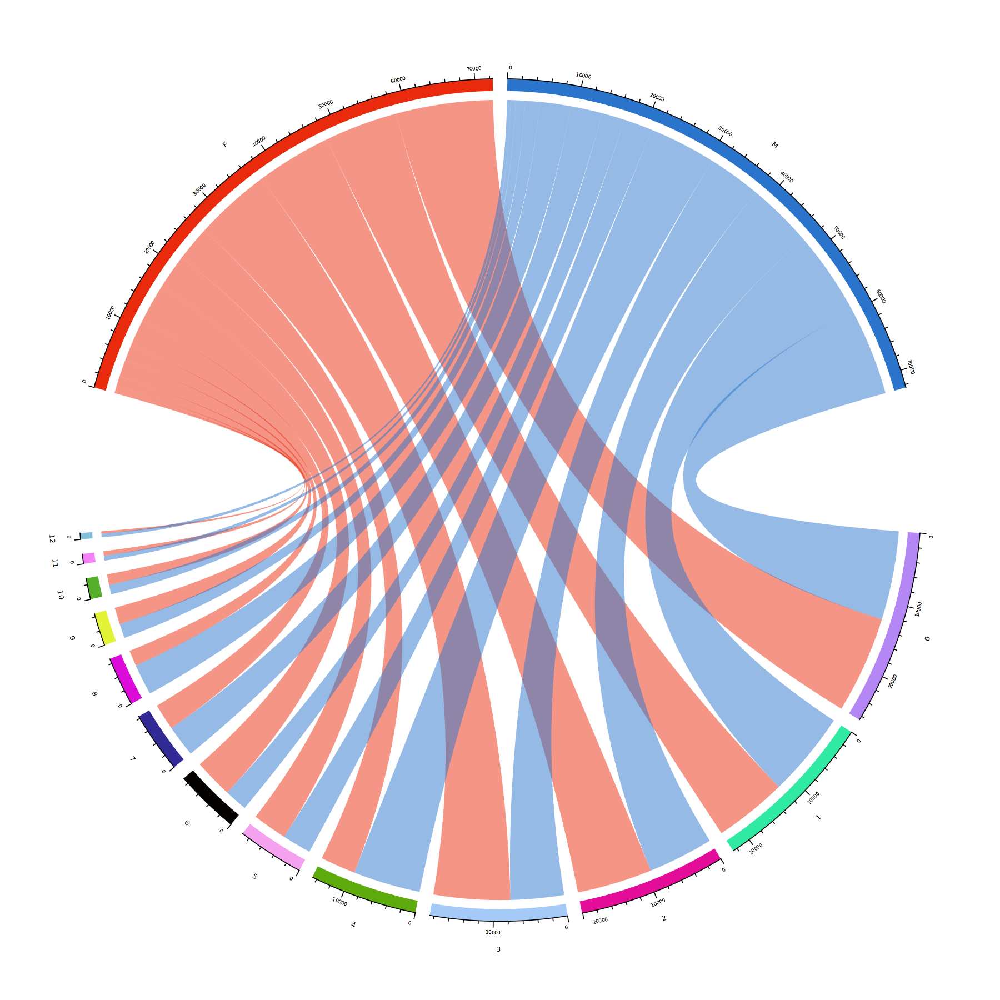

In [19]:
options(repr.plot.width=15, repr.plot.height=15)
set.seed(115)
mat = as.matrix(table(MORNAATACC@meta.data$Sex, MORNAATACC@meta.data$seurat_clusters_peaks))
for (row in 1:nrow(mat)) mat[row,] <- as.integer(mat[row,]/(sum(mat[row,])/min(rowSums(mat))))
circos.clear()
par(cex = 0.8)
chordDiagram(mat, big.gap = 20, small.gap = 2, order = c(colnames(mat), names(sex_colors)), grid.col=rev(sex_colors))

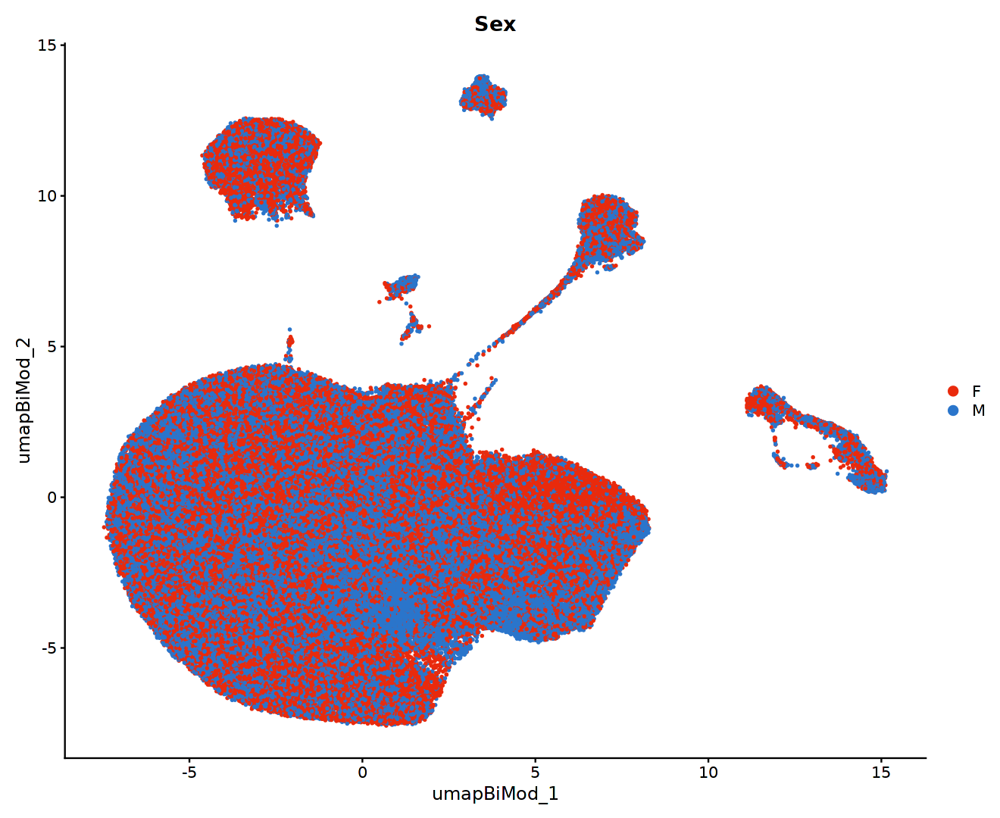

In [11]:
options(repr.plot.width=11, repr.plot.height=9)
DimPlot(MORNAATACC, group.by="Sex", reduction="umap_BiMod", shuffle=TRUE, seed=seed, cols=sex_colors, pt.size=0.5, label=FALSE, raster=FALSE)

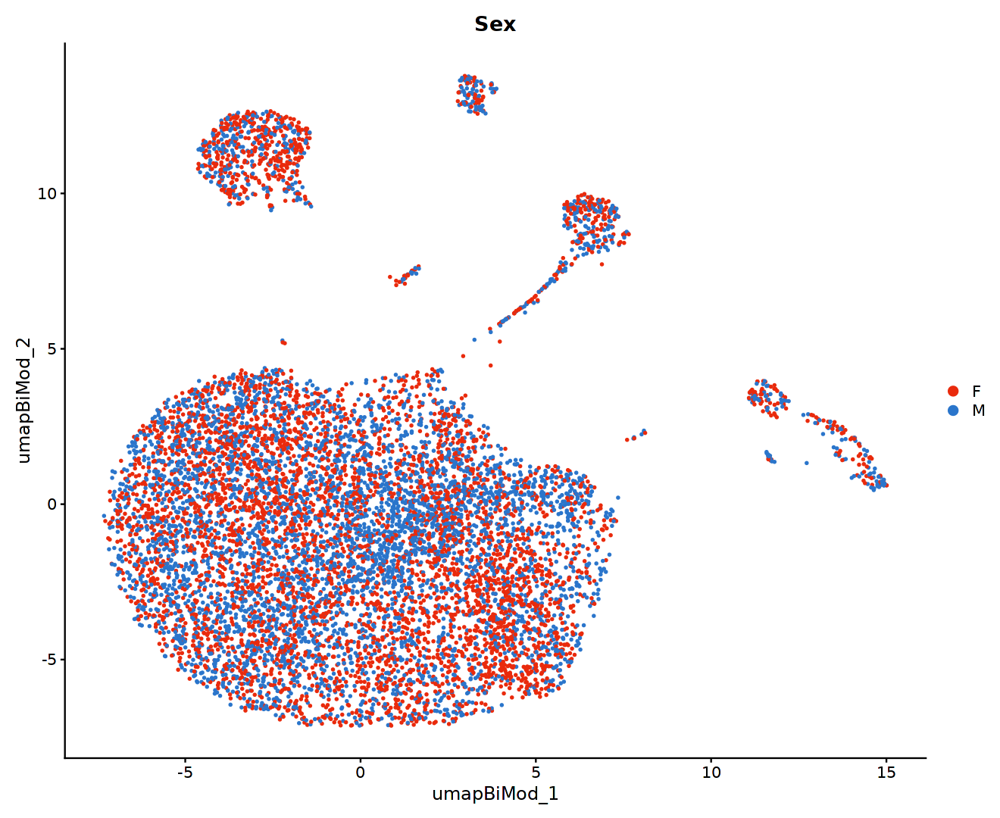

In [21]:
#Each timepoint has the same number of cells
options(repr.plot.width=11, repr.plot.height=9)
Idents(MORNAATACC) <- "Sex"
DimPlot(subset(MORNAATACC, downsample = 5000), group.by="Sex", reduction="umap_BiMod", shuffle=TRUE, seed=seed, cols=sex_colors, pt.size=0.5, label=FALSE, raster=FALSE)

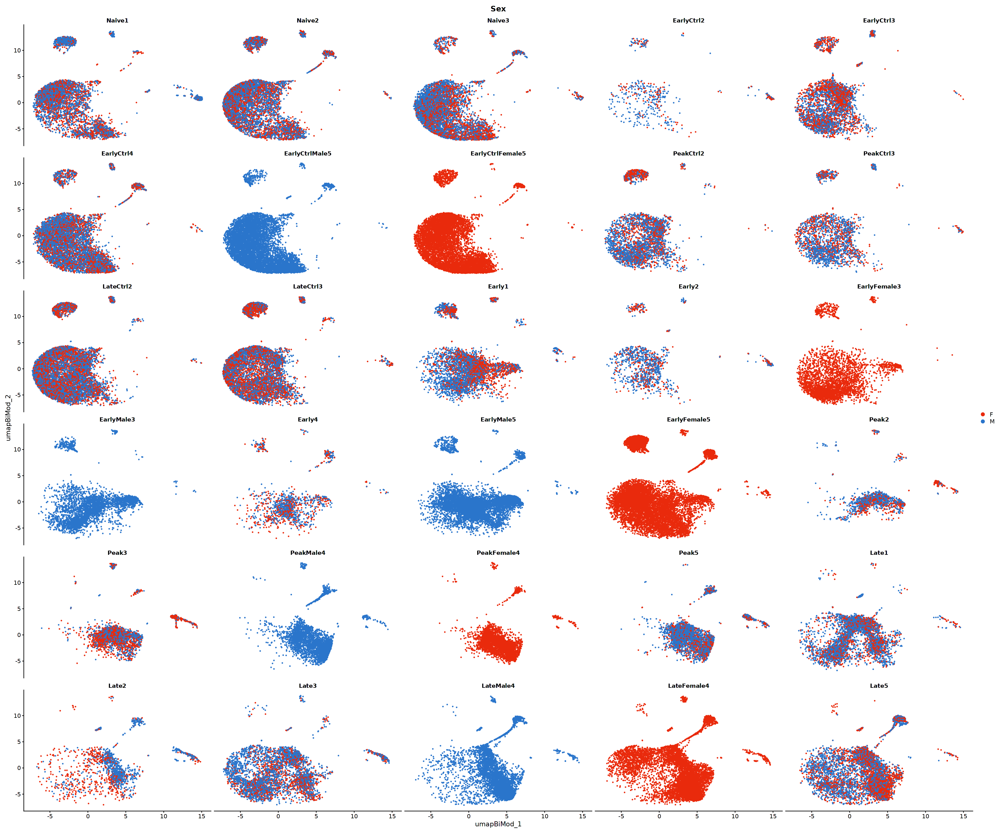

In [22]:
options(repr.plot.width=30, repr.plot.height=25)
DimPlot(MORNAATACC, group.by="Sex", split.by="orig.ident", reduction="umap_BiMod", shuffle=TRUE, seed=seed, cols=sex_colors, ncol=5, pt.size=0.5, label=FALSE, raster=FALSE)

In [23]:
t <- table(Cluster=MORNAATACC$seurat_clusters_BiMod, Batch=MORNAATACC@meta.data[["Sex"]])
t <- t[,names(sex_colors)]
t_percent <- round(prop.table(t, 2) * 100 ,digits = 2)/ncol(t)

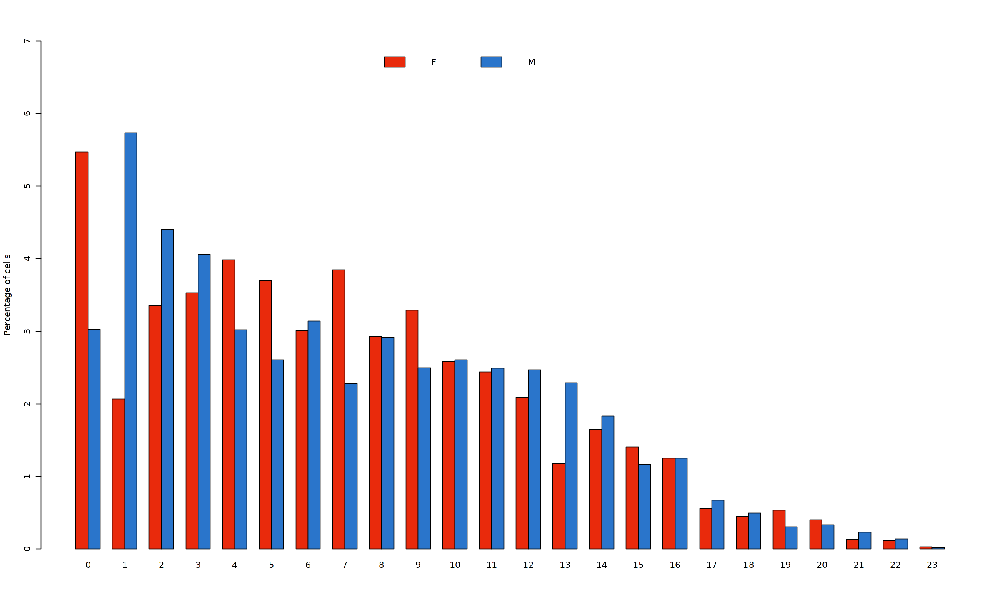

In [24]:
options(repr.plot.width=20, repr.plot.height=12)
barplot(t(t_percent), beside=TRUE, xlab = "", ylab="Percentage of cells", legend = TRUE, ylim = c(0, round_any(as.integer(max(rowSums(t_percent)))-1, 1, f = ceiling)), col = sex_colors, args.legend = list(bty = "n", x = "top", ncol = 3))

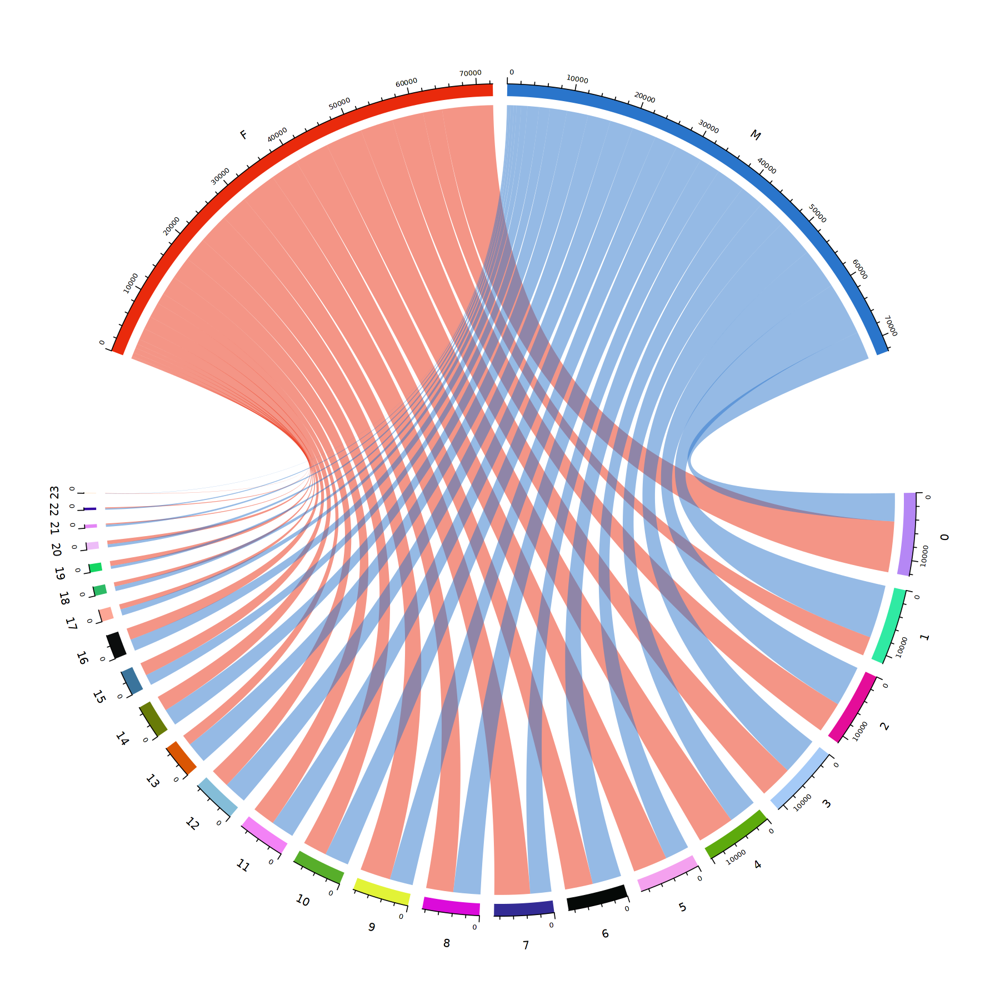

In [25]:
options(repr.plot.width=15, repr.plot.height=15)
set.seed(115)
mat = as.matrix(table(MORNAATACC@meta.data$Sex, MORNAATACC@meta.data$seurat_clusters_BiMod))
for (row in 1:nrow(mat)) mat[row,] <- as.integer(mat[row,]/(sum(mat[row,])/min(rowSums(mat))))
circos.clear()
par(cex = 1.2)
chordDiagram(mat, big.gap = 20, small.gap = 2, order = c(colnames(mat), names(sex_colors)), grid.col=rev(sex_colors))

In [26]:
t <- table(Cluster=MORNAATACC$cellType, Batch=MORNAATACC@meta.data[["Sex"]])
t <- t[,names(sex_colors)]
t_percent <- round(prop.table(t, 2) * 100 ,digits = 2)/ncol(t)

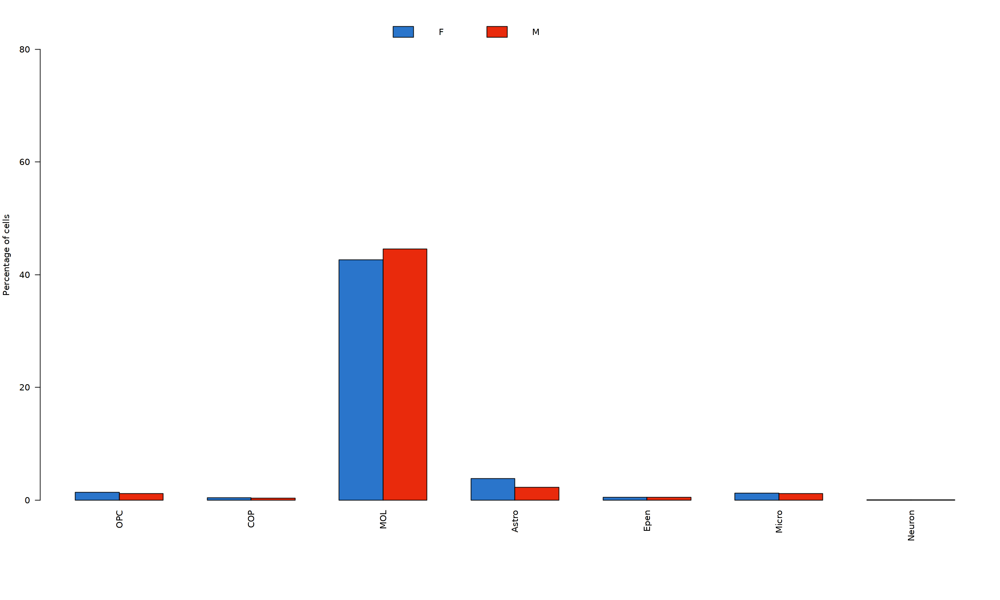

In [27]:
options(repr.plot.width=20, repr.plot.height=12)
par(mar=c(10,4,1,1))
barplot(t(t_percent), beside=TRUE, xlab = "", ylab="Percentage of cells", legend = TRUE, ylim = c(0, round_any(as.integer(max(rowSums(t_percent))), 1, f = ceiling)), col = rev(sex_colors), args.legend = list(bty = "n", x = "top", ncol = 3), las=2)

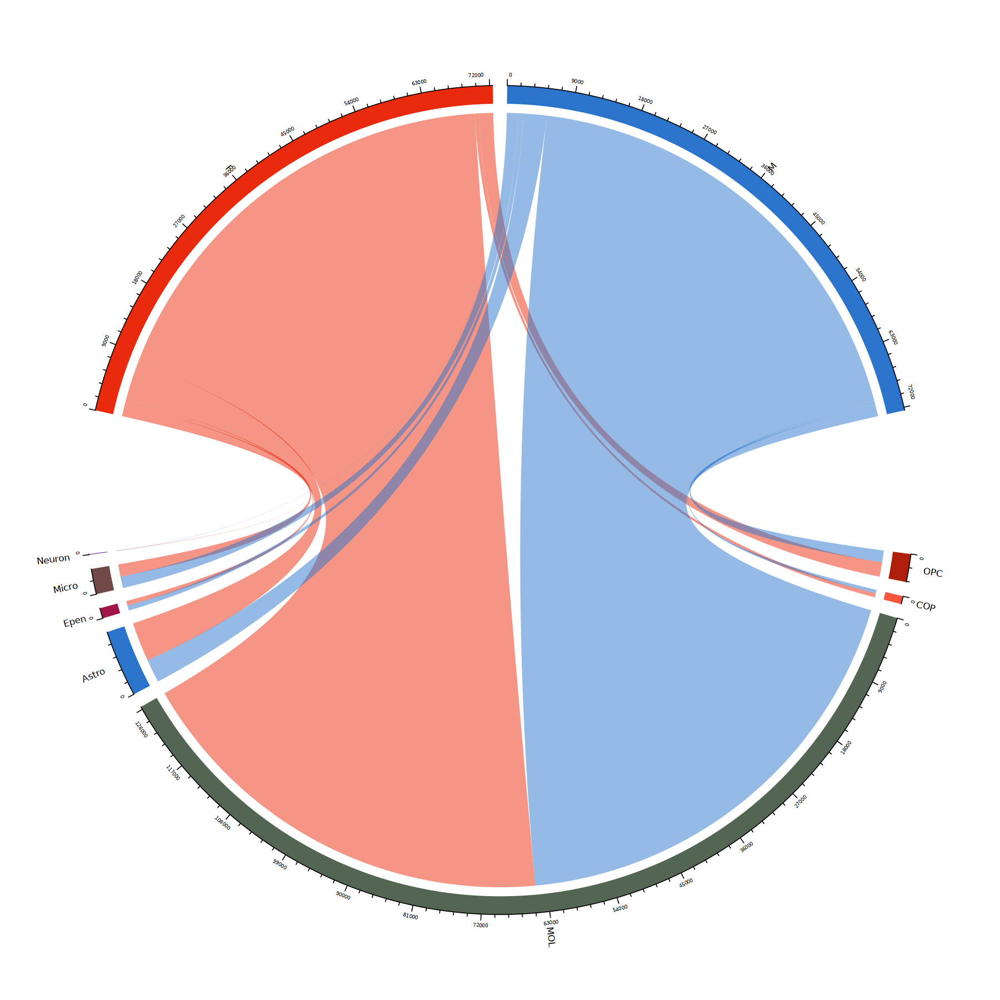

In [28]:
options(repr.plot.width=15, repr.plot.height=15)
set.seed(115)
mat = as.matrix(table(MORNAATACC@meta.data$Sex, MORNAATACC@meta.data$cellType))
for (row in 1:nrow(mat)) mat[row,] <- as.integer(mat[row,]/(sum(mat[row,])/min(rowSums(mat))))
circos.clear()
par(cex = 0.8)
chordDiagram(mat, annotationTrack = c("grid", "axis"), preAllocateTracks = list(track.height = max(strwidth(unlist(dimnames(mat))))/3), big.gap = 20, small.gap = 2, order = c(names(cellType_colors), names(sex_colors)), grid.col=c(rev(sex_colors),cellType_colors))
circos.track(track.index = 1, panel.fun = function(x, y) {circos.text(CELL_META$xcenter, CELL_META$ylim[1], CELL_META$sector.index, facing = "clockwise", niceFacing = TRUE, adj = c(-0.3, 0.5))}, bg.border = NA)

In [29]:
t <- table(Cluster=MORNAATACC$orig.ident, Batch=MORNAATACC@meta.data[["Sex"]])
t <- t[,names(sex_colors)]
t_percent <- round(prop.table(t, 2) * 100 ,digits = 2)/ncol(t)

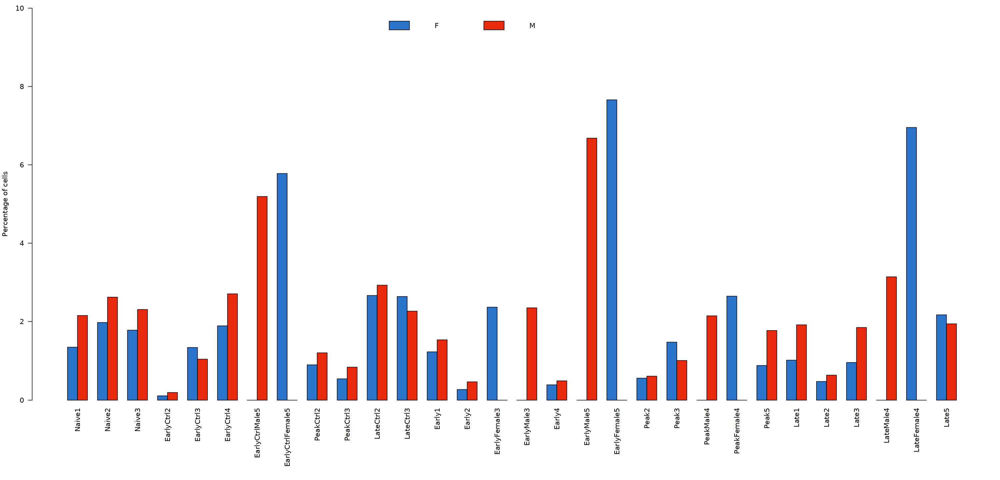

In [30]:
options(repr.plot.width=25, repr.plot.height=12)
par(mar=c(10,4,1,1))
barplot(t(t_percent), beside=TRUE, xlab = "", ylab="Percentage of cells", legend = TRUE, ylim = c(0, round_any(as.integer(max(rowSums(t_percent))), 5, f = ceiling)), col = rev(sex_colors), args.legend = list(bty = "n", x = "top", ncol = 3), las=2)

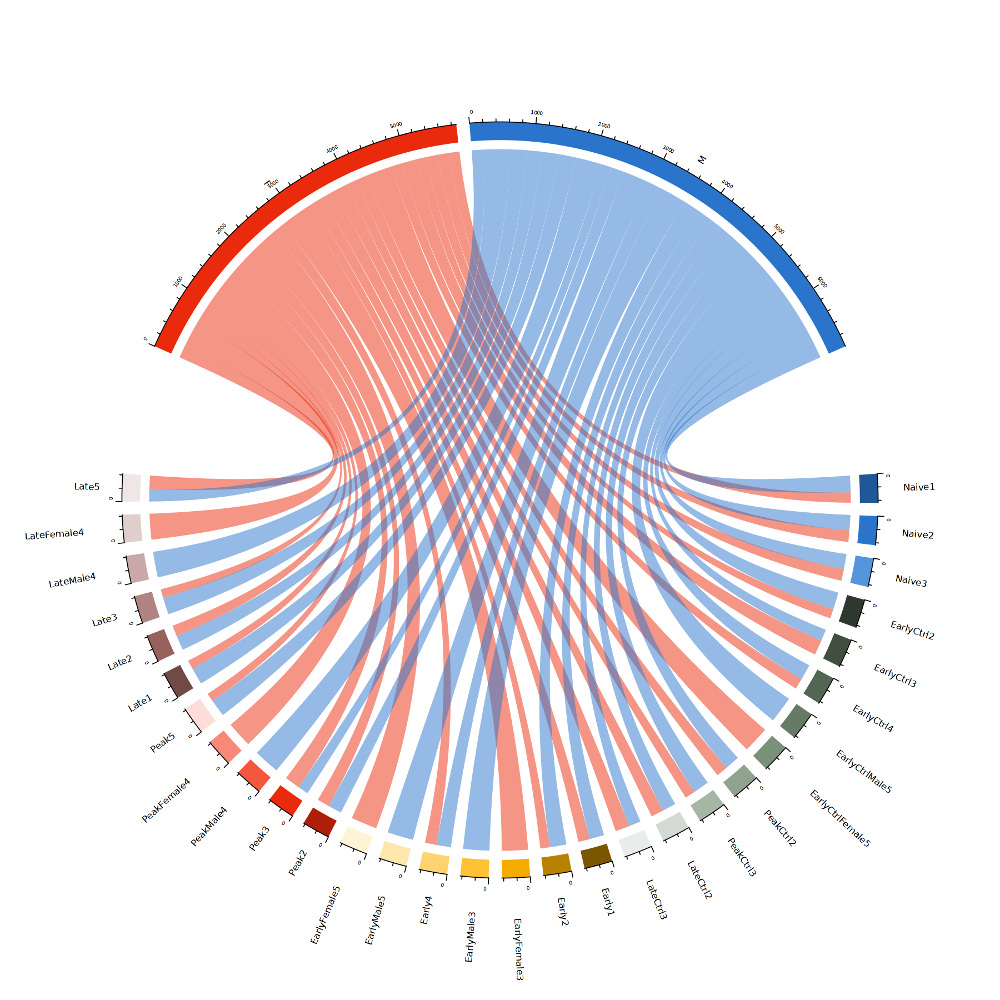

In [31]:
options(repr.plot.width=15, repr.plot.height=15)
set.seed(115)
mat = as.matrix(table(MORNAATACC@meta.data$Sex, MORNAATACC@meta.data$orig.ident))
for (row in 1:nrow(mat)) mat[row,] <- as.integer(mat[row,]/(sum(mat[row,])/min(rowSums(mat))))
for (col in 1:ncol(mat)) mat[,col] <- as.integer(mat[,col]/(sum(mat[,col])/min(colSums(mat))))
circos.clear()
par(cex = 0.8)
chordDiagram(mat, annotationTrack = c("grid", "axis"), preAllocateTracks = list(track.height = max(strwidth(unlist(dimnames(mat))))/3), big.gap = 20, small.gap = 2, order = c(names(orig.ident_colors), names(sex_colors)), grid.col=c(rev(sex_colors),orig.ident_colors))
circos.track(track.index = 1, panel.fun = function(x, y) {circos.text(CELL_META$xcenter, CELL_META$ylim[1], CELL_META$sector.index, facing = "clockwise", niceFacing = TRUE, adj = c(-0.5, 0.5))}, bg.border = NA)

In [32]:
t <- table(Cluster=MORNAATACC$orig.ident_merge, Batch=MORNAATACC@meta.data[["Sex"]])
t <- t[,names(sex_colors)]
t_percent <- round(prop.table(t, 2) * 100 ,digits = 2)/ncol(t)

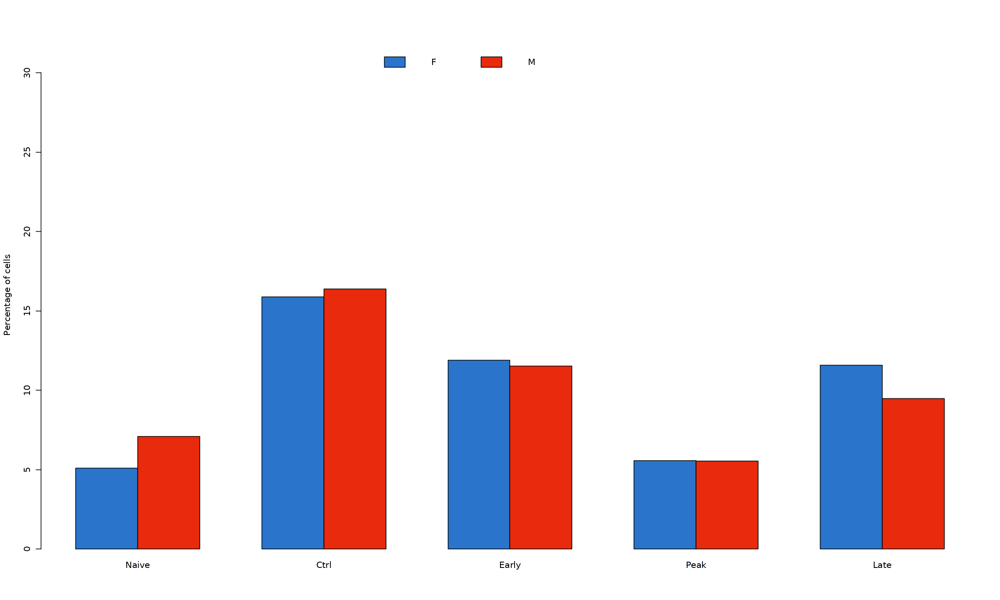

In [33]:
options(repr.plot.width=20, repr.plot.height=12)
barplot(t(t_percent), beside=TRUE, xlab = "", ylab="Percentage of cells", legend = TRUE, ylim = c(0, round_any(as.integer(max(rowSums(t_percent))), 1, f = ceiling)), col = rev(sex_colors), args.legend = list(bty = "n", x = "top", ncol = 3))

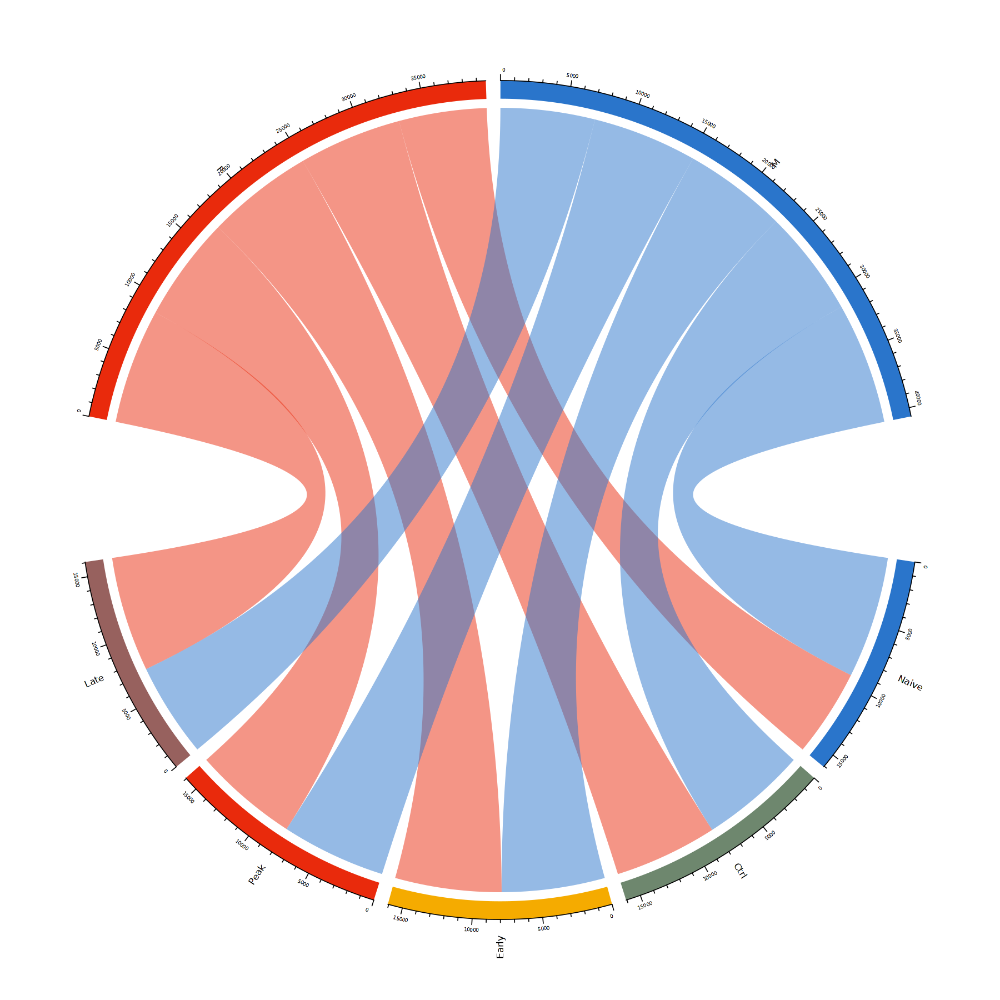

In [34]:
options(repr.plot.width=15, repr.plot.height=15)
set.seed(115)
mat = as.matrix(table(MORNAATACC@meta.data$Sex, MORNAATACC@meta.data$orig.ident_merge))
for (row in 1:nrow(mat)) mat[row,] <- as.integer(mat[row,]/(sum(mat[row,])/min(rowSums(mat))))
for (col in 1:ncol(mat)) mat[,col] <- as.integer(mat[,col]/(sum(mat[,col])/min(colSums(mat))))
circos.clear()
par(cex = 0.8)
chordDiagram(mat, annotationTrack = c("grid", "axis"), preAllocateTracks = list(track.height = max(strwidth(unlist(dimnames(mat))))/3), big.gap = 20, small.gap = 2, order = c(names(orig.ident_merge_colors), names(sex_colors)), grid.col=c(rev(sex_colors),orig.ident_merge_colors))
circos.track(track.index = 1, panel.fun = function(x, y) {circos.text(CELL_META$xcenter, CELL_META$ylim[1], CELL_META$sector.index, facing = "clockwise", niceFacing = TRUE, adj = c(-0.3, 0.5))}, bg.border = NA)

In [35]:
t <- table(Cluster=MORNAATACC$model, Batch=MORNAATACC@meta.data[["Sex"]])
t <- t[,names(sex_colors)]
t_percent <- round(prop.table(t, 2) * 100 ,digits = 2)/ncol(t)

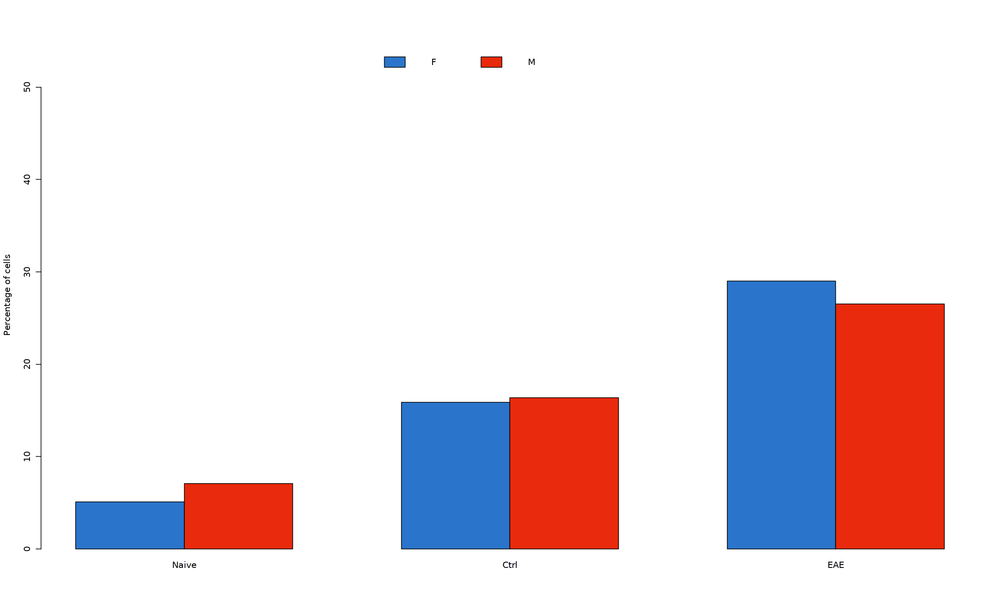

In [36]:
options(repr.plot.width=20, repr.plot.height=12)
barplot(t(t_percent), beside=TRUE, xlab = "", ylab="Percentage of cells", legend = TRUE, ylim = c(0, round_any(as.integer(max(rowSums(t_percent))), 1, f = ceiling)), col = rev(sex_colors), args.legend = list(bty = "n", x = "top", ncol = 3))

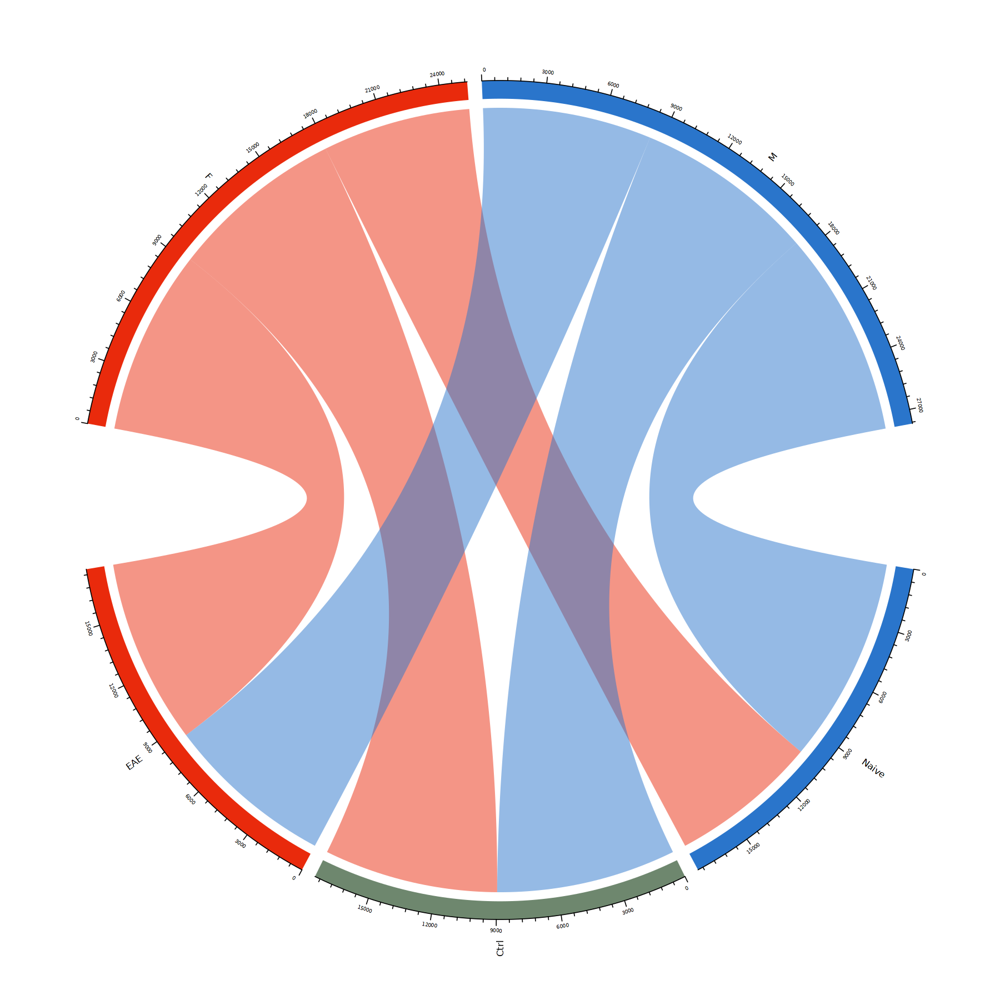

In [37]:
options(repr.plot.width=15, repr.plot.height=15)
set.seed(115)
mat = as.matrix(table(MORNAATACC@meta.data$Sex, MORNAATACC@meta.data$model))
for (row in 1:nrow(mat)) mat[row,] <- as.integer(mat[row,]/(sum(mat[row,])/min(rowSums(mat))))
for (col in 1:ncol(mat)) mat[,col] <- as.integer(mat[,col]/(sum(mat[,col])/min(colSums(mat))))
circos.clear()
par(cex = 0.8)
chordDiagram(mat, annotationTrack = c("grid", "axis"), preAllocateTracks = list(track.height = max(strwidth(unlist(dimnames(mat))))/3), big.gap = 20, small.gap = 2, order = c(names(model_colors), names(sex_colors)), grid.col=c(rev(sex_colors),model_colors))
circos.track(track.index = 1, panel.fun = function(x, y) {circos.text(CELL_META$xcenter, CELL_META$ylim[1], CELL_META$sector.index, facing = "clockwise", niceFacing = TRUE, adj = c(-0.7, 0.5))}, bg.border = NA)

In [38]:
t <- table(Cluster=MORNAATACC$Immune, Batch=MORNAATACC@meta.data[["Sex"]])
t <- t[,names(sex_colors)]
t_percent <- round(prop.table(t, 2) * 100 ,digits = 2)/ncol(t)

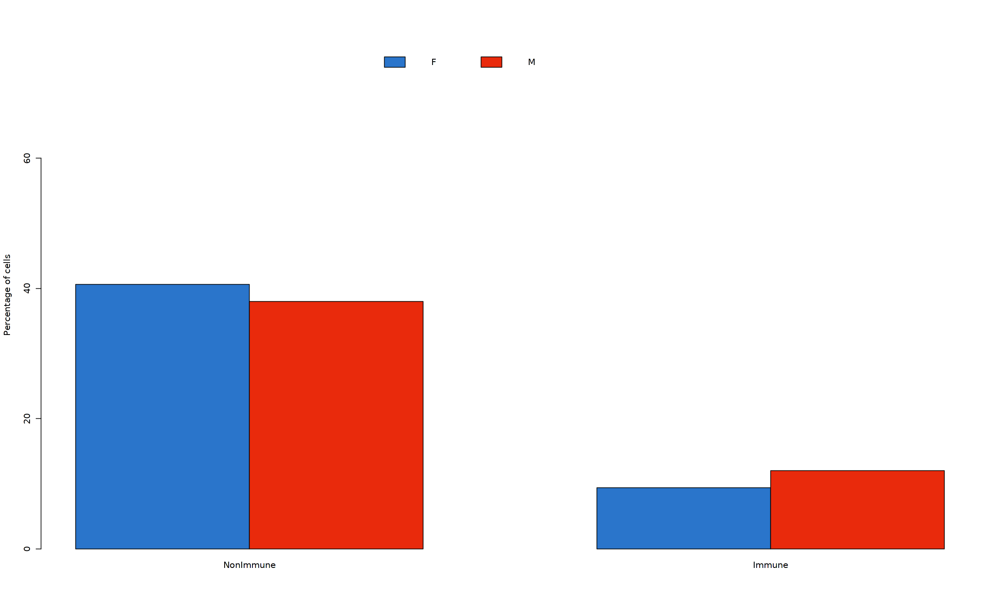

In [39]:
options(repr.plot.width=20, repr.plot.height=12)
barplot(t(t_percent), beside=TRUE, xlab = "", ylab="Percentage of cells", legend = TRUE, ylim = c(0, round_any(as.integer(max(rowSums(t_percent))), 1, f = ceiling)), col = rev(sex_colors), args.legend = list(bty = "n", x = "top", ncol = 3))

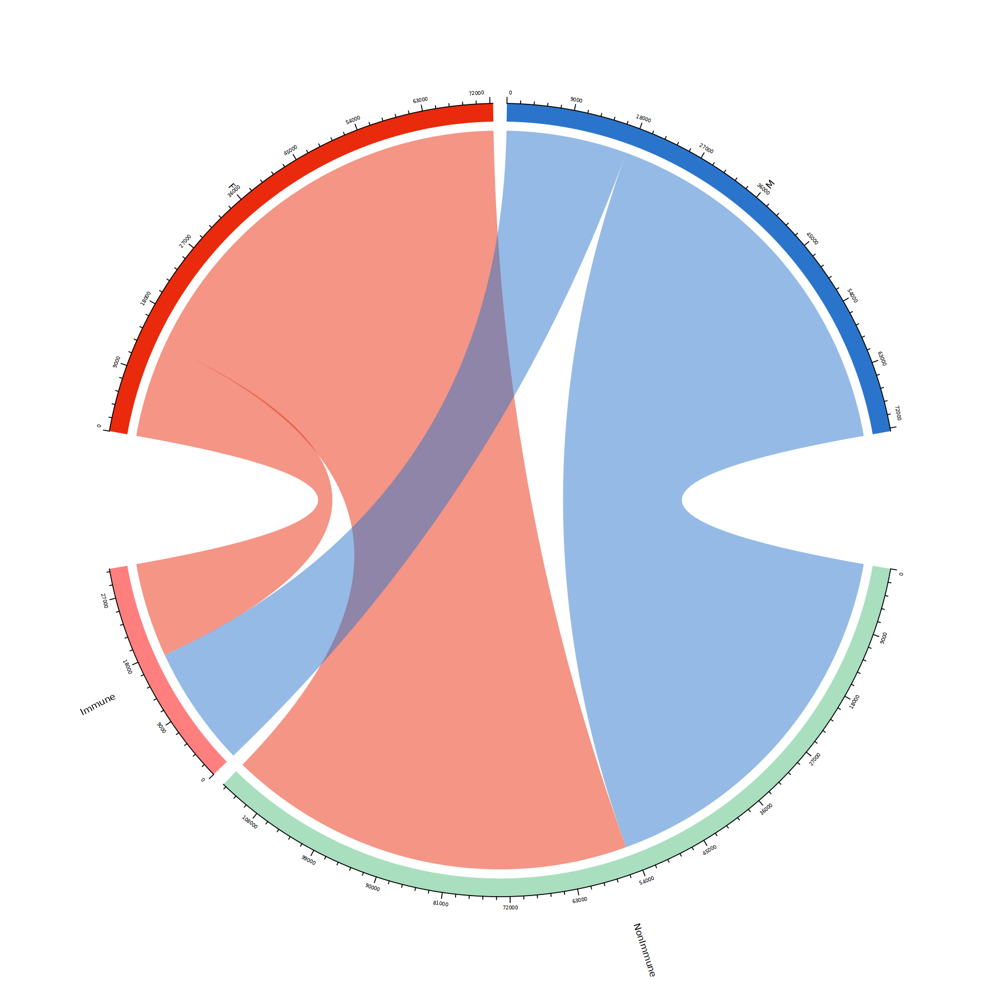

In [40]:
options(repr.plot.width=15, repr.plot.height=15)
set.seed(115)
mat = as.matrix(table(MORNAATACC@meta.data$Sex, MORNAATACC@meta.data$Immune))
for (row in 1:nrow(mat)) mat[row,] <- as.integer(mat[row,]/(sum(mat[row,])/min(rowSums(mat))))
circos.clear()
par(cex = 0.8)
chordDiagram(mat, annotationTrack = c("grid", "axis"), preAllocateTracks = list(track.height = max(strwidth(unlist(dimnames(mat))))/3), big.gap = 20, small.gap = 2, order = c(names(immune_colors), names(sex_colors)), grid.col=c(rev(sex_colors),immune_colors))
circos.track(track.index = 1, panel.fun = function(x, y) {circos.text(CELL_META$xcenter, CELL_META$ylim[1], CELL_META$sector.index, facing = "clockwise", niceFacing = TRUE, adj = c(-0.7, 0.5))}, bg.border = NA)

### 3.2 Gender DGE

In [41]:
DefaultAssay(MORNAATACC) <- "RNA"

#### 3.2.1 Naive

In [42]:
timepoint <- "Naive"
name_timepoint <- names_Naive

In [43]:
tmp <- subset(MORNAATACC, subset = orig.ident_merge == timepoint)

In [44]:
tmp <- NormalizeData(tmp, normalization.method = "LogNormalize", scale.factor = 10000, verbose = TRUE)

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


In [45]:
tmp <- ScaleData(tmp, features=rownames(tmp))

Centering and scaling data matrix

  |======================================================================| 100%


In [46]:
timepoint_Sex_colors <- c(rep(sex_colors["F"], length(name_timepoint)),rep(sex_colors["M"], length(name_timepoint)))
df_timepoint_Sex <- expand.grid(name_timepoint, names(sex_colors))
names(timepoint_Sex_colors) <- paste0(df_timepoint_Sex[,1],df_timepoint_Sex[,2])

In [47]:
tmp$orig.ident_Sex <- paste0(tmp$orig.ident,tmp$Sex)
tmp$orig.ident_Sex <- factor(paste0(tmp$orig.ident,tmp$Sex), levels=names(table(tmp$orig.ident_Sex)))

In [48]:
tmp$orig.ident <- factor(tmp$orig.ident, levels=name_timepoint)
tmp$cellType <- factor(tmp$cellType, levels=names(cellType_colors))
tmp$Sex <- factor(tmp$Sex, levels=names(sex_colors))

In [49]:
table(tmp$cellType, tmp$orig.ident_Sex)

        
         Naive1F Naive1M Naive2F Naive2M Naive3F Naive3M
  OPC         13       9      87      88      80      97
  COP          5       2      42      33      23      18
  MOL       1747    2377    2411    3598    2303    3369
  Astro       90     471     264     346     111     103
  Epen         6      57      54      92      20      27
  Micro       91     497       8       5      39      36
  Neuron       0       0       0       0       1       0

In [50]:
table(tmp$cellType, tmp$Sex)

        
            F    M
  OPC     180  194
  COP      70   53
  MOL    6461 9344
  Astro   465  920
  Epen     80  176
  Micro   138  538
  Neuron    1    0

In [51]:
table(tmp$orig.ident_Sex, tmp$Sex)

         
             F    M
  Naive1F 1952    0
  Naive1M    0 3413
  Naive2F 2866    0
  Naive2M    0 4162
  Naive3F 2577    0
  Naive3M    0 3650

In [52]:
MORNAATACC_sce <- as.SingleCellExperiment(tmp, assay="RNA")

In [53]:
MORNAATACC_sce <- prepSCE(MORNAATACC_sce, kid = "cellType", gid = "Sex", sid = "orig.ident_Sex", drop = TRUE)

In [54]:
kids <- purrr::set_names(levels(MORNAATACC_sce$cluster_id))

# Total number of clusters
nk <- length(kids)

# Named vector of sample names
sids <- purrr::set_names(levels(MORNAATACC_sce$sample_id))

# Total number of samples 
ns <- length(sids)

In [55]:
kids
sids

OPC      COP      MOL    Astro     Epen    Micro   Neuron 
   "OPC"    "COP"    "MOL"  "Astro"   "Epen"  "Micro" "Neuron"

Naive1F   Naive1M   Naive2F   Naive2M   Naive3F   Naive3M 
"Naive1F" "Naive1M" "Naive2F" "Naive2M" "Naive3F" "Naive3M"

In [56]:
## Determine the number of cells per sample
table(MORNAATACC_sce$sample_id)

## Turn named vector into a numeric vector of number of cells per sample
n_cells <- as.numeric(table(MORNAATACC_sce$sample_id))

## Determine how to reoder the samples (rows) of the metadata to match the order of sample names in sids vector
m <- match(sids, MORNAATACC_sce$sample_id)

## Create the sample level metadata by combining the reordered metadata with the number of cells corresponding to each sample.
ei <- data.frame(colData(MORNAATACC_sce)[m, ], n_cells, row.names = NULL) %>% select(-"cluster_id")
ei


Naive1F Naive1M Naive2F Naive2M Naive3F Naive3M 
   1952    3413    2866    4162    2577    3650 

sample_id,group_id,n_cells
<fct>,<fct>,<dbl>
Naive1F,F,1952
Naive1M,M,3413
Naive2F,F,2866
Naive2M,M,4162
Naive3F,F,2577
Naive3M,M,3650


In [57]:
## Remove lowly accessible features which have less than 10 cells with any counts
MORNAATACC_sce <- MORNAATACC_sce[rowSums(counts(MORNAATACC_sce) > 1) >= 10, ]

In [58]:
# Aggregate the counts per sample_id and cluster_id

# Subset metadata to only include the cluster and sample IDs to aggregate across
groups <- colData(MORNAATACC_sce)[, c("cluster_id", "sample_id")]

# Aggregate across cluster-sample groups
pb <- aggregate.Matrix(t(counts(MORNAATACC_sce)), groupings = groups, fun = "sum") 

In [59]:
splitf <- sapply(stringr::str_split(rownames(pb), pattern = "_", n = 2), `[`, 1)

In [60]:
pb <- split.data.frame(pb, factor(splitf)) %>% lapply(function(u) set_colnames(t(u), stringr::str_extract(rownames(u), "(?<=_)[:alnum:]+")))

class(pb)

# Explore the different components of list
str(pb)

[1] "list"

List of 7
 $ Astro :Formal class 'dgCMatrix' [package "Matrix"] with 6 slots
  .. ..@ i       : int [1:71611] 0 1 2 3 5 6 7 9 10 11 ...
  .. ..@ p       : int [1:7] 0 10915 22962 35291 47636 59739 71611
  .. ..@ Dim     : int [1:2] 13103 6
  .. ..@ Dimnames:List of 2
  .. .. ..$ : chr [1:13103] "0610009B22Rik" "0610009E02Rik" "0610009L18Rik" "0610010F05Rik" ...
  .. .. ..$ : chr [1:6] "Naive1F" "Naive1M" "Naive2F" "Naive2M" ...
  .. ..@ x       : num [1:71611] 2 4 1 6 4 6 4 1 7 3 ...
  .. ..@ factors : list()
 $ COP   :Formal class 'dgCMatrix' [package "Matrix"] with 6 slots
  .. ..@ i       : int [1:51431] 2 3 6 16 22 27 30 31 35 36 ...
  .. ..@ p       : int [1:7] 0 4503 7227 18677 29856 40811 51431
  .. ..@ Dim     : int [1:2] 13103 6
  .. ..@ Dimnames:List of 2
  .. .. ..$ : chr [1:13103] "0610009B22Rik" "0610009E02Rik" "0610009L18Rik" "0610010F05Rik" ...
  .. .. ..$ : chr [1:6] "Naive1F" "Naive1M" "Naive2F" "Naive2M" ...
  .. ..@ x       : num [1:51431] 1 2 1 1 3 1 1 2 1 1 ...
  .

In [61]:
options(width = 100)
table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$group_id)

        
            F    M
  OPC     180  194
  COP      70   53
  MOL    6461 9344
  Astro   465  920
  Epen     80  176
  Micro   138  538
  Neuron    1    0

In [62]:
options(width = 100)
table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$sample_id)

        
         Naive1F Naive1M Naive2F Naive2M Naive3F Naive3M
  OPC         13       9      87      88      80      97
  COP          5       2      42      33      23      18
  MOL       1747    2377    2411    3598    2303    3369
  Astro       90     471     264     346     111     103
  Epen         6      57      54      92      20      27
  Micro       91     497       8       5      39      36
  Neuron       0       0       0       0       1       0

In [63]:
# Get sample names for each of the cell type clusters

# prep. data.frame for plotting
get_sample_ids <- function(x){pb[[x]] %>% colnames()}

de_samples <- purrr::map(1:length(kids), get_sample_ids) %>% unlist()

In [64]:
samples_list <- purrr::map(1:length(kids), get_sample_ids)

get_cluster_ids <- function(x){rep(names(pb)[x],each = length(samples_list[[x]]))}

de_cluster_ids <- purrr::map(1:length(kids), get_cluster_ids) %>% unlist()

In [65]:
gg_df <- data.frame(cluster_id = de_cluster_ids, sample_id = de_samples)

gg_df <- left_join(gg_df, ei[, c("sample_id", "group_id")]) 

metadata <- gg_df %>% dplyr::select(cluster_id, sample_id, group_id) 

Joining with `by = join_by(sample_id)`


In [66]:
levels(metadata$cluster_id) <- unique(metadata$cluster_id)

In [67]:
# Generate vector of cluster IDs
clusters <- levels(metadata$cluster_id)
clusters

[1] "Astro"  "COP"    "Epen"   "MOL"    "Micro"  "Neuron" "OPC"

In [68]:
HVGs.list <- list()

##### 3.2.1.1 MOL

In [69]:
cluster_choice <- "MOL"

In [70]:
table_sample_low <- table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$sample_id)[cluster_choice,][table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$sample_id)[cluster_choice,] <= 5]
table_sample_low

sample_keep <- names(timepoint_Sex_colors)[!names(timepoint_Sex_colors) %in% names(table_sample_low)]

named integer(0)

In [71]:
table_group_low <-table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$group_id)[cluster_choice,][table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$group_id)[cluster_choice,] <= 30]
table_group_low

group_keep <- names(sex_colors)[!names(sex_colors) %in% names(table_group_low)]

named integer(0)

In [72]:
cluster_metadata <- metadata[which(metadata$cluster_id == cluster_choice), ]

# Assign the rownames of the metadata to be the sample IDs
rownames(cluster_metadata) <- cluster_metadata$sample_id

In [73]:
#Remove sample and timepoint with low counts (sample<=5, timepoint<=30)
cluster_metadata <- cluster_metadata[(cluster_metadata$sample_id %in% sample_keep & cluster_metadata$group_id %in% group_keep),]

#new_sample_levels <- levels(cluster_metadata$sample_id)[levels(cluster_metadata$sample_id) %in% sample_keep]
#cluster_metadata$sample_id <- droplevels(cluster_metadata$sample_id)
#levels(cluster_metadata$sample_id) <- new_sample_levels

new_group_levels <- levels(cluster_metadata$group_id)[levels(cluster_metadata$group_id) %in% group_keep]
cluster_metadata$group_id <- droplevels(cluster_metadata$group_id)
levels(cluster_metadata$group_id) <- new_group_levels

In [74]:
cluster_metadata

,cluster_id,sample_id,group_id
,<chr>,<chr>,<fct>
Naive1F,MOL,Naive1F,F
Naive1M,MOL,Naive1M,M
Naive2F,MOL,Naive2F,F
Naive2M,MOL,Naive2M,M
Naive3F,MOL,Naive3F,F
Naive3M,MOL,Naive3M,M


In [75]:
# Subset the counts to only this cluster
counts <- pb[[cluster_choice]]

cluster_counts <- data.frame(counts[, which(colnames(counts) %in% rownames(cluster_metadata))])

# Check that all of the row names of the metadata are the same and in the same order as the column names of the counts in order to use as input to DESeq2
all(rownames(cluster_metadata) == colnames(cluster_counts))

[1] TRUE

In [76]:
dds <- DESeqDataSetFromMatrix(cluster_counts, colData = cluster_metadata, design = ~ group_id)

converting counts to integer mode



In [77]:
# Transform counts for data visualization
rld <- rlog(dds, blind=TRUE)

using ntop=500 top features by variance



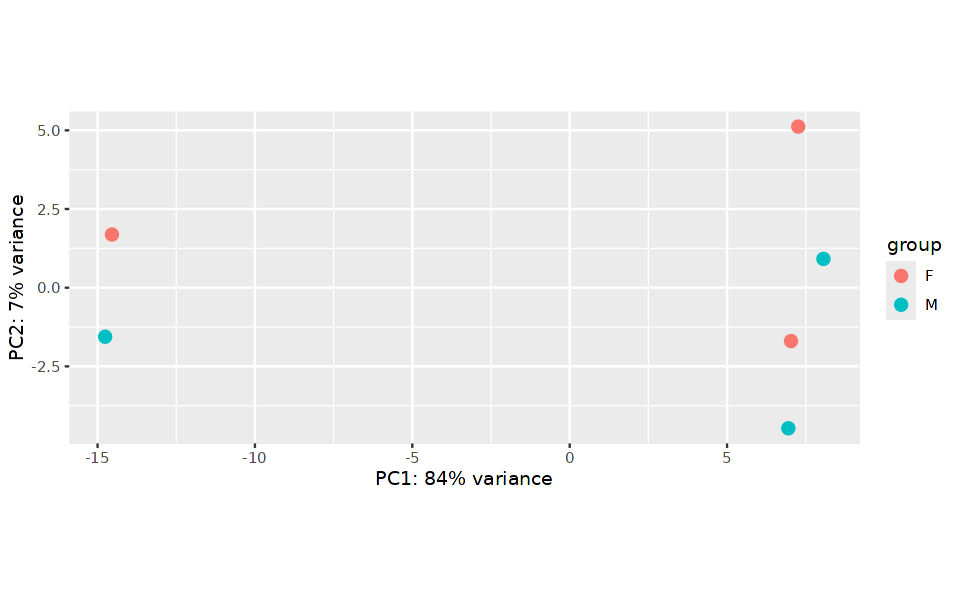

In [78]:
# Plot PCA
options(repr.plot.width=8, repr.plot.height=5)
DESeq2::plotPCA(rld, intgroup = "group_id")

In [79]:
# Extract the rlog matrix from the object and compute pairwise correlation values
rld_mat <- assay(rld)
rld_cor <- cor(rld_mat)

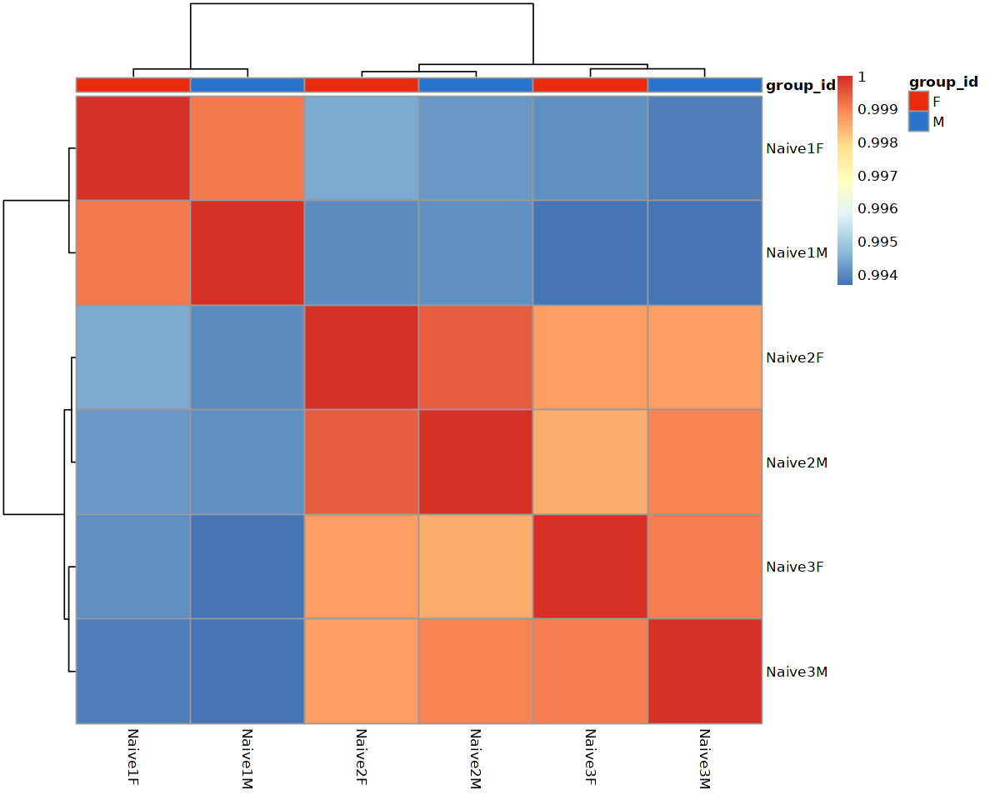

In [80]:
# Plot heatmap
options(repr.plot.width=10, repr.plot.height=8)
pheatmap(rld_cor, annotation = cluster_metadata[, c("group_id"), drop=F], annotation_colors = list(group_id=sex_colors))

In [81]:
# Run DESeq2 differential expression analysis
dds <- DESeq(dds)

estimating size factors

estimating dispersions

gene-wise dispersion estimates

mean-dispersion relationship

final dispersion estimates

fitting model and testing



In [82]:
libsize = data.frame(x=sizeFactors(dds), y=colSums(assay(dds)))

`geom_smooth()` using formula = 'y ~ x'


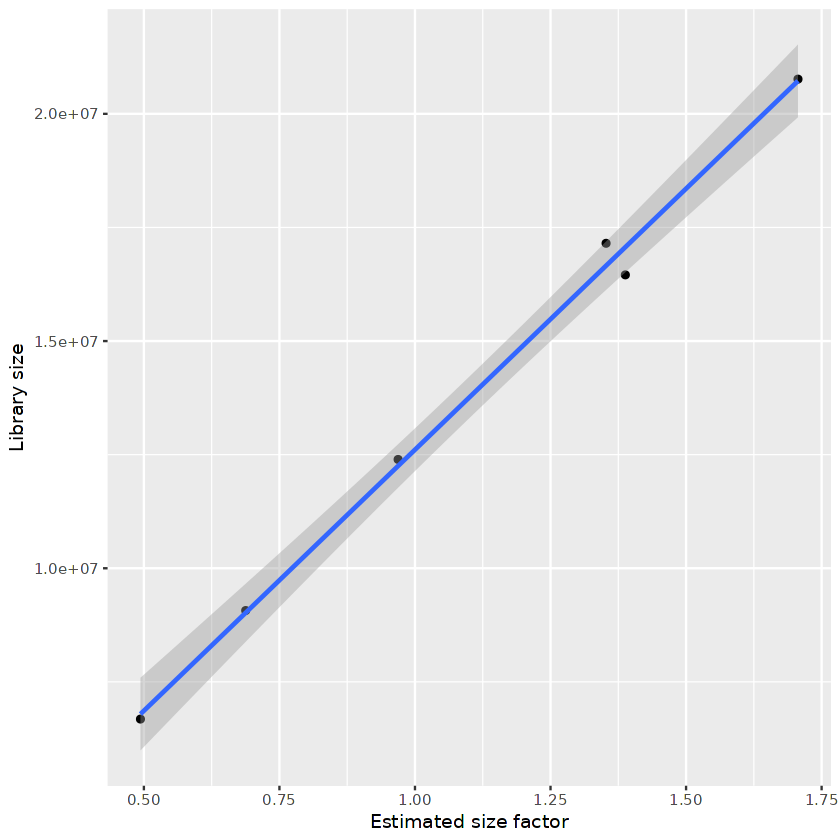

In [83]:
options(repr.plot.width=7, repr.plot.height=7)
ggplot(data=libsize, aes(x=x, y=y)) + geom_point() + geom_smooth(method="lm") + xlab("Estimated size factor") + ylab("Library size")

In [84]:
data.frame(colData(dds))

,cluster_id,sample_id,group_id,sizeFactor
,<chr>,<chr>,<fct>,<dbl>
Naive1F,MOL,Naive1F,F,0.4936934
Naive1M,MOL,Naive1M,M,0.6877925
Naive2F,MOL,Naive2F,F,0.9689063
Naive2M,MOL,Naive2M,M,1.3524706
Naive3F,MOL,Naive3F,F,1.3880117
Naive3M,MOL,Naive3M,M,1.7064227


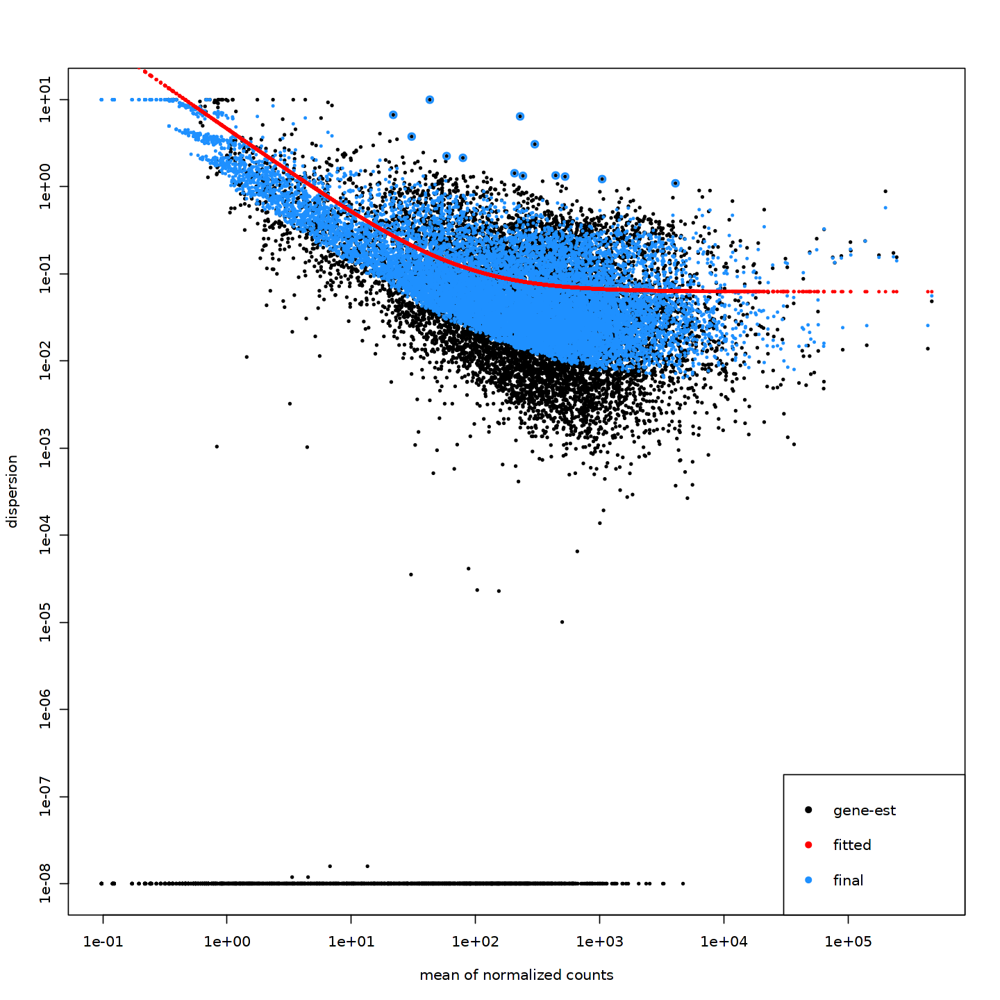

In [85]:
# Plot dispersion estimates
options(repr.plot.width=12, repr.plot.height=12)
plotDispEsts(dds)

In [86]:
condition1 = "M"
condition2 = "F"

In [87]:
contrast <- c("group_id", condition1, condition2)

# resultsNames(dds)
res <- results(dds, contrast = contrast, alpha = 0.05)

In [88]:
summary(res)


out of 13081 with nonzero total read count
adjusted p-value < 0.05
LFC > 0 (up)       : 4, 0.031%
LFC < 0 (down)     : 2, 0.015%
outliers [1]       : 2, 0.015%
low counts [2]     : 0, 0%
(mean count < 0)
[1] see 'cooksCutoff' argument of ?results
[2] see 'independentFiltering' argument of ?results



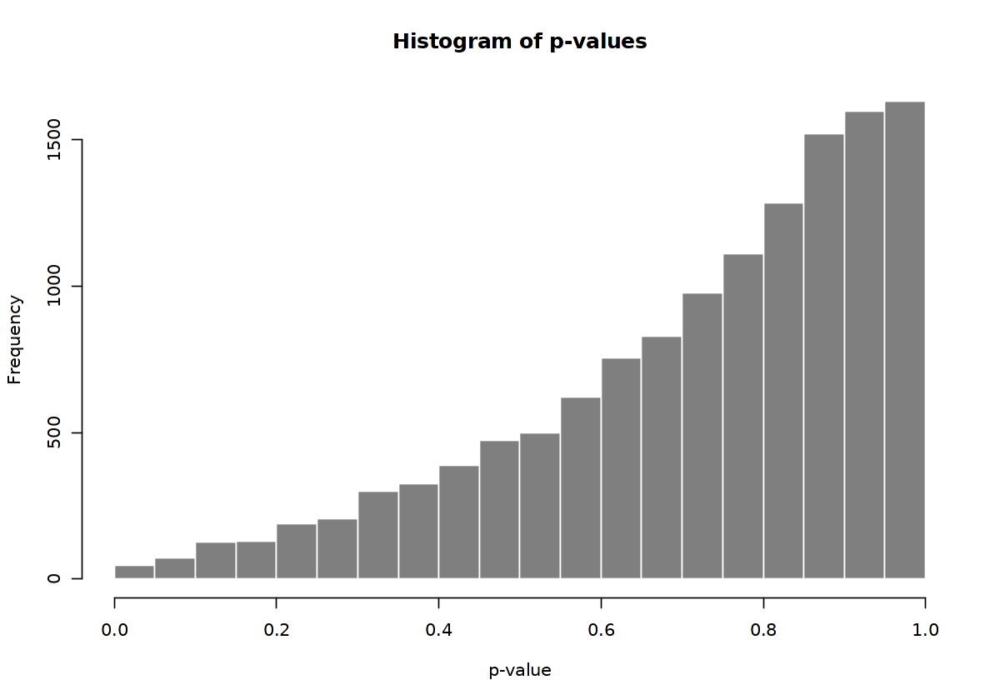

In [89]:
options(repr.plot.width=10, repr.plot.height=7)
hist(res$pvalue, breaks=0:20/20, col="grey50", border="white", xlim=c(0,1), main="Histogram of p-values", xlab="p-value")

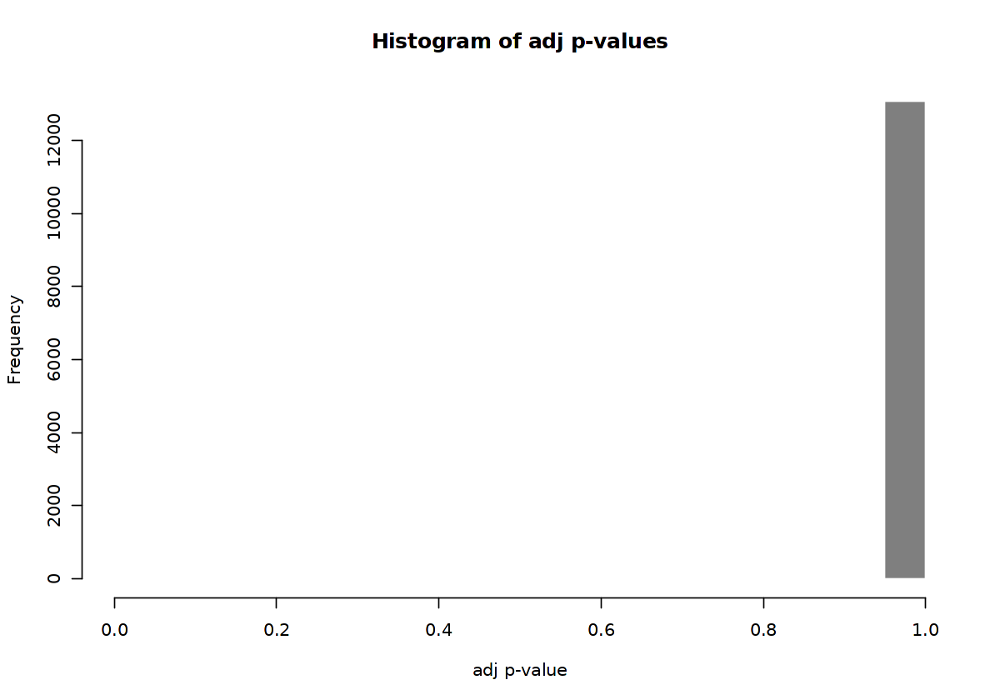

In [90]:
options(repr.plot.width=10, repr.plot.height=7)
hist(res$padj, breaks=0:20/20, col="grey50", border="white", xlim=c(0,1), main="Histogram of adj p-values", xlab="adj p-value")

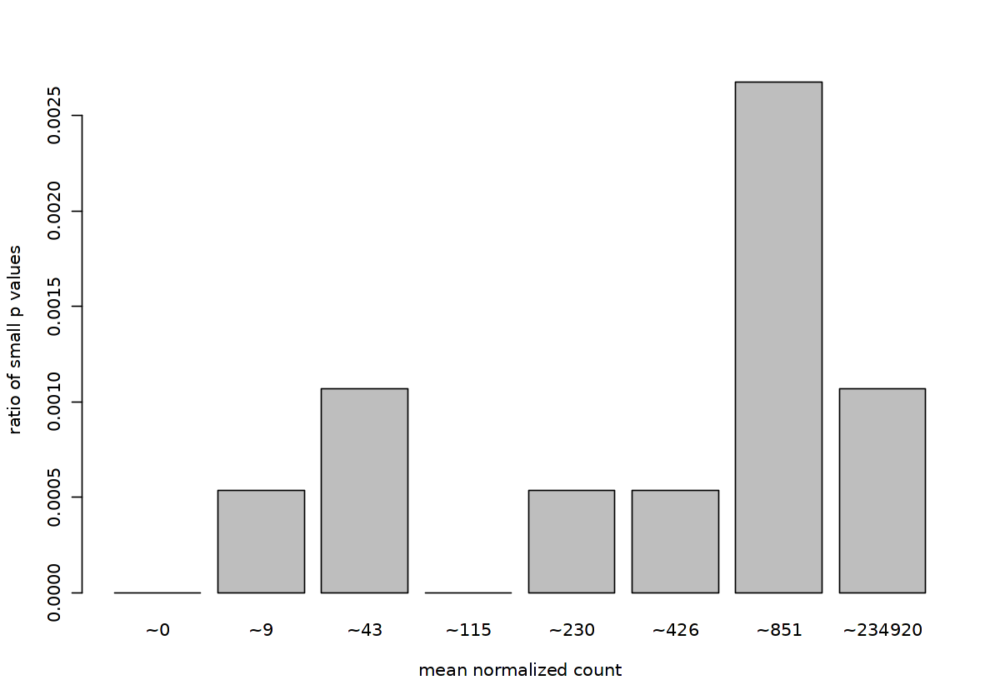

In [91]:
options(repr.plot.width=10, repr.plot.height=7)
qs <- c(0, quantile(res$baseMean[res$baseMean > 0], 0:7/7))
# cut the genes into the bins
bins <- cut(res$baseMean, qs)
# rename the levels of the bins using the middle point
levels(bins) <- paste0("~",round(.5*qs[-1] + .5*qs[-length(qs)]))
# calculate the ratio of $p$ values less than .01 for each bin
ratios <- tapply(res$pvalue, bins, function(p) mean(p < .01, na.rm=TRUE))
# plot these ratios
barplot(ratios, xlab="mean normalized count", ylab="ratio of small p values")

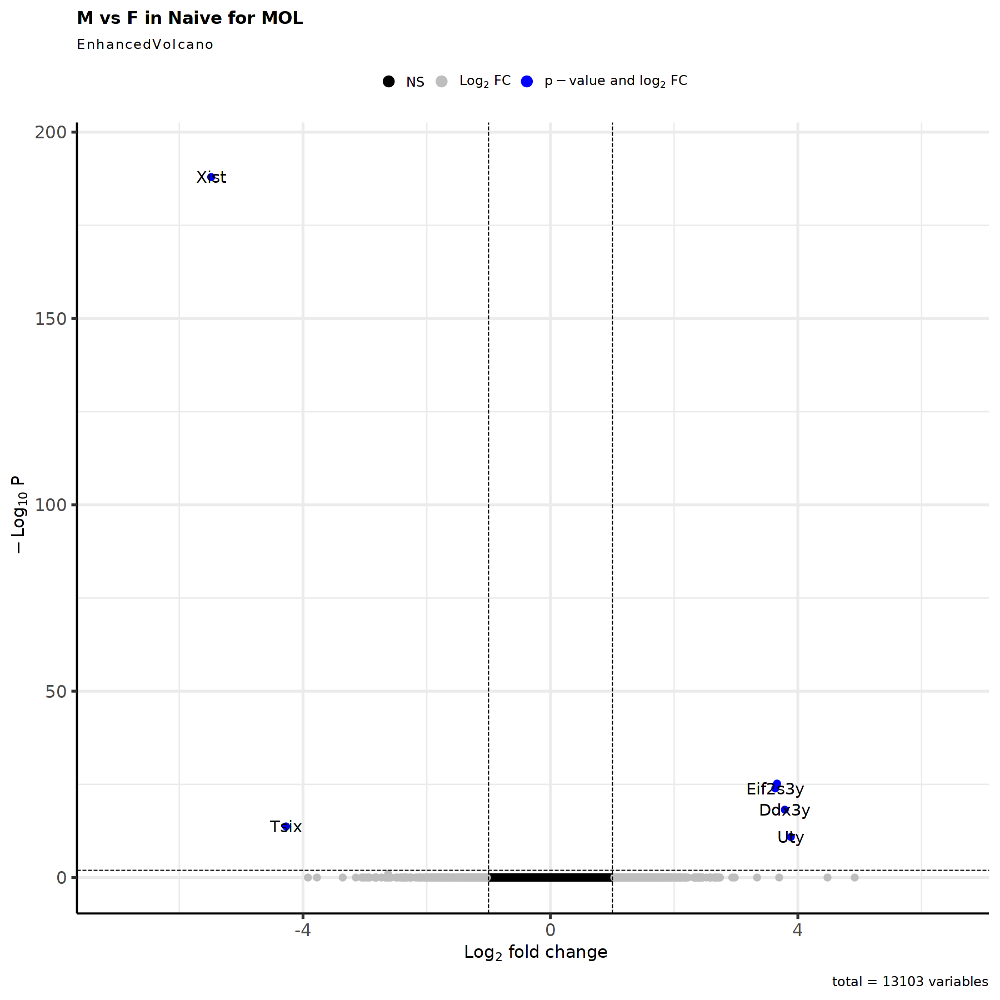

In [92]:
options(repr.plot.width=15, repr.plot.height=15)
#padj<0.001
EnhancedVolcano(res,
    lab = rownames(res),
    x = 'log2FoldChange',
    y = 'padj',
    title = paste0('M vs F in ',timepoint,' for ', cluster_choice),
    pCutoff = 0.01,
    FCcutoff = 1,
    pointSize = 3.0,
    labSize = 6.0,
    col=c('black', 'grey', 'grey', 'blue'),
    colAlpha = 1)

In [93]:
res <- res[complete.cases(res$padj),]

In [94]:
res_filtered <- res[(res$padj < 0.01 & abs(res$log2FoldChange) > 1 & res$baseMean > 1),]

In [95]:
res_filtered[order(abs(res_filtered$log2FoldChange), decreasing=TRUE),]

log2 fold change (MLE): group_id M vs F 
Wald test p-value: group id M vs F 
DataFrame with 6 rows and 6 columns
         baseMean log2FoldChange     lfcSE      stat       pvalue         padj
        <numeric>      <numeric> <numeric> <numeric>    <numeric>    <numeric>
Xist     7235.319       -5.48476  0.185179 -29.61866 8.59362e-193 1.12396e-188
Tsix     1103.489       -4.27469  0.496696  -8.60625  7.54920e-18  1.97472e-14
Uty       779.318        3.88626  0.498203   7.80057  6.16277e-15  1.34338e-11
Ddx3y     690.327        3.78905  0.388794   9.74565  1.92546e-22  6.29576e-19
Kdm5d     278.236        3.66361  0.323415  11.32791  9.54574e-30  6.24244e-26
Eif2s3y   584.561        3.63461  0.329622  11.02662  2.84354e-28  1.23969e-24

In [96]:
nrow(res_filtered)

[1] 6

In [97]:
top.genes.number <- ifelse(nrow(res_filtered)>100, 100, nrow(res_filtered))

In [98]:
res_top <- res_filtered[order(abs(res_filtered$log2FoldChange), decreasing=TRUE),][1:top.genes.number,]
res_top <- res_top[order(res_top$log2FoldChange, decreasing=FALSE),]

In [99]:
tmp_sub <- subset(tmp, subset = cellType == cluster_choice)

In [100]:
tmp_sub <- NormalizeData(tmp_sub, normalization.method = "LogNormalize", scale.factor = 10000, verbose = TRUE)

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


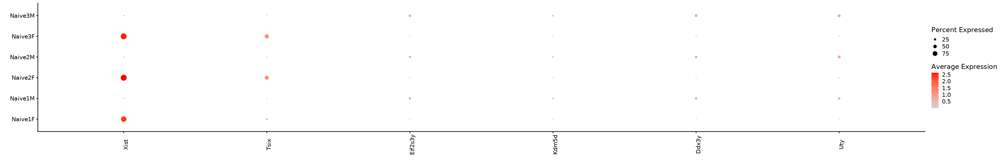

In [101]:
options(repr.plot.width=30, repr.plot.height=5)
plot <- DotPlot(tmp_sub, assay = "RNA", group.by = "orig.ident_Sex", scale=FALSE, cols = c("lightgrey", "red"), dot.scale = 5, features = rownames(res_top))
plot + theme(axis.text.x = element_text(angle = 90)) + labs(x = "", y= "")

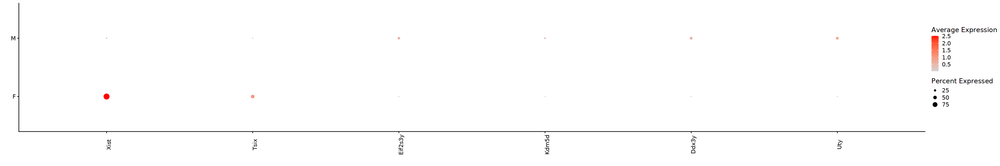

In [102]:
options(repr.plot.width=30, repr.plot.height=5)
plot <- DotPlot(tmp_sub, assay = "RNA", group.by = "Sex", scale=FALSE, cols = c("lightgrey", "red"), dot.scale = 5, features = rownames(res_top))
plot + theme(axis.text.x = element_text(angle = 90)) + labs(x = "", y= "")

In [103]:
HVGs.list[[cluster_choice]] <- rownames(res_filtered)

##### 3.2.1.2 OPC

In [104]:
cluster_choice <- "OPC"

In [105]:
table_sample_low <- table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$sample_id)[cluster_choice,][table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$sample_id)[cluster_choice,] <= 5]
table_sample_low

sample_keep <- names(timepoint_Sex_colors)[!names(timepoint_Sex_colors) %in% names(table_sample_low)]

named integer(0)

In [106]:
table_group_low <-table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$group_id)[cluster_choice,][table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$group_id)[cluster_choice,] <= 30]
table_group_low

group_keep <- names(sex_colors)[!names(sex_colors) %in% names(table_group_low)]

named integer(0)

In [107]:
cluster_metadata <- metadata[which(metadata$cluster_id == cluster_choice), ]

# Assign the rownames of the metadata to be the sample IDs
rownames(cluster_metadata) <- cluster_metadata$sample_id

In [108]:
#Remove sample and timepoint with low counts (sample<=5, timepoint<=30)
cluster_metadata <- cluster_metadata[(cluster_metadata$sample_id %in% sample_keep & cluster_metadata$group_id %in% group_keep),]

#new_sample_levels <- levels(cluster_metadata$sample_id)[levels(cluster_metadata$sample_id) %in% sample_keep]
#cluster_metadata$sample_id <- droplevels(cluster_metadata$sample_id)
#levels(cluster_metadata$sample_id) <- new_sample_levels

new_group_levels <- levels(cluster_metadata$group_id)[levels(cluster_metadata$group_id) %in% group_keep]
cluster_metadata$group_id <- droplevels(cluster_metadata$group_id)
levels(cluster_metadata$group_id) <- new_group_levels

In [109]:
cluster_metadata

,cluster_id,sample_id,group_id
,<chr>,<chr>,<fct>
Naive1F,OPC,Naive1F,F
Naive1M,OPC,Naive1M,M
Naive2F,OPC,Naive2F,F
Naive2M,OPC,Naive2M,M
Naive3F,OPC,Naive3F,F
Naive3M,OPC,Naive3M,M


In [110]:
# Subset the counts to only this cluster
counts <- pb[[cluster_choice]]

cluster_counts <- data.frame(counts[, which(colnames(counts) %in% rownames(cluster_metadata))])

# Check that all of the row names of the metadata are the same and in the same order as the column names of the counts in order to use as input to DESeq2
all(rownames(cluster_metadata) == colnames(cluster_counts))

[1] TRUE

In [111]:
dds <- DESeqDataSetFromMatrix(cluster_counts, colData = cluster_metadata, design = ~ group_id)

converting counts to integer mode



In [112]:
# Transform counts for data visualization
rld <- rlog(dds, blind=TRUE)

using ntop=500 top features by variance



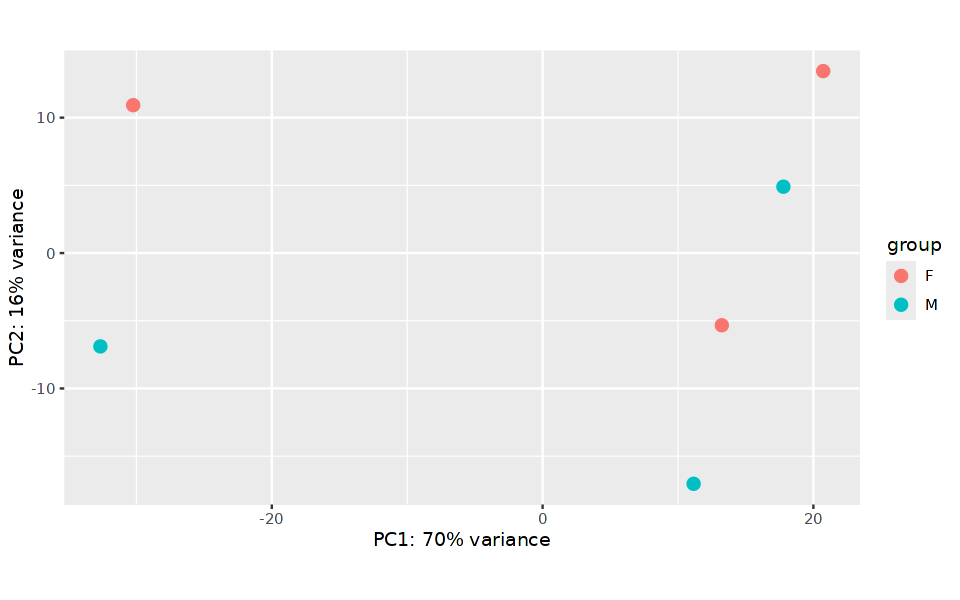

In [113]:
# Plot PCA
options(repr.plot.width=8, repr.plot.height=5)
DESeq2::plotPCA(rld, intgroup = "group_id")

In [114]:
# Extract the rlog matrix from the object and compute pairwise correlation values
rld_mat <- assay(rld)
rld_cor <- cor(rld_mat)

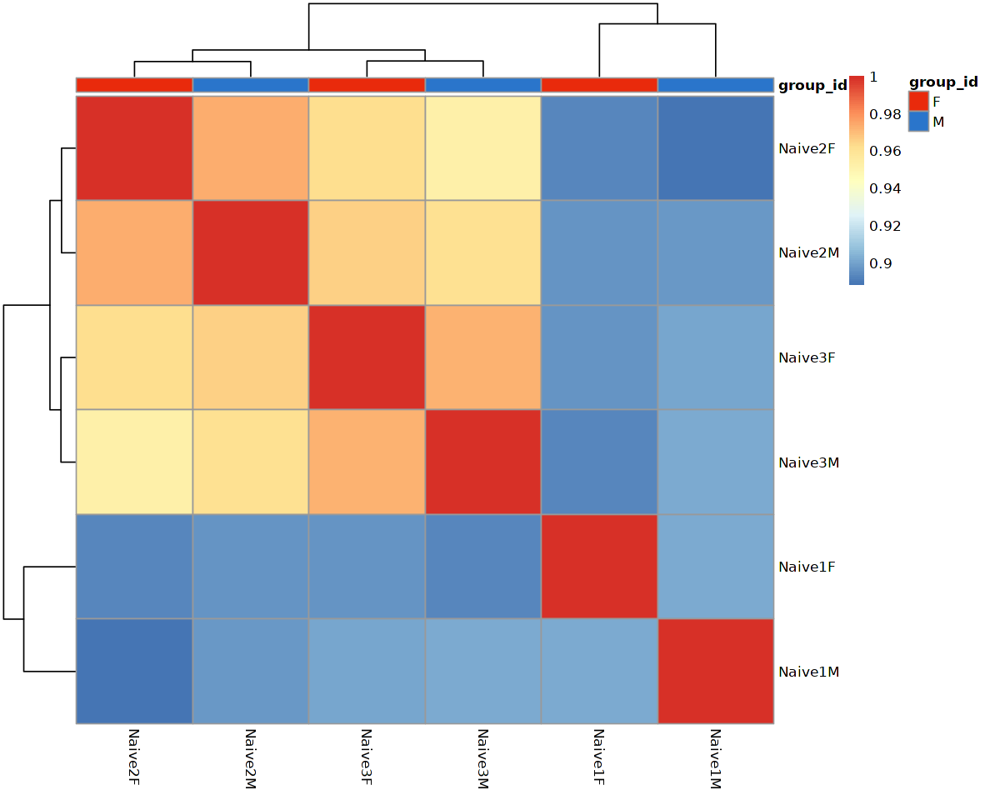

In [115]:
# Plot heatmap
options(repr.plot.width=10, repr.plot.height=8)
pheatmap(rld_cor, annotation = cluster_metadata[, c("group_id"), drop=F], annotation_colors = list(group_id=sex_colors))

In [116]:
# Run DESeq2 differential expression analysis
dds <- DESeq(dds)

estimating size factors

estimating dispersions

gene-wise dispersion estimates

mean-dispersion relationship

final dispersion estimates

fitting model and testing



In [117]:
libsize = data.frame(x=sizeFactors(dds), y=colSums(assay(dds)))

`geom_smooth()` using formula = 'y ~ x'


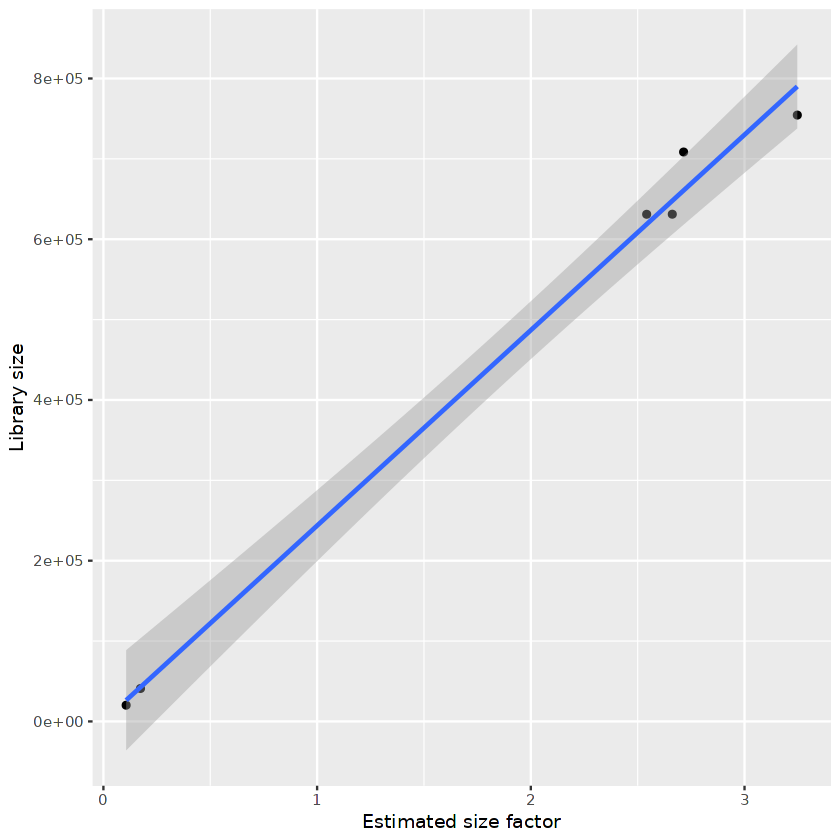

In [118]:
options(repr.plot.width=7, repr.plot.height=7)
ggplot(data=libsize, aes(x=x, y=y)) + geom_point() + geom_smooth(method="lm") + xlab("Estimated size factor") + ylab("Library size")

In [119]:
data.frame(colData(dds))

,cluster_id,sample_id,group_id,sizeFactor
,<chr>,<chr>,<fct>,<dbl>
Naive1F,OPC,Naive1F,F,0.1735465
Naive1M,OPC,Naive1M,M,0.1063803
Naive2F,OPC,Naive2F,F,2.7149816
Naive2M,OPC,Naive2M,M,2.5421260
Naive3F,OPC,Naive3F,F,2.6619825
Naive3M,OPC,Naive3M,M,3.2469945


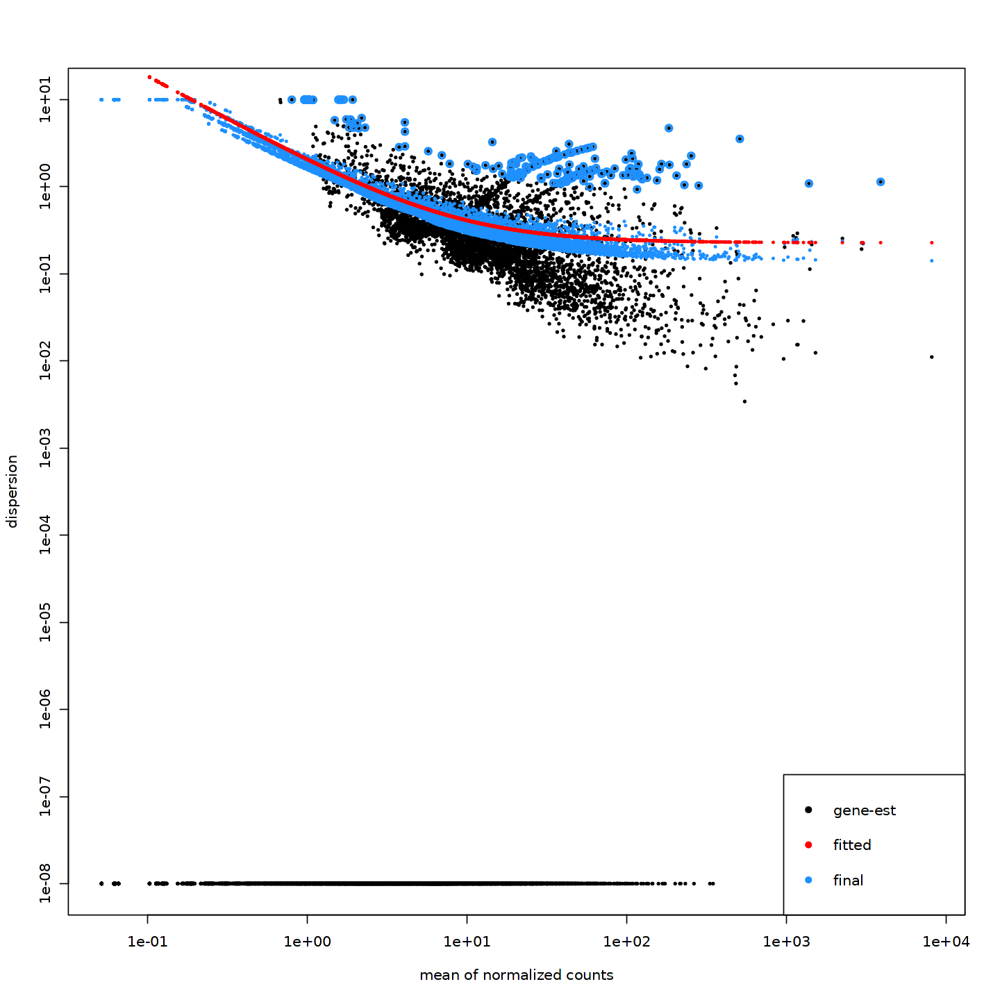

In [120]:
# Plot dispersion estimates
options(repr.plot.width=12, repr.plot.height=12)
plotDispEsts(dds)

In [121]:
condition1 = "M"
condition2 = "F"

In [122]:
contrast <- c("group_id", condition1, condition2)

# resultsNames(dds)
res <- results(dds, contrast = contrast, alpha = 0.05)

In [123]:
summary(res)


out of 12702 with nonzero total read count
adjusted p-value < 0.05
LFC > 0 (up)       : 0, 0%
LFC < 0 (down)     : 2, 0.016%
outliers [1]       : 0, 0%
low counts [2]     : 0, 0%
(mean count < 0)
[1] see 'cooksCutoff' argument of ?results
[2] see 'independentFiltering' argument of ?results



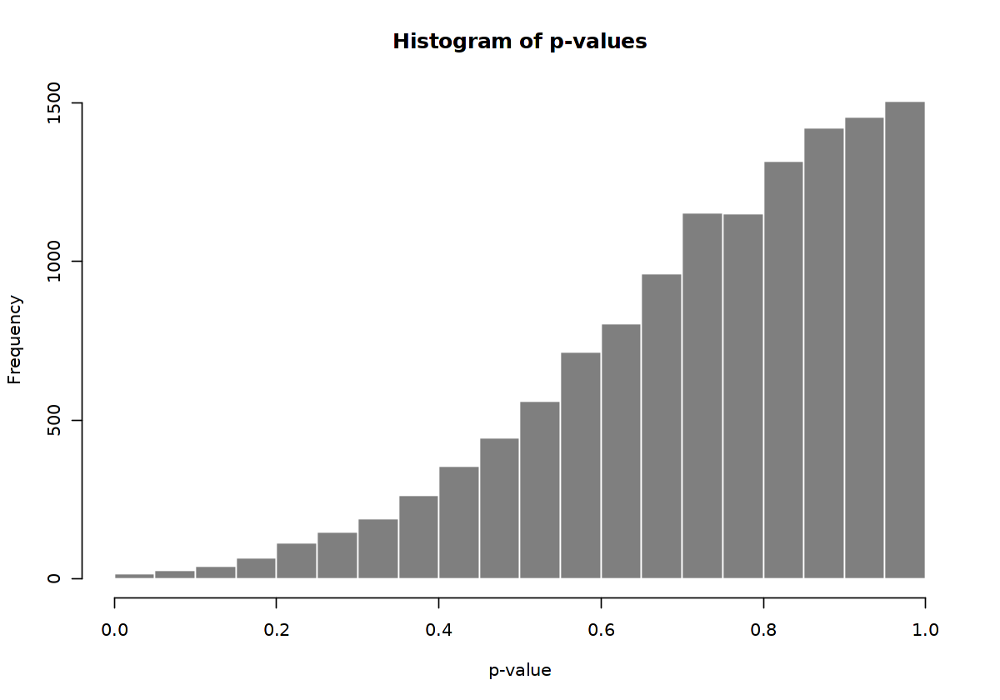

In [124]:
options(repr.plot.width=10, repr.plot.height=7)
hist(res$pvalue, breaks=0:20/20, col="grey50", border="white", xlim=c(0,1), main="Histogram of p-values", xlab="p-value")

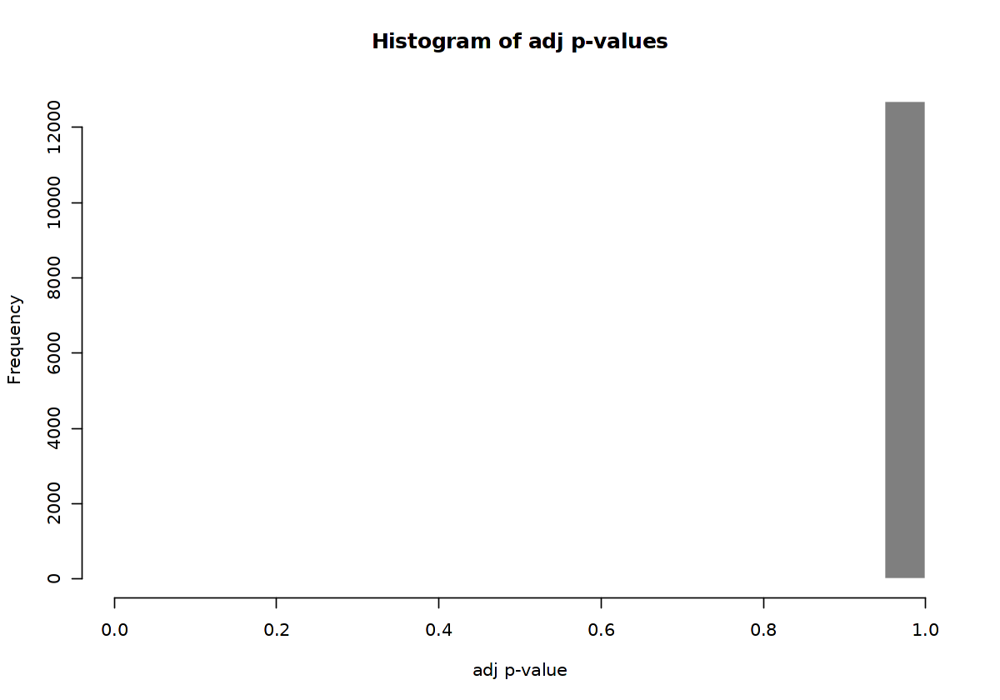

In [125]:
options(repr.plot.width=10, repr.plot.height=7)
hist(res$padj, breaks=0:20/20, col="grey50", border="white", xlim=c(0,1), main="Histogram of adj p-values", xlab="adj p-value")

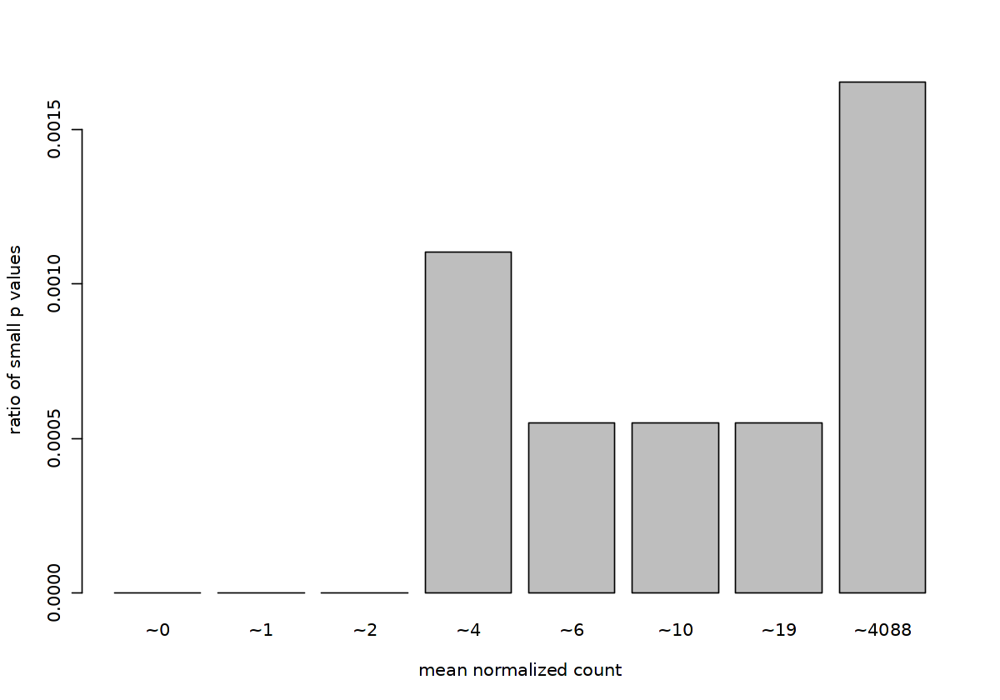

In [126]:
options(repr.plot.width=10, repr.plot.height=7)
qs <- c(0, quantile(res$baseMean[res$baseMean > 0], 0:7/7))
# cut the genes into the bins
bins <- cut(res$baseMean, qs)
# rename the levels of the bins using the middle point
levels(bins) <- paste0("~",round(.5*qs[-1] + .5*qs[-length(qs)]))
# calculate the ratio of $p$ values less than .01 for each bin
ratios <- tapply(res$pvalue, bins, function(p) mean(p < .01, na.rm=TRUE))
# plot these ratios
barplot(ratios, xlab="mean normalized count", ylab="ratio of small p values")

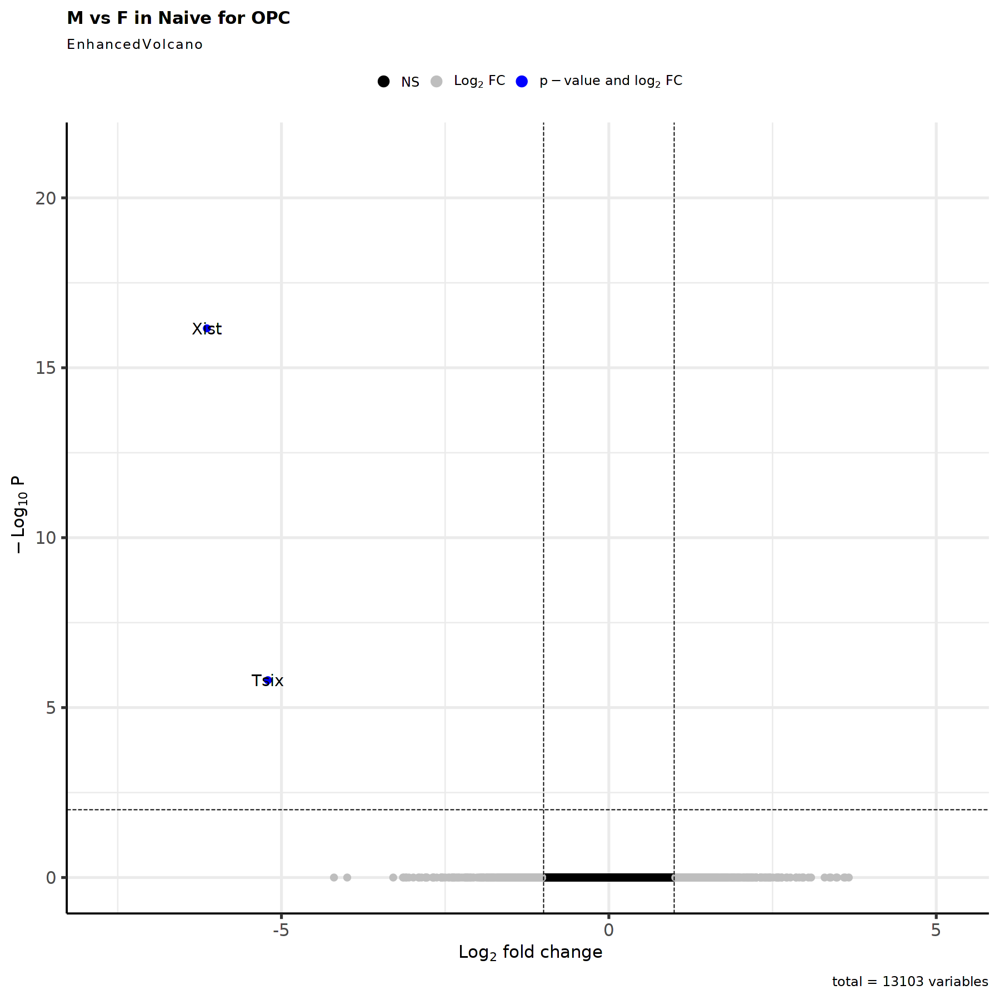

In [127]:
options(repr.plot.width=15, repr.plot.height=15)
#padj<0.001
EnhancedVolcano(res,
    lab = rownames(res),
    x = 'log2FoldChange',
    y = 'padj',
    title = paste0('M vs F in ',timepoint,' for ', cluster_choice),
    pCutoff = 0.01,
    FCcutoff = 1,
    pointSize = 3.0,
    labSize = 6.0,
    col=c('black', 'grey', 'grey', 'blue'),
    colAlpha = 1)

In [128]:
res <- res[complete.cases(res$padj),]

In [129]:
res_filtered <- res[(res$padj < 0.01 & abs(res$log2FoldChange) > 1 & res$baseMean > 1),]

In [130]:
res_filtered[order(abs(res_filtered$log2FoldChange), decreasing=TRUE),]

log2 fold change (MLE): group_id M vs F 
Wald test p-value: group id M vs F 
DataFrame with 2 rows and 6 columns
      baseMean log2FoldChange     lfcSE      stat      pvalue        padj
     <numeric>      <numeric> <numeric> <numeric>   <numeric>   <numeric>
Xist  186.2258       -6.13851  0.653038  -9.39994 5.45963e-21 6.93482e-17
Tsix   26.0294       -5.20692  0.822641  -6.32951 2.45938e-10 1.56195e-06

In [131]:
nrow(res_filtered)

[1] 2

In [132]:
top.genes.number <- ifelse(nrow(res_filtered)>100, 100, nrow(res_filtered))

In [133]:
res_top <- res_filtered[order(abs(res_filtered$log2FoldChange), decreasing=TRUE),][1:top.genes.number,]
res_top <- res_top[order(res_top$log2FoldChange, decreasing=FALSE),]

In [134]:
tmp_sub <- subset(tmp, subset = cellType == cluster_choice)

In [135]:
tmp_sub <- NormalizeData(tmp_sub, normalization.method = "LogNormalize", scale.factor = 10000, verbose = TRUE)

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


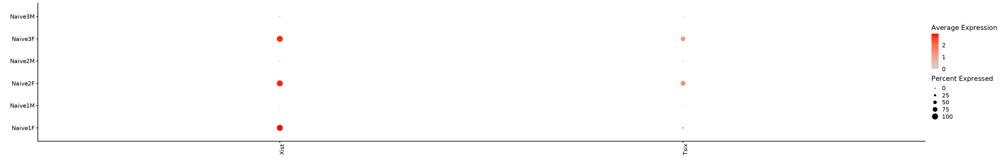

In [136]:
options(repr.plot.width=30, repr.plot.height=5)
plot <- DotPlot(tmp_sub, assay = "RNA", group.by = "orig.ident_Sex", scale=FALSE, cols = c("lightgrey", "red"), dot.scale = 5, features = rownames(res_top))
plot + theme(axis.text.x = element_text(angle = 90)) + labs(x = "", y= "")

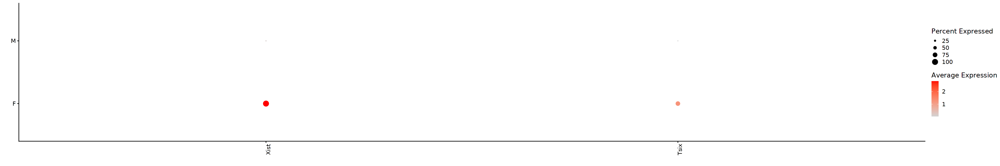

In [137]:
options(repr.plot.width=30, repr.plot.height=5)
plot <- DotPlot(tmp_sub, assay = "RNA", group.by = "Sex", scale=FALSE, cols = c("lightgrey", "red"), dot.scale = 5, features = rownames(res_top))
plot + theme(axis.text.x = element_text(angle = 90)) + labs(x = "", y= "")

In [138]:
HVGs.list[[cluster_choice]] <- rownames(res_filtered)

##### 3.2.1.3 Micro

In [139]:
cluster_choice <- "Micro"

In [140]:
table_sample_low <- table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$sample_id)[cluster_choice,][table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$sample_id)[cluster_choice,] <= 5]
table_sample_low

sample_keep <- names(timepoint_Sex_colors)[!names(timepoint_Sex_colors) %in% names(table_sample_low)]

Naive2M 
      5

In [141]:
table_group_low <-table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$group_id)[cluster_choice,][table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$group_id)[cluster_choice,] <= 30]
table_group_low

group_keep <- names(sex_colors)[!names(sex_colors) %in% names(table_group_low)]

named integer(0)

In [142]:
cluster_metadata <- metadata[which(metadata$cluster_id == cluster_choice), ]

# Assign the rownames of the metadata to be the sample IDs
rownames(cluster_metadata) <- cluster_metadata$sample_id

In [143]:
#Remove sample and timepoint with low counts (sample<=5, timepoint<=30)
cluster_metadata <- cluster_metadata[(cluster_metadata$sample_id %in% sample_keep & cluster_metadata$group_id %in% group_keep),]

#new_sample_levels <- levels(cluster_metadata$sample_id)[levels(cluster_metadata$sample_id) %in% sample_keep]
#cluster_metadata$sample_id <- droplevels(cluster_metadata$sample_id)
#levels(cluster_metadata$sample_id) <- new_sample_levels

new_group_levels <- levels(cluster_metadata$group_id)[levels(cluster_metadata$group_id) %in% group_keep]
cluster_metadata$group_id <- droplevels(cluster_metadata$group_id)
levels(cluster_metadata$group_id) <- new_group_levels

In [144]:
cluster_metadata

,cluster_id,sample_id,group_id
,<chr>,<chr>,<fct>
Naive1F,Micro,Naive1F,F
Naive1M,Micro,Naive1M,M
Naive2F,Micro,Naive2F,F
Naive3F,Micro,Naive3F,F
Naive3M,Micro,Naive3M,M


In [145]:
# Subset the counts to only this cluster
counts <- pb[[cluster_choice]]

cluster_counts <- data.frame(counts[, which(colnames(counts) %in% rownames(cluster_metadata))])

# Check that all of the row names of the metadata are the same and in the same order as the column names of the counts in order to use as input to DESeq2
all(rownames(cluster_metadata) == colnames(cluster_counts))

[1] TRUE

In [146]:
dds <- DESeqDataSetFromMatrix(cluster_counts, colData = cluster_metadata, design = ~ group_id)

converting counts to integer mode



In [147]:
# Transform counts for data visualization
rld <- rlog(dds, blind=TRUE)

using ntop=500 top features by variance



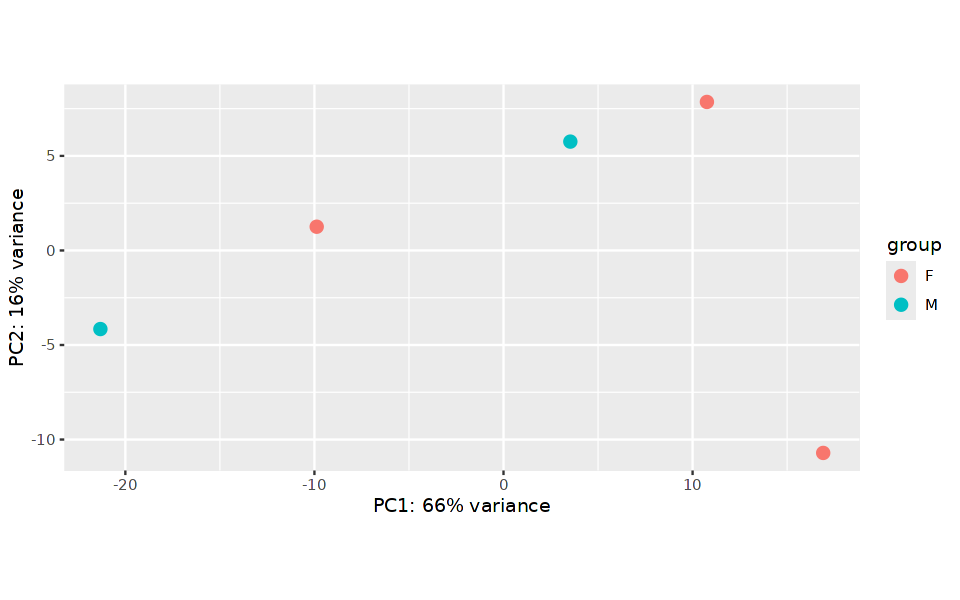

In [148]:
# Plot PCA
options(repr.plot.width=8, repr.plot.height=5)
DESeq2::plotPCA(rld, intgroup = "group_id")

In [149]:
# Extract the rlog matrix from the object and compute pairwise correlation values
rld_mat <- assay(rld)
rld_cor <- cor(rld_mat)

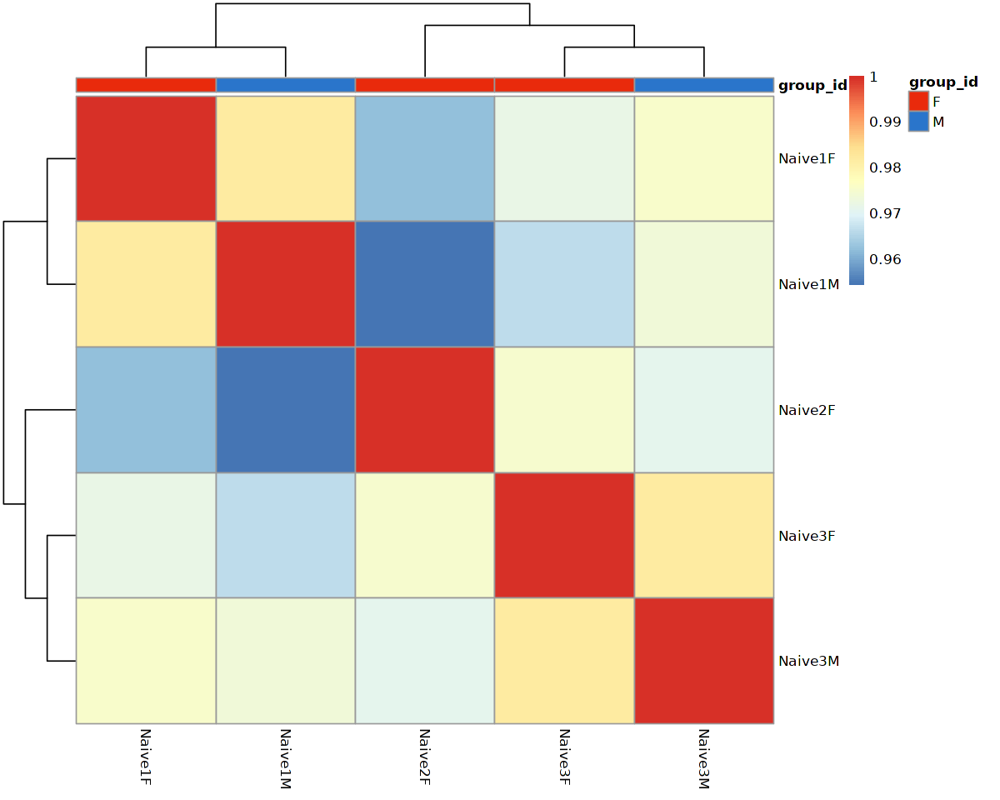

In [150]:
# Plot heatmap
options(repr.plot.width=10, repr.plot.height=8)
pheatmap(rld_cor, annotation = cluster_metadata[, c("group_id"), drop=F], annotation_colors = list(group_id=sex_colors))

In [151]:
# Run DESeq2 differential expression analysis
dds <- DESeq(dds)

estimating size factors

estimating dispersions

gene-wise dispersion estimates

mean-dispersion relationship

final dispersion estimates

fitting model and testing



In [152]:
libsize = data.frame(x=sizeFactors(dds), y=colSums(assay(dds)))

`geom_smooth()` using formula = 'y ~ x'


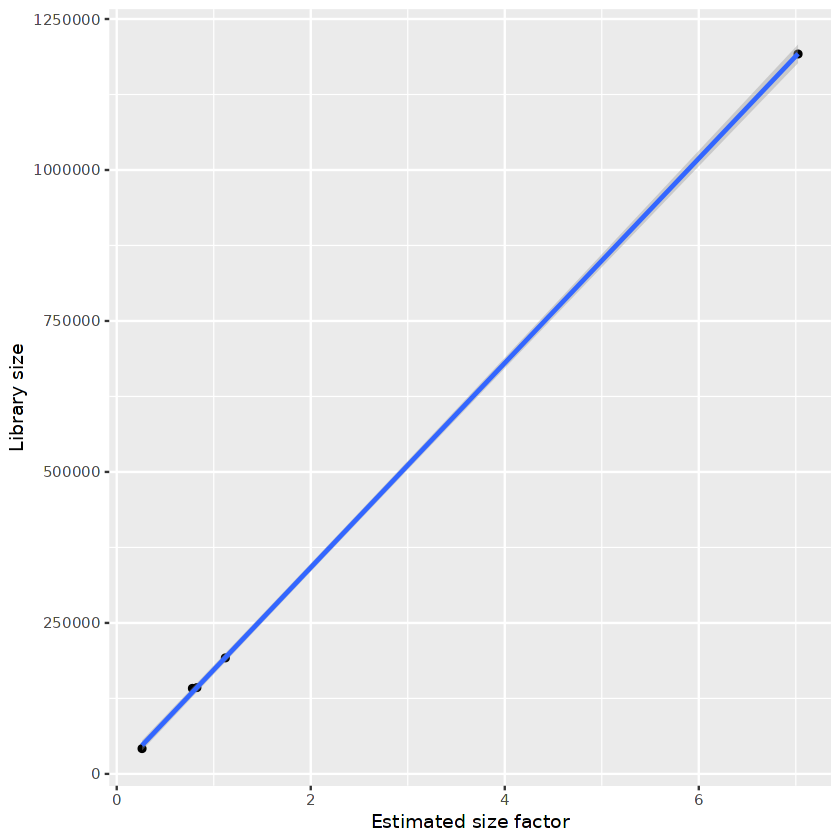

In [153]:
options(repr.plot.width=7, repr.plot.height=7)
ggplot(data=libsize, aes(x=x, y=y)) + geom_point() + geom_smooth(method="lm") + xlab("Estimated size factor") + ylab("Library size")

In [154]:
data.frame(colData(dds))

,cluster_id,sample_id,group_id,sizeFactor
,<chr>,<chr>,<fct>,<dbl>
Naive1F,Micro,Naive1F,F,0.7801694
Naive1M,Micro,Naive1M,M,7.0234648
Naive2F,Micro,Naive2F,F,0.2610435
Naive3F,Micro,Naive3F,F,1.1196700
Naive3M,Micro,Naive3M,M,0.8262541


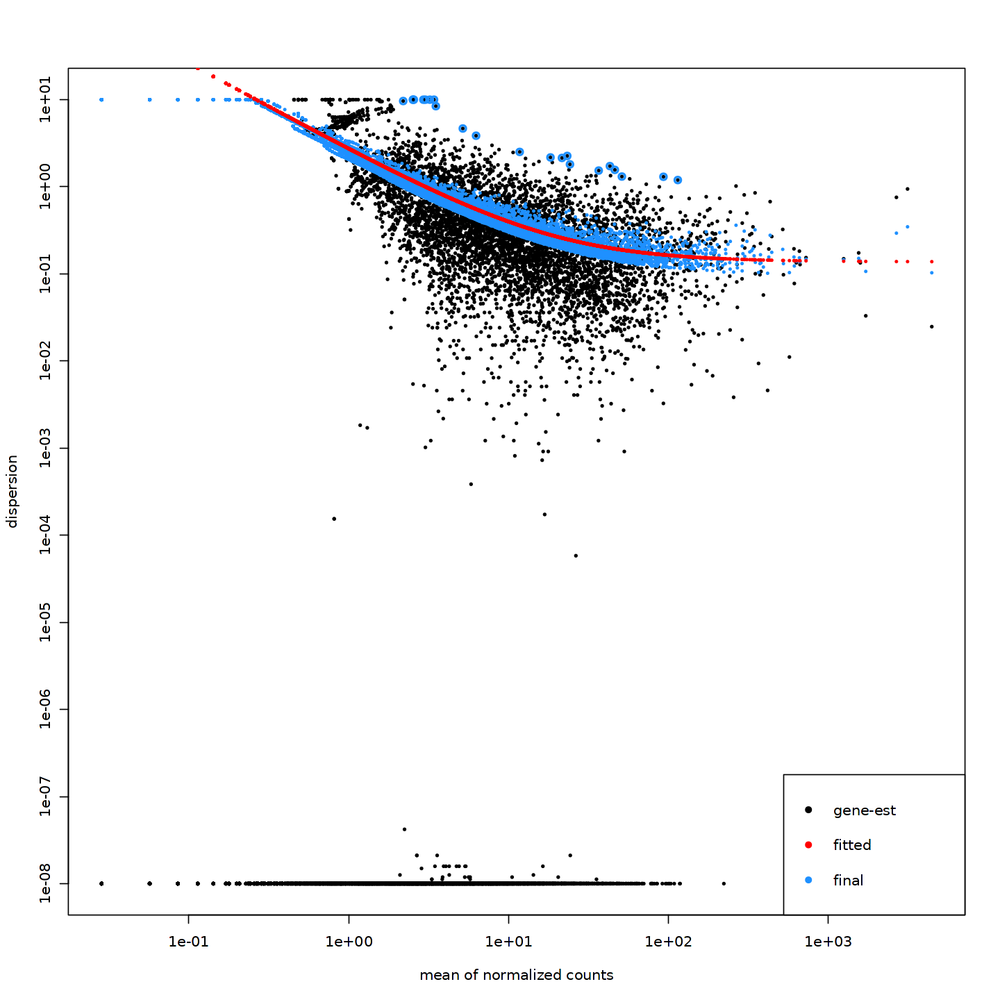

In [155]:
# Plot dispersion estimates
options(repr.plot.width=12, repr.plot.height=12)
plotDispEsts(dds)

In [156]:
condition1 = "M"
condition2 = "F"

In [157]:
contrast <- c("group_id", condition1, condition2)

# resultsNames(dds)
res <- results(dds, contrast = contrast, alpha = 0.05)

In [158]:
summary(res)


out of 12511 with nonzero total read count
adjusted p-value < 0.05
LFC > 0 (up)       : 0, 0%
LFC < 0 (down)     : 1, 0.008%
outliers [1]       : 0, 0%
low counts [2]     : 0, 0%
(mean count < 0)
[1] see 'cooksCutoff' argument of ?results
[2] see 'independentFiltering' argument of ?results



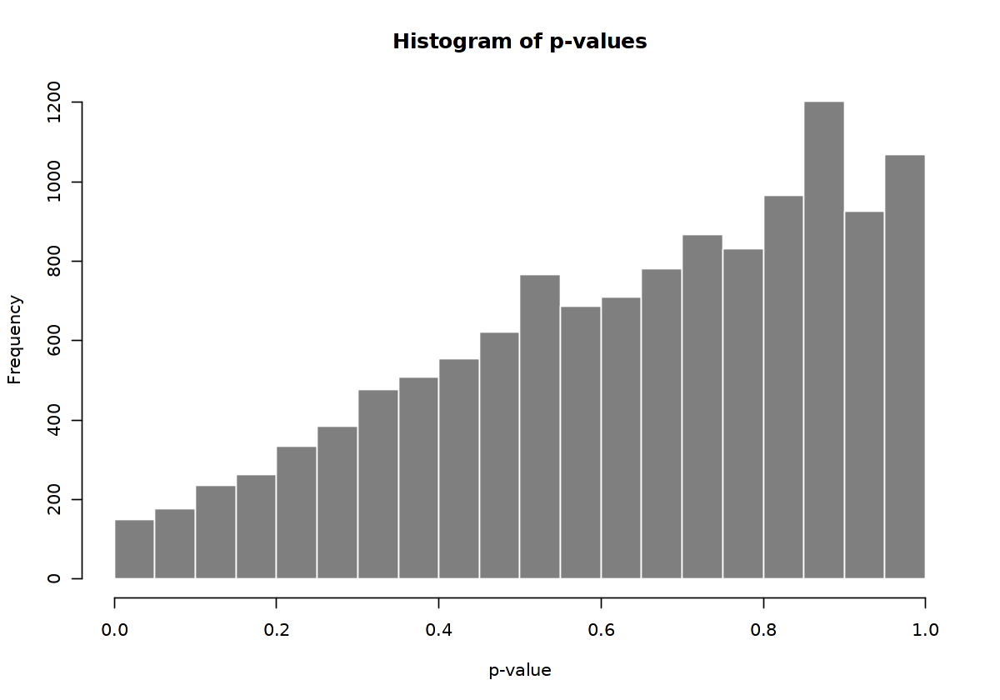

In [159]:
options(repr.plot.width=10, repr.plot.height=7)
hist(res$pvalue, breaks=0:20/20, col="grey50", border="white", xlim=c(0,1), main="Histogram of p-values", xlab="p-value")

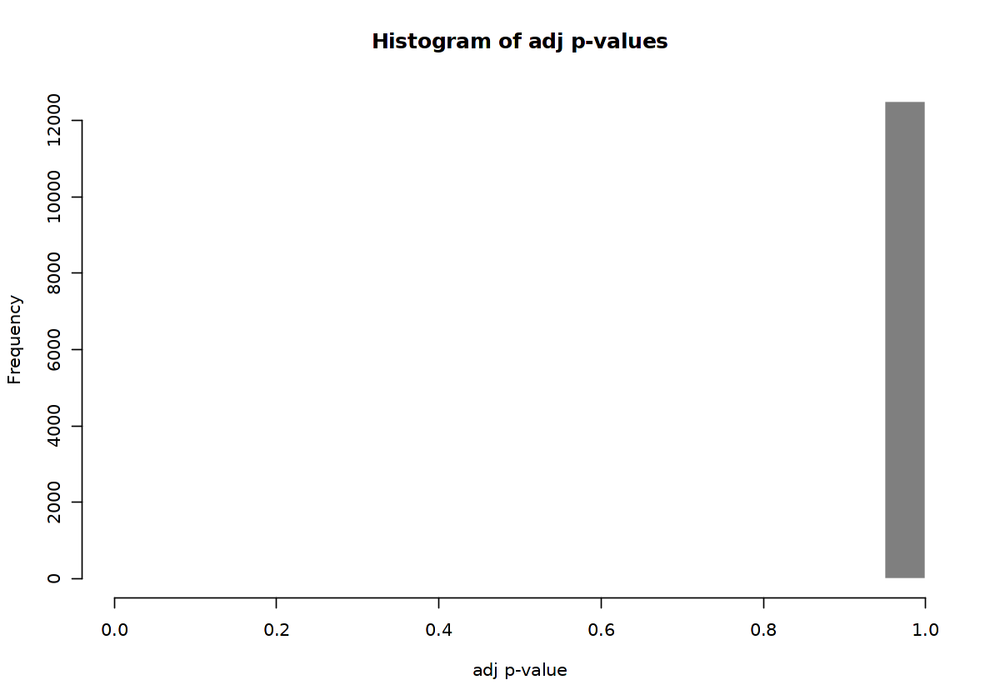

In [160]:
options(repr.plot.width=10, repr.plot.height=7)
hist(res$padj, breaks=0:20/20, col="grey50", border="white", xlim=c(0,1), main="Histogram of adj p-values", xlab="adj p-value")

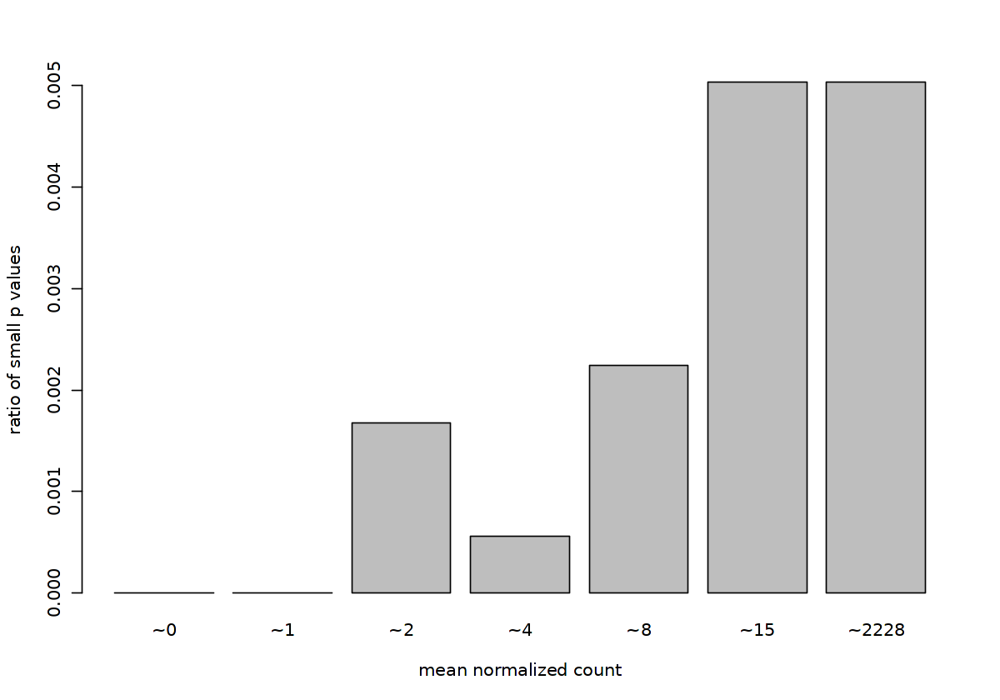

In [161]:
options(repr.plot.width=10, repr.plot.height=7)
qs <- c(0, quantile(res$baseMean[res$baseMean > 0], 0:7/7))
# cut the genes into the bins
bins <- cut(res$baseMean, qs)
# rename the levels of the bins using the middle point
levels(bins) <- paste0("~",round(.5*qs[-1] + .5*qs[-length(qs)]))
# calculate the ratio of $p$ values less than .01 for each bin
ratios <- tapply(res$pvalue, bins, function(p) mean(p < .01, na.rm=TRUE))
# plot these ratios
barplot(ratios, xlab="mean normalized count", ylab="ratio of small p values")

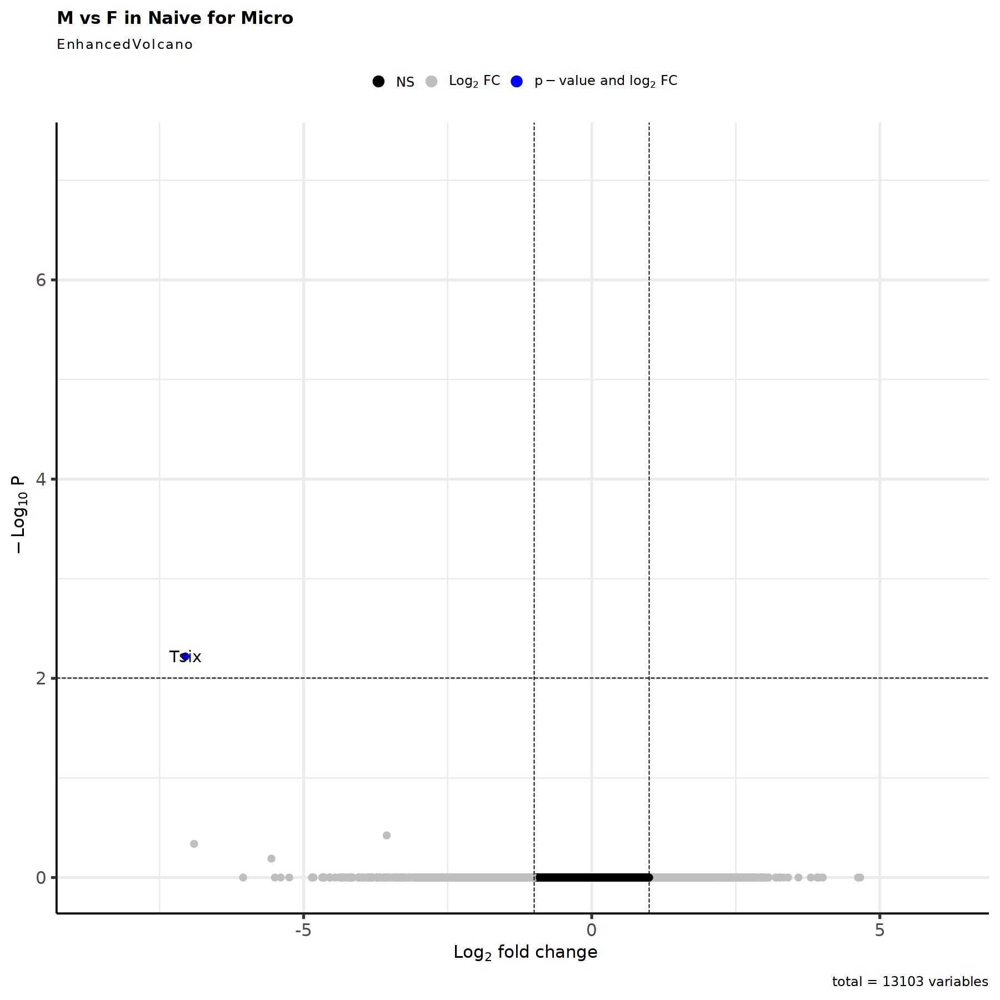

In [162]:
options(repr.plot.width=15, repr.plot.height=15)
#padj<0.001
EnhancedVolcano(res,
    lab = rownames(res),
    x = 'log2FoldChange',
    y = 'padj',
    title = paste0('M vs F in ',timepoint,' for ', cluster_choice),
    pCutoff = 0.01,
    FCcutoff = 1,
    pointSize = 3.0,
    labSize = 6.0,
    col=c('black', 'grey', 'grey', 'blue'),
    colAlpha = 1)

In [163]:
res <- res[complete.cases(res$padj),]

In [164]:
res_filtered <- res[(res$padj < 0.01 & abs(res$log2FoldChange) > 1 & res$baseMean > 1),]

In [165]:
res_filtered[order(abs(res_filtered$log2FoldChange), decreasing=TRUE),]

log2 fold change (MLE): group_id M vs F 
Wald test p-value: group id M vs F 
DataFrame with 1 row and 6 columns
      baseMean log2FoldChange     lfcSE      stat      pvalue      padj
     <numeric>      <numeric> <numeric> <numeric>   <numeric> <numeric>
Tsix   15.8959       -7.05198   1.40108  -5.03326 4.82208e-07 0.0060329

In [166]:
nrow(res_filtered)

[1] 1

In [167]:
top.genes.number <- ifelse(nrow(res_filtered)>100, 100, nrow(res_filtered))

In [168]:
res_top <- res_filtered[order(abs(res_filtered$log2FoldChange), decreasing=TRUE),][1:top.genes.number,]
res_top <- res_top[order(res_top$log2FoldChange, decreasing=FALSE),]

In [169]:
tmp_sub <- subset(tmp, subset = cellType == cluster_choice)

In [170]:
tmp_sub <- NormalizeData(tmp_sub, normalization.method = "LogNormalize", scale.factor = 10000, verbose = TRUE)

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


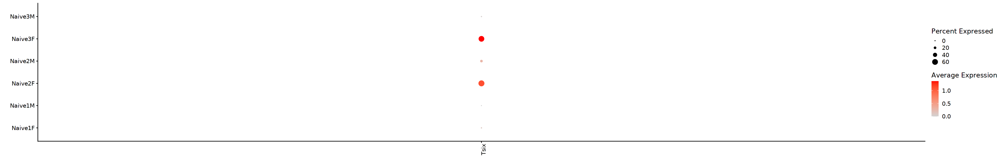

In [171]:
options(repr.plot.width=30, repr.plot.height=5)
plot <- DotPlot(tmp_sub, assay = "RNA", group.by = "orig.ident_Sex", scale=FALSE, cols = c("lightgrey", "red"), dot.scale = 5, features = rownames(res_top))
plot + theme(axis.text.x = element_text(angle = 90)) + labs(x = "", y= "")

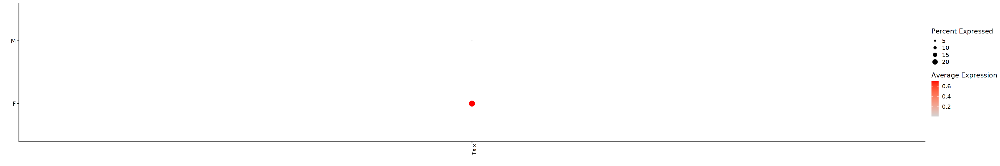

In [172]:
options(repr.plot.width=30, repr.plot.height=5)
plot <- DotPlot(tmp_sub, assay = "RNA", group.by = "Sex", scale=FALSE, cols = c("lightgrey", "red"), dot.scale = 5, features = rownames(res_top))
plot + theme(axis.text.x = element_text(angle = 90)) + labs(x = "", y= "")

In [173]:
HVGs.list[[cluster_choice]] <- rownames(res_filtered)

##### 3.2.1.4 Astro

In [174]:
cluster_choice <- "Astro"

In [175]:
table_sample_low <- table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$sample_id)[cluster_choice,][table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$sample_id)[cluster_choice,] <= 5]
table_sample_low

sample_keep <- names(timepoint_Sex_colors)[!names(timepoint_Sex_colors) %in% names(table_sample_low)]

named integer(0)

In [176]:
table_group_low <-table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$group_id)[cluster_choice,][table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$group_id)[cluster_choice,] <= 30]
table_group_low

group_keep <- names(sex_colors)[!names(sex_colors) %in% names(table_group_low)]

named integer(0)

In [177]:
cluster_metadata <- metadata[which(metadata$cluster_id == cluster_choice), ]

# Assign the rownames of the metadata to be the sample IDs
rownames(cluster_metadata) <- cluster_metadata$sample_id

In [178]:
#Remove sample and timepoint with low counts (sample<=5, timepoint<=30)
cluster_metadata <- cluster_metadata[(cluster_metadata$sample_id %in% sample_keep & cluster_metadata$group_id %in% group_keep),]

#new_sample_levels <- levels(cluster_metadata$sample_id)[levels(cluster_metadata$sample_id) %in% sample_keep]
#cluster_metadata$sample_id <- droplevels(cluster_metadata$sample_id)
#levels(cluster_metadata$sample_id) <- new_sample_levels

new_group_levels <- levels(cluster_metadata$group_id)[levels(cluster_metadata$group_id) %in% group_keep]
cluster_metadata$group_id <- droplevels(cluster_metadata$group_id)
levels(cluster_metadata$group_id) <- new_group_levels

In [179]:
cluster_metadata

,cluster_id,sample_id,group_id
,<chr>,<chr>,<fct>
Naive1F,Astro,Naive1F,F
Naive1M,Astro,Naive1M,M
Naive2F,Astro,Naive2F,F
Naive2M,Astro,Naive2M,M
Naive3F,Astro,Naive3F,F
Naive3M,Astro,Naive3M,M


In [180]:
# Subset the counts to only this cluster
counts <- pb[[cluster_choice]]

cluster_counts <- data.frame(counts[, which(colnames(counts) %in% rownames(cluster_metadata))])

# Check that all of the row names of the metadata are the same and in the same order as the column names of the counts in order to use as input to DESeq2
all(rownames(cluster_metadata) == colnames(cluster_counts))

[1] TRUE

In [181]:
dds <- DESeqDataSetFromMatrix(cluster_counts, colData = cluster_metadata, design = ~ group_id)

converting counts to integer mode



In [182]:
# Transform counts for data visualization
rld <- rlog(dds, blind=TRUE)

using ntop=500 top features by variance



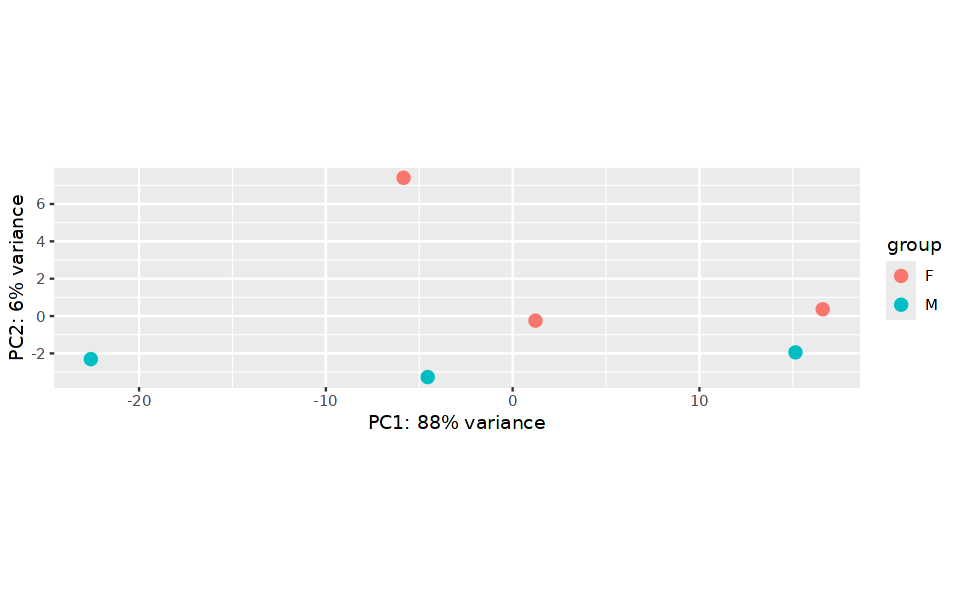

In [183]:
# Plot PCA
options(repr.plot.width=8, repr.plot.height=5)
DESeq2::plotPCA(rld, intgroup = "group_id")

In [184]:
# Extract the rlog matrix from the object and compute pairwise correlation values
rld_mat <- assay(rld)
rld_cor <- cor(rld_mat)

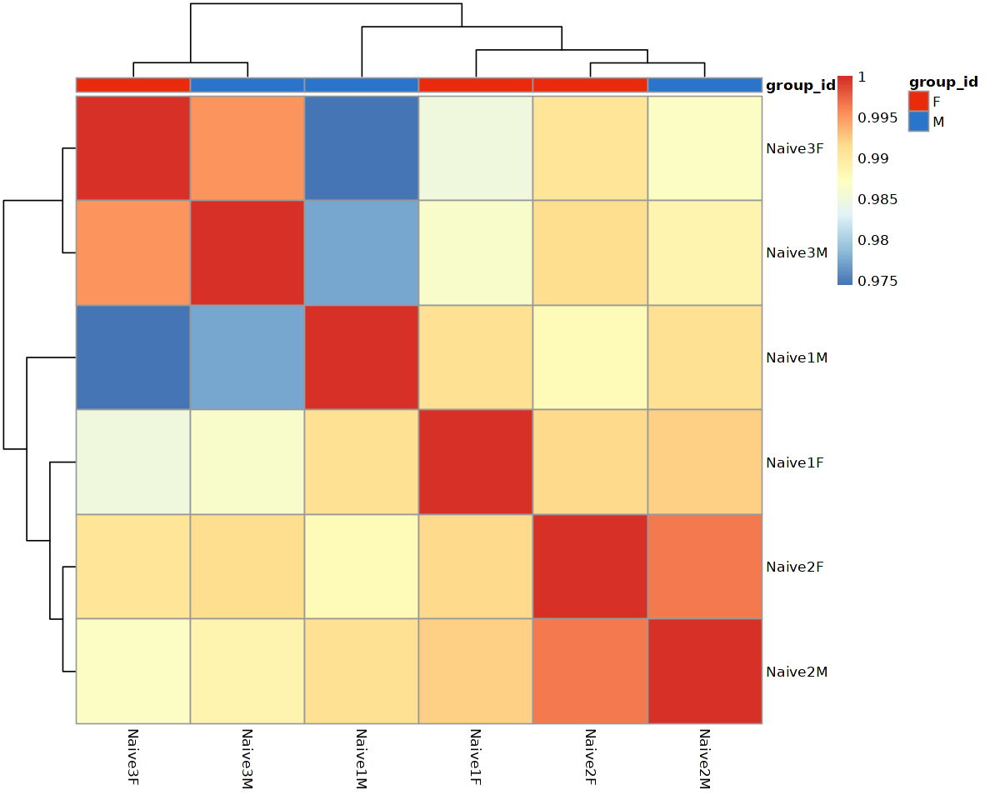

In [185]:
# Plot heatmap
options(repr.plot.width=10, repr.plot.height=8)
pheatmap(rld_cor, annotation = cluster_metadata[, c("group_id"), drop=F], annotation_colors = list(group_id=sex_colors))

In [186]:
# Run DESeq2 differential expression analysis
dds <- DESeq(dds)

estimating size factors

estimating dispersions

gene-wise dispersion estimates

mean-dispersion relationship

final dispersion estimates

fitting model and testing



In [187]:
libsize = data.frame(x=sizeFactors(dds), y=colSums(assay(dds)))

`geom_smooth()` using formula = 'y ~ x'


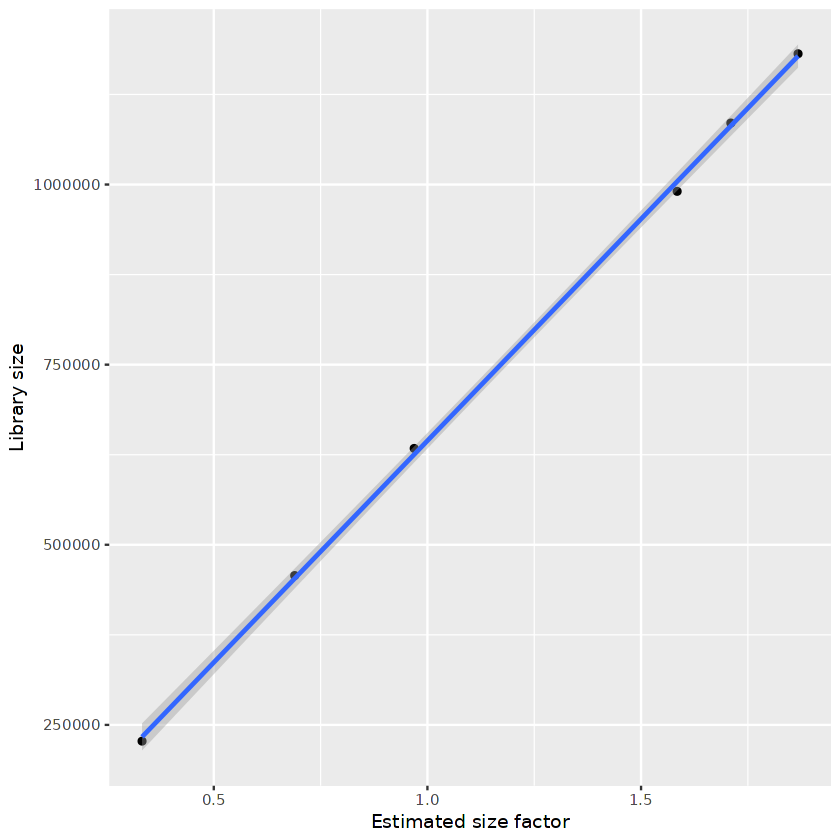

In [188]:
options(repr.plot.width=7, repr.plot.height=7)
ggplot(data=libsize, aes(x=x, y=y)) + geom_point() + geom_smooth(method="lm") + xlab("Estimated size factor") + ylab("Library size")

In [189]:
data.frame(colData(dds))

,cluster_id,sample_id,group_id,sizeFactor
,<chr>,<chr>,<fct>,<dbl>
Naive1F,Astro,Naive1F,F,0.3321055
Naive1M,Astro,Naive1M,M,1.7101022
Naive2F,Astro,Naive2F,F,1.5844998
Naive2M,Astro,Naive2M,M,1.8674842
Naive3F,Astro,Naive3F,F,0.9690058
Naive3M,Astro,Naive3M,M,0.6893658


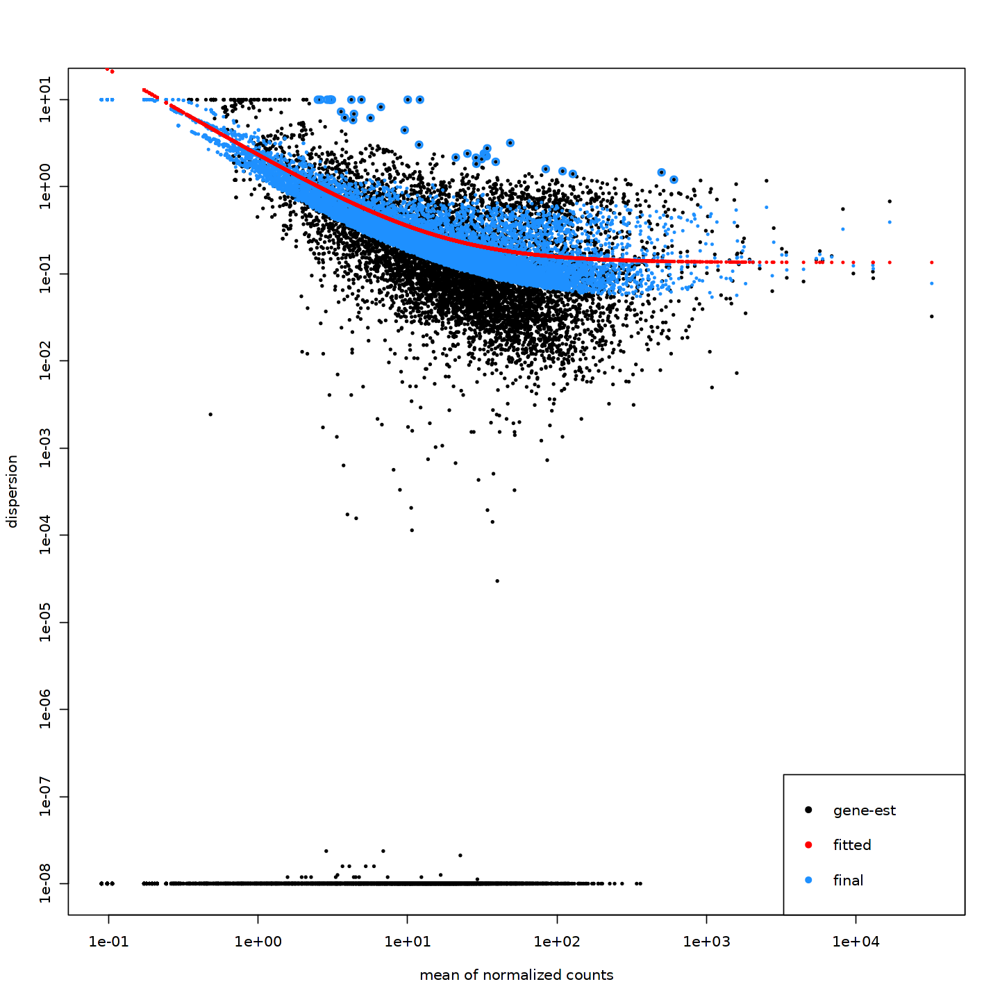

In [190]:
# Plot dispersion estimates
options(repr.plot.width=12, repr.plot.height=12)
plotDispEsts(dds)

In [191]:
condition1 = "M"
condition2 = "F"

In [192]:
contrast <- c("group_id", condition1, condition2)

# resultsNames(dds)
res <- results(dds, contrast = contrast, alpha = 0.05)

In [193]:
summary(res)


out of 12881 with nonzero total read count
adjusted p-value < 0.05
LFC > 0 (up)       : 4, 0.031%
LFC < 0 (down)     : 2, 0.016%
outliers [1]       : 1, 0.0078%
low counts [2]     : 0, 0%
(mean count < 0)
[1] see 'cooksCutoff' argument of ?results
[2] see 'independentFiltering' argument of ?results



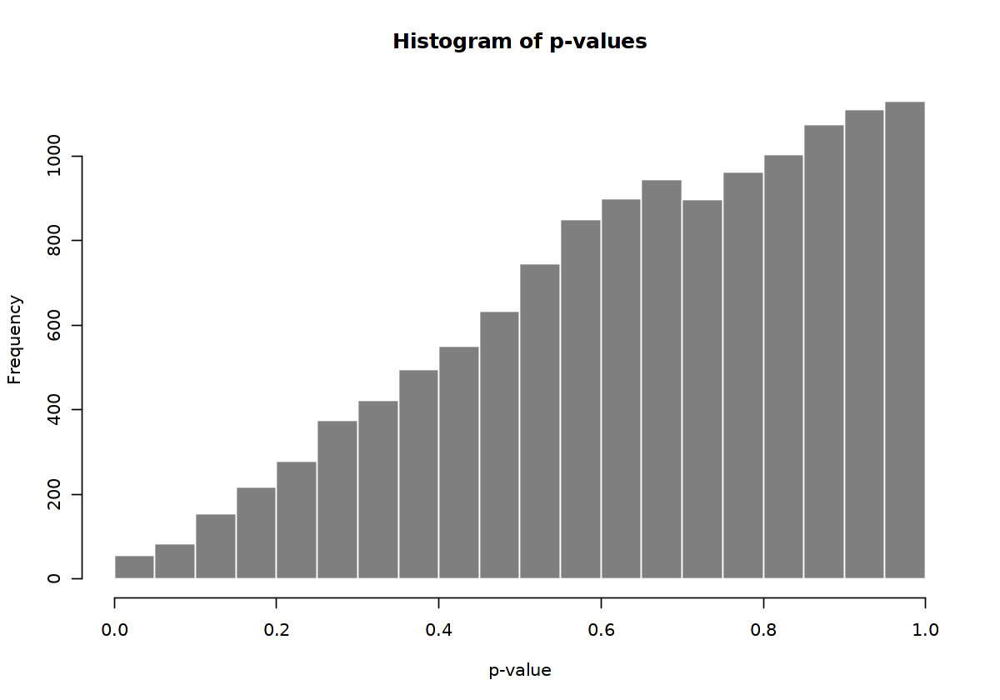

In [194]:
options(repr.plot.width=10, repr.plot.height=7)
hist(res$pvalue, breaks=0:20/20, col="grey50", border="white", xlim=c(0,1), main="Histogram of p-values", xlab="p-value")

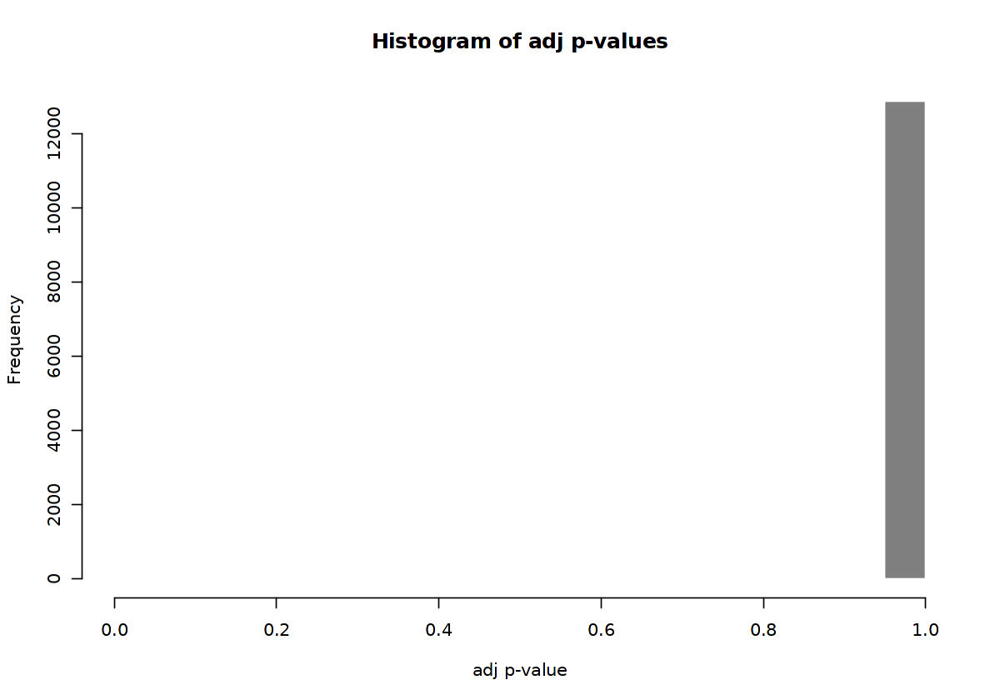

In [195]:
options(repr.plot.width=10, repr.plot.height=7)
hist(res$padj, breaks=0:20/20, col="grey50", border="white", xlim=c(0,1), main="Histogram of adj p-values", xlab="adj p-value")

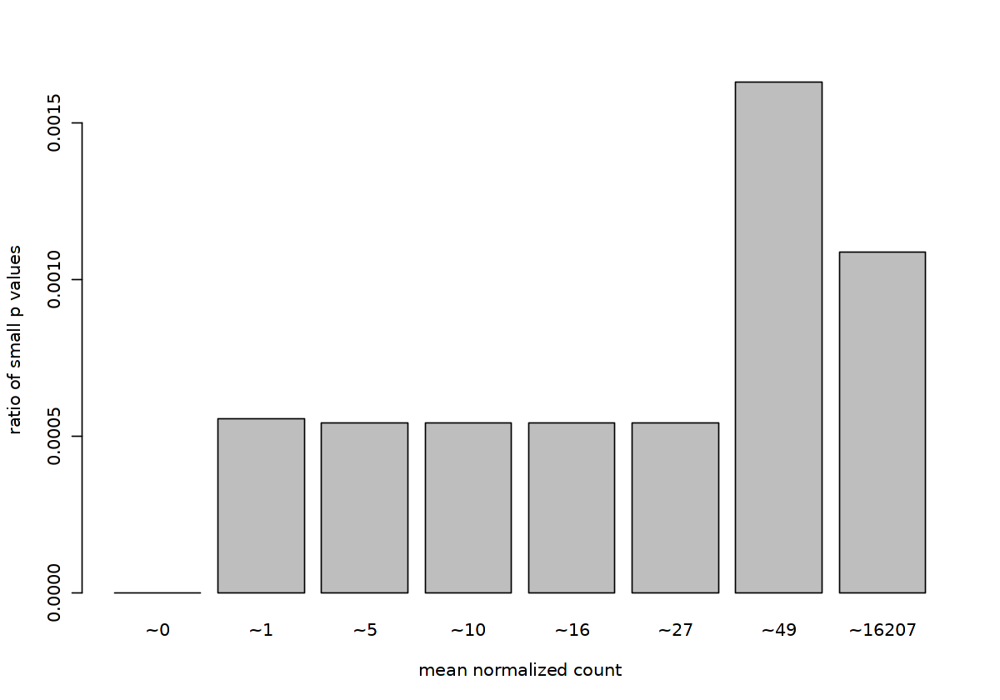

In [196]:
options(repr.plot.width=10, repr.plot.height=7)
qs <- c(0, quantile(res$baseMean[res$baseMean > 0], 0:7/7))
# cut the genes into the bins
bins <- cut(res$baseMean, qs)
# rename the levels of the bins using the middle point
levels(bins) <- paste0("~",round(.5*qs[-1] + .5*qs[-length(qs)]))
# calculate the ratio of $p$ values less than .01 for each bin
ratios <- tapply(res$pvalue, bins, function(p) mean(p < .01, na.rm=TRUE))
# plot these ratios
barplot(ratios, xlab="mean normalized count", ylab="ratio of small p values")

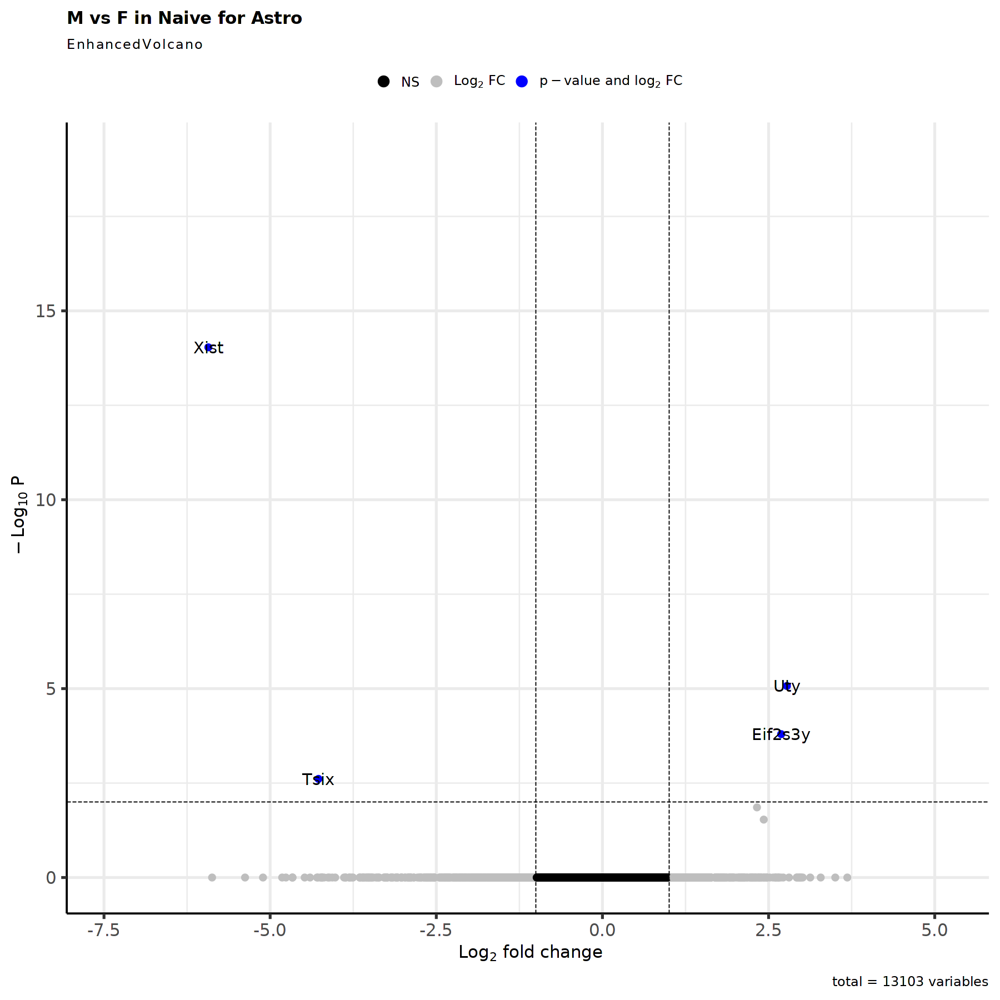

In [197]:
options(repr.plot.width=15, repr.plot.height=15)
#padj<0.001
EnhancedVolcano(res,
    lab = rownames(res),
    x = 'log2FoldChange',
    y = 'padj',
    title = paste0('M vs F in ',timepoint,' for ', cluster_choice),
    pCutoff = 0.01,
    FCcutoff = 1,
    pointSize = 3.0,
    labSize = 6.0,
    col=c('black', 'grey', 'grey', 'blue'),
    colAlpha = 1)

In [198]:
res <- res[complete.cases(res$padj),]

In [199]:
res_filtered <- res[(res$padj < 0.01 & abs(res$log2FoldChange) > 1 & res$baseMean > 1),]

In [200]:
res_filtered[order(abs(res_filtered$log2FoldChange), decreasing=TRUE),]

log2 fold change (MLE): group_id M vs F 
Wald test p-value: group id M vs F 
DataFrame with 4 rows and 6 columns
         baseMean log2FoldChange     lfcSE      stat      pvalue        padj
        <numeric>      <numeric> <numeric> <numeric>   <numeric>   <numeric>
Xist     610.9984       -5.92974  0.668351  -8.87219 7.17197e-19 9.23750e-15
Tsix      61.2923       -4.27299  0.864091  -4.94507 7.61177e-07 2.45099e-03
Uty       59.9756        2.77551  0.457630   6.06497 1.31981e-09 8.49959e-06
Eif2s3y   64.9554        2.68932  0.488696   5.50305 3.73274e-08 1.60259e-04

In [201]:
nrow(res_filtered)

[1] 4

In [202]:
top.genes.number <- ifelse(nrow(res_filtered)>100, 100, nrow(res_filtered))

In [203]:
res_top <- res_filtered[order(abs(res_filtered$log2FoldChange), decreasing=TRUE),][1:top.genes.number,]
res_top <- res_top[order(res_top$log2FoldChange, decreasing=FALSE),]

In [204]:
tmp_sub <- subset(tmp, subset = cellType == cluster_choice)

In [205]:
tmp_sub <- NormalizeData(tmp_sub, normalization.method = "LogNormalize", scale.factor = 10000, verbose = TRUE)

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


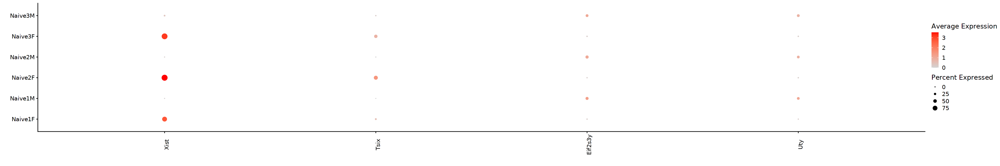

In [206]:
options(repr.plot.width=30, repr.plot.height=5)
plot <- DotPlot(tmp_sub, assay = "RNA", group.by = "orig.ident_Sex", scale=FALSE, cols = c("lightgrey", "red"), dot.scale = 5, features = rownames(res_top))
plot + theme(axis.text.x = element_text(angle = 90)) + labs(x = "", y= "")

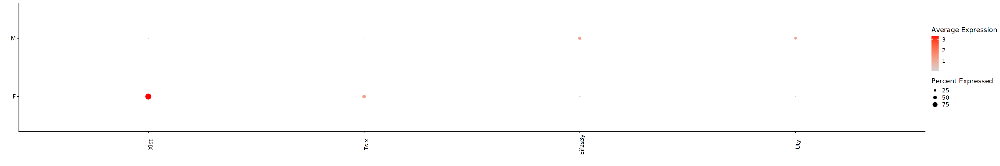

In [207]:
options(repr.plot.width=30, repr.plot.height=5)
plot <- DotPlot(tmp_sub, assay = "RNA", group.by = "Sex", scale=FALSE, cols = c("lightgrey", "red"), dot.scale = 5, features = rownames(res_top))
plot + theme(axis.text.x = element_text(angle = 90)) + labs(x = "", y= "")

In [208]:
HVGs.list[[cluster_choice]] <- rownames(res_filtered)

##### 3.2.1.5 Summary

In [209]:
listInput_upset <- HVGs.list
listInput_upset[sapply(listInput_upset, is.null)] <- NULL

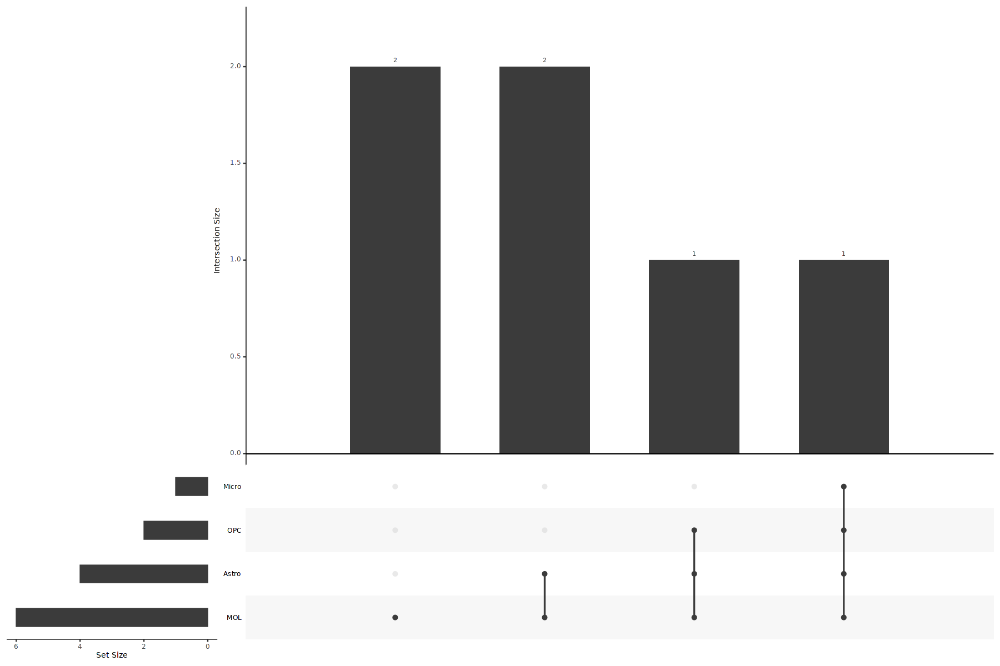

In [210]:
options(repr.plot.width=15, repr.plot.height=10)
upset(fromList(listInput_upset), order.by = "freq")

In [211]:
HVF <- unique(unlist(HVGs.list))

In [212]:
table_sample_low <- table(MORNAATACC_sce$sample_id)[table(MORNAATACC_sce$sample_id) <= 5]
table_group_low <- table(MORNAATACC_sce$group_id)[table(MORNAATACC_sce$group_id) <= 30]

In [213]:
#Remove sample with low number of cells
keepcells <- rownames(tmp@meta.data[!tmp$orig.ident %in% (names(table_sample_low)),])
tmp <- subset(tmp, cells=keepcells)

In [214]:
#Remove timepoint with low number of cells
keepcells <- rownames(tmp@meta.data[!tmp$orig.ident_Sex %in% (names(table_group_low)),])
tmp <- subset(tmp, cells=keepcells)

In [215]:
tmp <- NormalizeData(tmp, normalization.method = "LogNormalize", scale.factor = 10000, verbose = TRUE)

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


In [216]:
tmp <- ScaleData(tmp, features=rownames(tmp))

Centering and scaling data matrix

  |==========================================================================================| 100%


In [217]:
sub_timepoint_Sex_colors <- timepoint_Sex_colors[names(timepoint_Sex_colors) %in% names(table(tmp$orig.ident_Sex))]

In [218]:
tmp$orig.ident <- factor(x = tmp$orig.ident, levels = name_timepoint[!name_timepoint %in% names(table_sample_low)])
tmp$orig.ident_Sex <- factor(x = tmp$orig.ident_Sex, levels = names(sub_timepoint_Sex_colors)[!names(sub_timepoint_Sex_colors) %in% names(table_group_low)])

In [219]:
Idents(object = tmp) <- "orig.ident_Sex"

Warning message:
"`StashIdent()` was deprecated in SeuratObject 3.0.0.
ℹ Please use object[["ident"]] <- Idents(object)"
Warning message:
"`aes_string()` was deprecated in ggplot2 3.0.0.
ℹ Please use tidy evaluation idioms with `aes()`.
ℹ See also `vignette("ggplot2-in-packages")` for more information."
Warning message:
"CombinePlots is being deprecated. Plots should now be combined using the patchwork system."


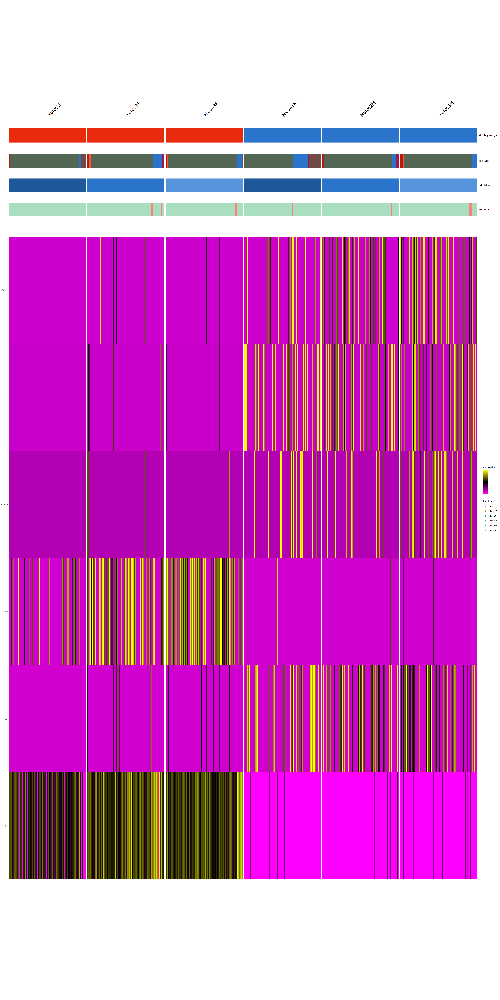

In [220]:
options(repr.plot.width=25, repr.plot.height=50)
DoMultiBarHeatmap(
    subset(tmp, downsample = 200),
    features = HVF,
    cells = NULL,
    group.by = "orig.ident_Sex",
    additional.group.by = c("cellType", "orig.ident", "Immune"),
    additional.group.sort.by = c("cellType", "orig.ident", "Immune"),
    cols.use = list(orig.ident_Sex=sub_timepoint_Sex_colors, cellType=cellType_colors, orig.ident=orig.ident_colors, Immune=immune_colors),
    group.bar = TRUE,
    disp.min = -2.5,
    disp.max = NULL,
    layer = "scale.data",
    assay = "RNA",
    label = TRUE,
    size = 5.5,
    hjust = 0,
    angle = 45,
    raster = TRUE,
    draw.lines = TRUE,
    lines.width = NULL,
    group.bar.height = 0.02,
    combine = TRUE
    ) + theme(text = element_text(size = 8))

In [221]:
sample_names <- levels(tmp$orig.ident_Sex)

In [222]:
gene_list <- HVF

In [223]:
tmp_markers <- as.data.frame(AggregateExpression(tmp, assays = "RNA", group.by = "orig.ident_Sex", normalization.method = "LogNormalize", scale.factor = 10000, return.seurat = TRUE)[["RNA"]]$data[gene_list,])

Centering and scaling data matrix

  |==========================================================================================| 100%
  |==========================================================================================| 100%


In [224]:
matrix <- tmp_markers/do.call(pmax, tmp_markers)

In [225]:
paletteLength <- 50
myColor <- colorRampPalette(c("#FFFFB3", "#5E3719"))(paletteLength/2)
myBreaks <- c(seq(0, max(matrix), length.out=floor(paletteLength/2)))

In [226]:
plot_height <- ifelse(as.integer(nrow(matrix)/20)<=5, 5, as.integer(nrow(matrix)/20))

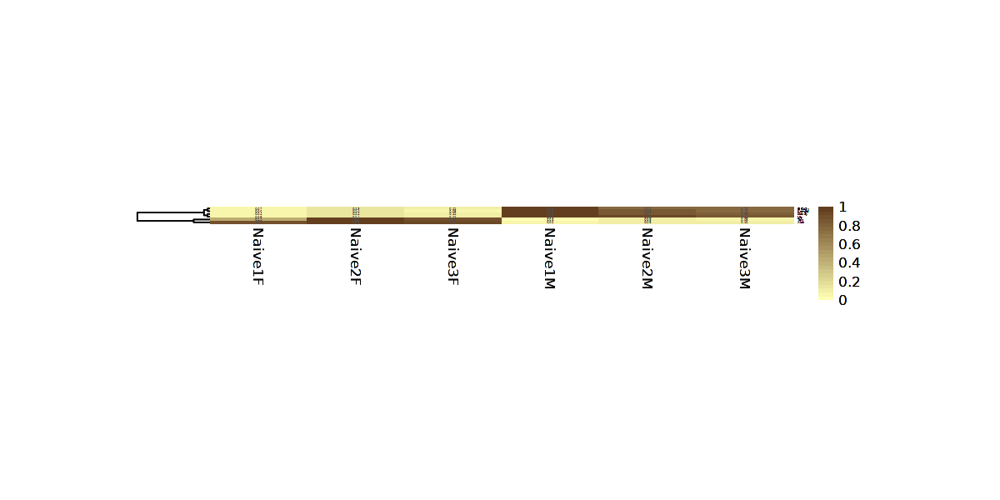

In [227]:
options(repr.plot.width=10, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = T, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=TRUE)
ph

In [228]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "DGE_Sex_sep_",timepoint,"_pseudobulk.pdf"), width=8, height=plot_height)

png 
  2

In [229]:
gene_list <- gene_list[ph$tree_row$order]

In [230]:
tmp_markers_mean <- data.frame(matrix(0L, ncol=1, nrow=length(gene_list), dimnames=list(gene_list, "Mean_Log2Exp")))

In [231]:
tmp_markers_mean[rownames(tmp_markers),"Mean_Log2Exp"] <- rowMeans(tmp_markers)

In [232]:
matrix <- tmp_markers_mean

In [233]:
paletteLength <- 50
myColor <- colorRampPalette(c("white", "black"))(paletteLength/2)
myBreaks <- c(seq(0, max(matrix), length.out=floor(paletteLength/2)))

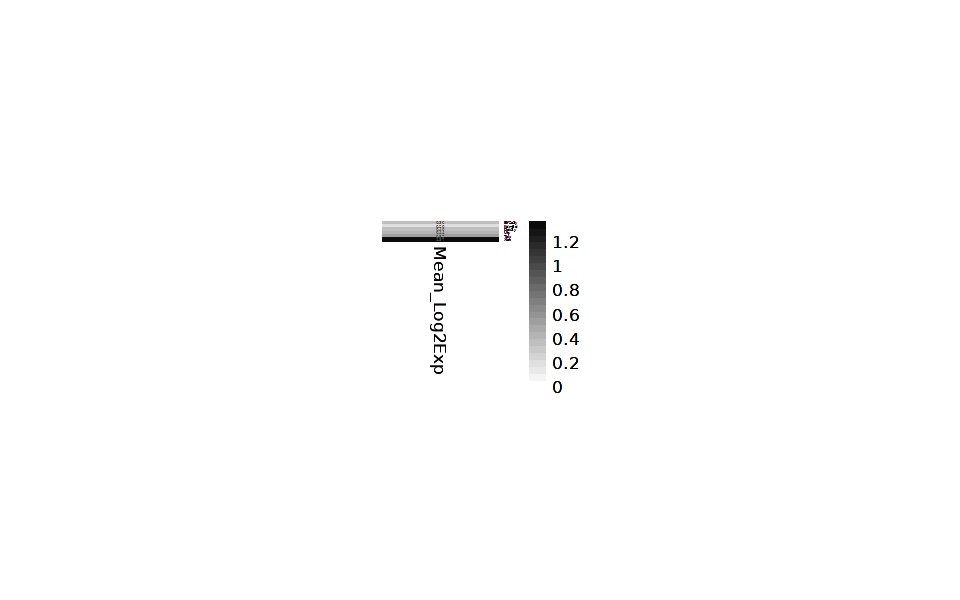

In [234]:
options(repr.plot.width=8, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = T, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=FALSE)
ph

In [235]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "DGE_Sex_sep_",timepoint,"_pseudobulk_mean.pdf"), width=8, height=plot_height)

png 
  2

In [236]:
tmp_markers_zscore <- t(apply(tmp_markers[gene_list,], 1, scale))
colnames(tmp_markers_zscore) <- paste0("zscore_", names(sub_timepoint_Sex_colors))
matrix <- tmp_markers_zscore

In [237]:
paletteLength <- 50
myColor <- colorRampPalette(c("blue", "white", "red"))(paletteLength/2)
myBreaks <- c(seq(min(matrix), max(matrix), length.out=floor(paletteLength/2)))

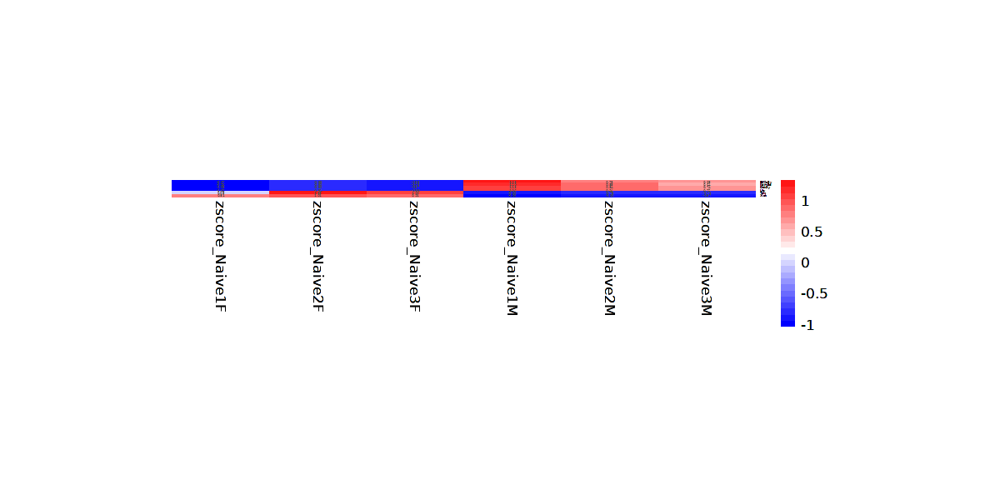

In [238]:
options(repr.plot.width=10, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = T, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=FALSE)
ph

In [239]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "DGE_Sex_sep_",timepoint,"_pseudobulk_zscore.pdf"), width=8, height=plot_height)

png 
  2

In [240]:
gene_list <- HVF

In [241]:
tmp_markers <- as.data.frame(AggregateExpression(tmp, assays = "RNA", group.by = "Sex", normalization.method = "LogNormalize", scale.factor = 10000, return.seurat = TRUE)[["RNA"]]$data[gene_list,])

Centering and scaling data matrix

  |==========================================================================================| 100%
  |==========================================================================================| 100%


In [242]:
matrix <- tmp_markers/do.call(pmax, tmp_markers)

In [243]:
paletteLength <- 50
myColor <- colorRampPalette(c("#FFFFB3", "#5E3719"))(paletteLength/2)
myBreaks <- c(seq(0, max(matrix), length.out=floor(paletteLength/2)))

In [244]:
plot_height <- ifelse(as.integer(nrow(matrix)/20) < 5, 5, as.integer(nrow(matrix)/20))

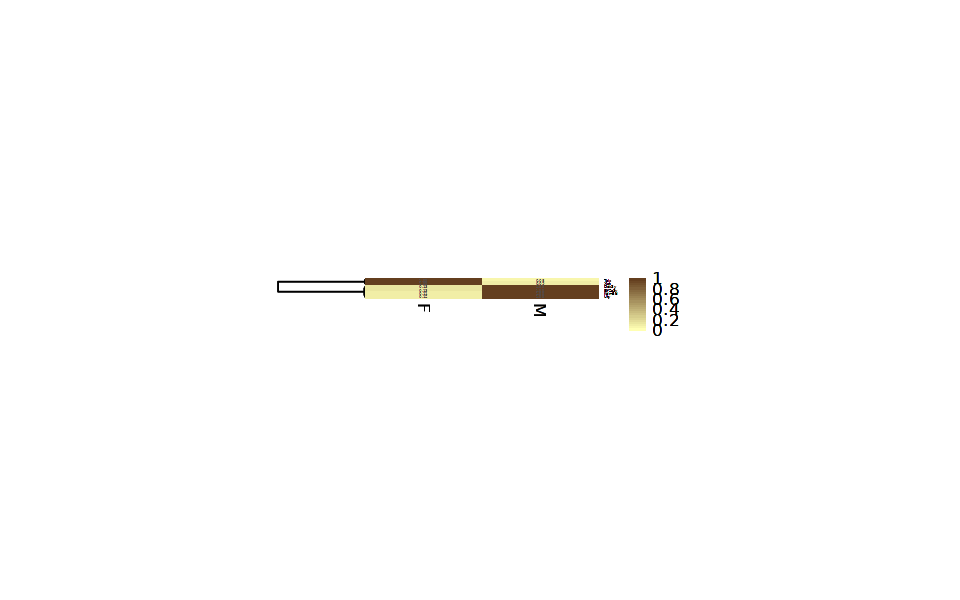

In [245]:
options(repr.plot.width=8, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = T, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=TRUE)
ph

In [246]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "DGE_Sex_",timepoint,"_pseudobulk.pdf"), width=8, height=plot_height)

png 
  2

In [247]:
gene_list <- gene_list[ph$tree_row$order]

In [248]:
tmp_markers_mean <- data.frame(matrix(0L, ncol=1, nrow=length(gene_list), dimnames=list(gene_list, "Mean_Log2Exp")))

In [249]:
tmp_markers_mean[rownames(tmp_markers),"Mean_Log2Exp"] <- rowMeans(tmp_markers)

In [250]:
matrix <- tmp_markers_mean

In [251]:
paletteLength <- 50
myColor <- colorRampPalette(c("white", "black"))(paletteLength/2)
myBreaks <- c(seq(0, max(matrix), length.out=floor(paletteLength/2)))

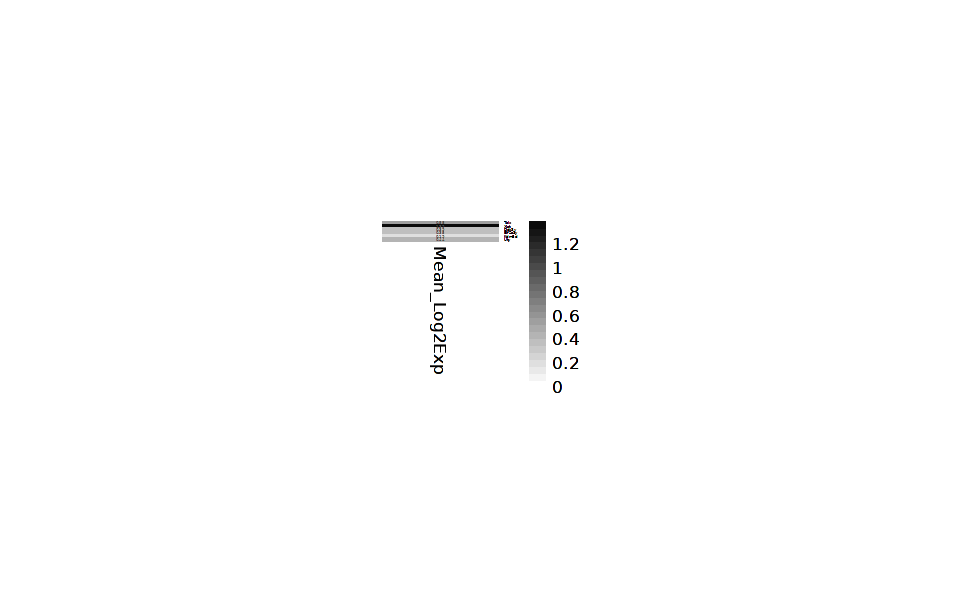

In [252]:
options(repr.plot.width=8, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = T, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=FALSE)
ph

In [253]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "DGE_Sex_",timepoint,"_pseudobulk_mean.pdf"), width=8, height=plot_height)

png 
  2

In [254]:
tmp_markers_zscore <- t(apply(tmp_markers[gene_list,], 1, scale))
colnames(tmp_markers_zscore) <- paste0("zscore_", names(sex_colors))
matrix <- tmp_markers_zscore

In [255]:
paletteLength <- 50
myColor <- colorRampPalette(c("blue", "white", "red"))(paletteLength/2)
myBreaks <- c(seq(min(matrix), max(matrix), length.out=floor(paletteLength/2)))

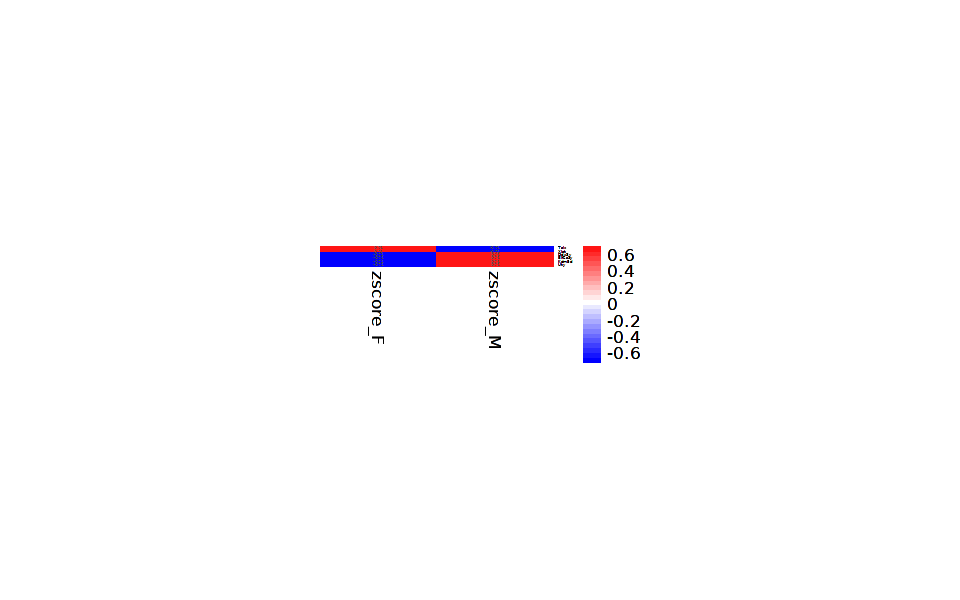

In [256]:
options(repr.plot.width=8, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = T, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=FALSE)
ph

In [257]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "DGE_Sex_",timepoint,"_pseudobulk_zscore.pdf"), width=8, height=plot_height)

png 
  2

#### 3.2.2 Ctrl

In [258]:
timepoint <- "Ctrl"
name_timepoint <- names_Ctrl

In [259]:
tmp <- subset(MORNAATACC, subset = orig.ident_merge == timepoint)

In [260]:
tmp <- NormalizeData(tmp, normalization.method = "LogNormalize", scale.factor = 10000, verbose = TRUE)

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


In [261]:
tmp <- ScaleData(tmp, features=rownames(tmp))

Centering and scaling data matrix

  |==========================================================================================| 100%


In [262]:
timepoint_Sex_colors <- c(rep(sex_colors["F"], length(name_timepoint)),rep(sex_colors["M"], length(name_timepoint)))
df_timepoint_Sex <- expand.grid(name_timepoint, names(sex_colors))
names(timepoint_Sex_colors) <- paste0(df_timepoint_Sex[,1],df_timepoint_Sex[,2])

In [263]:
tmp$orig.ident_Sex <- paste0(tmp$orig.ident,tmp$Sex)
tmp$orig.ident_Sex <- factor(paste0(tmp$orig.ident,tmp$Sex), levels=names(table(tmp$orig.ident_Sex)))

In [264]:
tmp$orig.ident <- factor(tmp$orig.ident, levels=name_timepoint)
tmp$cellType <- factor(tmp$cellType, levels=names(cellType_colors))
tmp$Sex <- factor(tmp$Sex, levels=names(sex_colors))

In [265]:
table(tmp$cellType, tmp$orig.ident_Sex)

        
         EarlyCtrl2F EarlyCtrl2M EarlyCtrl3F EarlyCtrl3M EarlyCtrl4F EarlyCtrl4M EarlyCtrlFemale5F
  OPC              0           1           1           0         188         138               119
  COP              0           0           1           0          23          25                22
  MOL             92         245        1613        1494        2355        3926              7763
  Astro           24          36         238         104         133         148               438
  Epen             2           3          63          45          30          47                11
  Micro           38          27           5           3          17           8                15
  Neuron           0           0          19           7           1           0                 0
        
         EarlyCtrlMale5M LateCtrl2F LateCtrl2M LateCtrl3F LateCtrl3M PeakCtrl2F PeakCtrl2M
  OPC                134          6         13         16          9          5          5
  COP   

In [266]:
table(tmp$cellType, tmp$Sex)

        
             F     M
  OPC      338   301
  COP       48    42
  MOL    19232 23332
  Astro   2892  1811
  Epen     282   318
  Micro    169   128
  Neuron    24    13

In [267]:
table(tmp$orig.ident_Sex, tmp$Sex)

                   
                       F    M
  EarlyCtrl2F        156    0
  EarlyCtrl2M          0  312
  EarlyCtrl3F       1940    0
  EarlyCtrl3M          0 1653
  EarlyCtrl4F       2747    0
  EarlyCtrl4M          0 4292
  EarlyCtrlFemale5F 8368    0
  EarlyCtrlMale5M      0 8227
  LateCtrl2F        3859    0
  LateCtrl2M           0 4639
  LateCtrl3F        3826    0
  LateCtrl3M           0 3585
  PeakCtrl2F        1304    0
  PeakCtrl2M           0 1907
  PeakCtrl3F         785    0
  PeakCtrl3M           0 1330

In [268]:
MORNAATACC_sce <- as.SingleCellExperiment(tmp, assay="RNA")

In [269]:
MORNAATACC_sce <- prepSCE(MORNAATACC_sce, kid = "cellType", gid = "Sex", sid = "orig.ident_Sex", drop = FALSE)

In [270]:
kids <- purrr::set_names(levels(MORNAATACC_sce$cluster_id))

# Total number of clusters
nk <- length(kids)

# Named vector of sample names
sids <- purrr::set_names(levels(MORNAATACC_sce$sample_id))

# Total number of samples 
ns <- length(sids)

In [271]:
kids
sids

OPC      COP      MOL    Astro     Epen    Micro   Neuron 
   "OPC"    "COP"    "MOL"  "Astro"   "Epen"  "Micro" "Neuron"

EarlyCtrl2F         EarlyCtrl2M         EarlyCtrl3F         EarlyCtrl3M         EarlyCtrl4F 
      "EarlyCtrl2F"       "EarlyCtrl2M"       "EarlyCtrl3F"       "EarlyCtrl3M"       "EarlyCtrl4F" 
        EarlyCtrl4M   EarlyCtrlFemale5F     EarlyCtrlMale5M          LateCtrl2F          LateCtrl2M 
      "EarlyCtrl4M" "EarlyCtrlFemale5F"   "EarlyCtrlMale5M"        "LateCtrl2F"        "LateCtrl2M" 
         LateCtrl3F          LateCtrl3M          PeakCtrl2F          PeakCtrl2M          PeakCtrl3F 
       "LateCtrl3F"        "LateCtrl3M"        "PeakCtrl2F"        "PeakCtrl2M"        "PeakCtrl3F" 
         PeakCtrl3M 
       "PeakCtrl3M"

In [272]:
## Determine the number of cells per sample
table(MORNAATACC_sce$sample_id)

## Turn named vector into a numeric vector of number of cells per sample
n_cells <- as.numeric(table(MORNAATACC_sce$sample_id))

## Determine how to reoder the samples (rows) of the metadata to match the order of sample names in sids vector
m <- match(sids, MORNAATACC_sce$sample_id)

## Create the sample level metadata by combining the reordered metadata with the number of cells corresponding to each sample.
ei <- data.frame(colData(MORNAATACC_sce)[m, ], n_cells, row.names = NULL) %>% select(-"cluster_id")
ei


      EarlyCtrl2F       EarlyCtrl2M       EarlyCtrl3F       EarlyCtrl3M       EarlyCtrl4F 
              156               312              1940              1653              2747 
      EarlyCtrl4M EarlyCtrlFemale5F   EarlyCtrlMale5M        LateCtrl2F        LateCtrl2M 
             4292              8368              8227              3859              4639 
       LateCtrl3F        LateCtrl3M        PeakCtrl2F        PeakCtrl2M        PeakCtrl3F 
             3826              3585              1304              1907               785 
       PeakCtrl3M 
             1330 

sample_id,group_id,orig.ident,nCount_RAW,nFeature_RAW,nCount_RNA,nFeature_RNA,nCount_ATAC,nFeature_ATAC,orig.ident_merge,batch,model,debrisRemoval,date_tissue_collection,date_experiment,nbMouse,EAE_score_mean,frequency_count,mononucleosomal,nucleosome_free,reads_count,percent.mt,log10GenesUMI,mitoRatio,S.Score,G2M.Score,Phase,CC.Difference,nucleosome_signal,nucleosome_percentile,TSS.enrichment,TSS.percentile,nCount_peaks,nFeature_peaks,FRiP,nCount_GenePromAcc,nFeature_GenePromAcc,pANN,DF.classifications,pct_chrY,pct_chrX,Xist_score,Sex_predictions,Sex_predictions_F,Sex_predictions_M,snn_RNA_res.1,seurat_clusters_RNA,snn_peaks_res.0.4,seurat_clusters_peaks,RNA.weight,⋯,pvalue_Naive.Tcell_cd8,Immune.Tcell_cd8,ImmuneScoreGenePromAcc,ImmuneScoreScaledGenePromAcc,zscore_NaiveGenePromAcc,pvalue_NaiveGenePromAcc,ImmuneGenePromAcc,ImmuneScoreGenePromAcc.complement,ImmuneScoreScaledGenePromAcc.complement,zscore_NaiveGenePromAcc.complement,pvalue_NaiveGenePromAcc.complement,ImmuneGenePromAcc.complement,ImmuneScoreGenePromAcc.pos_reg_imm_response,ImmuneScoreScaledGenePromAcc.pos_reg_imm_response,zscore_NaiveGenePromAcc.pos_reg_imm_response,pvalue_NaiveGenePromAcc.pos_reg_imm_response,ImmuneGenePromAcc.pos_reg_imm_response,ImmuneScoreGenePromAcc.neg_reg_imm_response,ImmuneScoreScaledGenePromAcc.neg_reg_imm_response,zscore_NaiveGenePromAcc.neg_reg_imm_response,pvalue_NaiveGenePromAcc.neg_reg_imm_response,ImmuneGenePromAcc.neg_reg_imm_response,ImmuneScoreGenePromAcc.antig_proc_presen,ImmuneScoreScaledGenePromAcc.antig_proc_presen,zscore_NaiveGenePromAcc.antig_proc_presen,pvalue_NaiveGenePromAcc.antig_proc_presen,ImmuneGenePromAcc.antig_proc_presen,ImmuneScoreGenePromAcc.pos_reg_int_media,ImmuneScoreScaledGenePromAcc.pos_reg_int_media,zscore_NaiveGenePromAcc.pos_reg_int_media,pvalue_NaiveGenePromAcc.pos_reg_int_media,ImmuneGenePromAcc.pos_reg_int_media,ImmuneScoreGenePromAcc.reg_cyto_prod,ImmuneScoreScaledGenePromAcc.reg_cyto_prod,zscore_NaiveGenePromAcc.reg_cyto_prod,pvalue_NaiveGenePromAcc.reg_cyto_prod,ImmuneGenePromAcc.reg_cyto_prod,ImmuneScoreGenePromAcc.Tcell_cd4,ImmuneScoreScaledGenePromAcc.Tcell_cd4,zscore_NaiveGenePromAcc.Tcell_cd4,pvalue_NaiveGenePromAcc.Tcell_cd4,ImmuneGenePromAcc.Tcell_cd4,ImmuneScoreGenePromAcc.Tcell_cd8,ImmuneScoreScaledGenePromAcc.Tcell_cd8,zscore_NaiveGenePromAcc.Tcell_cd8,pvalue_NaiveGenePromAcc.Tcell_cd8,ImmuneGenePromAcc.Tcell_cd8,ImmuneAll,ident,n_cells
<fct>,<fct>,<fct>,<dbl>,<int>,<dbl>,<int>,<dbl>,<int>,<fct>,<fct>,<fct>,<fct>,<fct>,<fct>,<chr>,<fct>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<int>,<dbl>,<dbl>,<int>,<dbl>,<chr>,<dbl>,<dbl>,<dbl>,<chr>,<dbl>,<dbl>,<fct>,<fct>,<fct>,<fct>,<dbl>,⋯,<dbl>,<fct>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<chr>,<fct>,<dbl>
EarlyCtrl2F,F,EarlyCtrl2,3147,1568,3145,1568,3085,1455,Ctrl,B3,Ctrl,Percoll,2021_09_30,2021_09_22,2,0,2036,655,1131,5795,14.658188,0.9135771,0.14658188,-0.020019436,0.006419781,G2M,-0.02643922,0.6708464,0.52,10.692533,0.96,1628,1469,0.7996071,1649,1404,0.00000000,Singlet,0.0000000000,0.02575517,5.260,F,0.9996,0.0004,10,10,6,6,1.878113e-05,⋯,0.74730454,NonImmune,0.017785308,0.4020762,-0.443365442,0.6712493,NonImmune,-0.021462550,0.2700239,-0.38648990,0.650433059,NonImmune,-0.011308157,0.3852824,0.12704948,0.44945062,NonImmune,-0.013495498,0.3637177,0.08572762,0.4658415,NonImmune,-0.010603632,0.42887300,0.1930056,0.4234773,NonImmune,-0.01761394,0.3274119,0.04489948,0.48209371,NonImmune,0.125895804,0.7505640,3.6421498,0.0001351853,Immune,-0.096478957,0.2006805,-1.44267150,0.92544348,NonImmune,-0.097192058,0.2611019,-1.070415637,0.85778387,NonImmune,None,F,156
EarlyCtrl2M,M,EarlyCtrl2,2824,1526,2823,1526,7136,3360,Ctrl,B3,Ctrl,Percoll,2021_09_30,2021_09_22,2,0,5050,1599

In [273]:
## Remove lowly accessible features which have less than 10 cells with any counts
MORNAATACC_sce <- MORNAATACC_sce[rowSums(counts(MORNAATACC_sce) > 1) >= 10, ]

In [274]:
# Aggregate the counts per sample_id and cluster_id

# Subset metadata to only include the cluster and sample IDs to aggregate across
groups <- colData(MORNAATACC_sce)[, c("cluster_id", "sample_id")]

# Aggregate across cluster-sample groups
pb <- aggregate.Matrix(t(counts(MORNAATACC_sce)), groupings = groups, fun = "sum") 

In [275]:
splitf <- sapply(stringr::str_split(rownames(pb), pattern = "_", n = 2), `[`, 1)

In [276]:
pb <- split.data.frame(pb, factor(splitf)) %>% lapply(function(u) set_colnames(t(u), stringr::str_extract(rownames(u), "(?<=_)[:alnum:]+")))

class(pb)

# Explore the different components of list
str(pb)

[1] "list"

List of 7
 $ Astro :Formal class 'dgCMatrix' [package "Matrix"] with 6 slots
  .. ..@ i       : int [1:200487] 1 6 7 8 9 10 12 16 18 20 ...
  .. ..@ p       : int [1:17] 0 8294 18251 31248 43307 56118 69018 82700 96065 109939 ...
  .. ..@ Dim     : int [1:2] 14577 16
  .. ..@ Dimnames:List of 2
  .. .. ..$ : chr [1:14577] "0610009B22Rik" "0610009E02Rik" "0610009L18Rik" "0610010F05Rik" ...
  .. .. ..$ : chr [1:16] "EarlyCtrl2F" "EarlyCtrl2M" "EarlyCtrl3F" "EarlyCtrl3M" ...
  .. ..@ x       : num [1:200487] 1 2 1 1 1 2 4 1 4 1 ...
  .. ..@ factors : list()
 $ COP   :Formal class 'dgCMatrix' [package "Matrix"] with 6 slots
  .. ..@ i       : int [1:56492] 40 71 128 149 212 241 248 261 325 343 ...
  .. ..@ p       : int [1:10] 0 771 11888 22950 33915 44063 49449 52645 55611 56492
  .. ..@ Dim     : int [1:2] 14577 9
  .. ..@ Dimnames:List of 2
  .. .. ..$ : chr [1:14577] "0610009B22Rik" "0610009E02Rik" "0610009L18Rik" "0610010F05Rik" ...
  .. .. ..$ : chr [1:9] "EarlyCtrl3F" "EarlyCtrl4F" 

In [277]:
options(width = 100)
table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$group_id)

        
             F     M
  OPC      338   301
  COP       48    42
  MOL    19232 23332
  Astro   2892  1811
  Epen     282   318
  Micro    169   128
  Neuron    24    13

In [278]:
options(width = 100)
table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$sample_id)

        
         EarlyCtrl2F EarlyCtrl2M EarlyCtrl3F EarlyCtrl3M EarlyCtrl4F EarlyCtrl4M EarlyCtrlFemale5F
  OPC              0           1           1           0         188         138               119
  COP              0           0           1           0          23          25                22
  MOL             92         245        1613        1494        2355        3926              7763
  Astro           24          36         238         104         133         148               438
  Epen             2           3          63          45          30          47                11
  Micro           38          27           5           3          17           8                15
  Neuron           0           0          19           7           1           0                 0
        
         EarlyCtrlMale5M LateCtrl2F LateCtrl2M LateCtrl3F LateCtrl3M PeakCtrl2F PeakCtrl2M
  OPC                134          6         13         16          9          5          5
  COP   

In [279]:
# Get sample names for each of the cell type clusters

# prep. data.frame for plotting
get_sample_ids <- function(x){pb[[x]] %>% colnames()}

de_samples <- purrr::map(1:length(kids), get_sample_ids) %>% unlist()

In [280]:
samples_list <- purrr::map(1:length(kids), get_sample_ids)

get_cluster_ids <- function(x){rep(names(pb)[x],each = length(samples_list[[x]]))}

de_cluster_ids <- purrr::map(1:length(kids), get_cluster_ids) %>% unlist()

In [281]:
combinaison_debris_sample <- unique(paste(colData(MORNAATACC_sce)$sample_id, colData(MORNAATACC_sce)$debrisRemoval, sep="_"))

In [282]:
de_debris_ids <- mapvalues(de_samples, 
from=unlist(lapply(strsplit(combinaison_debris_sample, "_"), function(x){x[1]})),
to=unlist(lapply(strsplit(combinaison_debris_sample, "_"), function(x){x[2]})))

In [283]:
gg_df <- data.frame(cluster_id = de_cluster_ids, sample_id = de_samples, debris_id=de_debris_ids)

gg_df <- left_join(gg_df, ei[, c("sample_id", "group_id")]) 

metadata <- gg_df %>% dplyr::select(cluster_id, sample_id, group_id, debris_id) 

Joining with `by = join_by(sample_id)`


In [284]:
levels(metadata$cluster_id) <- unique(metadata$cluster_id)

In [285]:
# Generate vector of cluster IDs
clusters <- levels(metadata$cluster_id)
clusters

[1] "Astro"  "COP"    "Epen"   "MOL"    "Micro"  "Neuron" "OPC"

In [286]:
HVGs.list <- list()

##### 3.2.2.1 MOL

In [287]:
cluster_choice <- "MOL"

In [288]:
table_sample_low <- table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$sample_id)[cluster_choice,][table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$sample_id)[cluster_choice,] <= 5]
table_sample_low

sample_keep <- names(timepoint_Sex_colors)[!names(timepoint_Sex_colors) %in% names(table_sample_low)]

named integer(0)

In [289]:
table_group_low <-table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$group_id)[cluster_choice,][table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$group_id)[cluster_choice,] <= 30]
table_group_low

group_keep <- names(sex_colors)[!names(sex_colors) %in% names(table_group_low)]

named integer(0)

In [290]:
cluster_metadata <- metadata[which(metadata$cluster_id == cluster_choice), ]

# Assign the rownames of the metadata to be the sample IDs
rownames(cluster_metadata) <- cluster_metadata$sample_id

In [291]:
#Remove sample and timepoint with low counts (sample<=5, timepoint<=30)
cluster_metadata <- cluster_metadata[(cluster_metadata$sample_id %in% sample_keep & cluster_metadata$group_id %in% group_keep),]

#new_sample_levels <- levels(cluster_metadata$sample_id)[levels(cluster_metadata$sample_id) %in% sample_keep]
#cluster_metadata$sample_id <- droplevels(cluster_metadata$sample_id)
#levels(cluster_metadata$sample_id) <- new_sample_levels

new_group_levels <- levels(cluster_metadata$group_id)[levels(cluster_metadata$group_id) %in% group_keep]
cluster_metadata$group_id <- droplevels(cluster_metadata$group_id)
levels(cluster_metadata$group_id) <- new_group_levels

In [292]:
cluster_metadata

,cluster_id,sample_id,group_id,debris_id
,<chr>,<chr>,<fct>,<chr>
EarlyCtrl2F,MOL,EarlyCtrl2F,F,Percoll
EarlyCtrl2M,MOL,EarlyCtrl2M,M,Percoll
EarlyCtrl3F,MOL,EarlyCtrl3F,F,Percoll
EarlyCtrl3M,MOL,EarlyCtrl3M,M,Percoll
EarlyCtrl4F,MOL,EarlyCtrl4F,F,Debris
EarlyCtrl4M,MOL,EarlyCtrl4M,M,Debris
EarlyCtrlFemale5F,MOL,EarlyCtrlFemale5F,F,Debris
EarlyCtrlMale5M,MOL,EarlyCtrlMale5M,M,Debris
LateCtrl2F,MOL,LateCtrl2F,F,Percoll


In [293]:
# Subset the counts to only this cluster
counts <- pb[[cluster_choice]]

cluster_counts <- data.frame(counts[, which(colnames(counts) %in% rownames(cluster_metadata))])

# Check that all of the row names of the metadata are the same and in the same order as the column names of the counts in order to use as input to DESeq2
all(rownames(cluster_metadata) == colnames(cluster_counts))

[1] TRUE

In [294]:
dds <- DESeqDataSetFromMatrix(cluster_counts, colData = cluster_metadata, design = ~ group_id + debris_id)

converting counts to integer mode

Warning message in DESeqDataSet(se, design = design, ignoreRank):
"some variables in design formula are characters, converting to factors"


In [295]:
# Transform counts for data visualization
rld <- rlog(dds, blind=TRUE)

using ntop=500 top features by variance



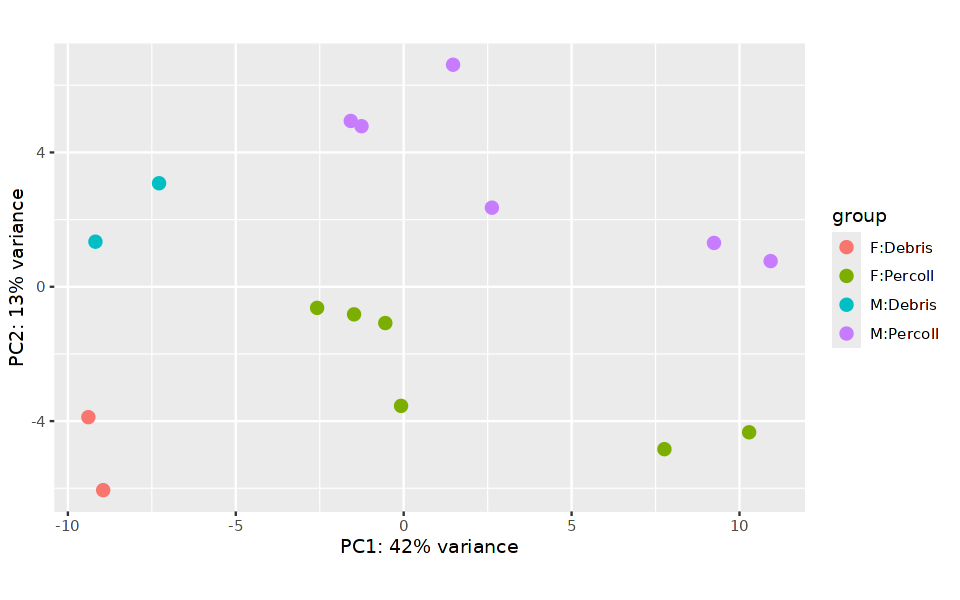

In [296]:
# Plot PCA
options(repr.plot.width=8, repr.plot.height=5)
DESeq2::plotPCA(rld, intgroup = c("group_id", "debris_id"))

In [297]:
# Extract the rlog matrix from the object and compute pairwise correlation values
rld_mat <- assay(rld)
rld_cor <- cor(rld_mat)

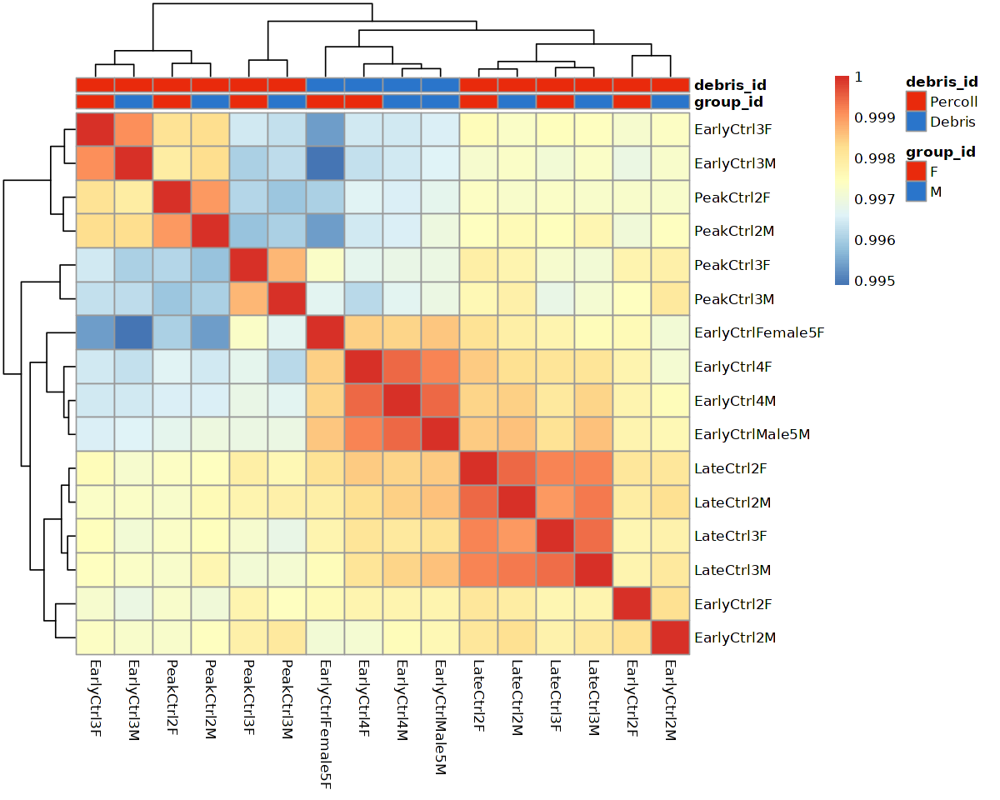

In [298]:
# Plot heatmap
options(repr.plot.width=10, repr.plot.height=8)
pheatmap(rld_cor, annotation = cluster_metadata[, c("group_id","debris_id"), drop=F], annotation_colors = list(group_id=sex_colors, debris_id=debris_colors))

In [299]:
# Run DESeq2 differential expression analysis
dds <- DESeq(dds)

estimating size factors

estimating dispersions

gene-wise dispersion estimates

mean-dispersion relationship

final dispersion estimates

fitting model and testing



In [300]:
libsize = data.frame(x=sizeFactors(dds), y=colSums(assay(dds)))

`geom_smooth()` using formula = 'y ~ x'


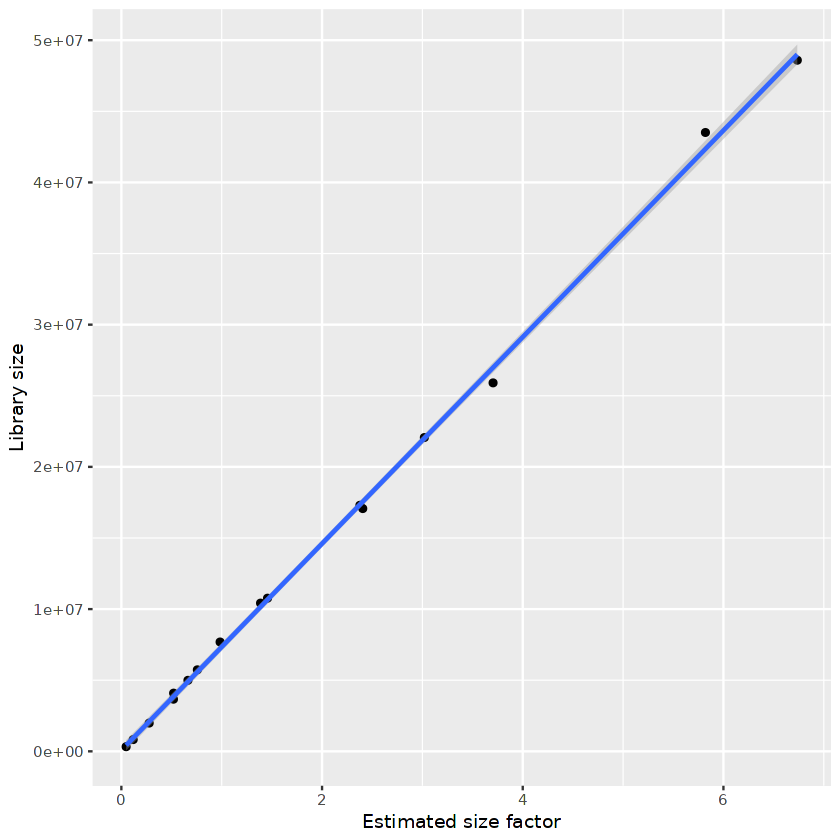

In [301]:
options(repr.plot.width=7, repr.plot.height=7)
ggplot(data=libsize, aes(x=x, y=y)) + geom_point() + geom_smooth(method="lm") + xlab("Estimated size factor") + ylab("Library size")

In [302]:
data.frame(colData(dds))

,cluster_id,sample_id,group_id,debris_id,sizeFactor
,<chr>,<chr>,<fct>,<fct>,<dbl>
EarlyCtrl2F,MOL,EarlyCtrl2F,F,Percoll,0.04761259
EarlyCtrl2M,MOL,EarlyCtrl2M,M,Percoll,0.11793031
EarlyCtrl3F,MOL,EarlyCtrl3F,F,Percoll,0.66343332
EarlyCtrl3M,MOL,EarlyCtrl3M,M,Percoll,0.75711850
EarlyCtrl4F,MOL,EarlyCtrl4F,F,Debris,2.40558487
EarlyCtrl4M,MOL,EarlyCtrl4M,M,Debris,3.70429350
EarlyCtrlFemale5F,MOL,EarlyCtrlFemale5F,F,Debris,5.82063524
EarlyCtrlMale5M,MOL,EarlyCtrlMale5M,M,Debris,6.73619154
LateCtrl2F,MOL,LateCtrl2F,F,Percoll,2.37704948


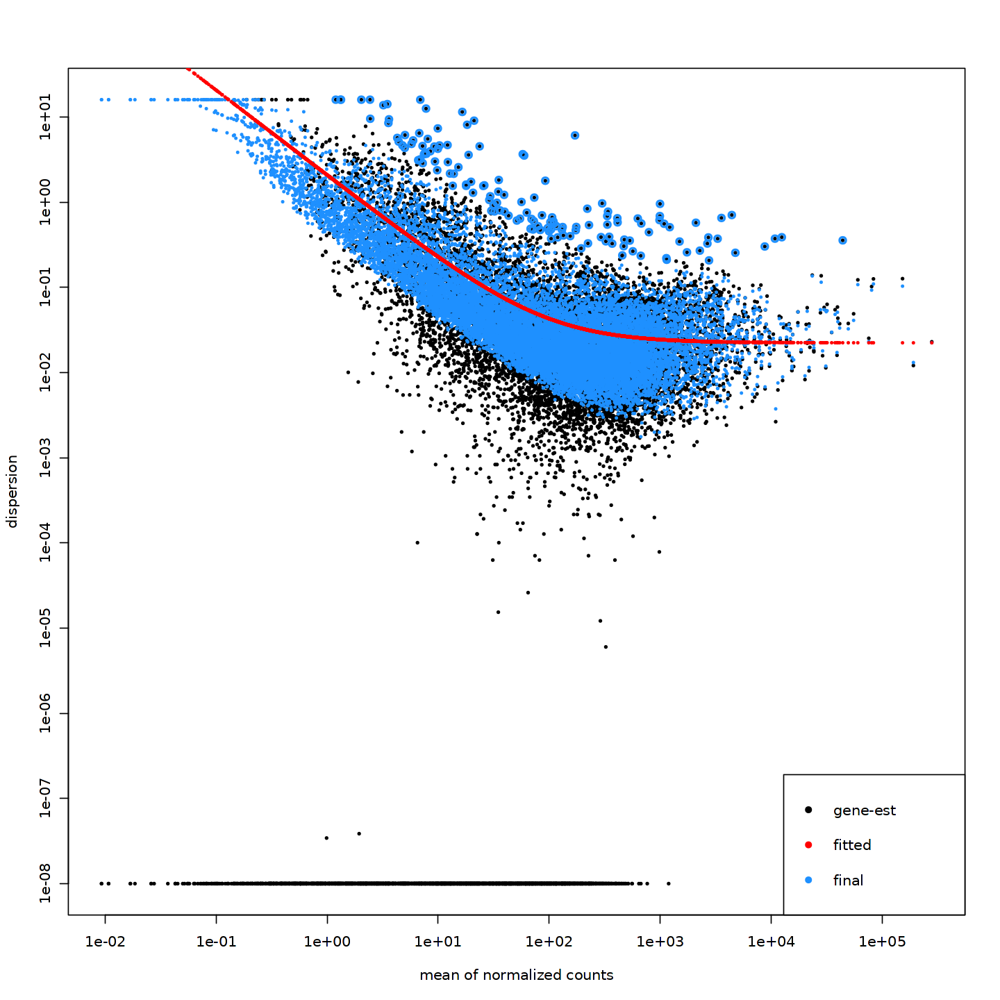

In [303]:
# Plot dispersion estimates
options(repr.plot.width=12, repr.plot.height=12)
plotDispEsts(dds)

In [304]:
condition1 = "M"
condition2 = "F"

In [305]:
contrast <- c("group_id", condition1, condition2)

# resultsNames(dds)
res <- results(dds, contrast = contrast, alpha = 0.05)

In [306]:
summary(res)


out of 14573 with nonzero total read count
adjusted p-value < 0.05
LFC > 0 (up)       : 4, 0.027%
LFC < 0 (down)     : 5, 0.034%
outliers [1]       : 16, 0.11%
low counts [2]     : 0, 0%
(mean count < 0)
[1] see 'cooksCutoff' argument of ?results
[2] see 'independentFiltering' argument of ?results



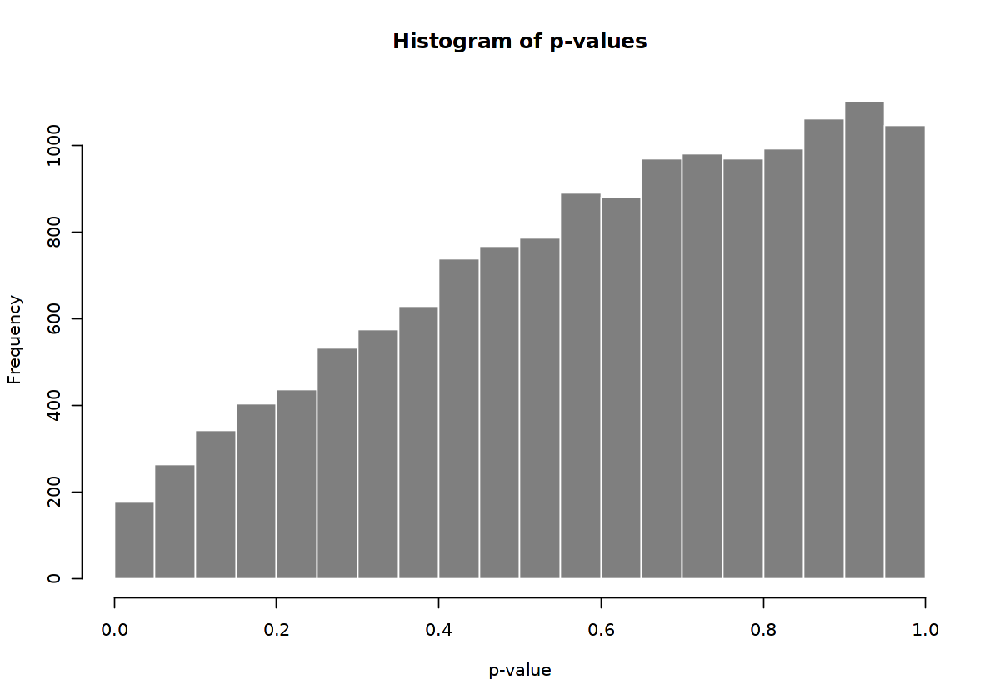

In [307]:
options(repr.plot.width=10, repr.plot.height=7)
hist(res$pvalue, breaks=0:20/20, col="grey50", border="white", xlim=c(0,1), main="Histogram of p-values", xlab="p-value")

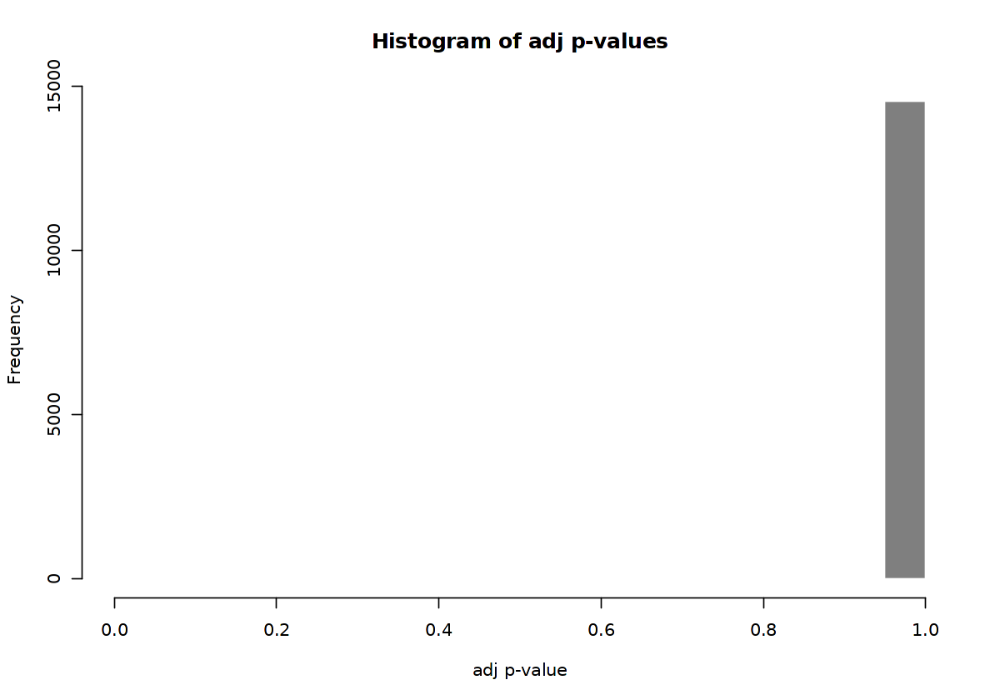

In [308]:
options(repr.plot.width=10, repr.plot.height=7)
hist(res$padj, breaks=0:20/20, col="grey50", border="white", xlim=c(0,1), main="Histogram of adj p-values", xlab="adj p-value")

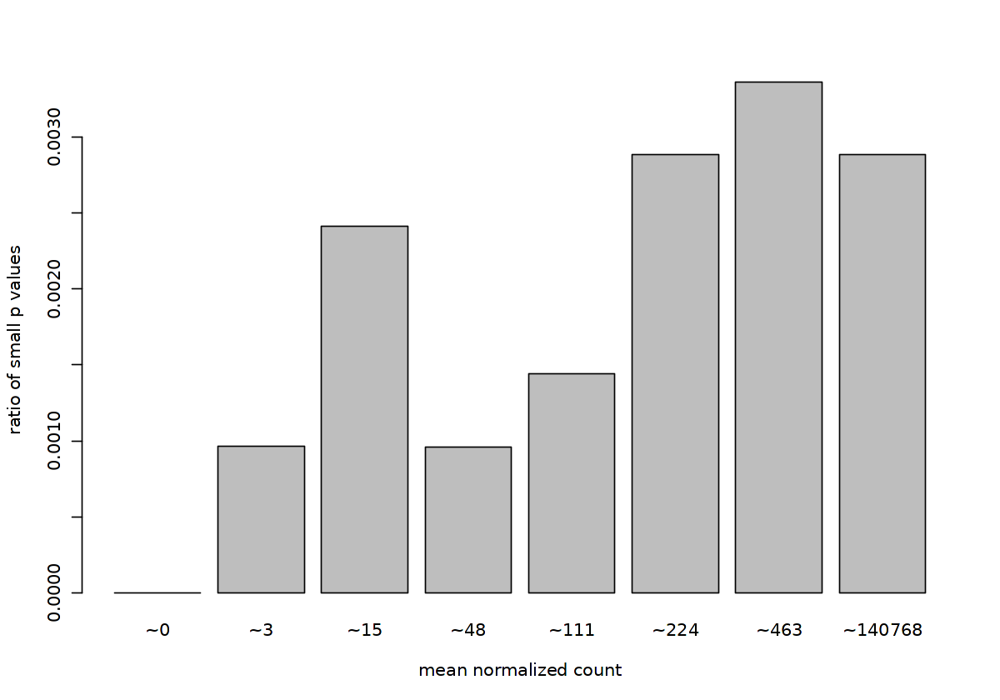

In [309]:
options(repr.plot.width=10, repr.plot.height=7)
qs <- c(0, quantile(res$baseMean[res$baseMean > 0], 0:7/7))
# cut the genes into the bins
bins <- cut(res$baseMean, qs)
# rename the levels of the bins using the middle point
levels(bins) <- paste0("~",round(.5*qs[-1] + .5*qs[-length(qs)]))
# calculate the ratio of $p$ values less than .01 for each bin
ratios <- tapply(res$pvalue, bins, function(p) mean(p < .01, na.rm=TRUE))
# plot these ratios
barplot(ratios, xlab="mean normalized count", ylab="ratio of small p values")

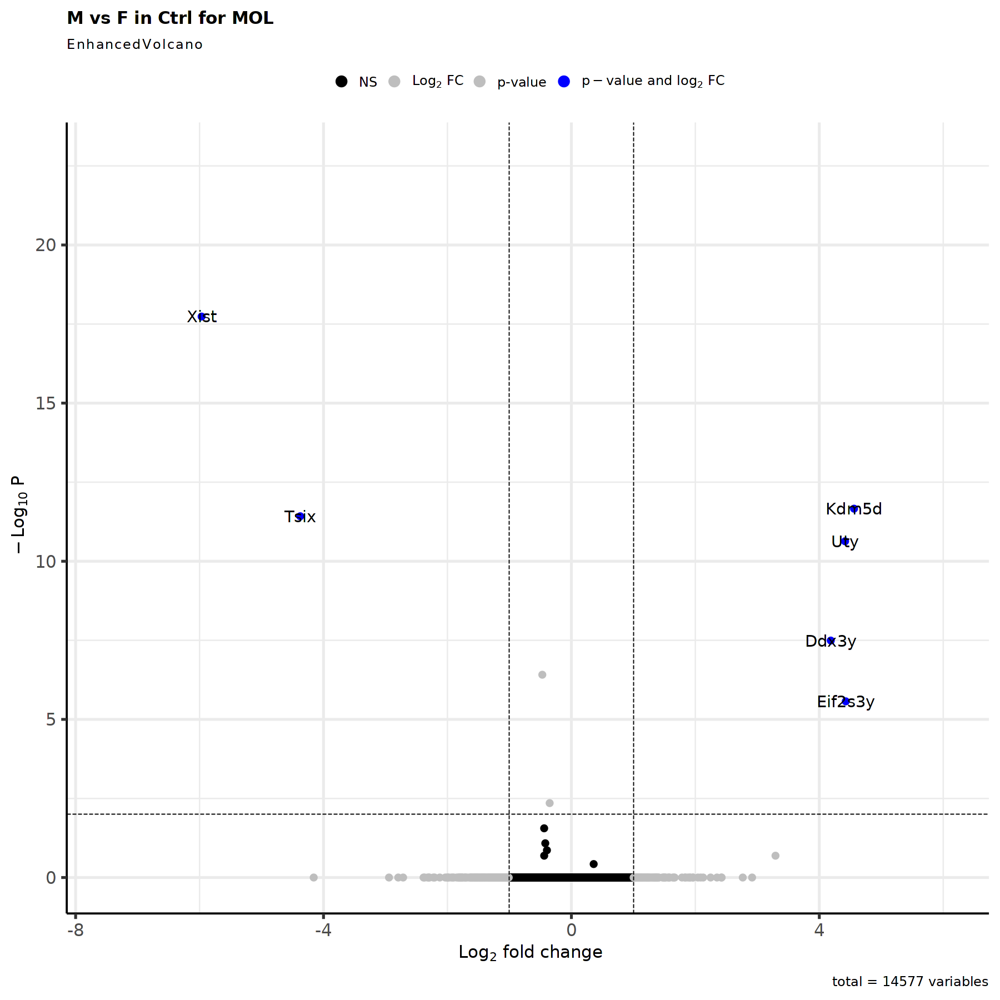

In [310]:
options(repr.plot.width=15, repr.plot.height=15)
#padj<0.001
EnhancedVolcano(res,
    lab = rownames(res),
    x = 'log2FoldChange',
    y = 'padj',
    title = paste0('M vs F in ',timepoint,' for ', cluster_choice),
    pCutoff = 0.01,
    FCcutoff = 1,
    pointSize = 3.0,
    labSize = 6.0,
    col=c('black', 'grey', 'grey', 'blue'),
    colAlpha = 1)

In [311]:
res <- res[complete.cases(res$padj),]

In [312]:
res_filtered <- res[(res$padj < 0.01 & abs(res$log2FoldChange) > 1 & res$baseMean > 1),]

In [313]:
res_filtered[order(abs(res_filtered$log2FoldChange), decreasing=TRUE),]

log2 fold change (MLE): group_id M vs F 
Wald test p-value: group id M vs F 
DataFrame with 6 rows and 6 columns
         baseMean log2FoldChange     lfcSE      stat      pvalue        padj
        <numeric>      <numeric> <numeric> <numeric>   <numeric>   <numeric>
Xist     4433.380       -5.96680  0.609566  -9.78860 1.26025e-22 1.83454e-18
Kdm5d     132.474        4.56095  0.558000   8.17374 2.98982e-16 2.17614e-12
Eif2s3y   300.928        4.42704  0.729523   6.06840 1.29189e-09 2.68658e-06
Uty       414.419        4.41581  0.566465   7.79537 6.42210e-15 2.33716e-11
Tsix     1088.497       -4.37568  0.543050  -8.05759 7.78136e-16 3.77578e-12
Ddx3y     334.488        4.18542  0.616230   6.79197 1.10611e-11 3.22033e-08

In [314]:
nrow(res_filtered)

[1] 6

In [315]:
top.genes.number <- ifelse(nrow(res_filtered)>100, 100, nrow(res_filtered))

In [316]:
res_top <- res_filtered[order(abs(res_filtered$log2FoldChange), decreasing=TRUE),][1:top.genes.number,]
res_top <- res_top[order(res_top$log2FoldChange, decreasing=FALSE),]

In [317]:
tmp_sub <- subset(tmp, subset = cellType == cluster_choice)

In [318]:
tmp_sub <- NormalizeData(tmp_sub, normalization.method = "LogNormalize", scale.factor = 10000, verbose = TRUE)

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


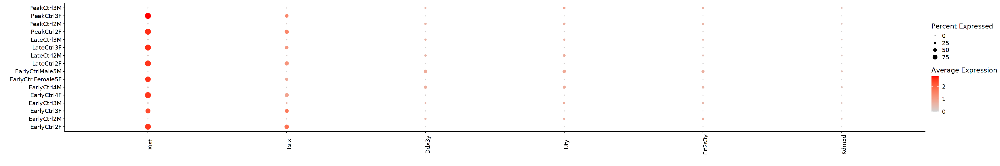

In [319]:
options(repr.plot.width=30, repr.plot.height=5)
plot <- DotPlot(tmp_sub, assay = "RNA", group.by = "orig.ident_Sex", scale=FALSE, cols = c("lightgrey", "red"), dot.scale = 5, features = rownames(res_top))
plot + theme(axis.text.x = element_text(angle = 90)) + labs(x = "", y= "")

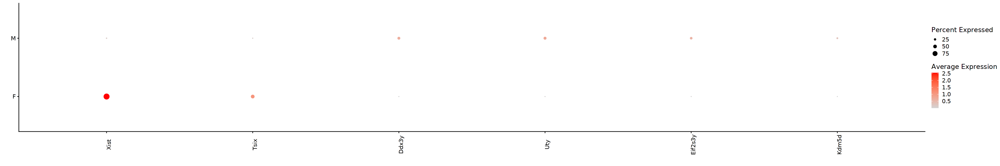

In [320]:
options(repr.plot.width=30, repr.plot.height=5)
plot <- DotPlot(tmp_sub, assay = "RNA", group.by = "Sex", scale=FALSE, cols = c("lightgrey", "red"), dot.scale = 5, features = rownames(res_top))
plot + theme(axis.text.x = element_text(angle = 90)) + labs(x = "", y= "")

In [321]:
HVGs.list[[cluster_choice]] <- rownames(res_filtered)

##### 3.2.2.2 OPC

In [322]:
cluster_choice <- "OPC"

In [323]:
table_sample_low <- table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$sample_id)[cluster_choice,][table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$sample_id)[cluster_choice,] <= 5]
table_sample_low

sample_keep <- names(timepoint_Sex_colors)[!names(timepoint_Sex_colors) %in% names(table_sample_low)]

EarlyCtrl2F EarlyCtrl2M EarlyCtrl3F EarlyCtrl3M  PeakCtrl2F  PeakCtrl2M  PeakCtrl3F  PeakCtrl3M 
          0           1           1           0           5           5           3           1

In [324]:
table_group_low <-table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$group_id)[cluster_choice,][table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$group_id)[cluster_choice,] <= 30]
table_group_low

group_keep <- names(sex_colors)[!names(sex_colors) %in% names(table_group_low)]

named integer(0)

In [325]:
cluster_metadata <- metadata[which(metadata$cluster_id == cluster_choice), ]

# Assign the rownames of the metadata to be the sample IDs
rownames(cluster_metadata) <- cluster_metadata$sample_id

In [326]:
#Remove sample and timepoint with low counts (sample<=5, timepoint<=30)
cluster_metadata <- cluster_metadata[(cluster_metadata$sample_id %in% sample_keep & cluster_metadata$group_id %in% group_keep),]

#new_sample_levels <- levels(cluster_metadata$sample_id)[levels(cluster_metadata$sample_id) %in% sample_keep]
#cluster_metadata$sample_id <- droplevels(cluster_metadata$sample_id)
#levels(cluster_metadata$sample_id) <- new_sample_levels

new_group_levels <- levels(cluster_metadata$group_id)[levels(cluster_metadata$group_id) %in% group_keep]
cluster_metadata$group_id <- droplevels(cluster_metadata$group_id)
levels(cluster_metadata$group_id) <- new_group_levels

In [327]:
cluster_metadata

,cluster_id,sample_id,group_id,debris_id
,<chr>,<chr>,<fct>,<chr>
EarlyCtrl4F,OPC,EarlyCtrl4F,F,Debris
EarlyCtrl4M,OPC,EarlyCtrl4M,M,Debris
EarlyCtrlFemale5F,OPC,EarlyCtrlFemale5F,F,Debris
EarlyCtrlMale5M,OPC,EarlyCtrlMale5M,M,Debris
LateCtrl2F,OPC,LateCtrl2F,F,Percoll
LateCtrl2M,OPC,LateCtrl2M,M,Percoll
LateCtrl3F,OPC,LateCtrl3F,F,Percoll
LateCtrl3M,OPC,LateCtrl3M,M,Percoll


In [328]:
# Subset the counts to only this cluster
counts <- pb[[cluster_choice]]

cluster_counts <- data.frame(counts[, which(colnames(counts) %in% rownames(cluster_metadata))])

# Check that all of the row names of the metadata are the same and in the same order as the column names of the counts in order to use as input to DESeq2
all(rownames(cluster_metadata) == colnames(cluster_counts))

[1] TRUE

In [329]:
dds <- DESeqDataSetFromMatrix(cluster_counts, colData = cluster_metadata, design = ~ group_id + debris_id)

converting counts to integer mode

Warning message in DESeqDataSet(se, design = design, ignoreRank):
"some variables in design formula are characters, converting to factors"


In [330]:
# Transform counts for data visualization
rld <- rlog(dds, blind=TRUE)

using ntop=500 top features by variance



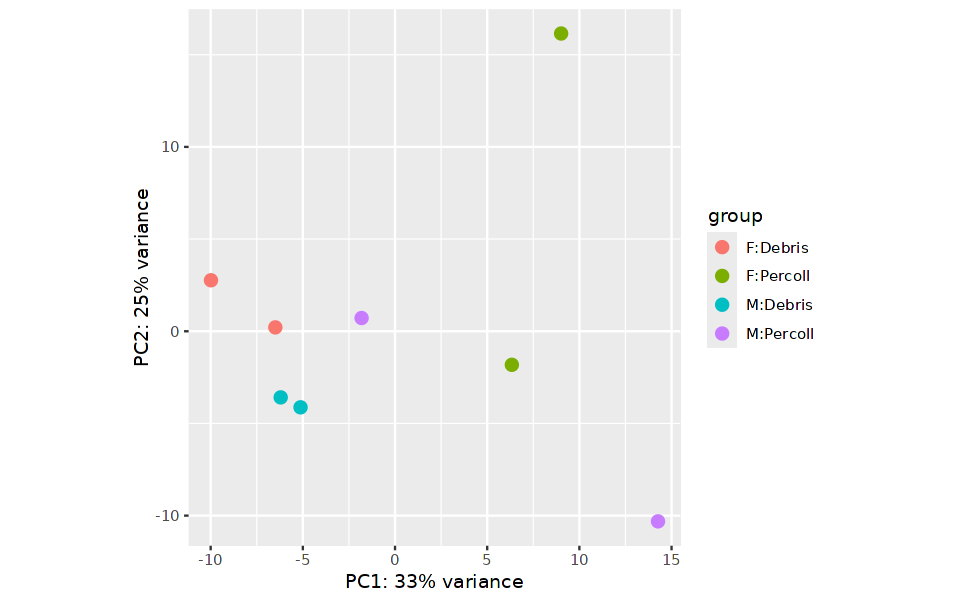

In [331]:
# Plot PCA
options(repr.plot.width=8, repr.plot.height=5)
DESeq2::plotPCA(rld, intgroup = c("group_id", "debris_id"))

In [332]:
# Extract the rlog matrix from the object and compute pairwise correlation values
rld_mat <- assay(rld)
rld_cor <- cor(rld_mat)

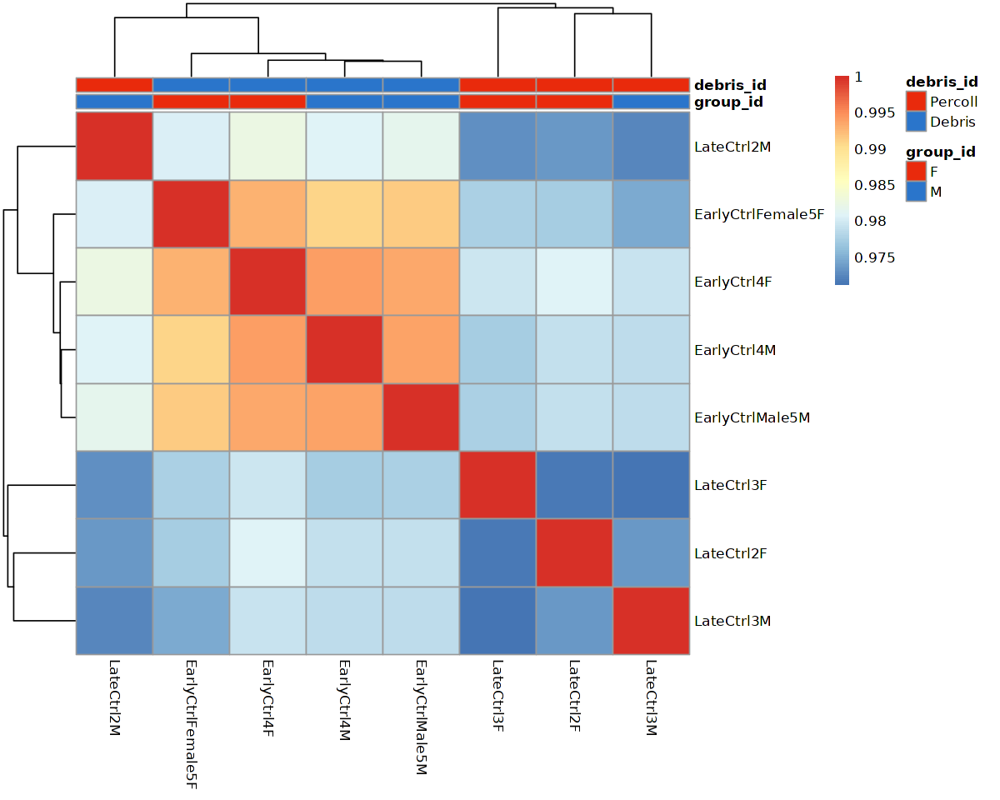

In [333]:
# Plot heatmap
options(repr.plot.width=10, repr.plot.height=8)
pheatmap(rld_cor, annotation = cluster_metadata[, c("group_id","debris_id"), drop=F], annotation_colors = list(group_id=sex_colors, debris_id=debris_colors))

In [334]:
# Run DESeq2 differential expression analysis
dds <- DESeq(dds)

estimating size factors

estimating dispersions

gene-wise dispersion estimates

mean-dispersion relationship

final dispersion estimates

fitting model and testing



In [335]:
libsize = data.frame(x=sizeFactors(dds), y=colSums(assay(dds)))

`geom_smooth()` using formula = 'y ~ x'


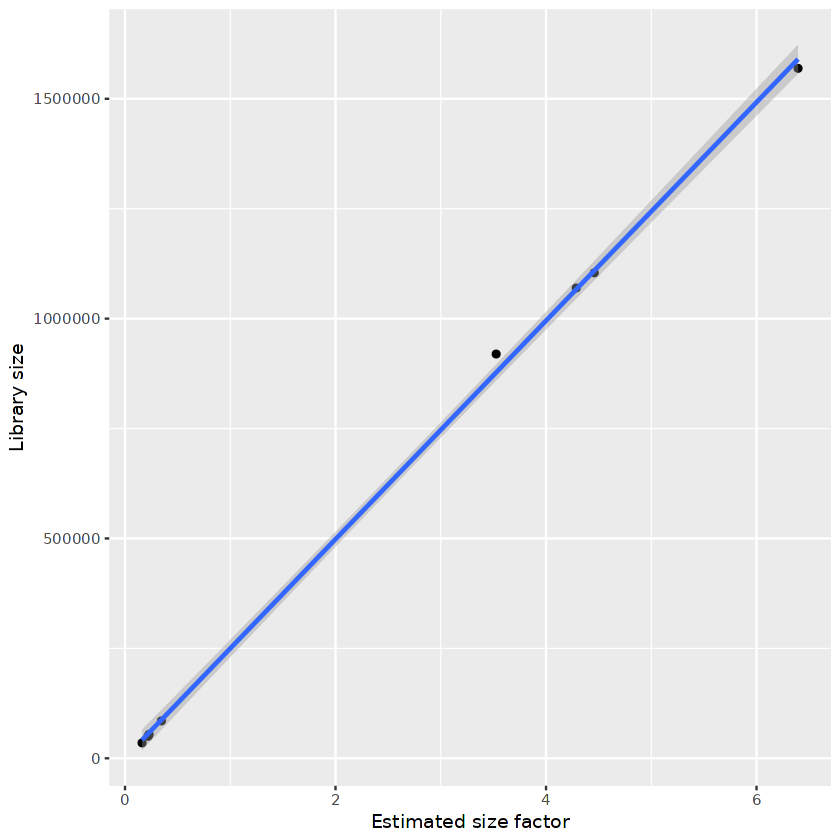

In [336]:
options(repr.plot.width=7, repr.plot.height=7)
ggplot(data=libsize, aes(x=x, y=y)) + geom_point() + geom_smooth(method="lm") + xlab("Estimated size factor") + ylab("Library size")

In [337]:
data.frame(colData(dds))

,cluster_id,sample_id,group_id,debris_id,sizeFactor
,<chr>,<chr>,<fct>,<fct>,<dbl>
EarlyCtrl4F,OPC,EarlyCtrl4F,F,Debris,6.3946546
EarlyCtrl4M,OPC,EarlyCtrl4M,M,Debris,4.4584540
EarlyCtrlFemale5F,OPC,EarlyCtrlFemale5F,F,Debris,3.5263256
EarlyCtrlMale5M,OPC,EarlyCtrlMale5M,M,Debris,4.2868522
LateCtrl2F,OPC,LateCtrl2F,F,Percoll,0.2183711
LateCtrl2M,OPC,LateCtrl2M,M,Percoll,0.3456718
LateCtrl3F,OPC,LateCtrl3F,F,Percoll,0.2288119
LateCtrl3M,OPC,LateCtrl3M,M,Percoll,0.1617921


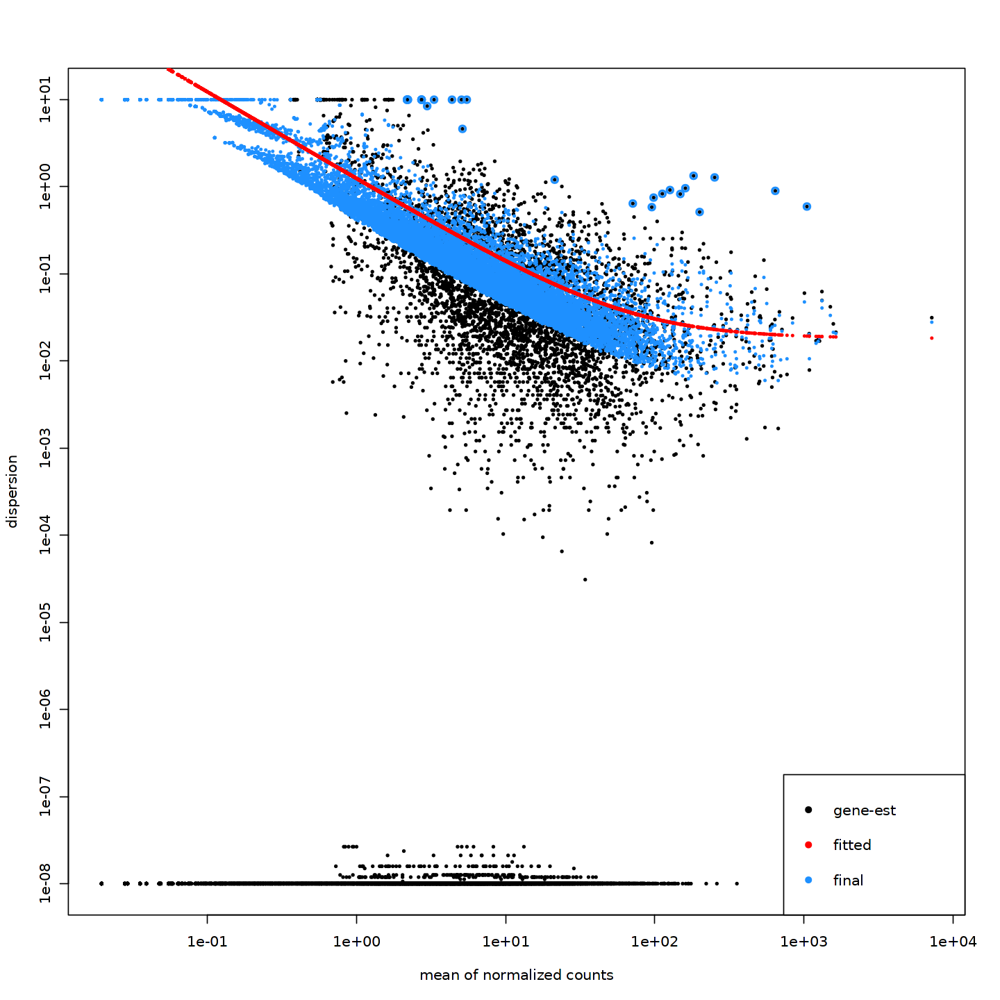

In [338]:
# Plot dispersion estimates
options(repr.plot.width=12, repr.plot.height=12)
plotDispEsts(dds)

In [339]:
condition1 = "M"
condition2 = "F"

In [340]:
contrast <- c("group_id", condition1, condition2)

# resultsNames(dds)
res <- results(dds, contrast = contrast, alpha = 0.05)

In [341]:
summary(res)


out of 14174 with nonzero total read count
adjusted p-value < 0.05
LFC > 0 (up)       : 3, 0.021%
LFC < 0 (down)     : 2, 0.014%
outliers [1]       : 0, 0%
low counts [2]     : 0, 0%
(mean count < 0)
[1] see 'cooksCutoff' argument of ?results
[2] see 'independentFiltering' argument of ?results



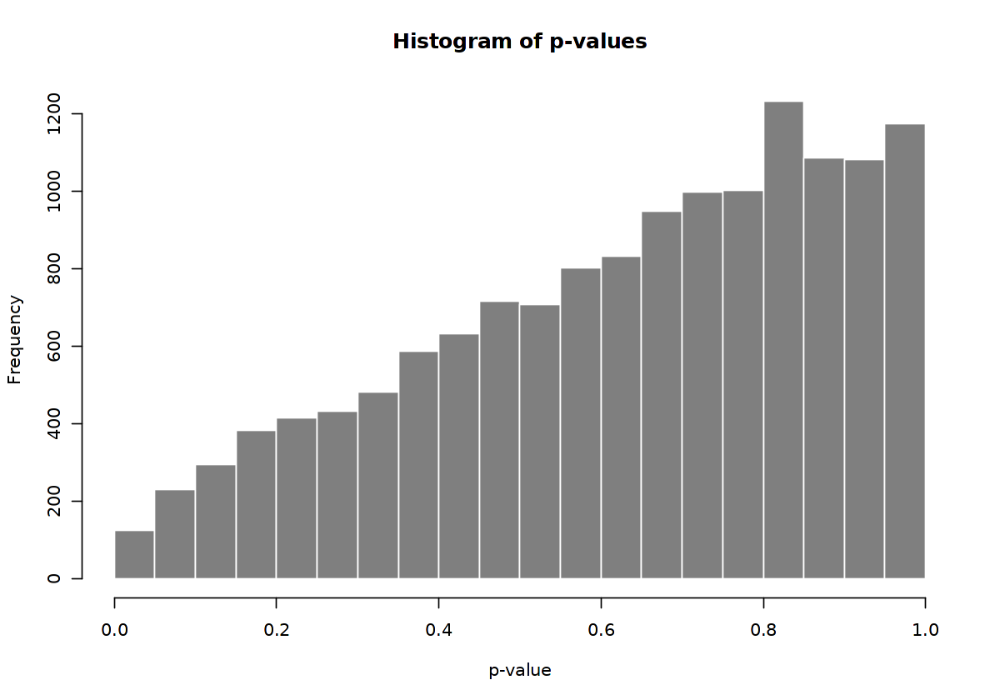

In [342]:
options(repr.plot.width=10, repr.plot.height=7)
hist(res$pvalue, breaks=0:20/20, col="grey50", border="white", xlim=c(0,1), main="Histogram of p-values", xlab="p-value")

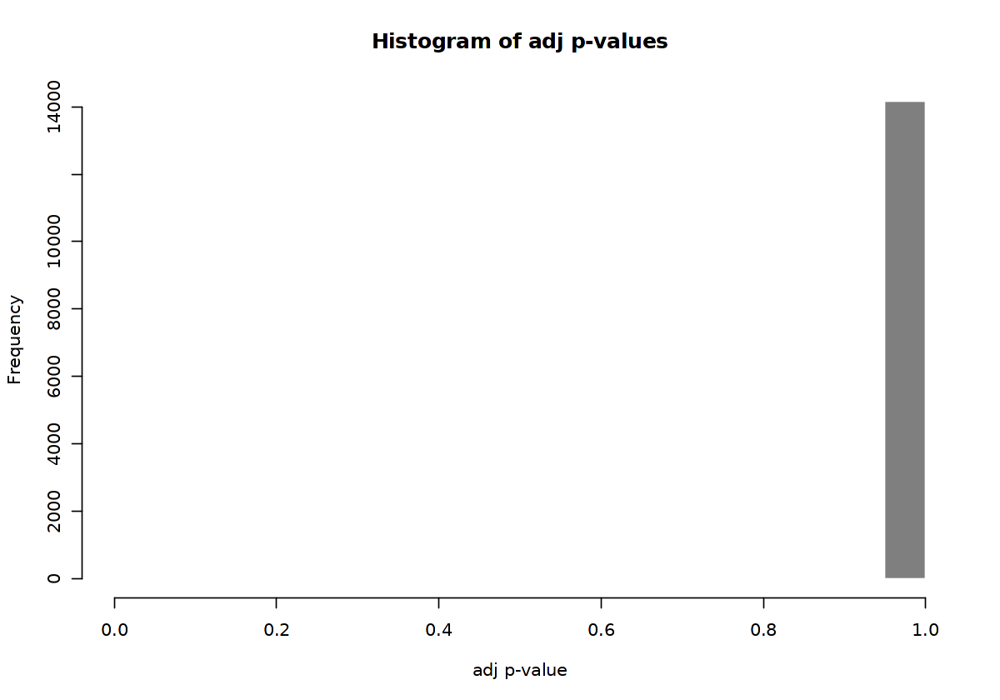

In [343]:
options(repr.plot.width=10, repr.plot.height=7)
hist(res$padj, breaks=0:20/20, col="grey50", border="white", xlim=c(0,1), main="Histogram of adj p-values", xlab="adj p-value")

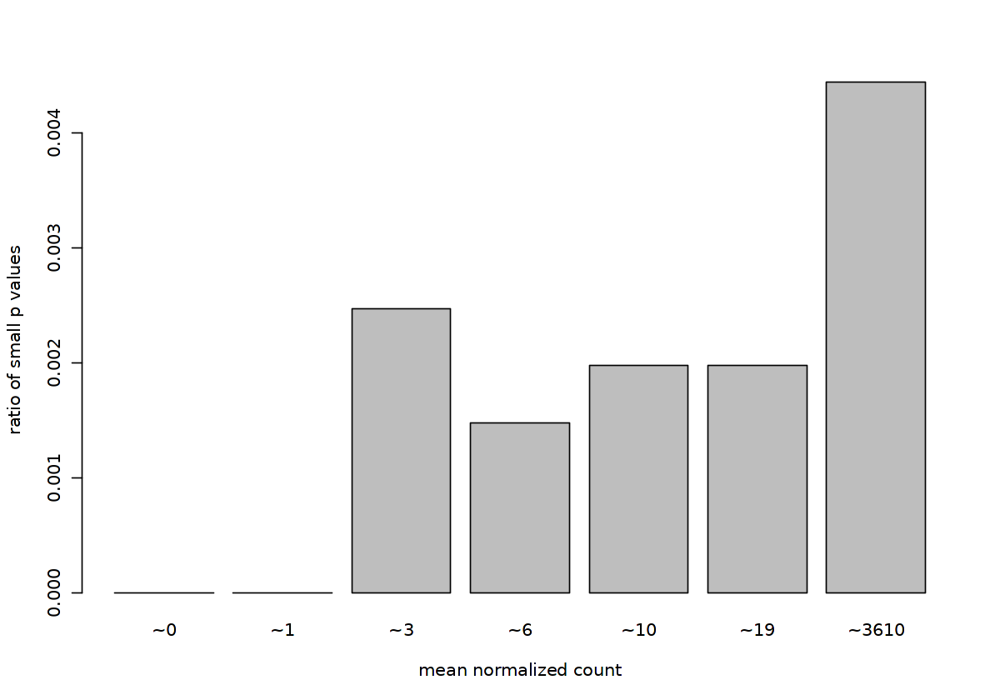

In [344]:
options(repr.plot.width=10, repr.plot.height=7)
qs <- c(0, quantile(res$baseMean[res$baseMean > 0], 0:7/7))
# cut the genes into the bins
bins <- cut(res$baseMean, qs)
# rename the levels of the bins using the middle point
levels(bins) <- paste0("~",round(.5*qs[-1] + .5*qs[-length(qs)]))
# calculate the ratio of $p$ values less than .01 for each bin
ratios <- tapply(res$pvalue, bins, function(p) mean(p < .01, na.rm=TRUE))
# plot these ratios
barplot(ratios, xlab="mean normalized count", ylab="ratio of small p values")

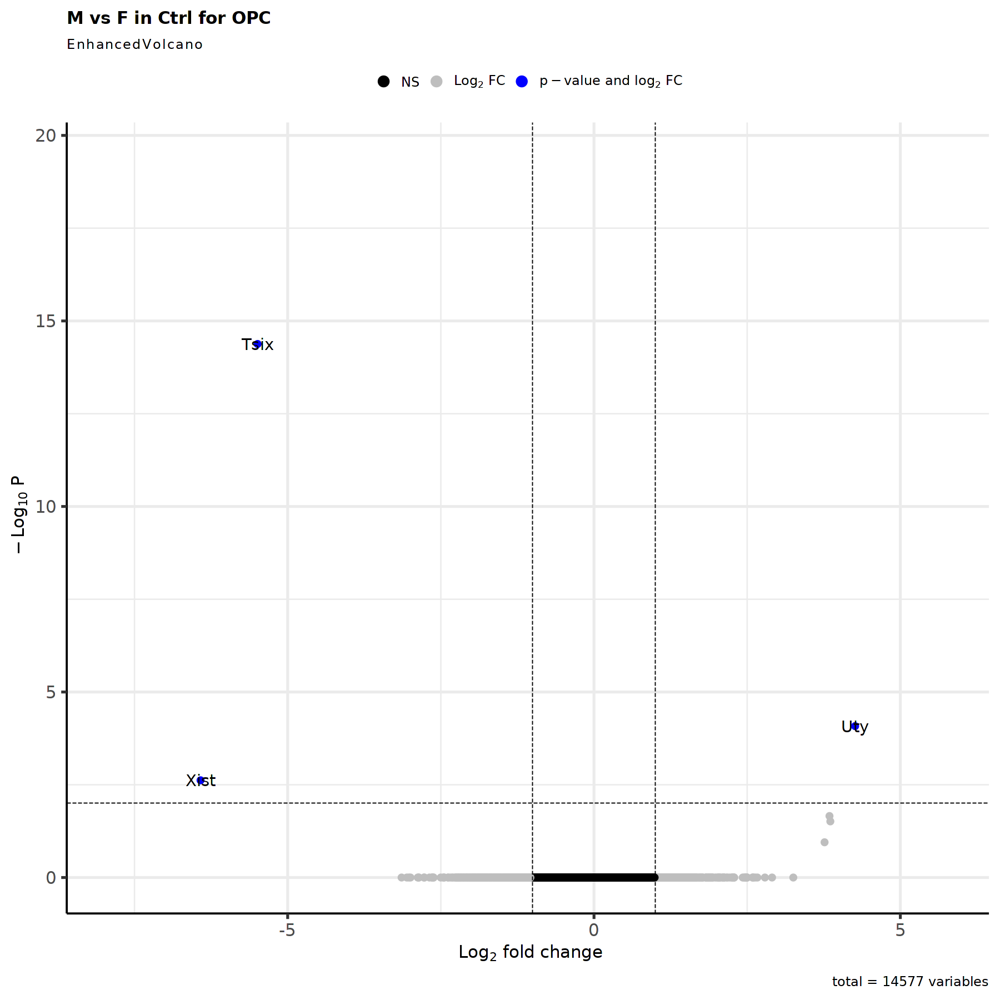

In [345]:
options(repr.plot.width=15, repr.plot.height=15)
#padj<0.001
EnhancedVolcano(res,
    lab = rownames(res),
    x = 'log2FoldChange',
    y = 'padj',
    title = paste0('M vs F in ',timepoint,' for ', cluster_choice),
    pCutoff = 0.01,
    FCcutoff = 1,
    pointSize = 3.0,
    labSize = 6.0,
    col=c('black', 'grey', 'grey', 'blue'),
    colAlpha = 1)

In [346]:
res <- res[complete.cases(res$padj),]

In [347]:
res_filtered <- res[(res$padj < 0.01 & abs(res$log2FoldChange) > 1 & res$baseMean > 1),]

In [348]:
res_filtered[order(abs(res_filtered$log2FoldChange), decreasing=TRUE),]

log2 fold change (MLE): group_id M vs F 
Wald test p-value: group id M vs F 
DataFrame with 3 rows and 6 columns
      baseMean log2FoldChange     lfcSE      stat      pvalue        padj
     <numeric>      <numeric> <numeric> <numeric>   <numeric>   <numeric>
Xist  182.0053       -6.42160  1.278332  -5.02342 5.07598e-07 2.39823e-03
Tsix   28.7236       -5.49049  0.612045  -8.97073 2.94545e-19 4.17489e-15
Uty    18.2687        4.26179  0.747213   5.70357 1.17321e-08 8.31451e-05

In [349]:
nrow(res_filtered)

[1] 3

In [350]:
top.genes.number <- ifelse(nrow(res_filtered)>100, 100, nrow(res_filtered))

In [351]:
res_top <- res_filtered[order(abs(res_filtered$log2FoldChange), decreasing=TRUE),][1:top.genes.number,]
res_top <- res_top[order(res_top$log2FoldChange, decreasing=FALSE),]

In [352]:
tmp_sub <- subset(tmp, subset = cellType == cluster_choice)

In [353]:
tmp_sub <- NormalizeData(tmp_sub, normalization.method = "LogNormalize", scale.factor = 10000, verbose = TRUE)

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


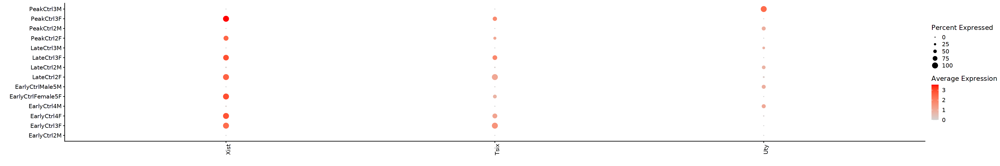

In [354]:
options(repr.plot.width=30, repr.plot.height=5)
plot <- DotPlot(tmp_sub, assay = "RNA", group.by = "orig.ident_Sex", scale=FALSE, cols = c("lightgrey", "red"), dot.scale = 5, features = rownames(res_top))
plot + theme(axis.text.x = element_text(angle = 90)) + labs(x = "", y= "")

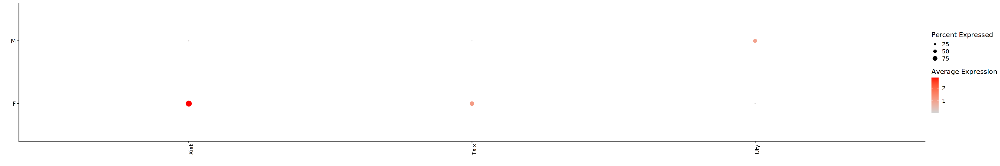

In [355]:
options(repr.plot.width=30, repr.plot.height=5)
plot <- DotPlot(tmp_sub, assay = "RNA", group.by = "Sex", scale=FALSE, cols = c("lightgrey", "red"), dot.scale = 5, features = rownames(res_top))
plot + theme(axis.text.x = element_text(angle = 90)) + labs(x = "", y= "")

In [356]:
HVGs.list[[cluster_choice]] <- rownames(res_filtered)

##### 3.2.2.3 Micro

In [357]:
cluster_choice <- "Micro"

In [358]:
table_sample_low <- table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$sample_id)[cluster_choice,][table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$sample_id)[cluster_choice,] <= 5]
table_sample_low

sample_keep <- names(timepoint_Sex_colors)[!names(timepoint_Sex_colors) %in% names(table_sample_low)]

EarlyCtrl3F EarlyCtrl3M  PeakCtrl2F  PeakCtrl2M 
          5           3           4           2

In [359]:
table_group_low <-table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$group_id)[cluster_choice,][table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$group_id)[cluster_choice,] <= 30]
table_group_low

group_keep <- names(sex_colors)[!names(sex_colors) %in% names(table_group_low)]

named integer(0)

In [360]:
cluster_metadata <- metadata[which(metadata$cluster_id == cluster_choice), ]

# Assign the rownames of the metadata to be the sample IDs
rownames(cluster_metadata) <- cluster_metadata$sample_id

In [361]:
#Remove sample and timepoint with low counts (sample<=5, timepoint<=30)
cluster_metadata <- cluster_metadata[(cluster_metadata$sample_id %in% sample_keep & cluster_metadata$group_id %in% group_keep),]

#new_sample_levels <- levels(cluster_metadata$sample_id)[levels(cluster_metadata$sample_id) %in% sample_keep]
#cluster_metadata$sample_id <- droplevels(cluster_metadata$sample_id)
#levels(cluster_metadata$sample_id) <- new_sample_levels

new_group_levels <- levels(cluster_metadata$group_id)[levels(cluster_metadata$group_id) %in% group_keep]
cluster_metadata$group_id <- droplevels(cluster_metadata$group_id)
levels(cluster_metadata$group_id) <- new_group_levels

In [362]:
cluster_metadata

,cluster_id,sample_id,group_id,debris_id
,<chr>,<chr>,<fct>,<chr>
EarlyCtrl2F,Micro,EarlyCtrl2F,F,Percoll
EarlyCtrl2M,Micro,EarlyCtrl2M,M,Percoll
EarlyCtrl4F,Micro,EarlyCtrl4F,F,Debris
EarlyCtrl4M,Micro,EarlyCtrl4M,M,Debris
EarlyCtrlFemale5F,Micro,EarlyCtrlFemale5F,F,Debris
EarlyCtrlMale5M,Micro,EarlyCtrlMale5M,M,Debris
LateCtrl2F,Micro,LateCtrl2F,F,Percoll
LateCtrl2M,Micro,LateCtrl2M,M,Percoll
LateCtrl3F,Micro,LateCtrl3F,F,Percoll


In [363]:
# Subset the counts to only this cluster
counts <- pb[[cluster_choice]]

cluster_counts <- data.frame(counts[, which(colnames(counts) %in% rownames(cluster_metadata))])

# Check that all of the row names of the metadata are the same and in the same order as the column names of the counts in order to use as input to DESeq2
all(rownames(cluster_metadata) == colnames(cluster_counts))

[1] TRUE

In [364]:
dds <- DESeqDataSetFromMatrix(cluster_counts, colData = cluster_metadata, design = ~ group_id + debris_id)

converting counts to integer mode

Warning message in DESeqDataSet(se, design = design, ignoreRank):
"some variables in design formula are characters, converting to factors"


In [365]:
# Transform counts for data visualization
rld <- rlog(dds, blind=TRUE)

using ntop=500 top features by variance



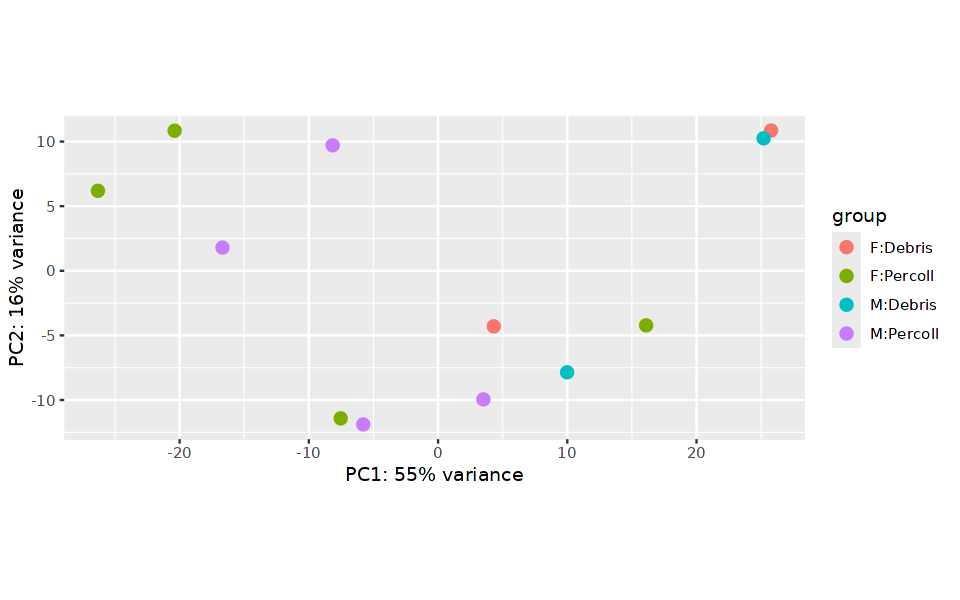

In [366]:
# Plot PCA
options(repr.plot.width=8, repr.plot.height=5)
DESeq2::plotPCA(rld, intgroup = c("group_id", "debris_id"))

In [367]:
# Extract the rlog matrix from the object and compute pairwise correlation values
rld_mat <- assay(rld)
rld_cor <- cor(rld_mat)

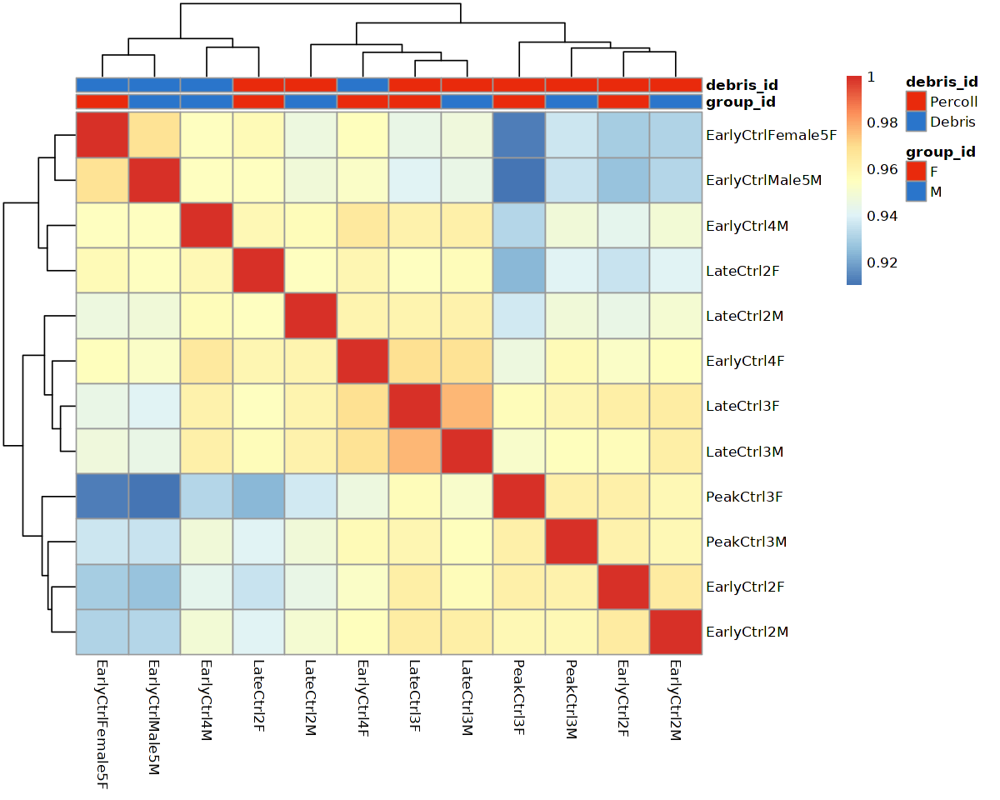

In [368]:
# Plot heatmap
options(repr.plot.width=10, repr.plot.height=8)
pheatmap(rld_cor, annotation = cluster_metadata[, c("group_id","debris_id"), drop=F], annotation_colors = list(group_id=sex_colors, debris_id=debris_colors))

In [369]:
# Run DESeq2 differential expression analysis
dds <- DESeq(dds)

estimating size factors

estimating dispersions

gene-wise dispersion estimates

mean-dispersion relationship

final dispersion estimates

fitting model and testing



In [370]:
libsize = data.frame(x=sizeFactors(dds), y=colSums(assay(dds)))

`geom_smooth()` using formula = 'y ~ x'


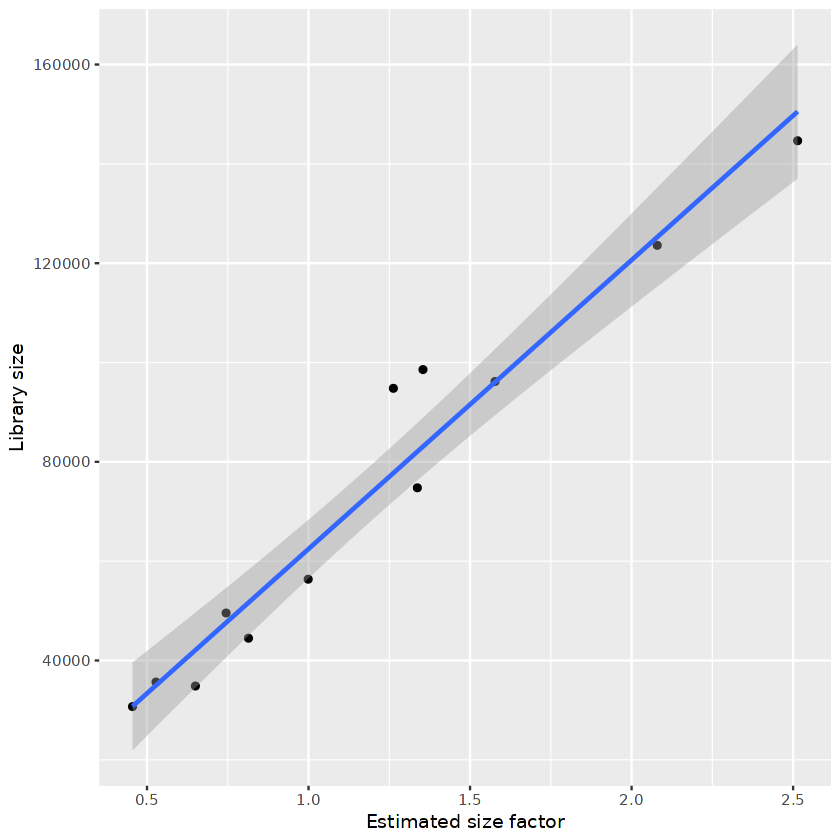

In [371]:
options(repr.plot.width=7, repr.plot.height=7)
ggplot(data=libsize, aes(x=x, y=y)) + geom_point() + geom_smooth(method="lm") + xlab("Estimated size factor") + ylab("Library size")

In [372]:
data.frame(colData(dds))

,cluster_id,sample_id,group_id,debris_id,sizeFactor
,<chr>,<chr>,<fct>,<fct>,<dbl>
EarlyCtrl2F,Micro,EarlyCtrl2F,F,Percoll,1.3368485
EarlyCtrl2M,Micro,EarlyCtrl2M,M,Percoll,0.9989685
EarlyCtrl4F,Micro,EarlyCtrl4F,F,Debris,1.5773930
EarlyCtrl4M,Micro,EarlyCtrl4M,M,Debris,0.7448633
EarlyCtrlFemale5F,Micro,EarlyCtrlFemale5F,F,Debris,1.3543118
EarlyCtrlMale5M,Micro,EarlyCtrlMale5M,M,Debris,1.2626612
LateCtrl2F,Micro,LateCtrl2F,F,Percoll,0.4551207
LateCtrl2M,Micro,LateCtrl2M,M,Percoll,0.5278483
LateCtrl3F,Micro,LateCtrl3F,F,Percoll,2.5139343


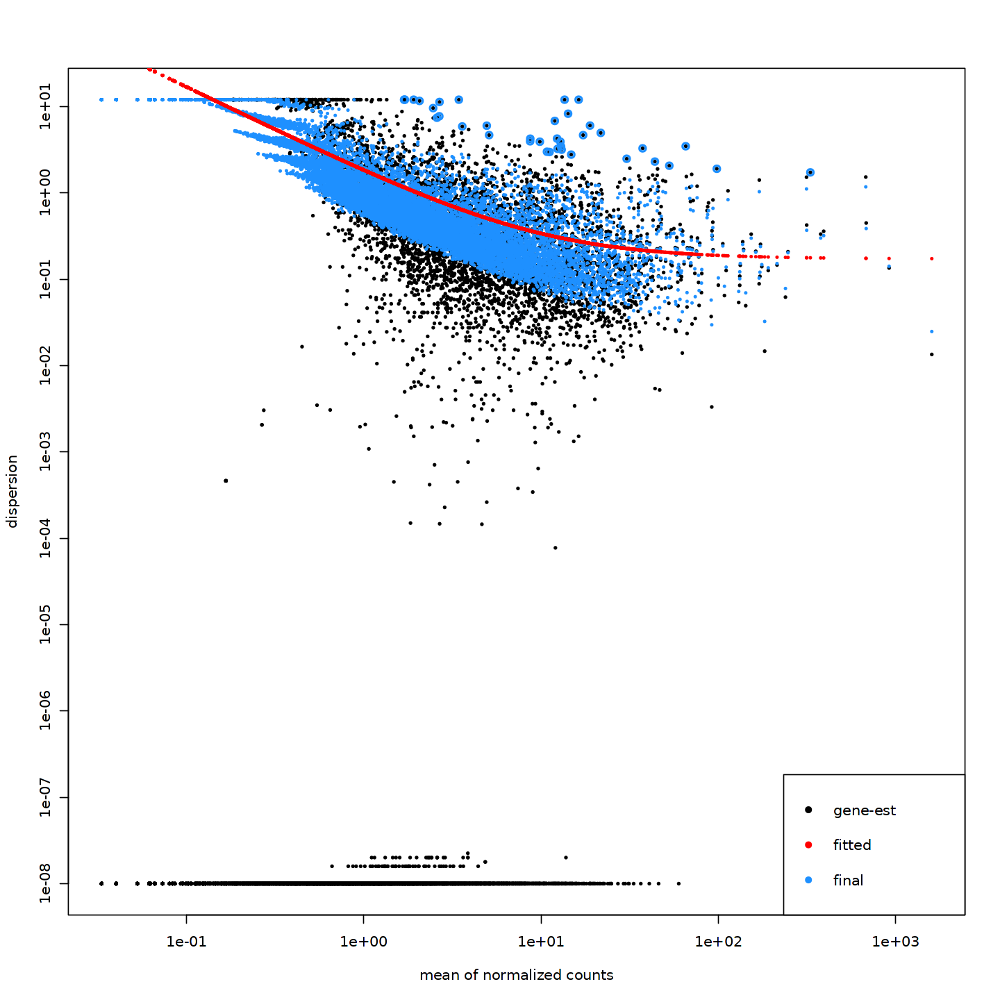

In [373]:
# Plot dispersion estimates
options(repr.plot.width=12, repr.plot.height=12)
plotDispEsts(dds)

In [374]:
condition1 = "M"
condition2 = "F"

In [375]:
contrast <- c("group_id", condition1, condition2)

# resultsNames(dds)
res <- results(dds, contrast = contrast, alpha = 0.05)

In [376]:
summary(res)


out of 13343 with nonzero total read count
adjusted p-value < 0.05
LFC > 0 (up)       : 2, 0.015%
LFC < 0 (down)     : 2, 0.015%
outliers [1]       : 4, 0.03%
low counts [2]     : 0, 0%
(mean count < 0)
[1] see 'cooksCutoff' argument of ?results
[2] see 'independentFiltering' argument of ?results



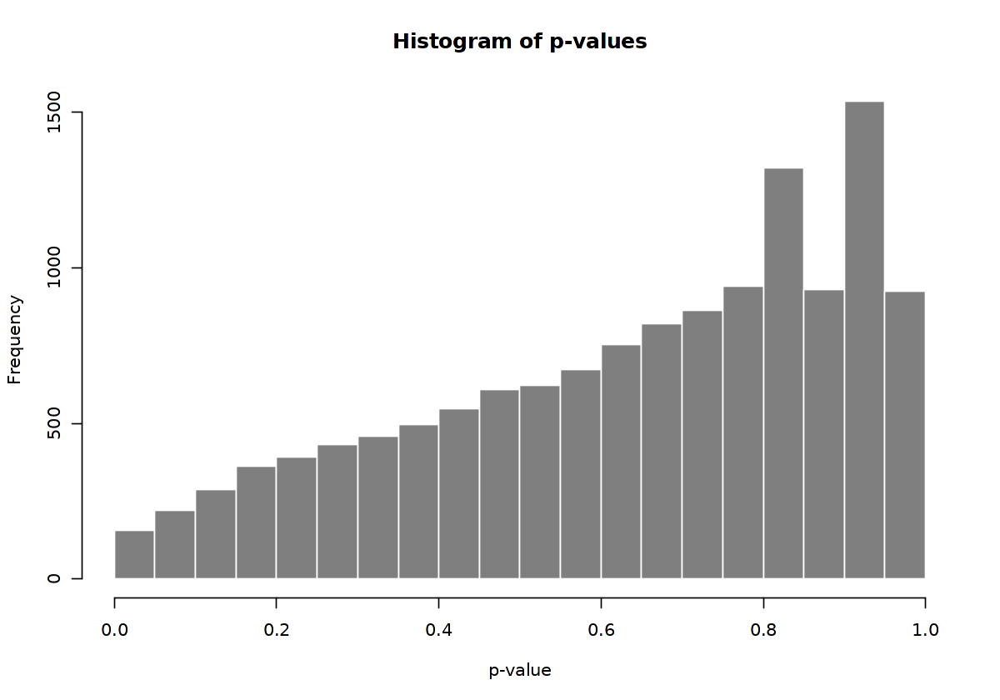

In [377]:
options(repr.plot.width=10, repr.plot.height=7)
hist(res$pvalue, breaks=0:20/20, col="grey50", border="white", xlim=c(0,1), main="Histogram of p-values", xlab="p-value")

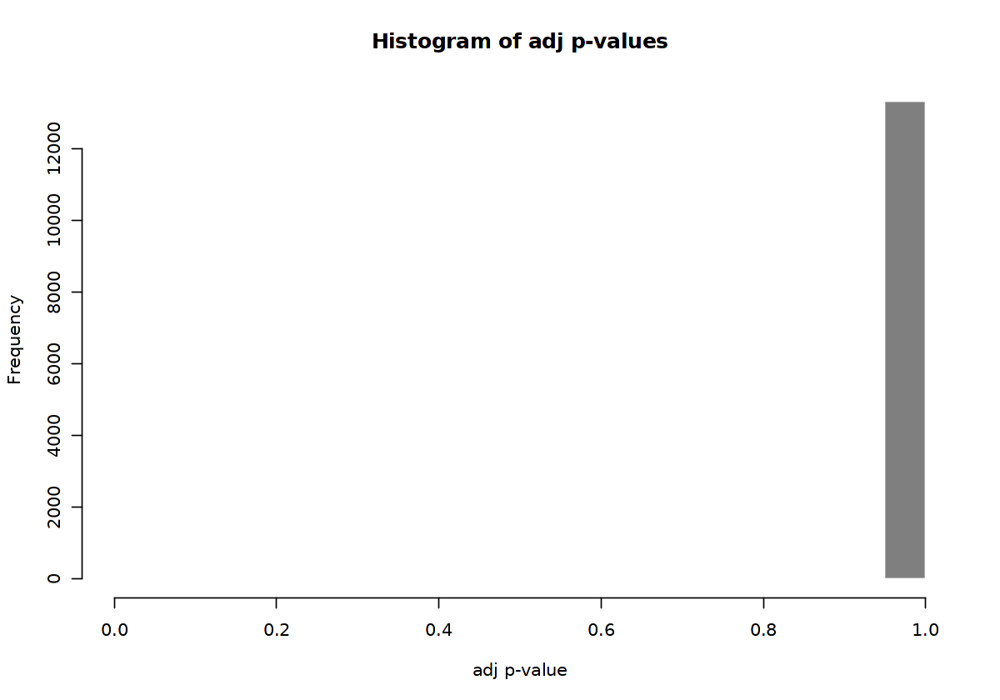

In [378]:
options(repr.plot.width=10, repr.plot.height=7)
hist(res$padj, breaks=0:20/20, col="grey50", border="white", xlim=c(0,1), main="Histogram of adj p-values", xlab="adj p-value")

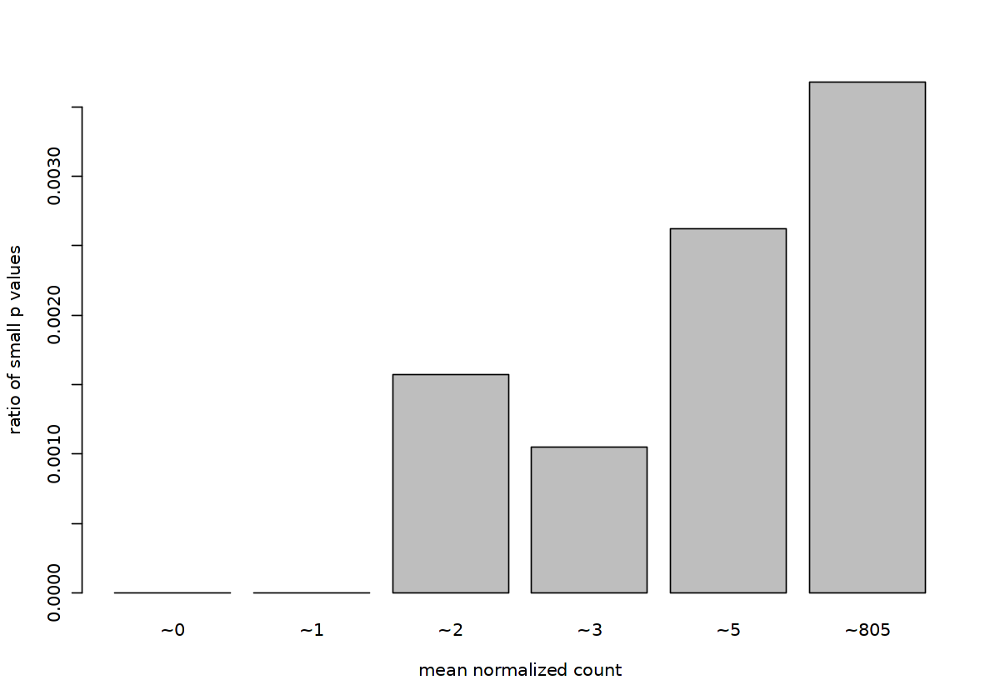

In [379]:
options(repr.plot.width=10, repr.plot.height=7)
qs <- c(0, quantile(res$baseMean[res$baseMean > 0], 0:7/7))
# cut the genes into the bins
bins <- cut(res$baseMean, qs)
# rename the levels of the bins using the middle point
levels(bins) <- paste0("~",round(.5*qs[-1] + .5*qs[-length(qs)]))
# calculate the ratio of $p$ values less than .01 for each bin
ratios <- tapply(res$pvalue, bins, function(p) mean(p < .01, na.rm=TRUE))
# plot these ratios
barplot(ratios, xlab="mean normalized count", ylab="ratio of small p values")

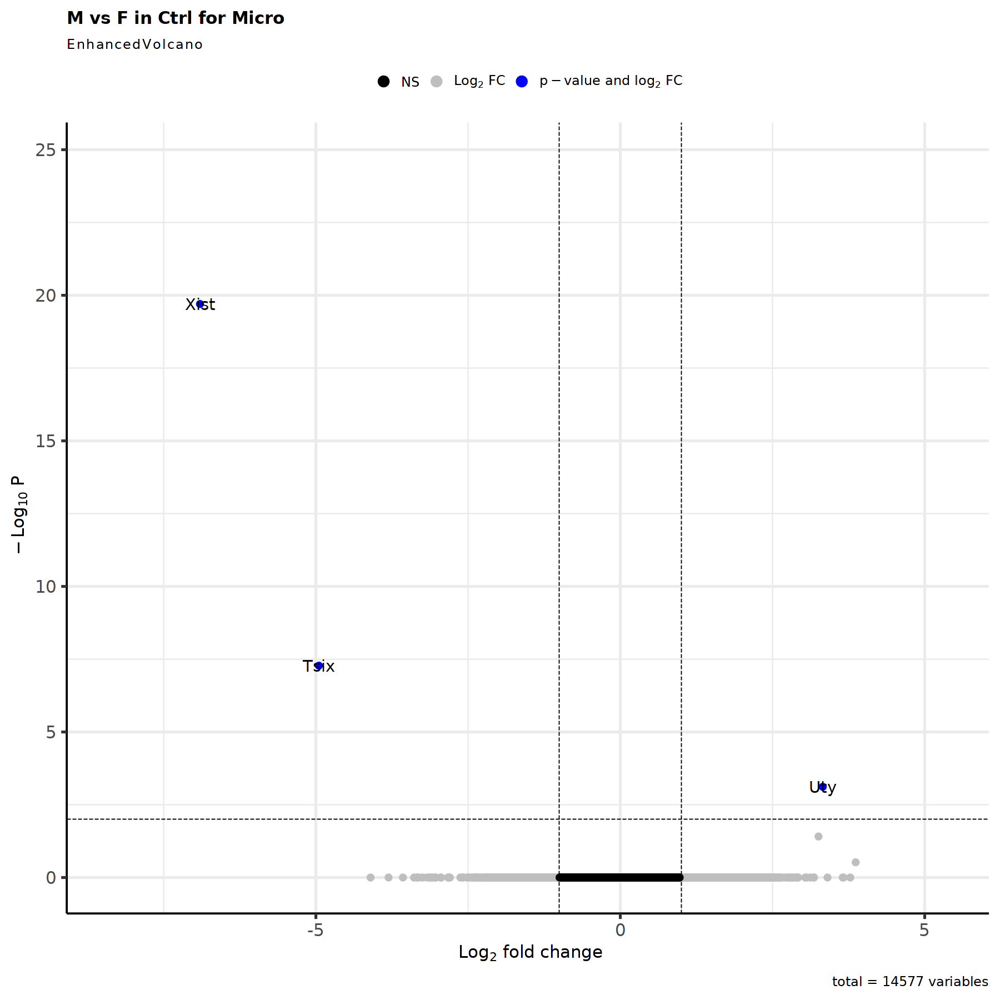

In [380]:
options(repr.plot.width=15, repr.plot.height=15)
#padj<0.001
EnhancedVolcano(res,
    lab = rownames(res),
    x = 'log2FoldChange',
    y = 'padj',
    title = paste0('M vs F in ',timepoint,' for ', cluster_choice),
    pCutoff = 0.01,
    FCcutoff = 1,
    pointSize = 3.0,
    labSize = 6.0,
    col=c('black', 'grey', 'grey', 'blue'),
    colAlpha = 1)

In [381]:
res <- res[complete.cases(res$padj),]

In [382]:
res_filtered <- res[(res$padj < 0.01 & abs(res$log2FoldChange) > 1 & res$baseMean > 1),]

In [383]:
res_filtered[order(abs(res_filtered$log2FoldChange), decreasing=TRUE),]

log2 fold change (MLE): group_id M vs F 
Wald test p-value: group id M vs F 
DataFrame with 3 rows and 6 columns
      baseMean log2FoldChange     lfcSE      stat      pvalue        padj
     <numeric>      <numeric> <numeric> <numeric>   <numeric>   <numeric>
Xist  54.15860       -6.90375  0.675022 -10.22744 1.49413e-24 1.99301e-20
Tsix  14.20984       -4.95074  0.723784  -6.84007 7.91520e-12 5.27904e-08
Uty    6.78396        3.32558  0.636198   5.22728 1.72024e-07 7.64878e-04

In [384]:
nrow(res_filtered)

[1] 3

In [385]:
top.genes.number <- ifelse(nrow(res_filtered)>100, 100, nrow(res_filtered))

In [386]:
res_top <- res_filtered[order(abs(res_filtered$log2FoldChange), decreasing=TRUE),][1:top.genes.number,]
res_top <- res_top[order(res_top$log2FoldChange, decreasing=FALSE),]

In [387]:
tmp_sub <- subset(tmp, subset = cellType == cluster_choice)

In [388]:
tmp_sub <- NormalizeData(tmp_sub, normalization.method = "LogNormalize", scale.factor = 10000, verbose = TRUE)

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


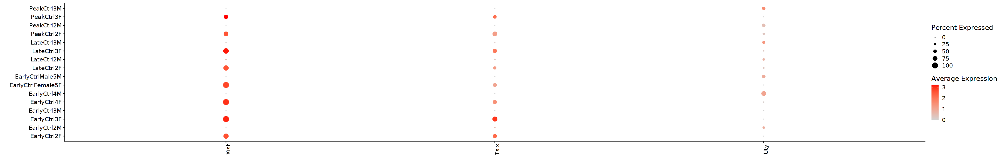

In [389]:
options(repr.plot.width=30, repr.plot.height=5)
plot <- DotPlot(tmp_sub, assay = "RNA", group.by = "orig.ident_Sex", scale=FALSE, cols = c("lightgrey", "red"), dot.scale = 5, features = rownames(res_top))
plot + theme(axis.text.x = element_text(angle = 90)) + labs(x = "", y= "")

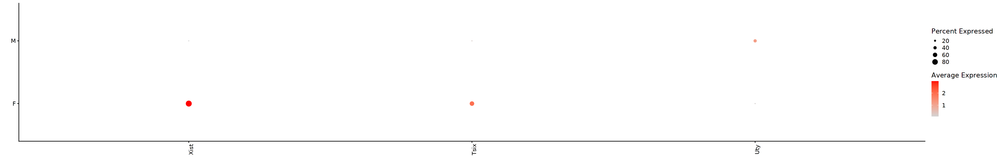

In [390]:
options(repr.plot.width=30, repr.plot.height=5)
plot <- DotPlot(tmp_sub, assay = "RNA", group.by = "Sex", scale=FALSE, cols = c("lightgrey", "red"), dot.scale = 5, features = rownames(res_top))
plot + theme(axis.text.x = element_text(angle = 90)) + labs(x = "", y= "")

In [391]:
HVGs.list[[cluster_choice]] <- rownames(res_filtered)

##### 3.2.2.4 Astro

In [392]:
cluster_choice <- "Astro"

In [393]:
table_sample_low <- table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$sample_id)[cluster_choice,][table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$sample_id)[cluster_choice,] <= 5]
table_sample_low

sample_keep <- names(timepoint_Sex_colors)[!names(timepoint_Sex_colors) %in% names(table_sample_low)]

named integer(0)

In [394]:
table_group_low <-table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$group_id)[cluster_choice,][table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$group_id)[cluster_choice,] <= 30]
table_group_low

group_keep <- names(sex_colors)[!names(sex_colors) %in% names(table_group_low)]

named integer(0)

In [395]:
cluster_metadata <- metadata[which(metadata$cluster_id == cluster_choice), ]

# Assign the rownames of the metadata to be the sample IDs
rownames(cluster_metadata) <- cluster_metadata$sample_id

In [396]:
#Remove sample and timepoint with low counts (sample<=5, timepoint<=30)
cluster_metadata <- cluster_metadata[(cluster_metadata$sample_id %in% sample_keep & cluster_metadata$group_id %in% group_keep),]

#new_sample_levels <- levels(cluster_metadata$sample_id)[levels(cluster_metadata$sample_id) %in% sample_keep]
#cluster_metadata$sample_id <- droplevels(cluster_metadata$sample_id)
#levels(cluster_metadata$sample_id) <- new_sample_levels

new_group_levels <- levels(cluster_metadata$group_id)[levels(cluster_metadata$group_id) %in% group_keep]
cluster_metadata$group_id <- droplevels(cluster_metadata$group_id)
levels(cluster_metadata$group_id) <- new_group_levels

In [397]:
cluster_metadata

,cluster_id,sample_id,group_id,debris_id
,<chr>,<chr>,<fct>,<chr>
EarlyCtrl2F,Astro,EarlyCtrl2F,F,Percoll
EarlyCtrl2M,Astro,EarlyCtrl2M,M,Percoll
EarlyCtrl3F,Astro,EarlyCtrl3F,F,Percoll
EarlyCtrl3M,Astro,EarlyCtrl3M,M,Percoll
EarlyCtrl4F,Astro,EarlyCtrl4F,F,Debris
EarlyCtrl4M,Astro,EarlyCtrl4M,M,Debris
EarlyCtrlFemale5F,Astro,EarlyCtrlFemale5F,F,Debris
EarlyCtrlMale5M,Astro,EarlyCtrlMale5M,M,Debris
LateCtrl2F,Astro,LateCtrl2F,F,Percoll


In [398]:
# Subset the counts to only this cluster
counts <- pb[[cluster_choice]]

cluster_counts <- data.frame(counts[, which(colnames(counts) %in% rownames(cluster_metadata))])

# Check that all of the row names of the metadata are the same and in the same order as the column names of the counts in order to use as input to DESeq2
all(rownames(cluster_metadata) == colnames(cluster_counts))

[1] TRUE

In [399]:
dds <- DESeqDataSetFromMatrix(cluster_counts, colData = cluster_metadata, design = ~ group_id + debris_id)

converting counts to integer mode

Warning message in DESeqDataSet(se, design = design, ignoreRank):
"some variables in design formula are characters, converting to factors"


In [400]:
# Transform counts for data visualization
rld <- rlog(dds, blind=TRUE)

using ntop=500 top features by variance



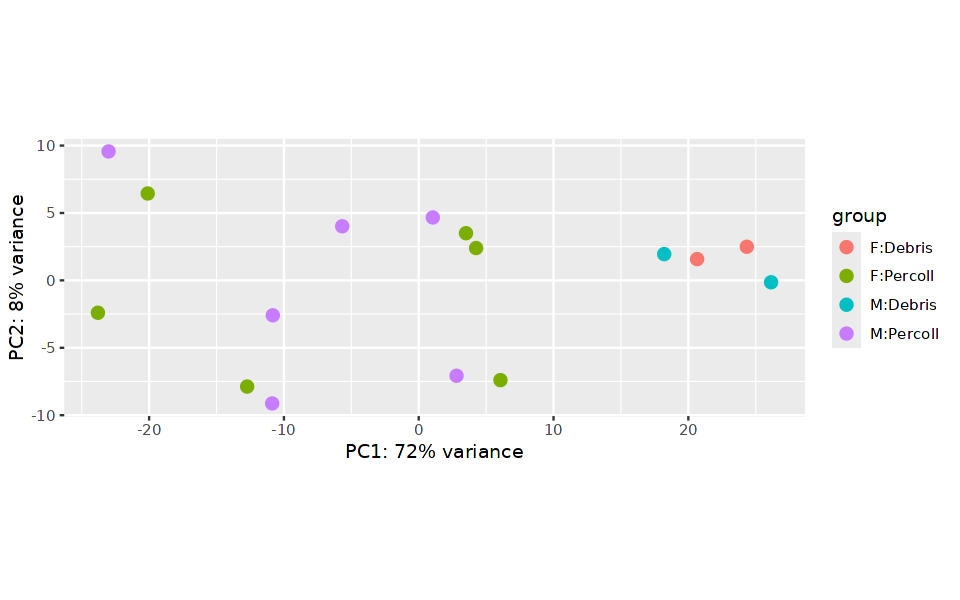

In [401]:
# Plot PCA
options(repr.plot.width=8, repr.plot.height=5)
DESeq2::plotPCA(rld, intgroup = c("group_id", "debris_id"))

In [402]:
# Extract the rlog matrix from the object and compute pairwise correlation values
rld_mat <- assay(rld)
rld_cor <- cor(rld_mat)

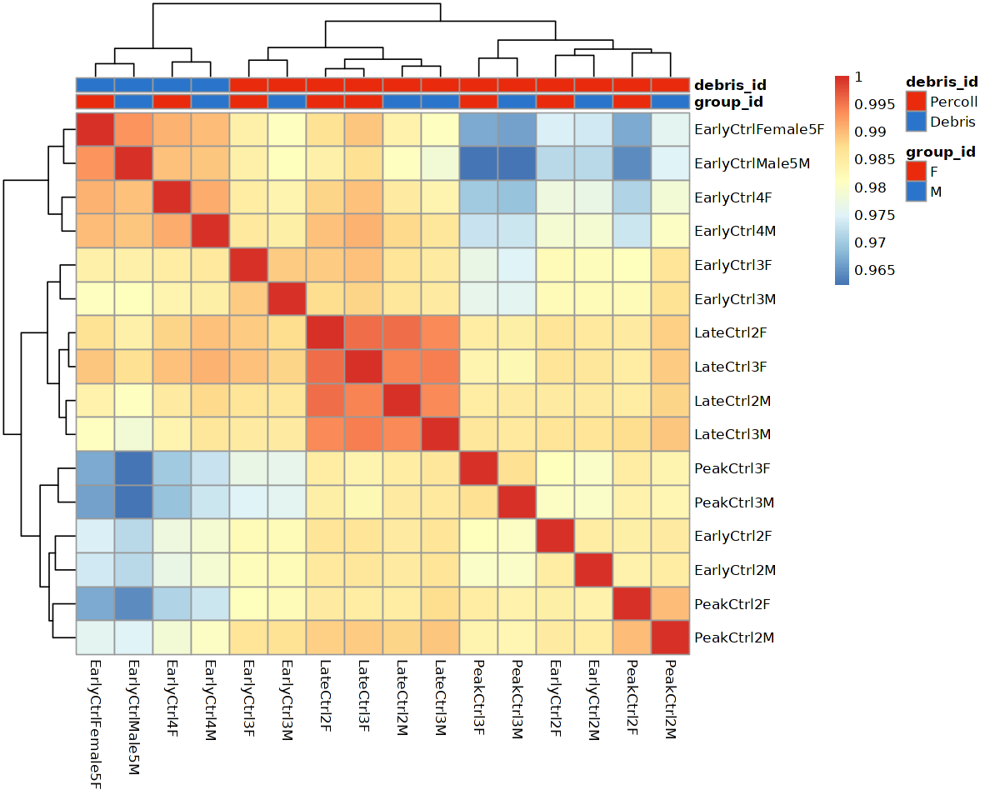

In [403]:
# Plot heatmap
options(repr.plot.width=10, repr.plot.height=8)
pheatmap(rld_cor, annotation = cluster_metadata[, c("group_id","debris_id"), drop=F], annotation_colors = list(group_id=sex_colors, debris_id=debris_colors))

In [404]:
# Run DESeq2 differential expression analysis
dds <- DESeq(dds)

estimating size factors

estimating dispersions

gene-wise dispersion estimates

mean-dispersion relationship

final dispersion estimates

fitting model and testing



In [405]:
libsize = data.frame(x=sizeFactors(dds), y=colSums(assay(dds)))

`geom_smooth()` using formula = 'y ~ x'


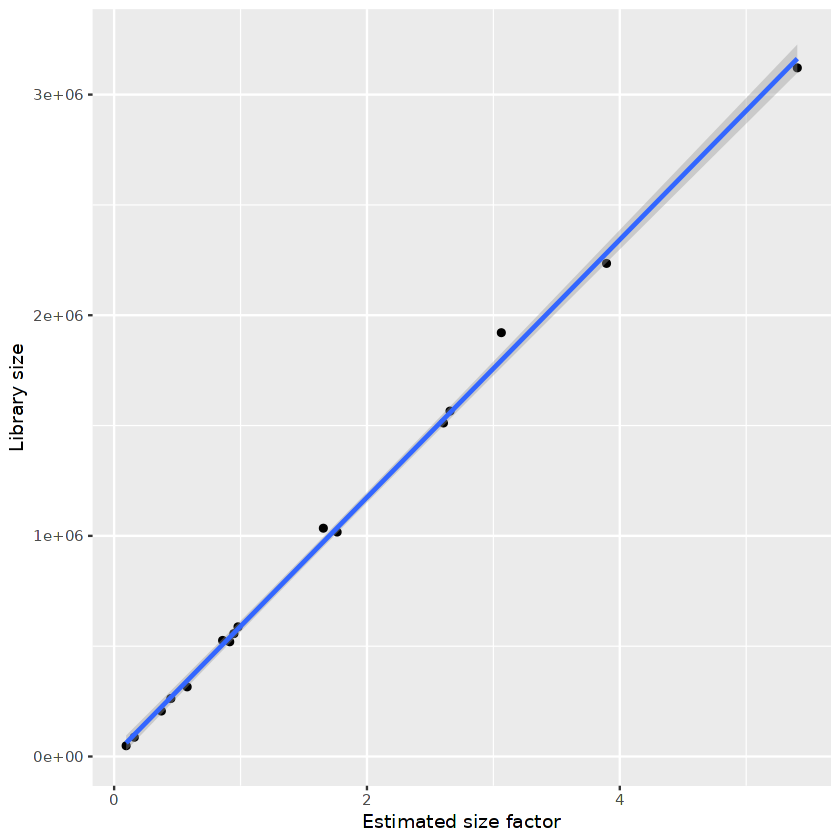

In [406]:
options(repr.plot.width=7, repr.plot.height=7)
ggplot(data=libsize, aes(x=x, y=y)) + geom_point() + geom_smooth(method="lm") + xlab("Estimated size factor") + ylab("Library size")

In [407]:
data.frame(colData(dds))

,cluster_id,sample_id,group_id,debris_id,sizeFactor
,<chr>,<chr>,<fct>,<fct>,<dbl>
EarlyCtrl2F,Astro,EarlyCtrl2F,F,Percoll,0.09498099
EarlyCtrl2M,Astro,EarlyCtrl2M,M,Percoll,0.15959152
EarlyCtrl3F,Astro,EarlyCtrl3F,F,Percoll,0.94741701
EarlyCtrl3M,Astro,EarlyCtrl3M,M,Percoll,0.44870531
EarlyCtrl4F,Astro,EarlyCtrl4F,F,Debris,0.85808826
EarlyCtrl4M,Astro,EarlyCtrl4M,M,Debris,0.98002269
EarlyCtrlFemale5F,Astro,EarlyCtrlFemale5F,F,Debris,3.06292188
EarlyCtrlMale5M,Astro,EarlyCtrlMale5M,M,Debris,1.65498979
LateCtrl2F,Astro,LateCtrl2F,F,Percoll,3.89516878


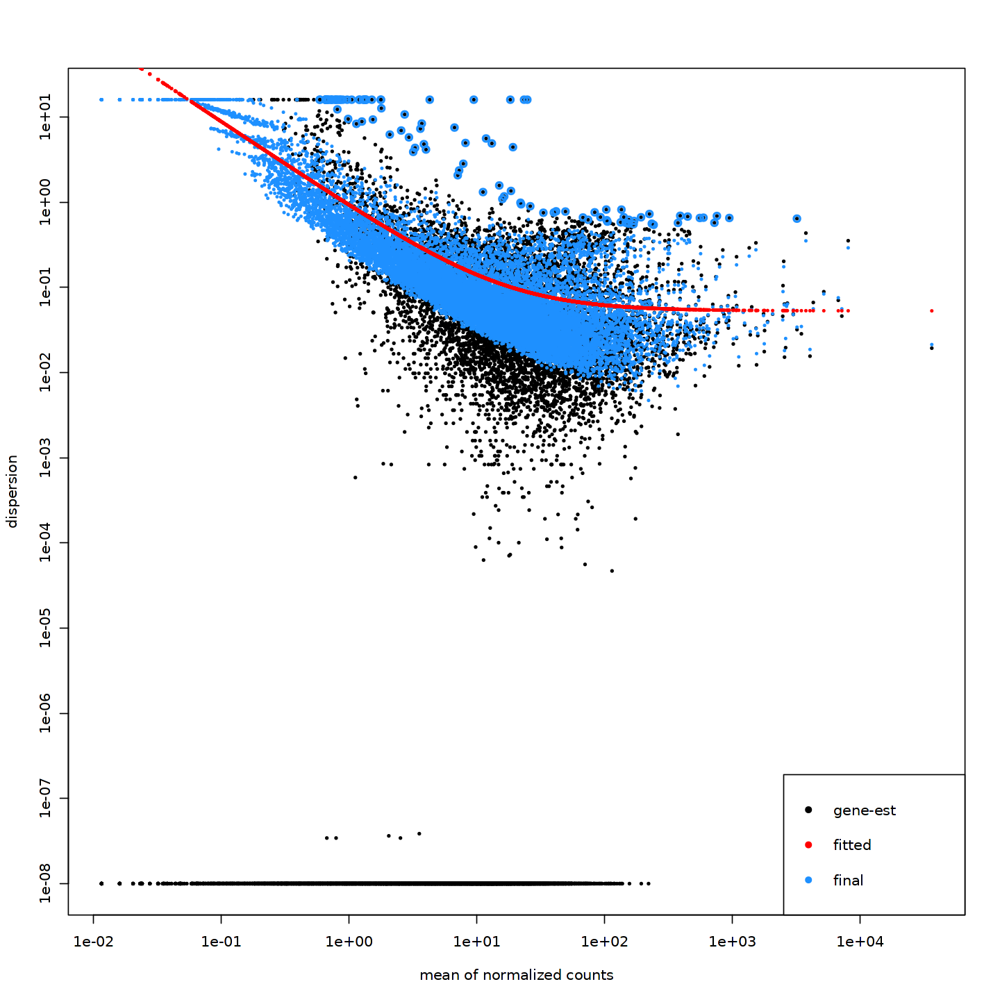

In [408]:
# Plot dispersion estimates
options(repr.plot.width=12, repr.plot.height=12)
plotDispEsts(dds)

In [409]:
condition1 = "M"
condition2 = "F"

In [410]:
contrast <- c("group_id", condition1, condition2)

# resultsNames(dds)
res <- results(dds, contrast = contrast, alpha = 0.05)

In [411]:
summary(res)


out of 14500 with nonzero total read count
adjusted p-value < 0.05
LFC > 0 (up)       : 4, 0.028%
LFC < 0 (down)     : 3, 0.021%
outliers [1]       : 7, 0.048%
low counts [2]     : 0, 0%
(mean count < 0)
[1] see 'cooksCutoff' argument of ?results
[2] see 'independentFiltering' argument of ?results



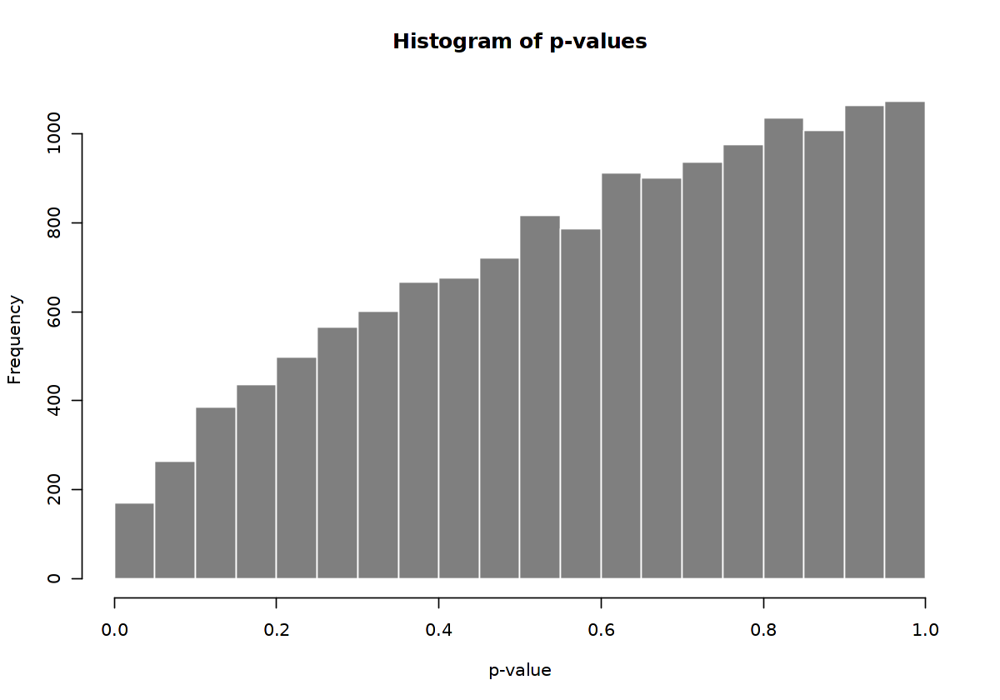

In [412]:
options(repr.plot.width=10, repr.plot.height=7)
hist(res$pvalue, breaks=0:20/20, col="grey50", border="white", xlim=c(0,1), main="Histogram of p-values", xlab="p-value")

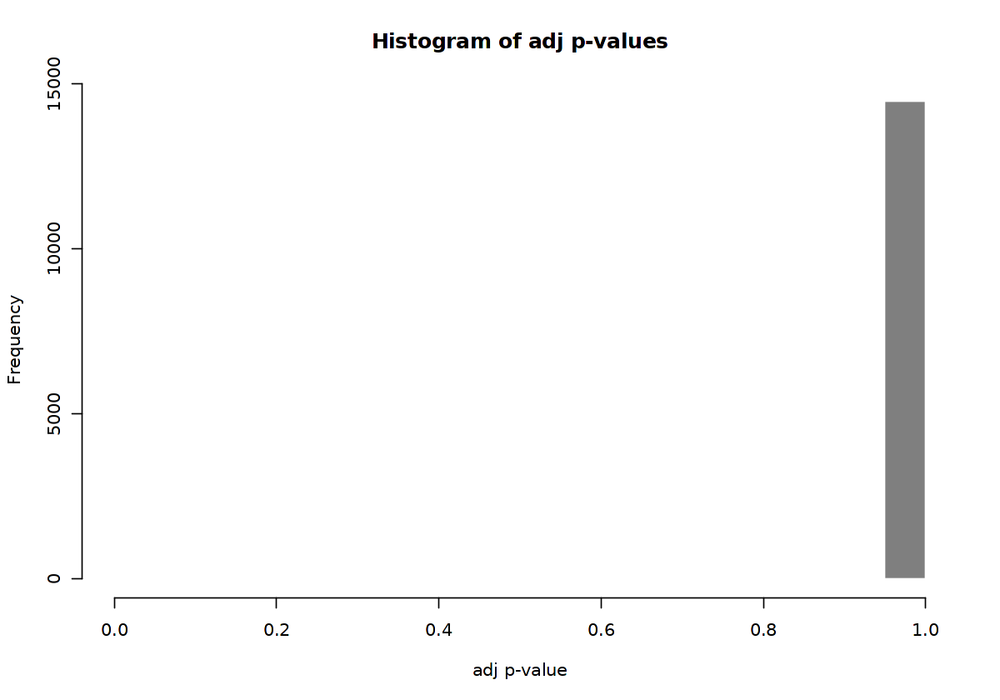

In [413]:
options(repr.plot.width=10, repr.plot.height=7)
hist(res$padj, breaks=0:20/20, col="grey50", border="white", xlim=c(0,1), main="Histogram of adj p-values", xlab="adj p-value")

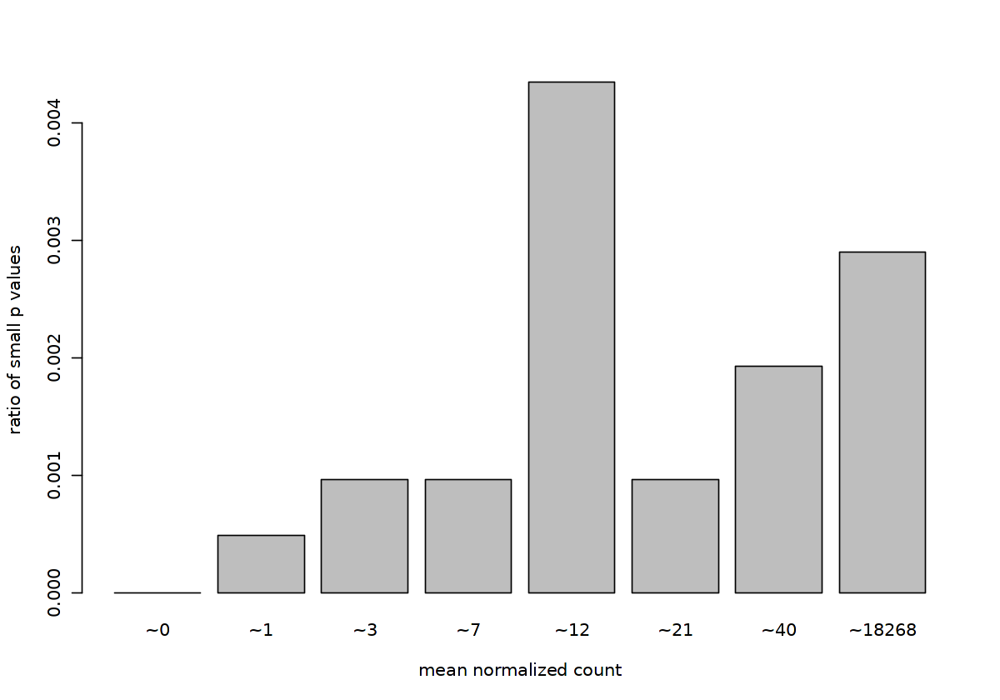

In [414]:
options(repr.plot.width=10, repr.plot.height=7)
qs <- c(0, quantile(res$baseMean[res$baseMean > 0], 0:7/7))
# cut the genes into the bins
bins <- cut(res$baseMean, qs)
# rename the levels of the bins using the middle point
levels(bins) <- paste0("~",round(.5*qs[-1] + .5*qs[-length(qs)]))
# calculate the ratio of $p$ values less than .01 for each bin
ratios <- tapply(res$pvalue, bins, function(p) mean(p < .01, na.rm=TRUE))
# plot these ratios
barplot(ratios, xlab="mean normalized count", ylab="ratio of small p values")

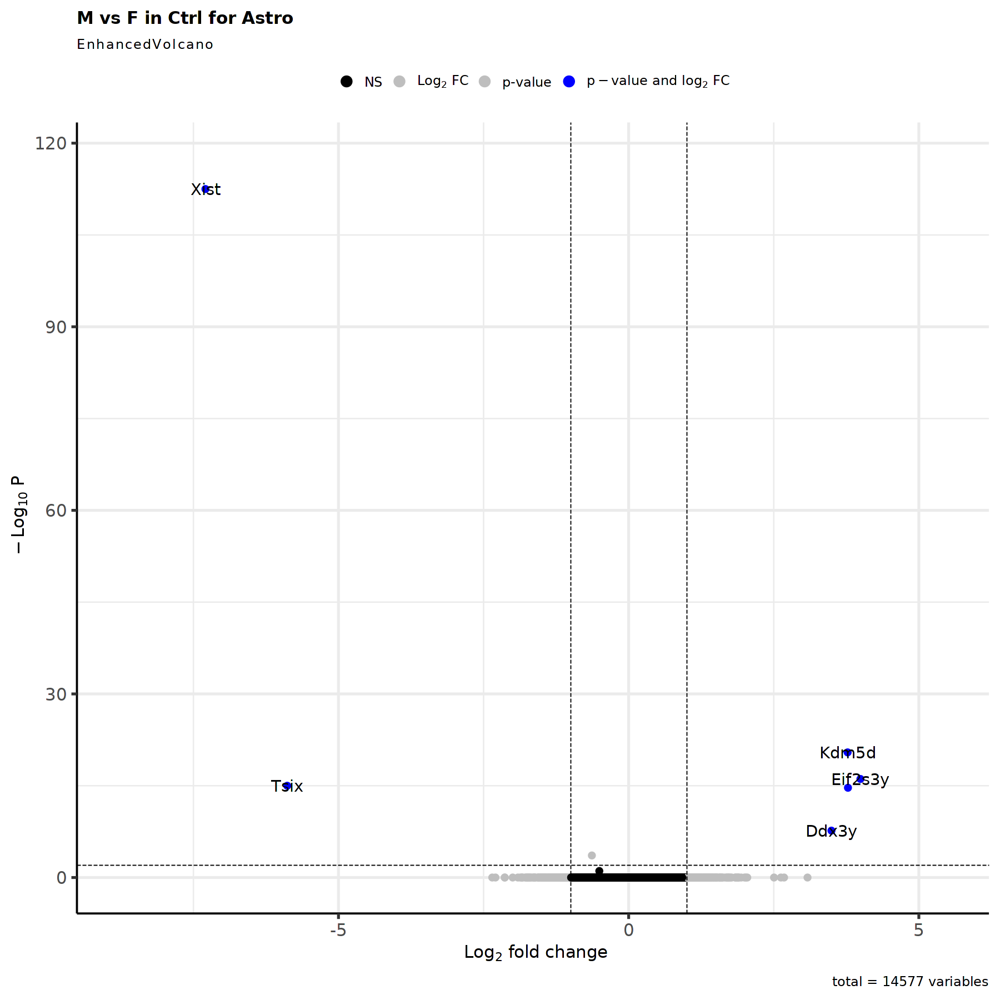

In [415]:
options(repr.plot.width=15, repr.plot.height=15)
#padj<0.001
EnhancedVolcano(res,
    lab = rownames(res),
    x = 'log2FoldChange',
    y = 'padj',
    title = paste0('M vs F in ',timepoint,' for ', cluster_choice),
    pCutoff = 0.01,
    FCcutoff = 1,
    pointSize = 3.0,
    labSize = 6.0,
    col=c('black', 'grey', 'grey', 'blue'),
    colAlpha = 1)

In [416]:
res <- res[complete.cases(res$padj),]

In [417]:
res_filtered <- res[(res$padj < 0.01 & abs(res$log2FoldChange) > 1 & res$baseMean > 1),]

In [418]:
res_filtered[order(abs(res_filtered$log2FoldChange), decreasing=TRUE),]

log2 fold change (MLE): group_id M vs F 
Wald test p-value: group id M vs F 
DataFrame with 6 rows and 6 columns
         baseMean log2FoldChange     lfcSE      stat       pvalue         padj
        <numeric>      <numeric> <numeric> <numeric>    <numeric>    <numeric>
Xist     754.8888       -7.29253  0.316608 -23.03332 2.16198e-117 3.13336e-113
Tsix     141.5783       -5.88299  0.655313  -8.97737  2.77316e-19  1.00479e-15
Eif2s3y   44.1941        3.99335  0.430128   9.28408  1.63112e-20  7.87995e-17
Uty       54.3974        3.77880  0.426096   8.86843  7.41831e-19  2.15027e-15
Kdm5d     13.2601        3.77274  0.365059  10.33459  4.91518e-25  3.56178e-21
Ddx3y     25.6023        3.49405  0.512263   6.82081  9.05303e-12  2.18676e-08

In [419]:
nrow(res_filtered)

[1] 6

In [420]:
top.genes.number <- ifelse(nrow(res_filtered)>100, 100, nrow(res_filtered))

In [421]:
res_top <- res_filtered[order(abs(res_filtered$log2FoldChange), decreasing=TRUE),][1:top.genes.number,]
res_top <- res_top[order(res_top$log2FoldChange, decreasing=FALSE),]

In [422]:
tmp_sub <- subset(tmp, subset = cellType == cluster_choice)

In [423]:
tmp_sub <- NormalizeData(tmp_sub, normalization.method = "LogNormalize", scale.factor = 10000, verbose = TRUE)

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


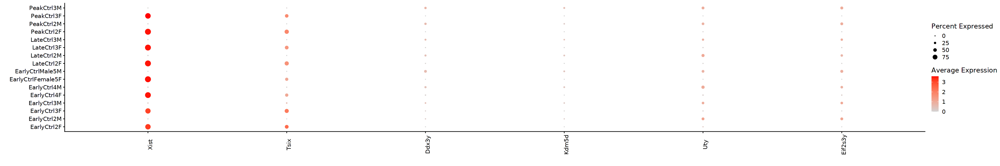

In [424]:
options(repr.plot.width=30, repr.plot.height=5)
plot <- DotPlot(tmp_sub, assay = "RNA", group.by = "orig.ident_Sex", scale=FALSE, cols = c("lightgrey", "red"), dot.scale = 5, features = rownames(res_top))
plot + theme(axis.text.x = element_text(angle = 90)) + labs(x = "", y= "")

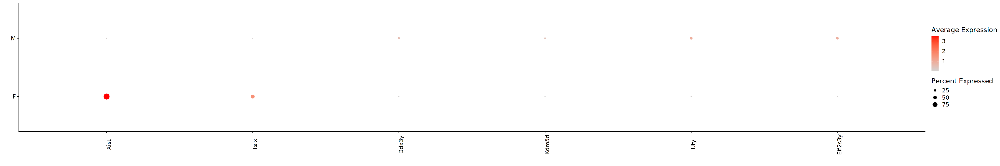

In [425]:
options(repr.plot.width=30, repr.plot.height=5)
plot <- DotPlot(tmp_sub, assay = "RNA", group.by = "Sex", scale=FALSE, cols = c("lightgrey", "red"), dot.scale = 5, features = rownames(res_top))
plot + theme(axis.text.x = element_text(angle = 90)) + labs(x = "", y= "")

In [426]:
HVGs.list[[cluster_choice]] <- rownames(res_filtered)

##### 3.2.2.5 Summary

In [427]:
listInput_upset <- HVGs.list
listInput_upset[sapply(listInput_upset, is.null)] <- NULL

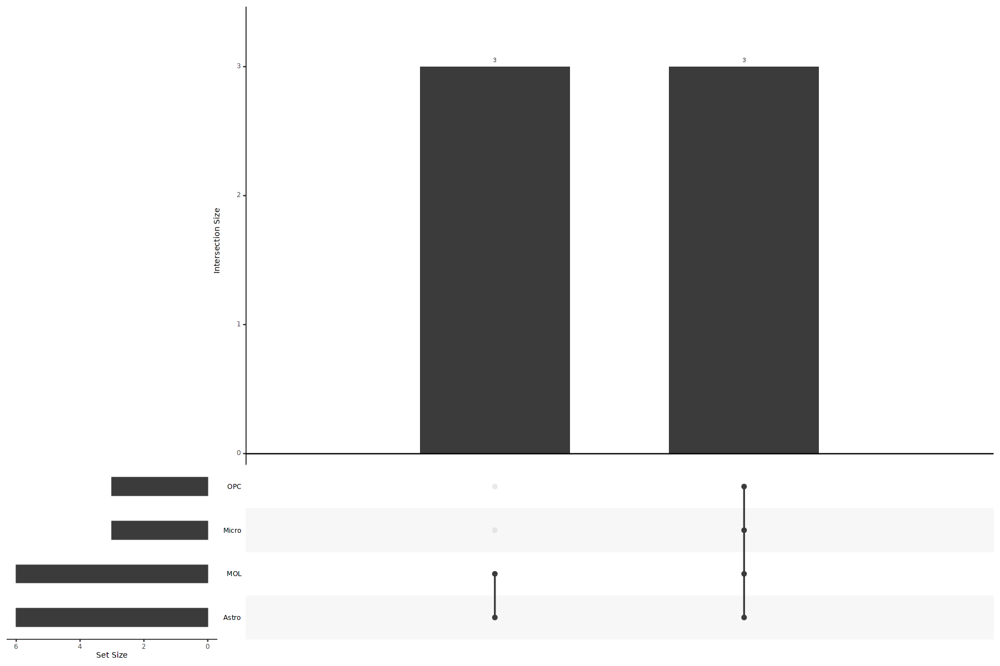

In [428]:
options(repr.plot.width=15, repr.plot.height=10)
upset(fromList(listInput_upset), order.by = "freq")

In [429]:
HVF <- unique(unlist(HVGs.list))

In [430]:
table_sample_low <- table(MORNAATACC_sce$sample_id)[table(MORNAATACC_sce$sample_id) <= 5]
table_group_low <- table(MORNAATACC_sce$group_id)[table(MORNAATACC_sce$group_id) <= 30]

In [431]:
#Remove sample with low number of cells
keepcells <- rownames(tmp@meta.data[!tmp$orig.ident %in% (names(table_sample_low)),])
tmp <- subset(tmp, cells=keepcells)

In [432]:
#Remove timepoint with low number of cells
keepcells <- rownames(tmp@meta.data[!tmp$orig.ident_Sex %in% (names(table_group_low)),])
tmp <- subset(tmp, cells=keepcells)

In [433]:
tmp <- NormalizeData(tmp, normalization.method = "LogNormalize", scale.factor = 10000, verbose = TRUE)

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


In [434]:
tmp <- ScaleData(tmp, features=rownames(tmp))

Centering and scaling data matrix

  |==========================================================================================| 100%


In [435]:
sub_timepoint_Sex_colors <- timepoint_Sex_colors[names(timepoint_Sex_colors) %in% names(table(tmp$orig.ident_Sex))]

In [436]:
tmp$orig.ident <- factor(x = tmp$orig.ident, levels = name_timepoint[!name_timepoint %in% names(table_sample_low)])
tmp$orig.ident_Sex <- factor(x = tmp$orig.ident_Sex, levels = names(sub_timepoint_Sex_colors)[!names(sub_timepoint_Sex_colors) %in% names(table_group_low)])

In [437]:
Idents(object = tmp) <- "orig.ident_Sex"

Warning message:
"CombinePlots is being deprecated. Plots should now be combined using the patchwork system."


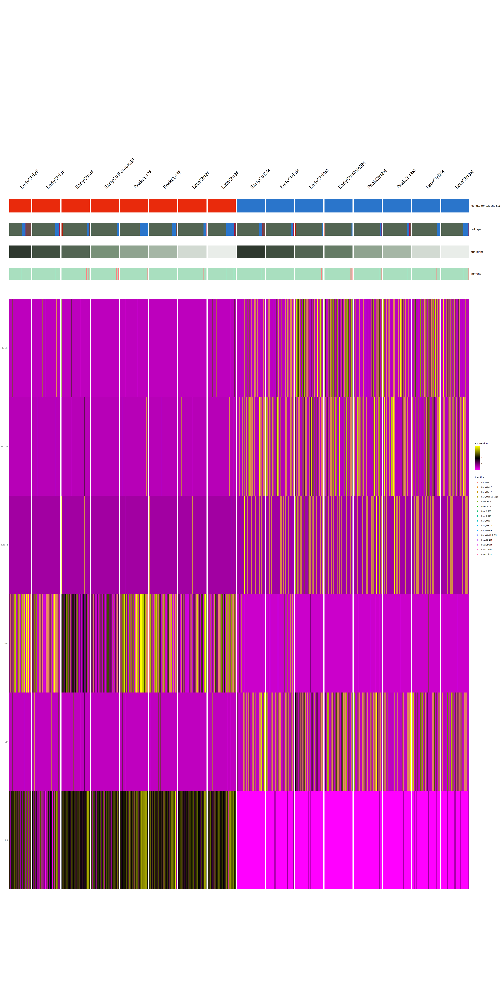

In [438]:
options(repr.plot.width=25, repr.plot.height=50)
DoMultiBarHeatmap(
    subset(tmp, downsample = 200),
    features = HVF,
    cells = NULL,
    group.by = "orig.ident_Sex",
    additional.group.by = c("cellType", "orig.ident", "Immune"),
    additional.group.sort.by = c("cellType", "orig.ident", "Immune"),
    cols.use = list(orig.ident_Sex=sub_timepoint_Sex_colors, cellType=cellType_colors, orig.ident=orig.ident_colors, Immune=immune_colors),
    group.bar = TRUE,
    disp.min = -2.5,
    disp.max = NULL,
    layer = "scale.data",
    assay = "RNA",
    label = TRUE,
    size = 5.5,
    hjust = 0,
    angle = 45,
    raster = TRUE,
    draw.lines = TRUE,
    lines.width = NULL,
    group.bar.height = 0.02,
    combine = TRUE
    ) + theme(text = element_text(size = 8))

In [439]:
sample_names <- levels(tmp$orig.ident_Sex)

In [440]:
gene_list <- HVF

In [441]:
tmp_markers <- as.data.frame(AggregateExpression(tmp, assays = "RNA", group.by = "orig.ident_Sex", normalization.method = "LogNormalize", scale.factor = 10000, return.seurat = TRUE)[["RNA"]]$data[gene_list,])

Centering and scaling data matrix

  |==========================================================================================| 100%
  |==========================================================================================| 100%


In [442]:
matrix <- tmp_markers/do.call(pmax, tmp_markers)

In [443]:
paletteLength <- 50
myColor <- colorRampPalette(c("#FFFFB3", "#5E3719"))(paletteLength/2)
myBreaks <- c(seq(0, max(matrix), length.out=floor(paletteLength/2)))

In [444]:
plot_height <- ifelse(as.integer(nrow(matrix)/20)<=5, 5, as.integer(nrow(matrix)/20))

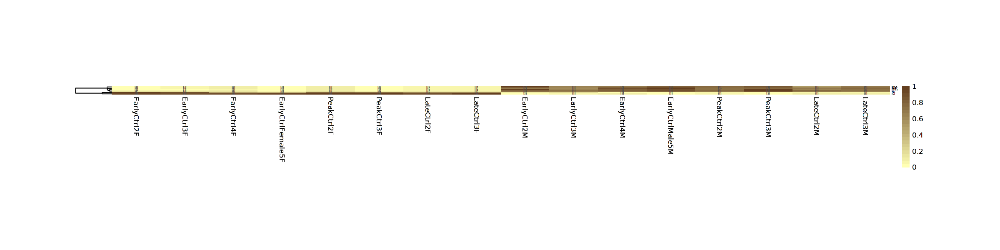

In [445]:
options(repr.plot.width=20, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = T, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=TRUE)
ph

In [446]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "DGE_Sex_sep_",timepoint,"_pseudobulk.pdf"), width=20, height=plot_height)

png 
  2

In [447]:
gene_list <- gene_list[ph$tree_row$order]

In [448]:
tmp_markers_mean <- data.frame(matrix(0L, ncol=1, nrow=length(gene_list), dimnames=list(gene_list, "Mean_Log2Exp")))

In [449]:
tmp_markers_mean[rownames(tmp_markers),"Mean_Log2Exp"] <- rowMeans(tmp_markers)

In [450]:
matrix <- tmp_markers_mean

In [451]:
paletteLength <- 50
myColor <- colorRampPalette(c("white", "black"))(paletteLength/2)
myBreaks <- c(seq(0, max(matrix), length.out=floor(paletteLength/2)))

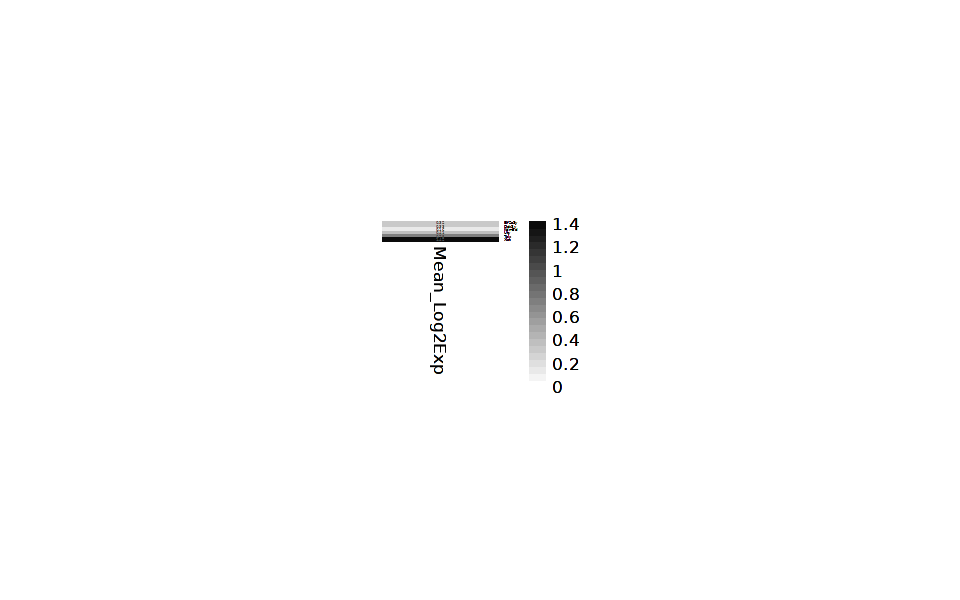

In [452]:
options(repr.plot.width=8, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = T, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=FALSE)
ph

In [453]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "DGE_Sex_sep_",timepoint,"_pseudobulk_mean.pdf"), width=8, height=plot_height)

png 
  2

In [454]:
tmp_markers_zscore <- t(apply(tmp_markers[gene_list,], 1, scale))
colnames(tmp_markers_zscore) <- paste0("zscore_", names(sub_timepoint_Sex_colors))
matrix <- tmp_markers_zscore

In [455]:
paletteLength <- 50
myColor <- colorRampPalette(c("blue", "white", "red"))(paletteLength/2)
myBreaks <- c(seq(min(matrix), max(matrix), length.out=floor(paletteLength/2)))

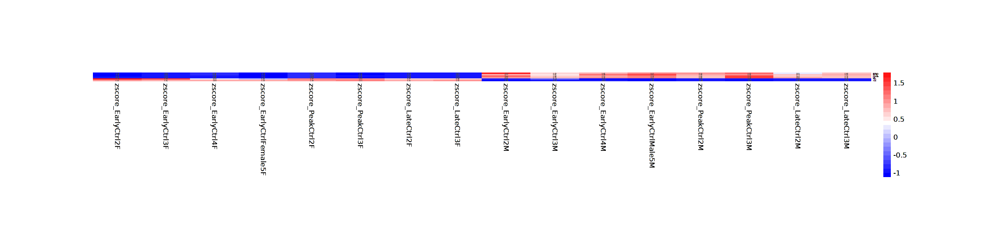

In [456]:
options(repr.plot.width=20, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = T, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=FALSE)
ph

In [457]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "DGE_Sex_sep_",timepoint,"_pseudobulk_zscore.pdf"), width=20, height=plot_height)

png 
  2

In [458]:
gene_list <- HVF

In [459]:
tmp_markers <- as.data.frame(AggregateExpression(tmp, assays = "RNA", group.by = "Sex", normalization.method = "LogNormalize", scale.factor = 10000, return.seurat = TRUE)[["RNA"]]$data[gene_list,])

Centering and scaling data matrix

  |==========================================================================================| 100%
  |==========================================================================================| 100%


In [460]:
matrix <- tmp_markers/do.call(pmax, tmp_markers)

In [461]:
paletteLength <- 50
myColor <- colorRampPalette(c("#FFFFB3", "#5E3719"))(paletteLength/2)
myBreaks <- c(seq(0, max(matrix), length.out=floor(paletteLength/2)))

In [462]:
plot_height <- ifelse(as.integer(nrow(matrix)/20) < 5, 5, as.integer(nrow(matrix)/20))

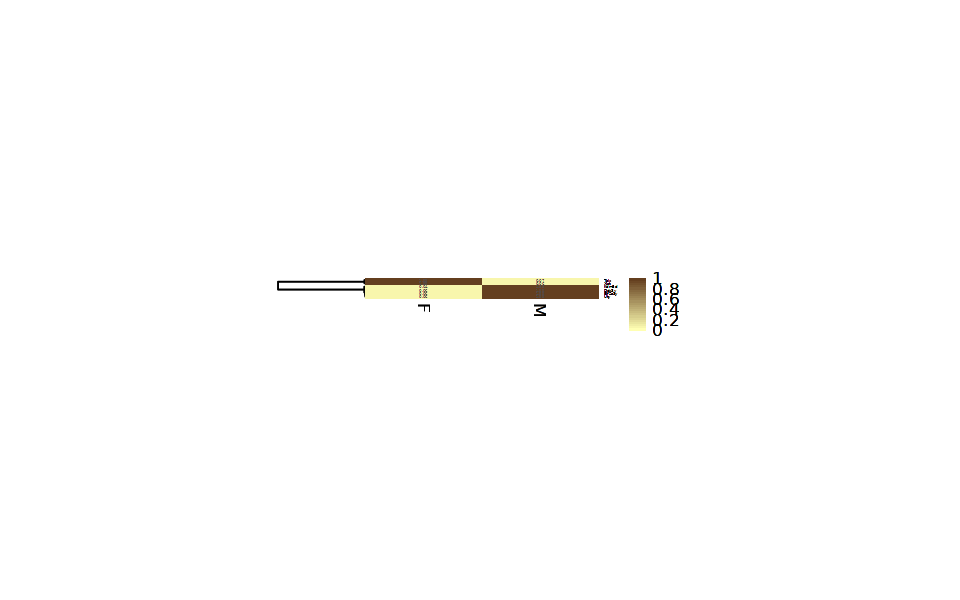

In [463]:
options(repr.plot.width=8, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = T, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=TRUE)
ph

In [464]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "DGE_Sex_",timepoint,"_pseudobulk.pdf"), width=8, height=plot_height)

png 
  2

In [465]:
gene_list <- gene_list[ph$tree_row$order]

In [466]:
tmp_markers_mean <- data.frame(matrix(0L, ncol=1, nrow=length(gene_list), dimnames=list(gene_list, "Mean_Log2Exp")))

In [467]:
tmp_markers_mean[rownames(tmp_markers),"Mean_Log2Exp"] <- rowMeans(tmp_markers)

In [468]:
matrix <- tmp_markers_mean

In [469]:
paletteLength <- 50
myColor <- colorRampPalette(c("white", "black"))(paletteLength/2)
myBreaks <- c(seq(0, max(matrix), length.out=floor(paletteLength/2)))

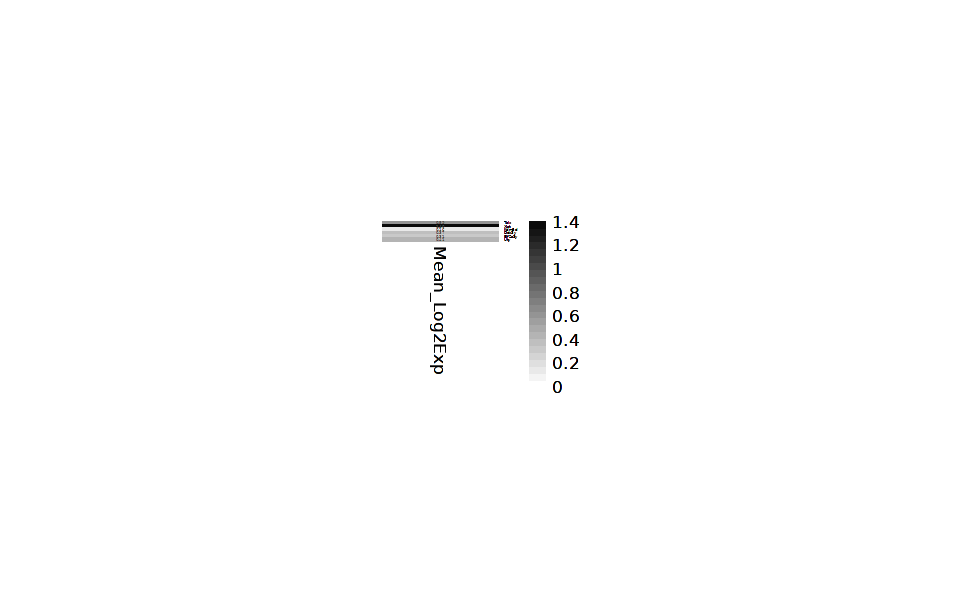

In [470]:
options(repr.plot.width=8, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = T, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=FALSE)
ph

In [471]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "DGE_Sex_",timepoint,"_pseudobulk_mean.pdf"), width=8, height=plot_height)

png 
  2

In [472]:
tmp_markers_zscore <- t(apply(tmp_markers[gene_list,], 1, scale))
colnames(tmp_markers_zscore) <- paste0("zscore_", names(sex_colors))
matrix <- tmp_markers_zscore

In [473]:
paletteLength <- 50
myColor <- colorRampPalette(c("blue", "white", "red"))(paletteLength/2)
myBreaks <- c(seq(min(matrix), max(matrix), length.out=floor(paletteLength/2)))

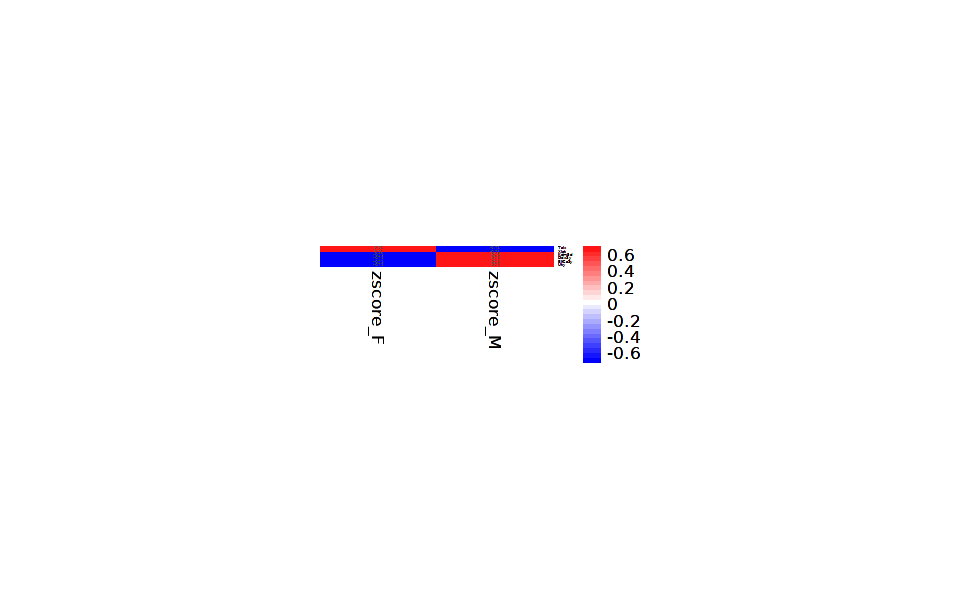

In [474]:
options(repr.plot.width=8, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = T, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=FALSE)
ph

In [475]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "DGE_Sex_",timepoint,"_pseudobulk_zscore.pdf"), width=8, height=plot_height)

png 
  2

#### 3.2.3 Early

In [476]:
timepoint <- "Early"
name_timepoint <- names_Early

In [477]:
tmp <- subset(MORNAATACC, subset = orig.ident_merge == timepoint)

In [478]:
tmp <- NormalizeData(tmp, normalization.method = "LogNormalize", scale.factor = 10000, verbose = TRUE)

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


In [479]:
tmp <- ScaleData(tmp, features=rownames(tmp))

Centering and scaling data matrix

  |==========================================================================================| 100%


In [480]:
timepoint_Sex_colors <- c(rep(sex_colors["F"], length(name_timepoint)),rep(sex_colors["M"], length(name_timepoint)))
df_timepoint_Sex <- expand.grid(name_timepoint, names(sex_colors))
names(timepoint_Sex_colors) <- paste0(df_timepoint_Sex[,1],df_timepoint_Sex[,2])

In [481]:
tmp$orig.ident_Sex <- paste0(tmp$orig.ident,tmp$Sex)
tmp$orig.ident_Sex <- factor(paste0(tmp$orig.ident,tmp$Sex), levels=names(table(tmp$orig.ident_Sex)))

In [482]:
tmp$orig.ident <- factor(tmp$orig.ident, levels=name_timepoint)
tmp$cellType <- factor(tmp$cellType, levels=names(cellType_colors))
tmp$Sex <- factor(tmp$Sex, levels=names(sex_colors))

In [483]:
table(tmp$cellType, tmp$orig.ident_Sex)

        
         Early1F Early1M Early2F Early2M Early4F Early4M EarlyFemale3F EarlyFemale5F EarlyMale3M
  OPC          5      14       0       0      48      59             1           427           5
  COP          0       0       0       0       6       7             0           114           0
  MOL       1497    2093     281     639     459     664          3167          8773        3393
  Astro      196     192      51      30      38      35           219          1641         245
  Epen        47      28       4      12       3       6            31            41          72
  Micro       25     105      50      54       9       8             3            91          11
  Neuron       3       1       0       0       0       0             2             0           2
        
         EarlyMale5M
  OPC            230
  COP             28
  MOL           9947
  Astro          329
  Epen            17
  Micro           30
  Neuron           2

In [484]:
table(tmp$cellType, tmp$Sex)

        
             F     M
  OPC      481   308
  COP      120    35
  MOL    14177 16736
  Astro   2145   831
  Epen     126   135
  Micro    178   208
  Neuron     5     5

In [485]:
table(tmp$orig.ident_Sex, tmp$Sex)

               
                    F     M
  Early1F        1773     0
  Early1M           0  2433
  Early2F         386     0
  Early2M           0   735
  Early4F         563     0
  Early4M           0   779
  EarlyFemale3F  3423     0
  EarlyFemale5F 11087     0
  EarlyMale3M       0  3728
  EarlyMale5M       0 10583

In [486]:
MORNAATACC_sce <- as.SingleCellExperiment(tmp, assay="RNA")

In [487]:
MORNAATACC_sce <- prepSCE(MORNAATACC_sce, kid = "cellType", gid = "Sex", sid = "orig.ident_Sex", drop = FALSE)

In [488]:
kids <- purrr::set_names(levels(MORNAATACC_sce$cluster_id))

# Total number of clusters
nk <- length(kids)

# Named vector of sample names
sids <- purrr::set_names(levels(MORNAATACC_sce$sample_id))

# Total number of samples 
ns <- length(sids)

In [489]:
kids
sids

OPC      COP      MOL    Astro     Epen    Micro   Neuron 
   "OPC"    "COP"    "MOL"  "Astro"   "Epen"  "Micro" "Neuron"

Early1F         Early1M         Early2F         Early2M         Early4F         Early4M 
      "Early1F"       "Early1M"       "Early2F"       "Early2M"       "Early4F"       "Early4M" 
  EarlyFemale3F   EarlyFemale5F     EarlyMale3M     EarlyMale5M 
"EarlyFemale3F" "EarlyFemale5F"   "EarlyMale3M"   "EarlyMale5M"

In [490]:
## Determine the number of cells per sample
table(MORNAATACC_sce$sample_id)

## Turn named vector into a numeric vector of number of cells per sample
n_cells <- as.numeric(table(MORNAATACC_sce$sample_id))

## Determine how to reoder the samples (rows) of the metadata to match the order of sample names in sids vector
m <- match(sids, MORNAATACC_sce$sample_id)

## Create the sample level metadata by combining the reordered metadata with the number of cells corresponding to each sample.
ei <- data.frame(colData(MORNAATACC_sce)[m, ], n_cells, row.names = NULL) %>% select(-"cluster_id")
ei


      Early1F       Early1M       Early2F       Early2M       Early4F       Early4M EarlyFemale3F 
         1773          2433           386           735           563           779          3423 
EarlyFemale5F   EarlyMale3M   EarlyMale5M 
        11087          3728         10583 

sample_id,group_id,orig.ident,nCount_RAW,nFeature_RAW,nCount_RNA,nFeature_RNA,nCount_ATAC,nFeature_ATAC,orig.ident_merge,batch,model,debrisRemoval,date_tissue_collection,date_experiment,nbMouse,EAE_score_mean,frequency_count,mononucleosomal,nucleosome_free,reads_count,percent.mt,log10GenesUMI,mitoRatio,S.Score,G2M.Score,Phase,CC.Difference,nucleosome_signal,nucleosome_percentile,TSS.enrichment,TSS.percentile,nCount_peaks,nFeature_peaks,FRiP,nCount_GenePromAcc,nFeature_GenePromAcc,pANN,DF.classifications,pct_chrY,pct_chrX,Xist_score,Sex_predictions,Sex_predictions_F,Sex_predictions_M,snn_RNA_res.1,seurat_clusters_RNA,snn_peaks_res.0.4,seurat_clusters_peaks,RNA.weight,⋯,pvalue_Naive.Tcell_cd8,Immune.Tcell_cd8,ImmuneScoreGenePromAcc,ImmuneScoreScaledGenePromAcc,zscore_NaiveGenePromAcc,pvalue_NaiveGenePromAcc,ImmuneGenePromAcc,ImmuneScoreGenePromAcc.complement,ImmuneScoreScaledGenePromAcc.complement,zscore_NaiveGenePromAcc.complement,pvalue_NaiveGenePromAcc.complement,ImmuneGenePromAcc.complement,ImmuneScoreGenePromAcc.pos_reg_imm_response,ImmuneScoreScaledGenePromAcc.pos_reg_imm_response,zscore_NaiveGenePromAcc.pos_reg_imm_response,pvalue_NaiveGenePromAcc.pos_reg_imm_response,ImmuneGenePromAcc.pos_reg_imm_response,ImmuneScoreGenePromAcc.neg_reg_imm_response,ImmuneScoreScaledGenePromAcc.neg_reg_imm_response,zscore_NaiveGenePromAcc.neg_reg_imm_response,pvalue_NaiveGenePromAcc.neg_reg_imm_response,ImmuneGenePromAcc.neg_reg_imm_response,ImmuneScoreGenePromAcc.antig_proc_presen,ImmuneScoreScaledGenePromAcc.antig_proc_presen,zscore_NaiveGenePromAcc.antig_proc_presen,pvalue_NaiveGenePromAcc.antig_proc_presen,ImmuneGenePromAcc.antig_proc_presen,ImmuneScoreGenePromAcc.pos_reg_int_media,ImmuneScoreScaledGenePromAcc.pos_reg_int_media,zscore_NaiveGenePromAcc.pos_reg_int_media,pvalue_NaiveGenePromAcc.pos_reg_int_media,ImmuneGenePromAcc.pos_reg_int_media,ImmuneScoreGenePromAcc.reg_cyto_prod,ImmuneScoreScaledGenePromAcc.reg_cyto_prod,zscore_NaiveGenePromAcc.reg_cyto_prod,pvalue_NaiveGenePromAcc.reg_cyto_prod,ImmuneGenePromAcc.reg_cyto_prod,ImmuneScoreGenePromAcc.Tcell_cd4,ImmuneScoreScaledGenePromAcc.Tcell_cd4,zscore_NaiveGenePromAcc.Tcell_cd4,pvalue_NaiveGenePromAcc.Tcell_cd4,ImmuneGenePromAcc.Tcell_cd4,ImmuneScoreGenePromAcc.Tcell_cd8,ImmuneScoreScaledGenePromAcc.Tcell_cd8,zscore_NaiveGenePromAcc.Tcell_cd8,pvalue_NaiveGenePromAcc.Tcell_cd8,ImmuneGenePromAcc.Tcell_cd8,ImmuneAll,ident,n_cells
<fct>,<fct>,<fct>,<dbl>,<int>,<dbl>,<int>,<dbl>,<int>,<fct>,<fct>,<fct>,<fct>,<fct>,<fct>,<chr>,<fct>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<int>,<dbl>,<dbl>,<int>,<dbl>,<chr>,<dbl>,<dbl>,<dbl>,<chr>,<dbl>,<dbl>,<fct>,<fct>,<fct>,<fct>,<dbl>,⋯,<dbl>,<fct>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<chr>,<fct>,<dbl>
Early1F,F,Early1,1166,793,644,437,6043,2843,Early,B1,EAE,Percoll,2021_04_30,2021_04_20,2,0.5,3930,1153,1952,16570,1.708075,0.9400458,0.01708075,0.016812439,-0.0222882615,S,0.03910070,0.6016949,0.33,8.052923,0.78,3281,2810,0.8348601,3534,2649,0.00000000,Singlet,0.0000000000,0.05434783,0.710,F,1.0000,0.0000,2,2,2,2,4.127118e-02,⋯,0.676559063,NonImmune,0.022975793,0.5947211,1.2918704,0.09820101,NonImmune,0.034094224,0.5153046,1.88492696,0.029719850,Immune,0.0376915038,0.5834784,2.0524514,0.020062905,Immune,0.03482249,0.5077975,1.25092146,0.10548157,NonImmune,-0.010499742,0.3756777,0.4746397,0.31752190,NonImmune,-0.09696705,0.1123758,-2.2420433,0.98752071,NonImmune,7.404867e-05,0.3402197,0.3924455,0.34736455,NonImmune,-0.055939931,0.2243395,-1.1523123,0.87540361,NonImmune,-0.0483880401,0.2762466,-0.61973836,0.7322850,NonImmune,None,F,1773
Early1M,M,Early1,4846,2182,4774,2178,29200,11178,Early,B1,EAE,Percoll,2021_04_30,2021_04_20,2,0.5,19902,6065,9924,82714,11.059908,0.9

In [491]:
## Remove lowly accessible features which have less than 10 cells with any counts
MORNAATACC_sce <- MORNAATACC_sce[rowSums(counts(MORNAATACC_sce) > 1) >= 10, ]

In [492]:
# Aggregate the counts per sample_id and cluster_id

# Subset metadata to only include the cluster and sample IDs to aggregate across
groups <- colData(MORNAATACC_sce)[, c("cluster_id", "sample_id")]

# Aggregate across cluster-sample groups
pb <- aggregate.Matrix(t(counts(MORNAATACC_sce)), groupings = groups, fun = "sum") 

In [493]:
splitf <- sapply(stringr::str_split(rownames(pb), pattern = "_", n = 2), `[`, 1)

In [494]:
pb <- split.data.frame(pb, factor(splitf)) %>% lapply(function(u) set_colnames(t(u), stringr::str_extract(rownames(u), "(?<=_)[:alnum:]+")))

class(pb)

# Explore the different components of list
str(pb)

[1] "list"

List of 7
 $ Astro :Formal class 'dgCMatrix' [package "Matrix"] with 6 slots
  .. ..@ i       : int [1:121219] 0 1 2 3 4 5 6 7 9 10 ...
  .. ..@ p       : int [1:11] 0 12852 25772 36371 45375 56836 67657 80611 94654 107753 ...
  .. ..@ Dim     : int [1:2] 14387 10
  .. ..@ Dimnames:List of 2
  .. .. ..$ : chr [1:14387] "0610009B22Rik" "0610009E02Rik" "0610009L18Rik" "0610010F05Rik" ...
  .. .. ..$ : chr [1:10] "Early1F" "Early1M" "Early2F" "Early2M" ...
  .. ..@ x       : num [1:121219] 2 20 2 35 6 24 18 5 16 11 ...
  .. ..@ factors : list()
 $ COP   :Formal class 'dgCMatrix' [package "Matrix"] with 6 slots
  .. ..@ i       : int [1:41591] 0 3 4 5 6 10 11 14 15 17 ...
  .. ..@ p       : int [1:5] 0 8912 17331 30358 41591
  .. ..@ Dim     : int [1:2] 14387 4
  .. ..@ Dimnames:List of 2
  .. .. ..$ : chr [1:14387] "0610009B22Rik" "0610009E02Rik" "0610009L18Rik" "0610010F05Rik" ...
  .. .. ..$ : chr [1:4] "Early4F" "Early4M" "EarlyFemale5F" "EarlyMale5M"
  .. ..@ x       : num [1:41591] 1

In [495]:
options(width = 100)
table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$group_id)

        
             F     M
  OPC      481   308
  COP      120    35
  MOL    14177 16736
  Astro   2145   831
  Epen     126   135
  Micro    178   208
  Neuron     5     5

In [496]:
options(width = 100)
table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$sample_id)

        
         Early1F Early1M Early2F Early2M Early4F Early4M EarlyFemale3F EarlyFemale5F EarlyMale3M
  OPC          5      14       0       0      48      59             1           427           5
  COP          0       0       0       0       6       7             0           114           0
  MOL       1497    2093     281     639     459     664          3167          8773        3393
  Astro      196     192      51      30      38      35           219          1641         245
  Epen        47      28       4      12       3       6            31            41          72
  Micro       25     105      50      54       9       8             3            91          11
  Neuron       3       1       0       0       0       0             2             0           2
        
         EarlyMale5M
  OPC            230
  COP             28
  MOL           9947
  Astro          329
  Epen            17
  Micro           30
  Neuron           2

In [497]:
# Get sample names for each of the cell type clusters

# prep. data.frame for plotting
get_sample_ids <- function(x){pb[[x]] %>% colnames()}

de_samples <- purrr::map(1:length(kids), get_sample_ids) %>% unlist()

In [498]:
samples_list <- purrr::map(1:length(kids), get_sample_ids)

get_cluster_ids <- function(x){rep(names(pb)[x],each = length(samples_list[[x]]))}

de_cluster_ids <- purrr::map(1:length(kids), get_cluster_ids) %>% unlist()

In [499]:
combinaison_debris_sample <- unique(paste(colData(MORNAATACC_sce)$sample_id, colData(MORNAATACC_sce)$debrisRemoval, sep="_"))

In [500]:
de_debris_ids <- mapvalues(de_samples, 
from=unlist(lapply(strsplit(combinaison_debris_sample, "_"), function(x){x[1]})),
to=unlist(lapply(strsplit(combinaison_debris_sample, "_"), function(x){x[2]})))

In [501]:
gg_df <- data.frame(cluster_id = de_cluster_ids, sample_id = de_samples, debris_id=de_debris_ids)

gg_df <- left_join(gg_df, ei[, c("sample_id", "group_id")]) 

metadata <- gg_df %>% dplyr::select(cluster_id, sample_id, group_id, debris_id) 

Joining with `by = join_by(sample_id)`


In [502]:
levels(metadata$cluster_id) <- unique(metadata$cluster_id)

In [503]:
# Generate vector of cluster IDs
clusters <- levels(metadata$cluster_id)
clusters

[1] "Astro"  "COP"    "Epen"   "MOL"    "Micro"  "Neuron" "OPC"

In [504]:
HVGs.list <- list()

##### 3.2.3.1 MOL

In [505]:
cluster_choice <- "MOL"

In [506]:
table_sample_low <- table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$sample_id)[cluster_choice,][table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$sample_id)[cluster_choice,] <= 5]
table_sample_low

sample_keep <- names(timepoint_Sex_colors)[!names(timepoint_Sex_colors) %in% names(table_sample_low)]

named integer(0)

In [507]:
table_group_low <-table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$group_id)[cluster_choice,][table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$group_id)[cluster_choice,] <= 30]
table_group_low

group_keep <- names(sex_colors)[!names(sex_colors) %in% names(table_group_low)]

named integer(0)

In [508]:
cluster_metadata <- metadata[which(metadata$cluster_id == cluster_choice), ]

# Assign the rownames of the metadata to be the sample IDs
rownames(cluster_metadata) <- cluster_metadata$sample_id

In [509]:
#Remove sample and timepoint with low counts (sample<=5, timepoint<=30)
cluster_metadata <- cluster_metadata[(cluster_metadata$sample_id %in% sample_keep & cluster_metadata$group_id %in% group_keep),]

#new_sample_levels <- levels(cluster_metadata$sample_id)[levels(cluster_metadata$sample_id) %in% sample_keep]
#cluster_metadata$sample_id <- droplevels(cluster_metadata$sample_id)
#levels(cluster_metadata$sample_id) <- new_sample_levels

new_group_levels <- levels(cluster_metadata$group_id)[levels(cluster_metadata$group_id) %in% group_keep]
cluster_metadata$group_id <- droplevels(cluster_metadata$group_id)
levels(cluster_metadata$group_id) <- new_group_levels

In [510]:
cluster_metadata

,cluster_id,sample_id,group_id,debris_id
,<chr>,<chr>,<fct>,<chr>
Early1F,MOL,Early1F,F,Percoll
Early1M,MOL,Early1M,M,Percoll
Early2F,MOL,Early2F,F,Percoll
Early2M,MOL,Early2M,M,Percoll
Early4F,MOL,Early4F,F,Debris
Early4M,MOL,Early4M,M,Debris
EarlyFemale3F,MOL,EarlyFemale3F,F,Percoll
EarlyFemale5F,MOL,EarlyFemale5F,F,Debris
EarlyMale3M,MOL,EarlyMale3M,M,Percoll


In [511]:
# Subset the counts to only this cluster
counts <- pb[[cluster_choice]]

cluster_counts <- data.frame(counts[, which(colnames(counts) %in% rownames(cluster_metadata))])

# Check that all of the row names of the metadata are the same and in the same order as the column names of the counts in order to use as input to DESeq2
all(rownames(cluster_metadata) == colnames(cluster_counts))

[1] TRUE

In [512]:
dds <- DESeqDataSetFromMatrix(cluster_counts, colData = cluster_metadata, design = ~ group_id + debris_id)

converting counts to integer mode

Warning message in DESeqDataSet(se, design = design, ignoreRank):
"some variables in design formula are characters, converting to factors"


In [513]:
# Transform counts for data visualization
rld <- rlog(dds, blind=TRUE)

using ntop=500 top features by variance



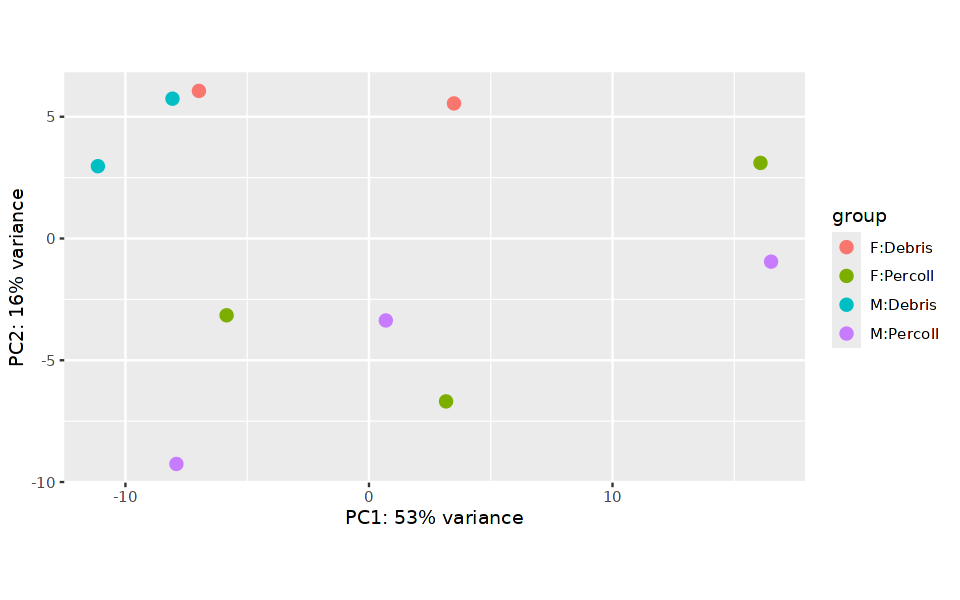

In [514]:
# Plot PCA
options(repr.plot.width=8, repr.plot.height=5)
DESeq2::plotPCA(rld, intgroup = c("group_id", "debris_id"))

In [515]:
# Extract the rlog matrix from the object and compute pairwise correlation values
rld_mat <- assay(rld)
rld_cor <- cor(rld_mat)

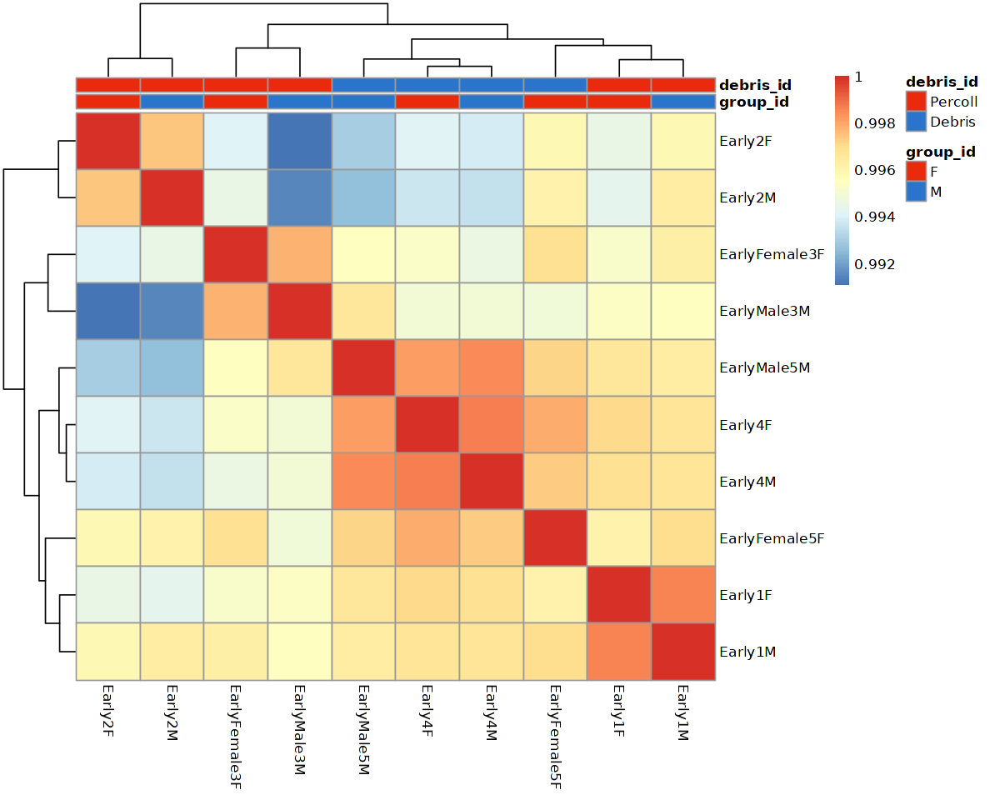

In [516]:
# Plot heatmap
options(repr.plot.width=10, repr.plot.height=8)
pheatmap(rld_cor, annotation = cluster_metadata[, c("group_id","debris_id"), drop=F], annotation_colors = list(group_id=sex_colors, debris_id=debris_colors))

In [517]:
# Run DESeq2 differential expression analysis
dds <- DESeq(dds)

estimating size factors

estimating dispersions

gene-wise dispersion estimates

mean-dispersion relationship

final dispersion estimates

fitting model and testing



In [518]:
libsize = data.frame(x=sizeFactors(dds), y=colSums(assay(dds)))

`geom_smooth()` using formula = 'y ~ x'


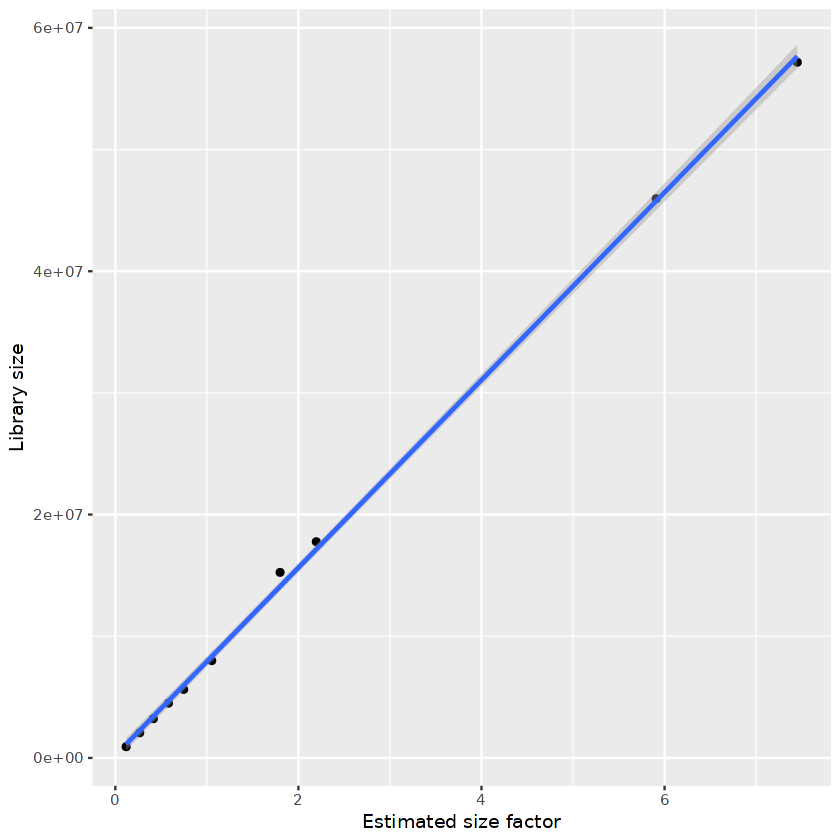

In [519]:
options(repr.plot.width=7, repr.plot.height=7)
ggplot(data=libsize, aes(x=x, y=y)) + geom_point() + geom_smooth(method="lm") + xlab("Estimated size factor") + ylab("Library size")

In [520]:
data.frame(colData(dds))

,cluster_id,sample_id,group_id,debris_id,sizeFactor
,<chr>,<chr>,<fct>,<fct>,<dbl>
Early1F,MOL,Early1F,F,Percoll,0.7465045
Early1M,MOL,Early1M,M,Percoll,1.0532280
Early2F,MOL,Early2F,F,Percoll,0.1181398
Early2M,MOL,Early2M,M,Percoll,0.2663523
Early4F,MOL,Early4F,F,Debris,0.4155008
Early4M,MOL,Early4M,M,Debris,0.5808407
EarlyFemale3F,MOL,EarlyFemale3F,F,Percoll,1.7997109
EarlyFemale5F,MOL,EarlyFemale5F,F,Debris,7.4501829
EarlyMale3M,MOL,EarlyMale3M,M,Percoll,2.1955674


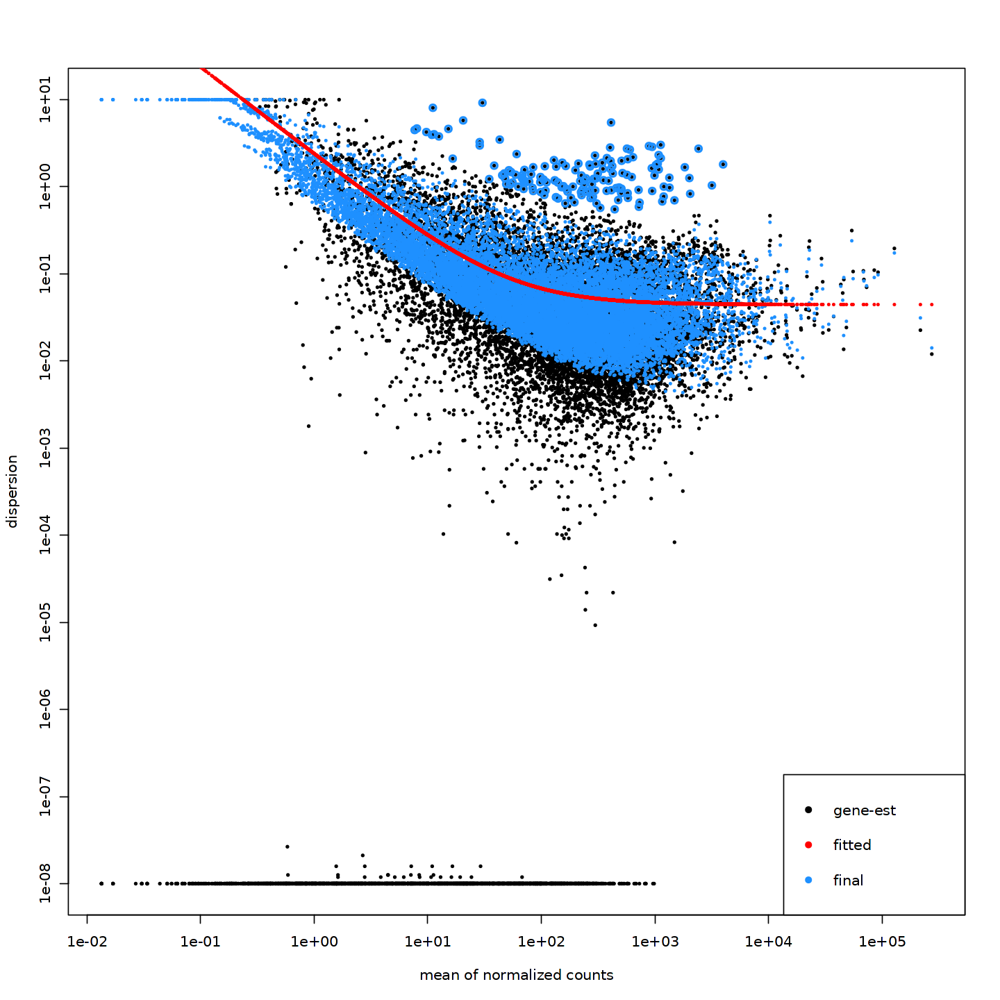

In [521]:
# Plot dispersion estimates
options(repr.plot.width=12, repr.plot.height=12)
plotDispEsts(dds)

In [522]:
condition1 = "M"
condition2 = "F"

In [523]:
contrast <- c("group_id", condition1, condition2)

# resultsNames(dds)
res <- results(dds, contrast = contrast, alpha = 0.05)

In [524]:
summary(res)


out of 14378 with nonzero total read count
adjusted p-value < 0.05
LFC > 0 (up)       : 0, 0%
LFC < 0 (down)     : 1, 0.007%
outliers [1]       : 9, 0.063%
low counts [2]     : 0, 0%
(mean count < 0)
[1] see 'cooksCutoff' argument of ?results
[2] see 'independentFiltering' argument of ?results



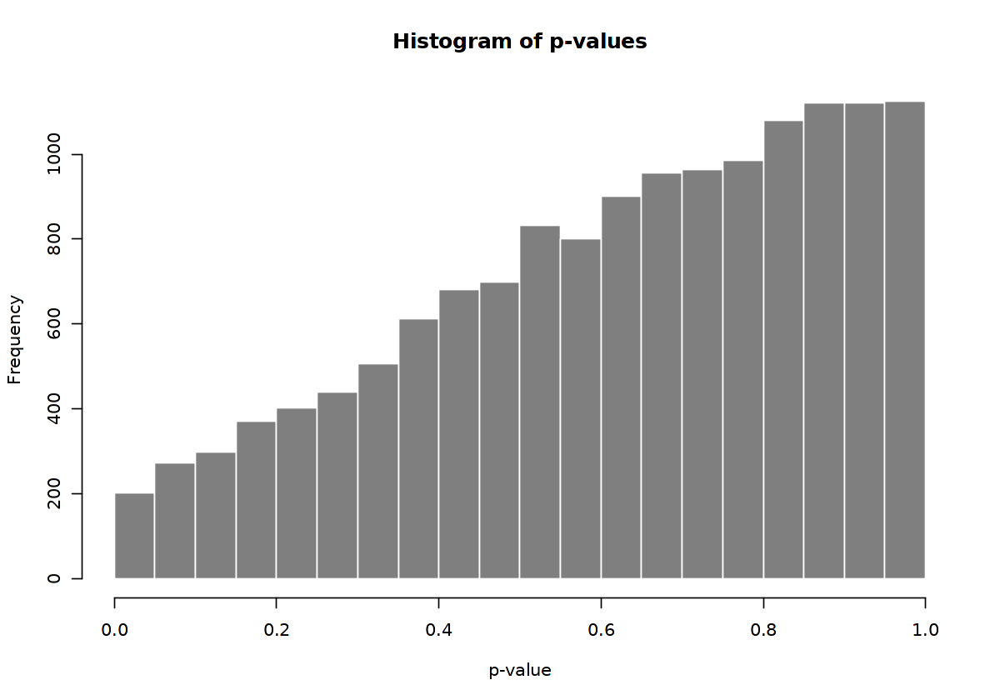

In [525]:
options(repr.plot.width=10, repr.plot.height=7)
hist(res$pvalue, breaks=0:20/20, col="grey50", border="white", xlim=c(0,1), main="Histogram of p-values", xlab="p-value")

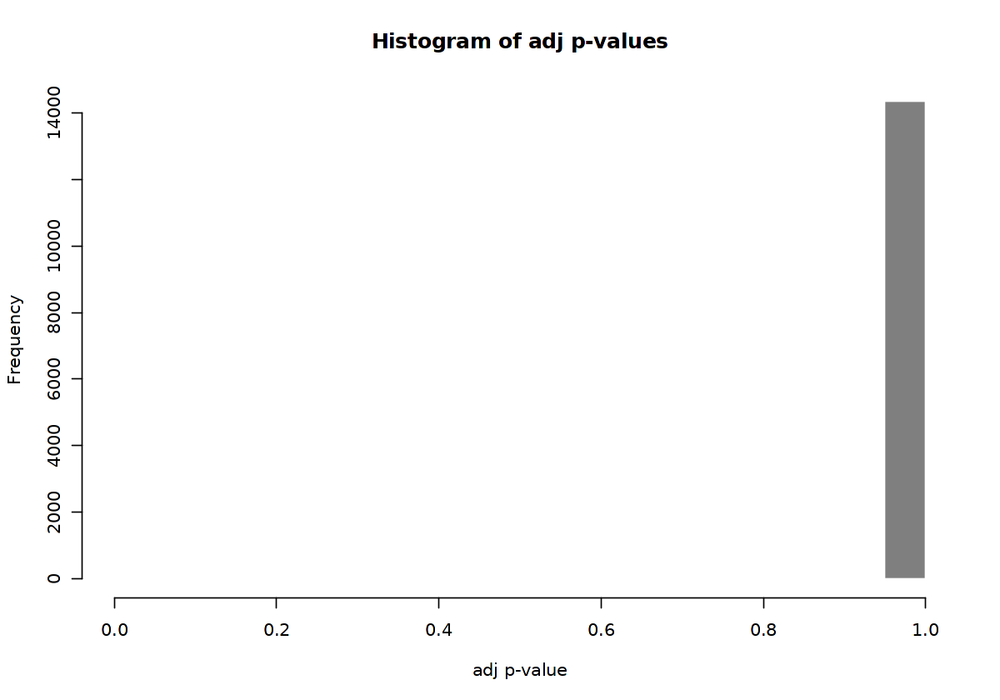

In [526]:
options(repr.plot.width=10, repr.plot.height=7)
hist(res$padj, breaks=0:20/20, col="grey50", border="white", xlim=c(0,1), main="Histogram of adj p-values", xlab="adj p-value")

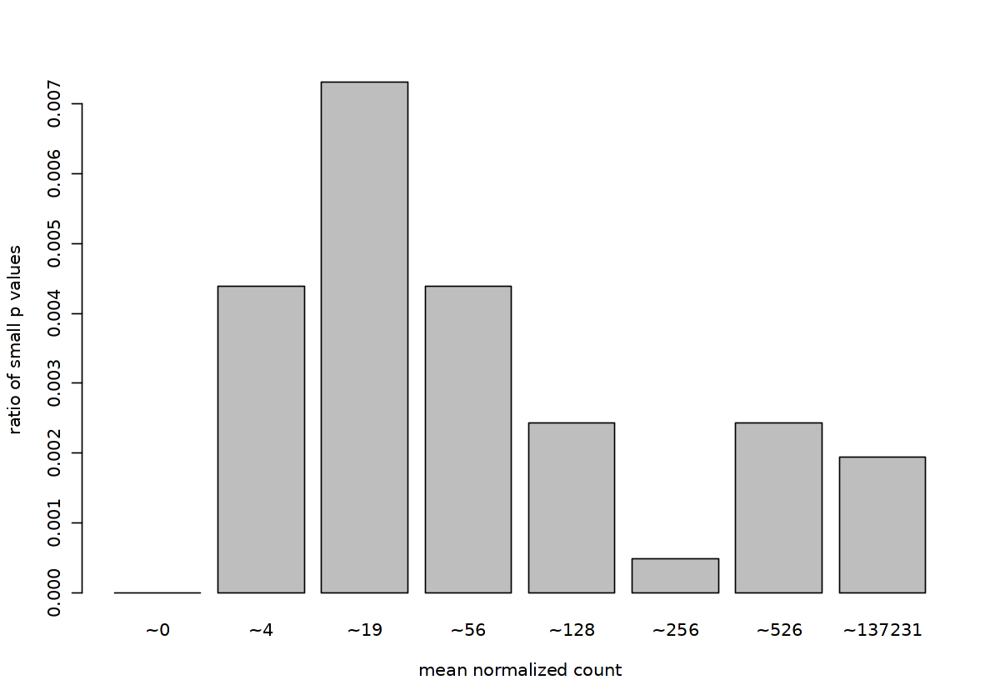

In [527]:
options(repr.plot.width=10, repr.plot.height=7)
qs <- c(0, quantile(res$baseMean[res$baseMean > 0], 0:7/7))
# cut the genes into the bins
bins <- cut(res$baseMean, qs)
# rename the levels of the bins using the middle point
levels(bins) <- paste0("~",round(.5*qs[-1] + .5*qs[-length(qs)]))
# calculate the ratio of $p$ values less than .01 for each bin
ratios <- tapply(res$pvalue, bins, function(p) mean(p < .01, na.rm=TRUE))
# plot these ratios
barplot(ratios, xlab="mean normalized count", ylab="ratio of small p values")

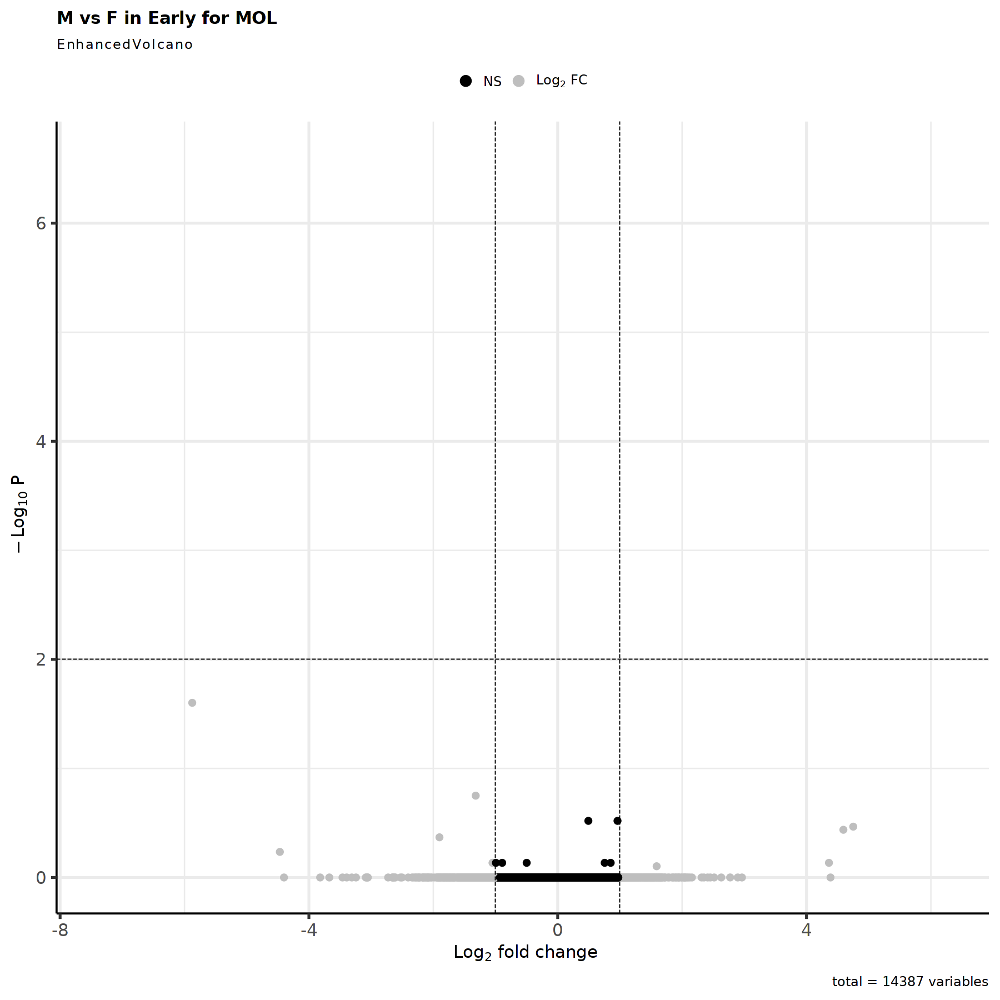

In [528]:
options(repr.plot.width=15, repr.plot.height=15)
#padj<0.001
EnhancedVolcano(res,
    lab = rownames(res),
    x = 'log2FoldChange',
    y = 'padj',
    title = paste0('M vs F in ',timepoint,' for ', cluster_choice),
    pCutoff = 0.01,
    FCcutoff = 1,
    pointSize = 3.0,
    labSize = 6.0,
    col=c('black', 'grey', 'grey', 'blue'),
    colAlpha = 1)

In [529]:
res <- res[complete.cases(res$padj),]

In [530]:
res_filtered <- res[(res$padj < 0.01 & abs(res$log2FoldChange) > 1 & res$baseMean > 1),]

In [531]:
res_filtered[order(abs(res_filtered$log2FoldChange), decreasing=TRUE),]

log2 fold change (MLE): group_id M vs F 
Wald test p-value: group id M vs F 
DataFrame with 0 rows and 6 columns

In [532]:
nrow(res_filtered)

[1] 0

##### 3.2.3.2 OPC

In [533]:
cluster_choice <- "OPC"

In [534]:
table_sample_low <- table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$sample_id)[cluster_choice,][table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$sample_id)[cluster_choice,] <= 5]
table_sample_low

sample_keep <- names(timepoint_Sex_colors)[!names(timepoint_Sex_colors) %in% names(table_sample_low)]

Early1F       Early2F       Early2M EarlyFemale3F   EarlyMale3M 
            5             0             0             1             5

In [535]:
table_group_low <-table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$group_id)[cluster_choice,][table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$group_id)[cluster_choice,] <= 30]
table_group_low

group_keep <- names(sex_colors)[!names(sex_colors) %in% names(table_group_low)]

named integer(0)

In [536]:
cluster_metadata <- metadata[which(metadata$cluster_id == cluster_choice), ]

# Assign the rownames of the metadata to be the sample IDs
rownames(cluster_metadata) <- cluster_metadata$sample_id

In [537]:
#Remove sample and timepoint with low counts (sample<=5, timepoint<=30)
cluster_metadata <- cluster_metadata[(cluster_metadata$sample_id %in% sample_keep & cluster_metadata$group_id %in% group_keep),]

#new_sample_levels <- levels(cluster_metadata$sample_id)[levels(cluster_metadata$sample_id) %in% sample_keep]
#cluster_metadata$sample_id <- droplevels(cluster_metadata$sample_id)
#levels(cluster_metadata$sample_id) <- new_sample_levels

new_group_levels <- levels(cluster_metadata$group_id)[levels(cluster_metadata$group_id) %in% group_keep]
cluster_metadata$group_id <- droplevels(cluster_metadata$group_id)
levels(cluster_metadata$group_id) <- new_group_levels

In [538]:
cluster_metadata

,cluster_id,sample_id,group_id,debris_id
,<chr>,<chr>,<fct>,<chr>
Early1M,OPC,Early1M,M,Percoll
Early4F,OPC,Early4F,F,Debris
Early4M,OPC,Early4M,M,Debris
EarlyFemale5F,OPC,EarlyFemale5F,F,Debris
EarlyMale5M,OPC,EarlyMale5M,M,Debris


In [539]:
# Subset the counts to only this cluster
counts <- pb[[cluster_choice]]

cluster_counts <- data.frame(counts[, which(colnames(counts) %in% rownames(cluster_metadata))])

# Check that all of the row names of the metadata are the same and in the same order as the column names of the counts in order to use as input to DESeq2
all(rownames(cluster_metadata) == colnames(cluster_counts))

[1] TRUE

In [540]:
dds <- DESeqDataSetFromMatrix(cluster_counts, colData = cluster_metadata, design = ~ group_id + debris_id)

converting counts to integer mode

Warning message in DESeqDataSet(se, design = design, ignoreRank):
"some variables in design formula are characters, converting to factors"


In [541]:
# Transform counts for data visualization
rld <- rlog(dds, blind=TRUE)

using ntop=500 top features by variance



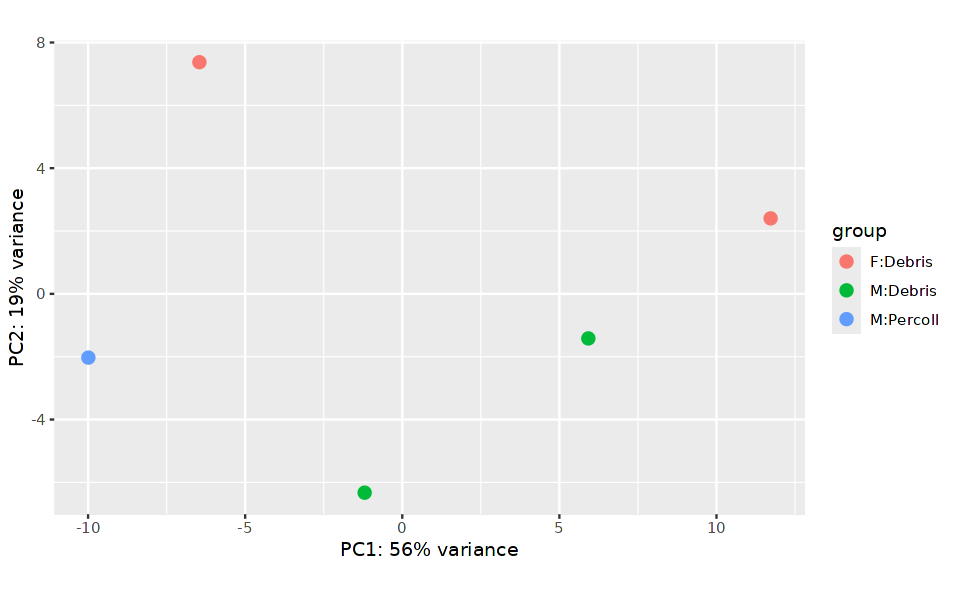

In [542]:
# Plot PCA
options(repr.plot.width=8, repr.plot.height=5)
DESeq2::plotPCA(rld, intgroup = c("group_id", "debris_id"))

In [543]:
# Extract the rlog matrix from the object and compute pairwise correlation values
rld_mat <- assay(rld)
rld_cor <- cor(rld_mat)

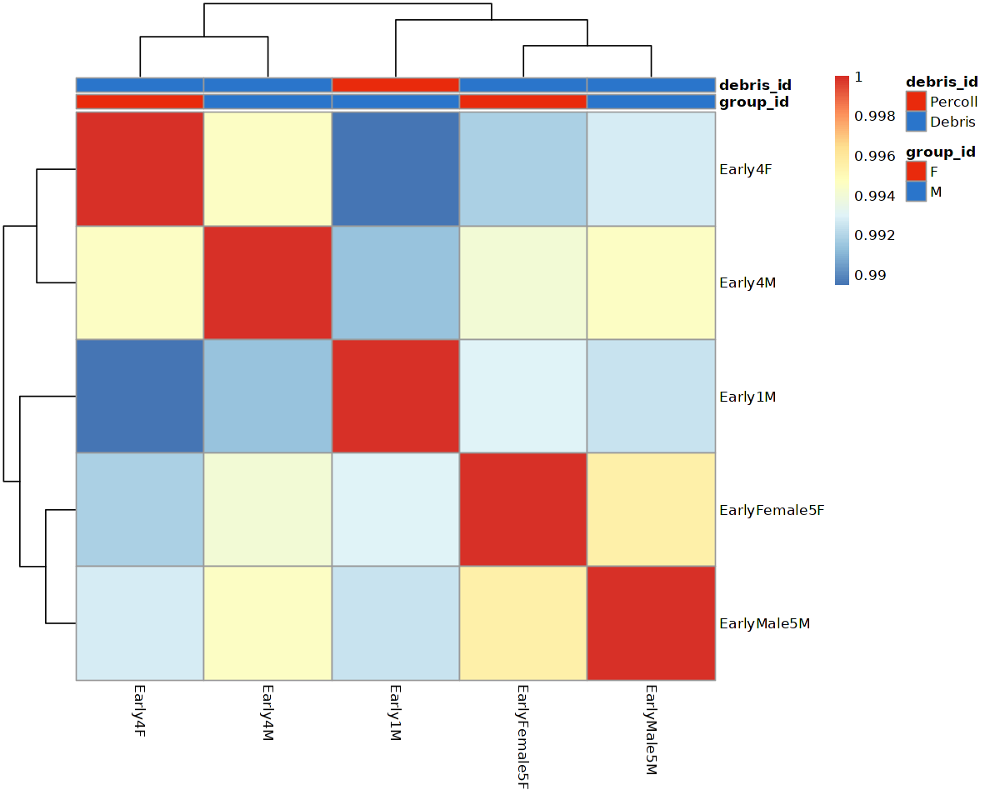

In [544]:
# Plot heatmap
options(repr.plot.width=10, repr.plot.height=8)
pheatmap(rld_cor, annotation = cluster_metadata[, c("group_id","debris_id"), drop=F], annotation_colors = list(group_id=sex_colors, debris_id=debris_colors))

In [545]:
# Run DESeq2 differential expression analysis
dds <- DESeq(dds)

estimating size factors

estimating dispersions

gene-wise dispersion estimates

mean-dispersion relationship

final dispersion estimates

fitting model and testing



In [546]:
libsize = data.frame(x=sizeFactors(dds), y=colSums(assay(dds)))

`geom_smooth()` using formula = 'y ~ x'


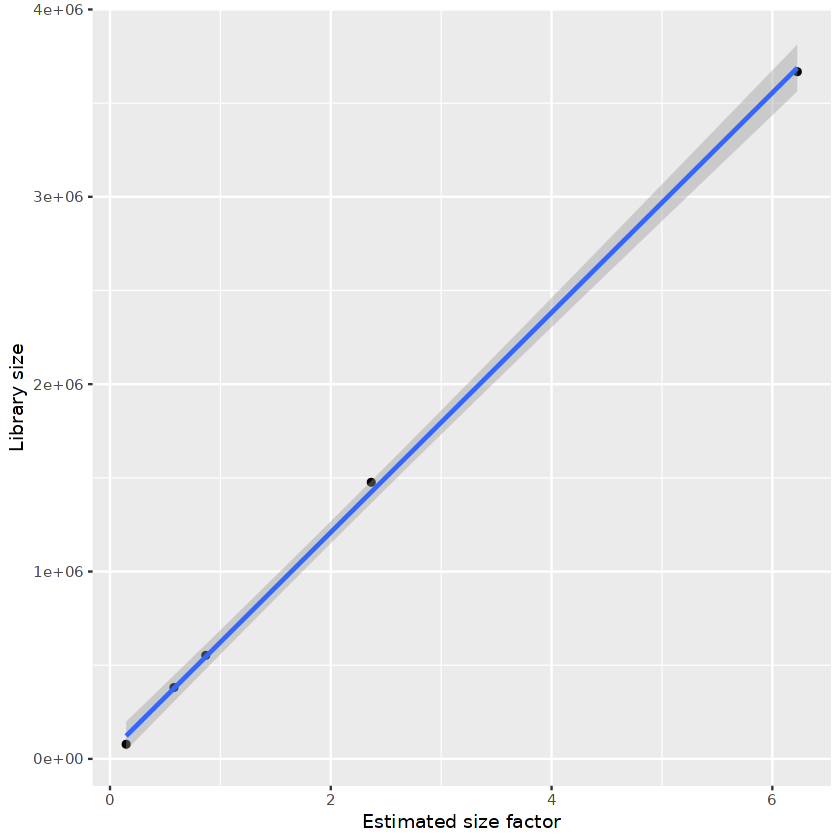

In [547]:
options(repr.plot.width=7, repr.plot.height=7)
ggplot(data=libsize, aes(x=x, y=y)) + geom_point() + geom_smooth(method="lm") + xlab("Estimated size factor") + ylab("Library size")

In [548]:
data.frame(colData(dds))

,cluster_id,sample_id,group_id,debris_id,sizeFactor
,<chr>,<chr>,<fct>,<fct>,<dbl>
Early1M,OPC,Early1M,M,Percoll,0.1461804
Early4F,OPC,Early4F,F,Debris,0.5793032
Early4M,OPC,Early4M,M,Debris,0.8673616
EarlyFemale5F,OPC,EarlyFemale5F,F,Debris,6.2261228
EarlyMale5M,OPC,EarlyMale5M,M,Debris,2.3666832


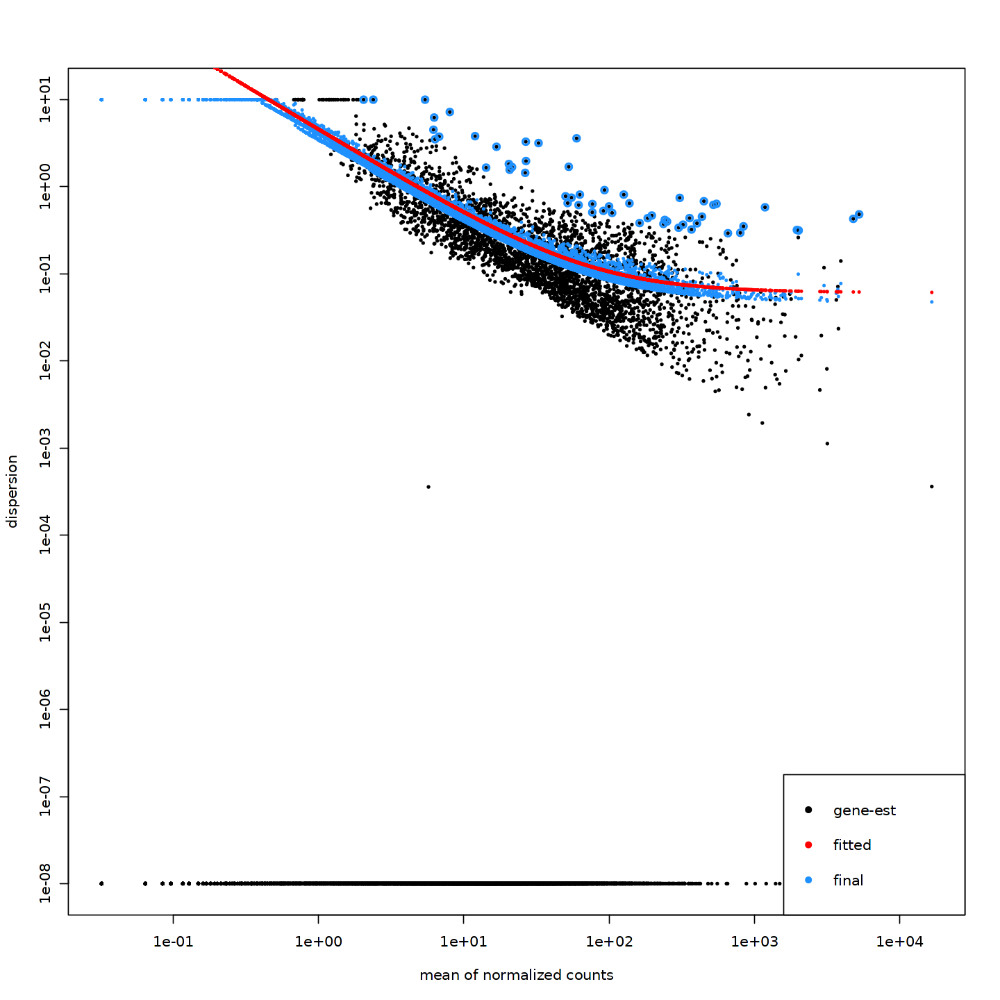

In [549]:
# Plot dispersion estimates
options(repr.plot.width=12, repr.plot.height=12)
plotDispEsts(dds)

In [550]:
condition1 = "M"
condition2 = "F"

In [551]:
contrast <- c("group_id", condition1, condition2)

# resultsNames(dds)
res <- results(dds, contrast = contrast, alpha = 0.05)

In [552]:
summary(res)


out of 14100 with nonzero total read count
adjusted p-value < 0.05
LFC > 0 (up)       : 0, 0%
LFC < 0 (down)     : 1, 0.0071%
outliers [1]       : 0, 0%
low counts [2]     : 0, 0%
(mean count < 0)
[1] see 'cooksCutoff' argument of ?results
[2] see 'independentFiltering' argument of ?results



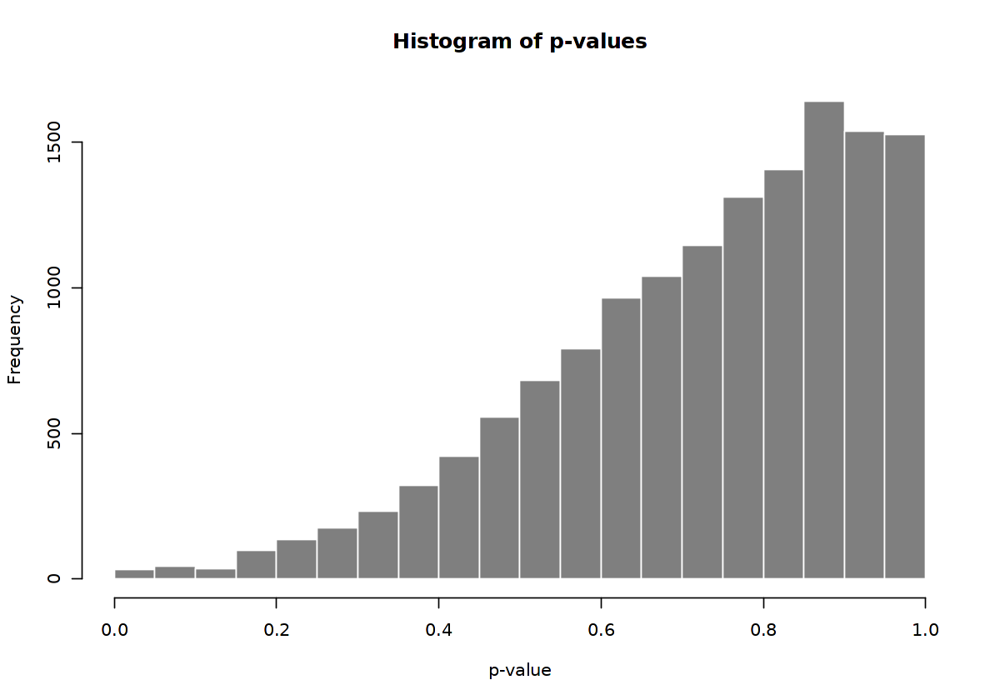

In [553]:
options(repr.plot.width=10, repr.plot.height=7)
hist(res$pvalue, breaks=0:20/20, col="grey50", border="white", xlim=c(0,1), main="Histogram of p-values", xlab="p-value")

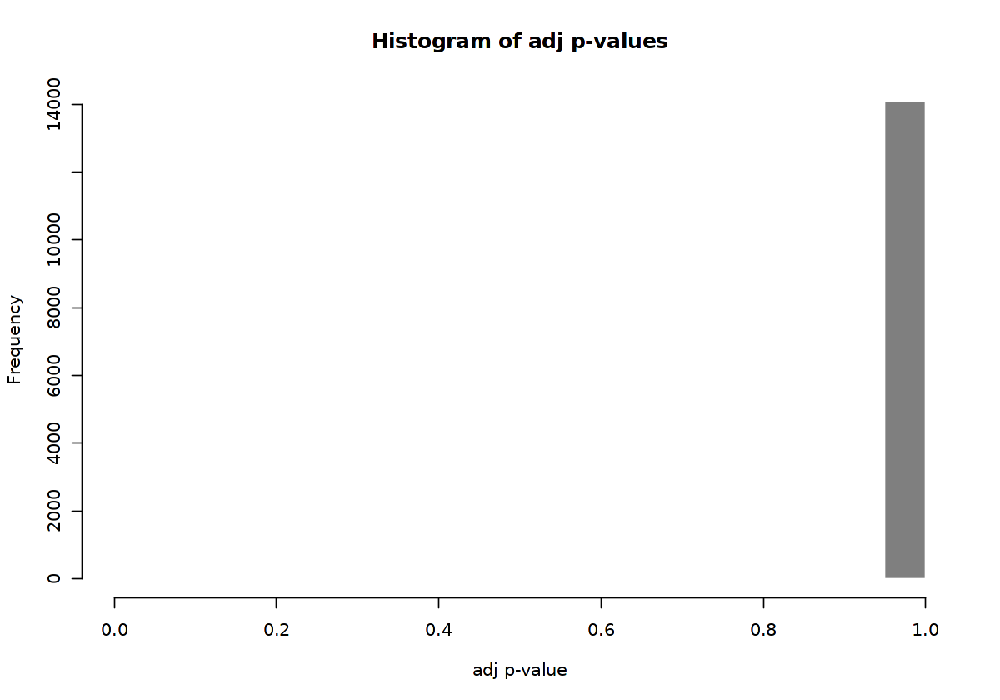

In [554]:
options(repr.plot.width=10, repr.plot.height=7)
hist(res$padj, breaks=0:20/20, col="grey50", border="white", xlim=c(0,1), main="Histogram of adj p-values", xlab="adj p-value")

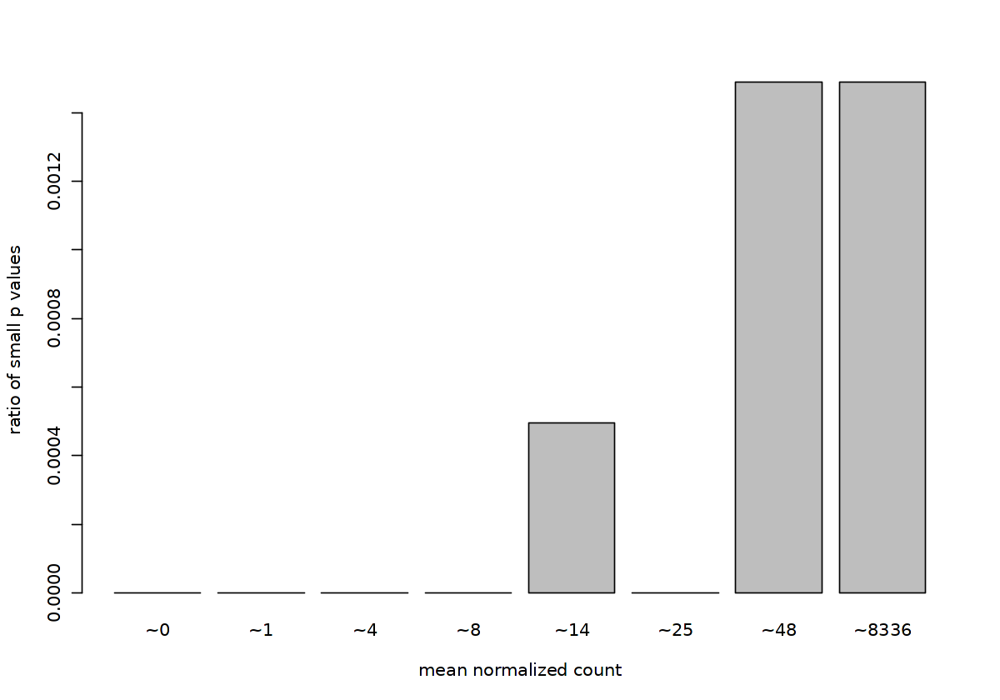

In [555]:
options(repr.plot.width=10, repr.plot.height=7)
qs <- c(0, quantile(res$baseMean[res$baseMean > 0], 0:7/7))
# cut the genes into the bins
bins <- cut(res$baseMean, qs)
# rename the levels of the bins using the middle point
levels(bins) <- paste0("~",round(.5*qs[-1] + .5*qs[-length(qs)]))
# calculate the ratio of $p$ values less than .01 for each bin
ratios <- tapply(res$pvalue, bins, function(p) mean(p < .01, na.rm=TRUE))
# plot these ratios
barplot(ratios, xlab="mean normalized count", ylab="ratio of small p values")

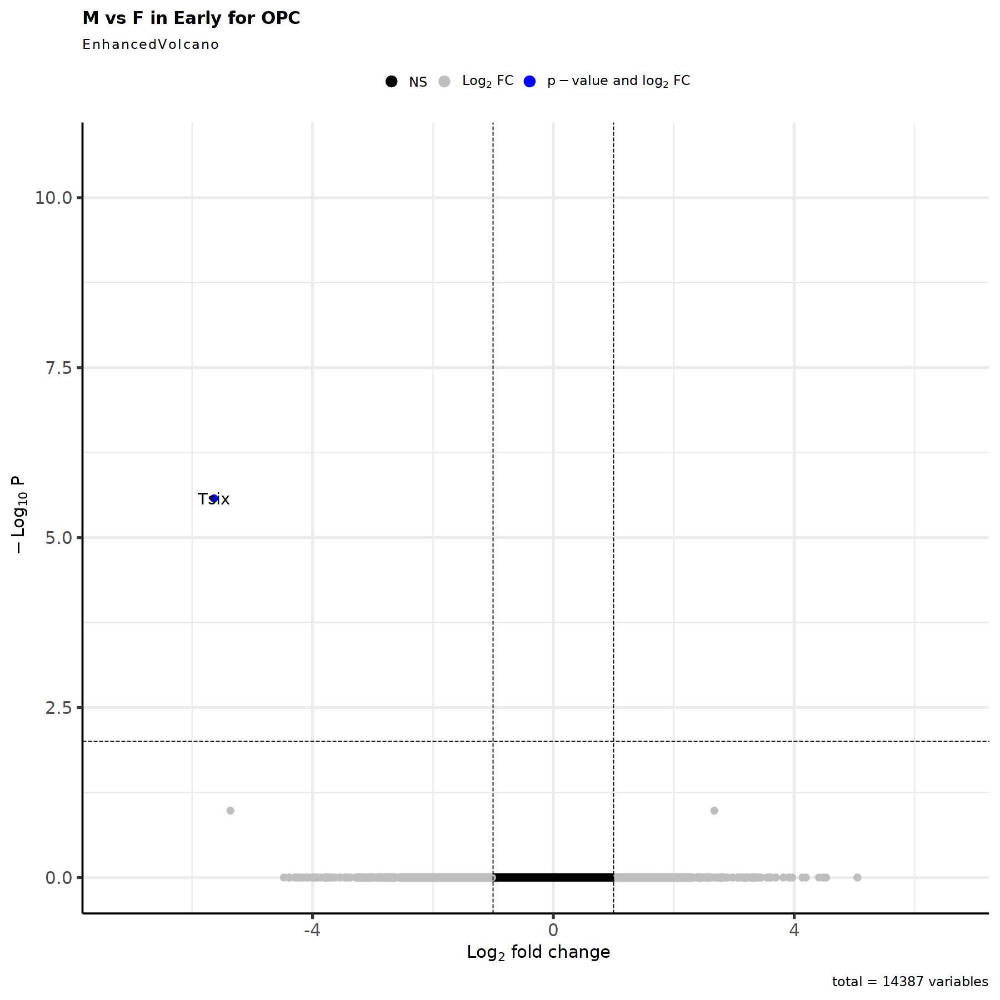

In [556]:
options(repr.plot.width=15, repr.plot.height=15)
#padj<0.001
EnhancedVolcano(res,
    lab = rownames(res),
    x = 'log2FoldChange',
    y = 'padj',
    title = paste0('M vs F in ',timepoint,' for ', cluster_choice),
    pCutoff = 0.01,
    FCcutoff = 1,
    pointSize = 3.0,
    labSize = 6.0,
    col=c('black', 'grey', 'grey', 'blue'),
    colAlpha = 1)

In [557]:
res <- res[complete.cases(res$padj),]

In [558]:
res_filtered <- res[(res$padj < 0.01 & abs(res$log2FoldChange) > 1 & res$baseMean > 1),]

In [559]:
res_filtered[order(abs(res_filtered$log2FoldChange), decreasing=TRUE),]

log2 fold change (MLE): group_id M vs F 
Wald test p-value: group id M vs F 
DataFrame with 1 row and 6 columns
      baseMean log2FoldChange     lfcSE      stat      pvalue        padj
     <numeric>      <numeric> <numeric> <numeric>   <numeric>   <numeric>
Tsix   39.0792       -5.63685  0.884769  -6.37099 1.87817e-10 2.64821e-06

In [560]:
nrow(res_filtered)

[1] 1

In [561]:
top.genes.number <- ifelse(nrow(res_filtered)>100, 100, nrow(res_filtered))

In [562]:
res_top <- res_filtered[order(abs(res_filtered$log2FoldChange), decreasing=TRUE),][1:top.genes.number,]
res_top <- res_top[order(res_top$log2FoldChange, decreasing=FALSE),]

In [563]:
tmp_sub <- subset(tmp, subset = cellType == cluster_choice)

In [564]:
tmp_sub <- NormalizeData(tmp_sub, normalization.method = "LogNormalize", scale.factor = 10000, verbose = TRUE)

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


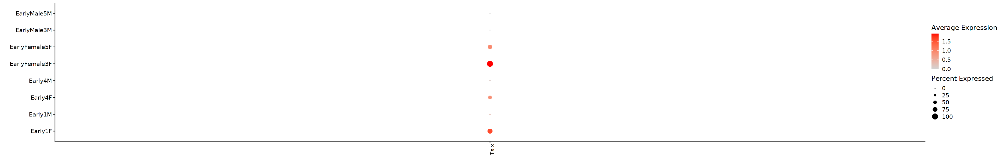

In [565]:
options(repr.plot.width=30, repr.plot.height=5)
plot <- DotPlot(tmp_sub, assay = "RNA", group.by = "orig.ident_Sex", scale=FALSE, cols = c("lightgrey", "red"), dot.scale = 5, features = rownames(res_top))
plot + theme(axis.text.x = element_text(angle = 90)) + labs(x = "", y= "")

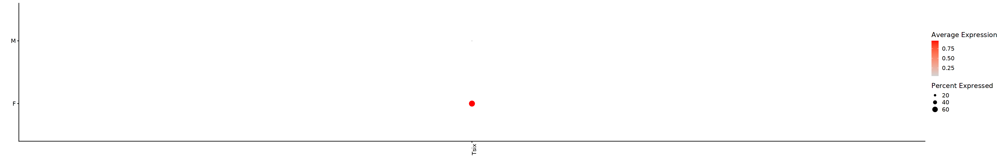

In [566]:
options(repr.plot.width=30, repr.plot.height=5)
plot <- DotPlot(tmp_sub, assay = "RNA", group.by = "Sex", scale=FALSE, cols = c("lightgrey", "red"), dot.scale = 5, features = rownames(res_top))
plot + theme(axis.text.x = element_text(angle = 90)) + labs(x = "", y= "")

In [567]:
HVGs.list[[cluster_choice]] <- rownames(res_filtered)

##### 3.2.3.3 Micro

In [568]:
cluster_choice <- "Micro"

In [569]:
table_sample_low <- table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$sample_id)[cluster_choice,][table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$sample_id)[cluster_choice,] <= 5]
table_sample_low

sample_keep <- names(timepoint_Sex_colors)[!names(timepoint_Sex_colors) %in% names(table_sample_low)]

EarlyFemale3F 
            3

In [570]:
table_group_low <-table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$group_id)[cluster_choice,][table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$group_id)[cluster_choice,] <= 30]
table_group_low

group_keep <- names(sex_colors)[!names(sex_colors) %in% names(table_group_low)]

named integer(0)

In [571]:
cluster_metadata <- metadata[which(metadata$cluster_id == cluster_choice), ]

# Assign the rownames of the metadata to be the sample IDs
rownames(cluster_metadata) <- cluster_metadata$sample_id

In [572]:
#Remove sample and timepoint with low counts (sample<=5, timepoint<=30)
cluster_metadata <- cluster_metadata[(cluster_metadata$sample_id %in% sample_keep & cluster_metadata$group_id %in% group_keep),]

#new_sample_levels <- levels(cluster_metadata$sample_id)[levels(cluster_metadata$sample_id) %in% sample_keep]
#cluster_metadata$sample_id <- droplevels(cluster_metadata$sample_id)
#levels(cluster_metadata$sample_id) <- new_sample_levels

new_group_levels <- levels(cluster_metadata$group_id)[levels(cluster_metadata$group_id) %in% group_keep]
cluster_metadata$group_id <- droplevels(cluster_metadata$group_id)
levels(cluster_metadata$group_id) <- new_group_levels

In [573]:
cluster_metadata

,cluster_id,sample_id,group_id,debris_id
,<chr>,<chr>,<fct>,<chr>
Early1F,Micro,Early1F,F,Percoll
Early1M,Micro,Early1M,M,Percoll
Early2F,Micro,Early2F,F,Percoll
Early2M,Micro,Early2M,M,Percoll
Early4F,Micro,Early4F,F,Debris
Early4M,Micro,Early4M,M,Debris
EarlyFemale5F,Micro,EarlyFemale5F,F,Debris
EarlyMale3M,Micro,EarlyMale3M,M,Percoll
EarlyMale5M,Micro,EarlyMale5M,M,Debris


In [574]:
# Subset the counts to only this cluster
counts <- pb[[cluster_choice]]

cluster_counts <- data.frame(counts[, which(colnames(counts) %in% rownames(cluster_metadata))])

# Check that all of the row names of the metadata are the same and in the same order as the column names of the counts in order to use as input to DESeq2
all(rownames(cluster_metadata) == colnames(cluster_counts))

[1] TRUE

In [575]:
dds <- DESeqDataSetFromMatrix(cluster_counts, colData = cluster_metadata, design = ~ group_id + debris_id)

converting counts to integer mode

Warning message in DESeqDataSet(se, design = design, ignoreRank):
"some variables in design formula are characters, converting to factors"


In [576]:
# Transform counts for data visualization
rld <- rlog(dds, blind=TRUE)

using ntop=500 top features by variance



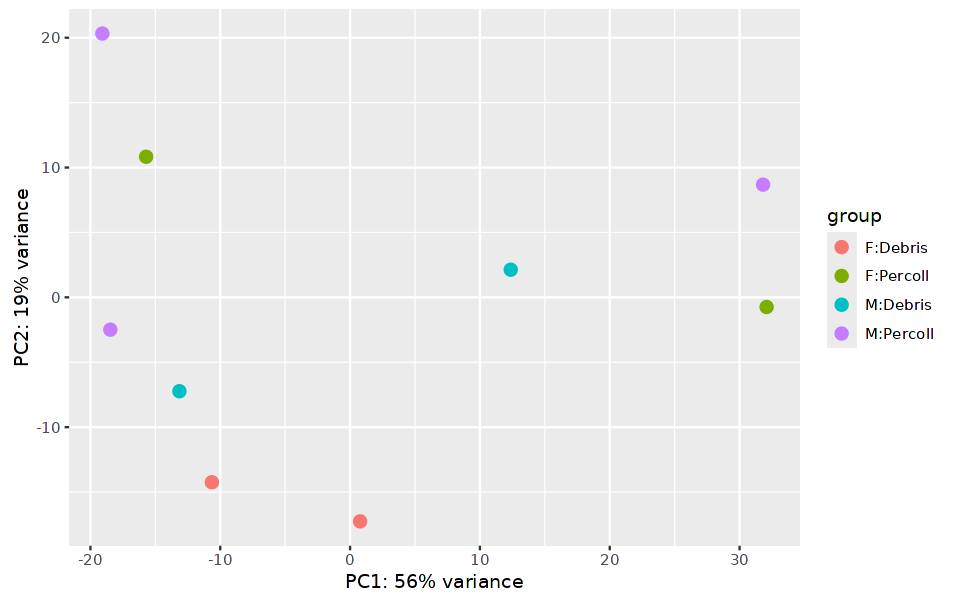

In [577]:
# Plot PCA
options(repr.plot.width=8, repr.plot.height=5)
DESeq2::plotPCA(rld, intgroup = c("group_id", "debris_id"))

In [578]:
# Extract the rlog matrix from the object and compute pairwise correlation values
rld_mat <- assay(rld)
rld_cor <- cor(rld_mat)

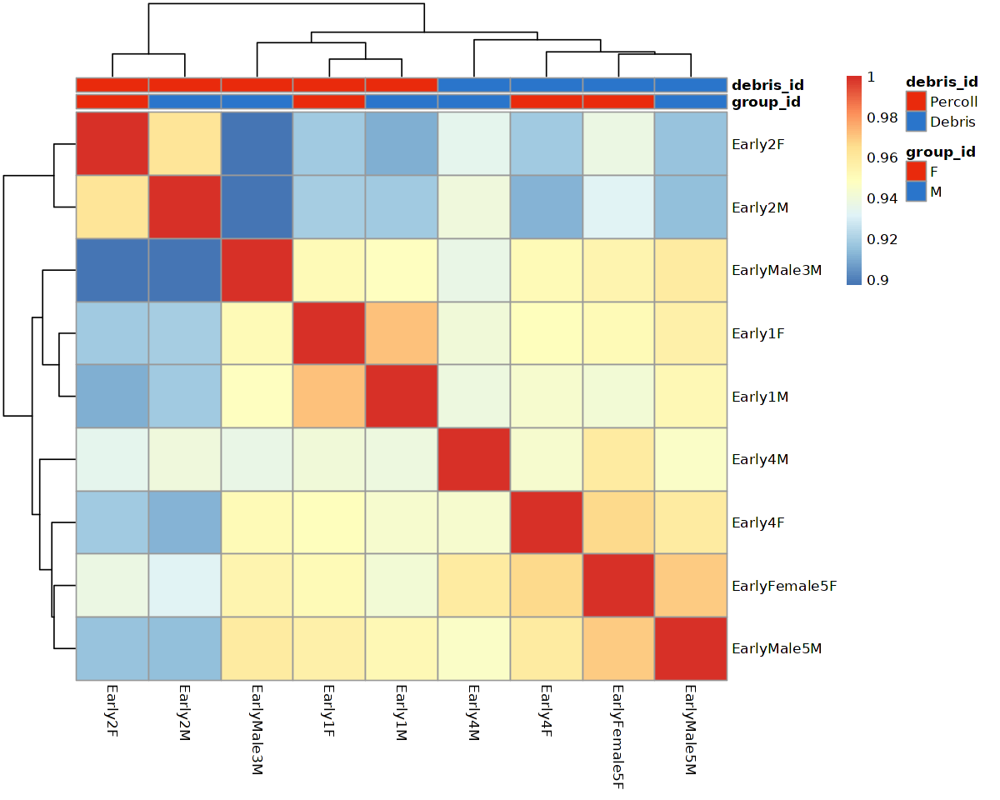

In [579]:
# Plot heatmap
options(repr.plot.width=10, repr.plot.height=8)
pheatmap(rld_cor, annotation = cluster_metadata[, c("group_id","debris_id"), drop=F], annotation_colors = list(group_id=sex_colors, debris_id=debris_colors))

In [580]:
# Run DESeq2 differential expression analysis
dds <- DESeq(dds)

estimating size factors

estimating dispersions

gene-wise dispersion estimates

mean-dispersion relationship

final dispersion estimates

fitting model and testing



In [581]:
libsize = data.frame(x=sizeFactors(dds), y=colSums(assay(dds)))

`geom_smooth()` using formula = 'y ~ x'


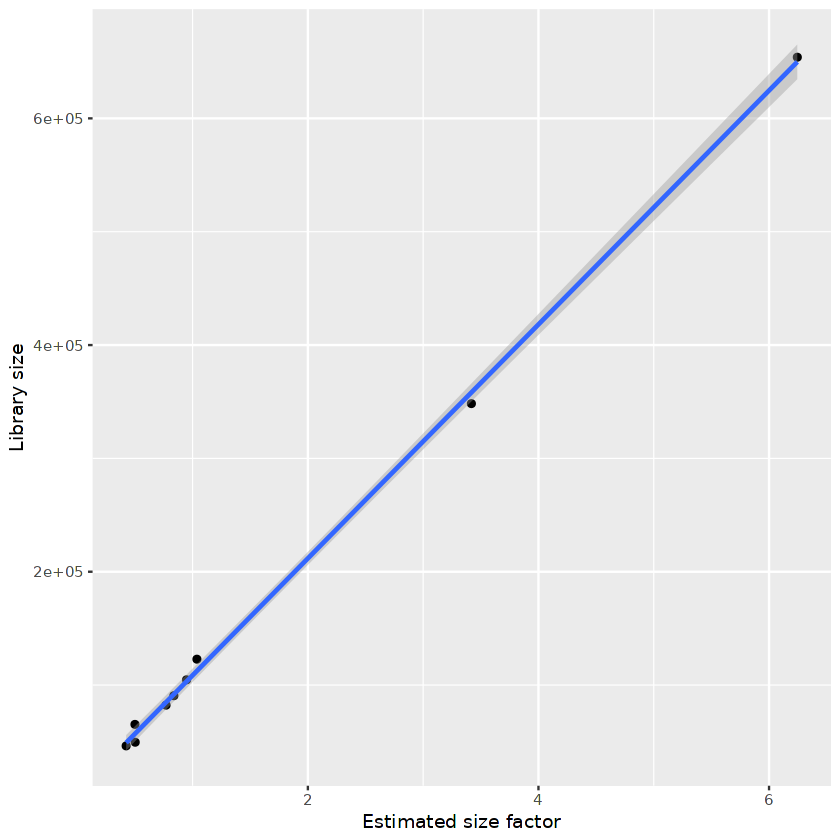

In [582]:
options(repr.plot.width=7, repr.plot.height=7)
ggplot(data=libsize, aes(x=x, y=y)) + geom_point() + geom_smooth(method="lm") + xlab("Estimated size factor") + ylab("Library size")

In [583]:
data.frame(colData(dds))

,cluster_id,sample_id,group_id,debris_id,sizeFactor
,<chr>,<chr>,<fct>,<fct>,<dbl>
Early1F,Micro,Early1F,F,Percoll,0.7699459
Early1M,Micro,Early1M,M,Percoll,3.4183879
Early2F,Micro,Early2F,F,Percoll,0.9479910
Early2M,Micro,Early2M,M,Percoll,0.8376381
Early4F,Micro,Early4F,F,Debris,0.4238327
Early4M,Micro,Early4M,M,Debris,0.5024332
EarlyFemale5F,Micro,EarlyFemale5F,F,Debris,6.2451646
EarlyMale3M,Micro,EarlyMale3M,M,Percoll,0.5002124
EarlyMale5M,Micro,EarlyMale5M,M,Debris,1.0377331


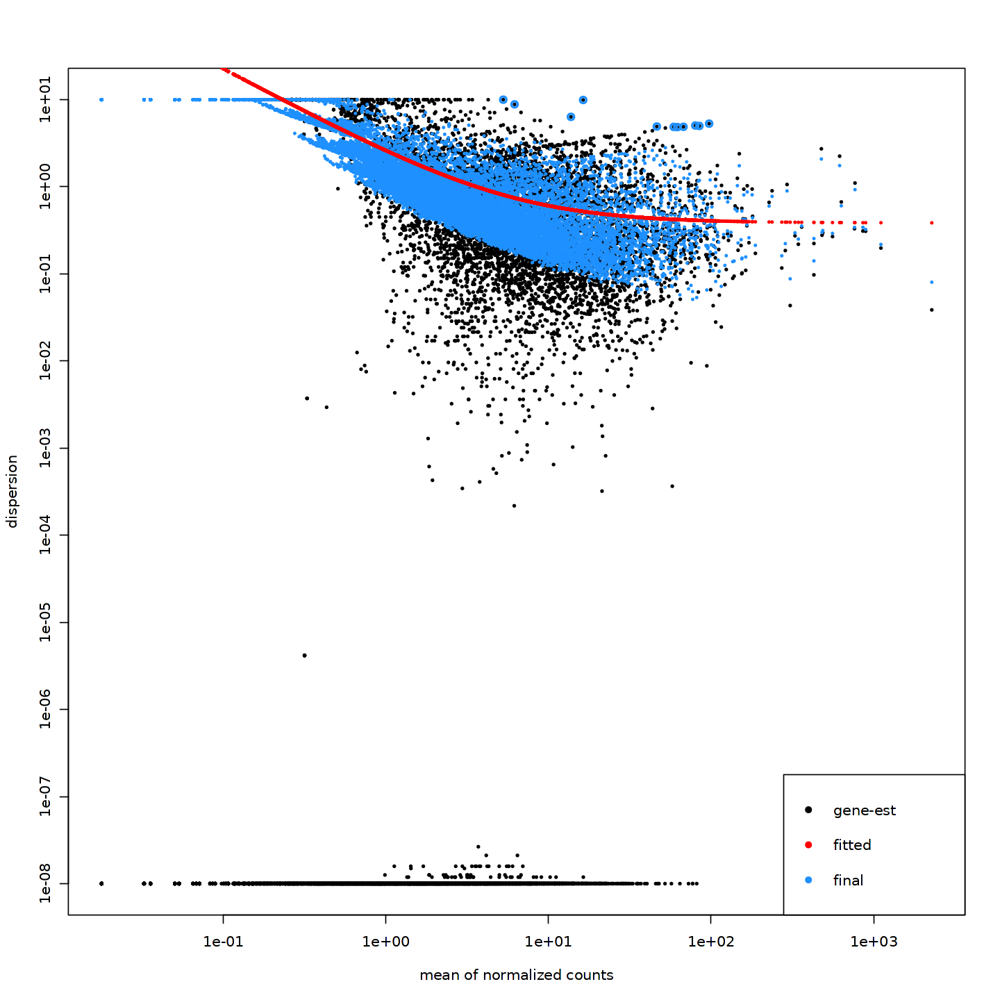

In [584]:
# Plot dispersion estimates
options(repr.plot.width=12, repr.plot.height=12)
plotDispEsts(dds)

In [585]:
condition1 = "M"
condition2 = "F"

In [586]:
contrast <- c("group_id", condition1, condition2)

# resultsNames(dds)
res <- results(dds, contrast = contrast, alpha = 0.05)

In [587]:
summary(res)


out of 13742 with nonzero total read count
adjusted p-value < 0.05
LFC > 0 (up)       : 0, 0%
LFC < 0 (down)     : 4, 0.029%
outliers [1]       : 9, 0.065%
low counts [2]     : 0, 0%
(mean count < 0)
[1] see 'cooksCutoff' argument of ?results
[2] see 'independentFiltering' argument of ?results



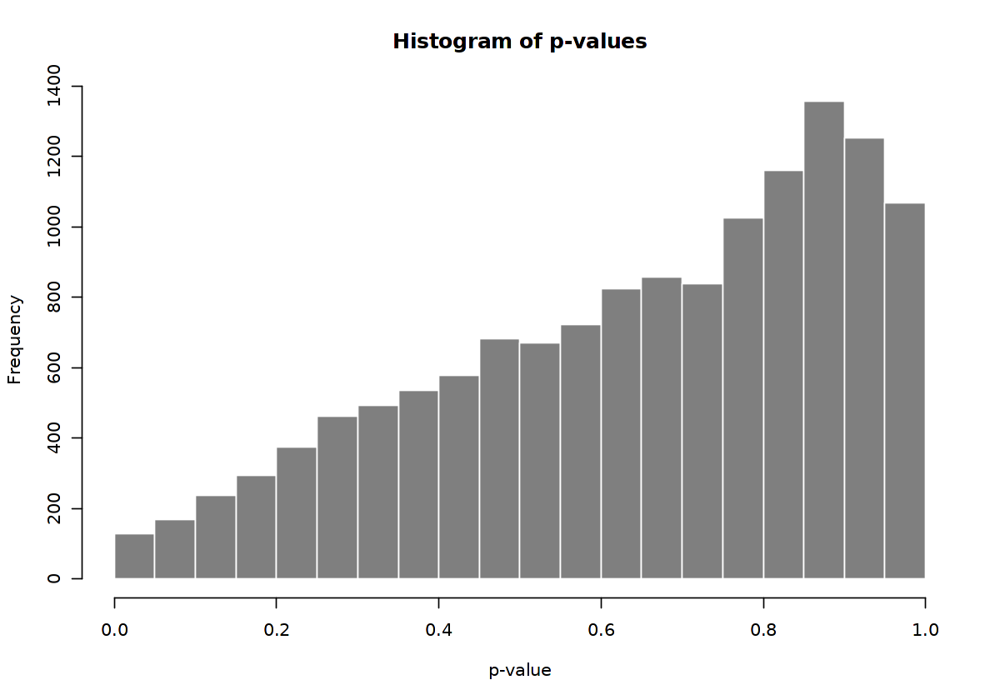

In [588]:
options(repr.plot.width=10, repr.plot.height=7)
hist(res$pvalue, breaks=0:20/20, col="grey50", border="white", xlim=c(0,1), main="Histogram of p-values", xlab="p-value")

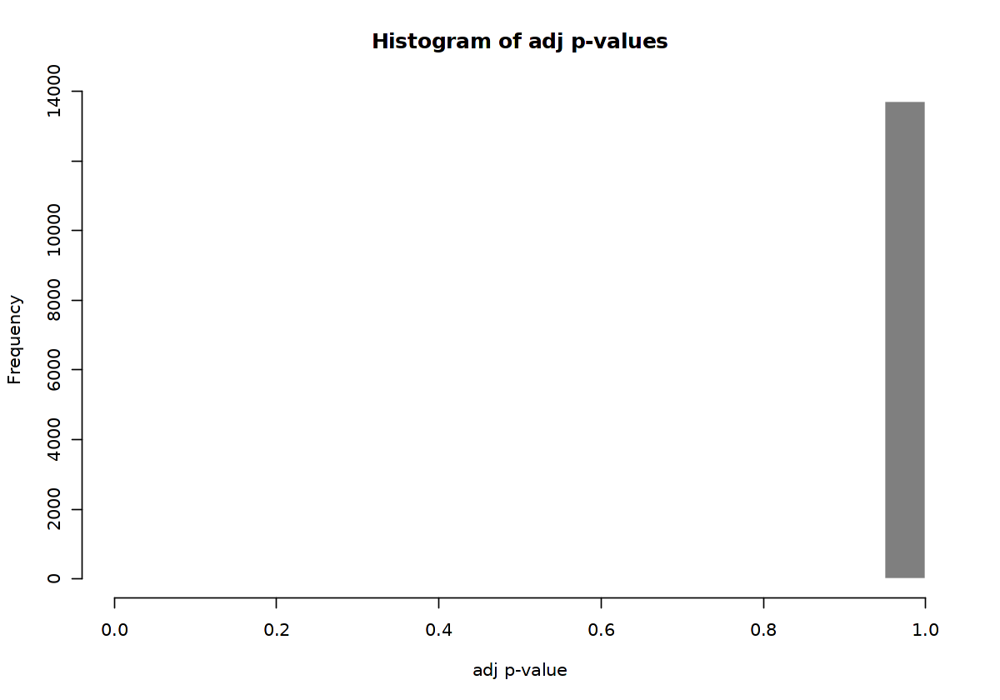

In [589]:
options(repr.plot.width=10, repr.plot.height=7)
hist(res$padj, breaks=0:20/20, col="grey50", border="white", xlim=c(0,1), main="Histogram of adj p-values", xlab="adj p-value")

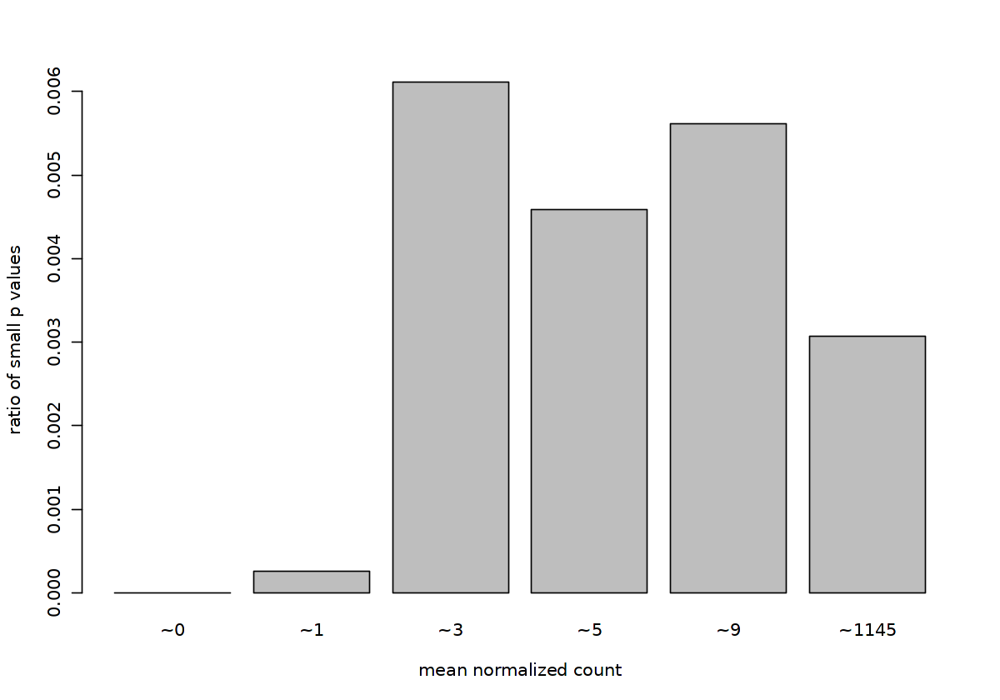

In [590]:
options(repr.plot.width=10, repr.plot.height=7)
qs <- c(0, quantile(res$baseMean[res$baseMean > 0], 0:7/7))
# cut the genes into the bins
bins <- cut(res$baseMean, qs)
# rename the levels of the bins using the middle point
levels(bins) <- paste0("~",round(.5*qs[-1] + .5*qs[-length(qs)]))
# calculate the ratio of $p$ values less than .01 for each bin
ratios <- tapply(res$pvalue, bins, function(p) mean(p < .01, na.rm=TRUE))
# plot these ratios
barplot(ratios, xlab="mean normalized count", ylab="ratio of small p values")

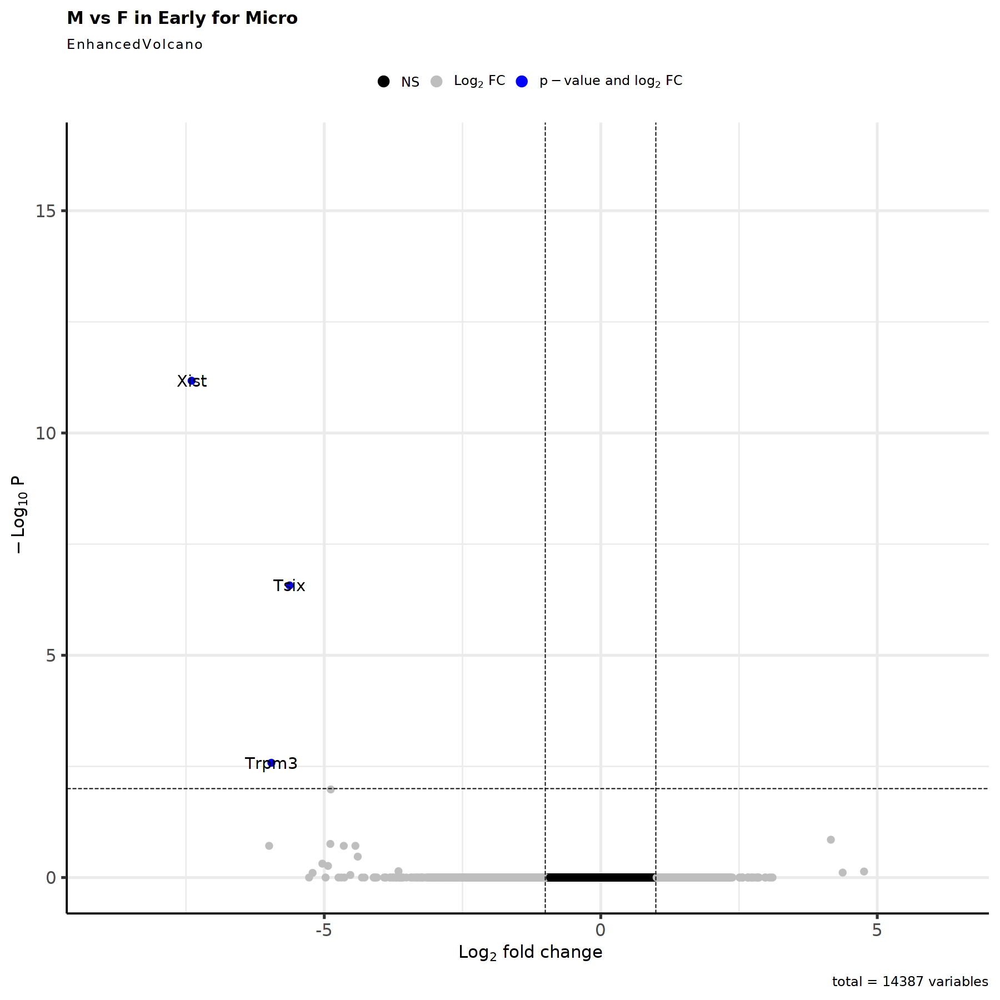

In [591]:
options(repr.plot.width=15, repr.plot.height=15)
#padj<0.001
EnhancedVolcano(res,
    lab = rownames(res),
    x = 'log2FoldChange',
    y = 'padj',
    title = paste0('M vs F in ',timepoint,' for ', cluster_choice),
    pCutoff = 0.01,
    FCcutoff = 1,
    pointSize = 3.0,
    labSize = 6.0,
    col=c('black', 'grey', 'grey', 'blue'),
    colAlpha = 1)

In [592]:
res <- res[complete.cases(res$padj),]

In [593]:
res_filtered <- res[(res$padj < 0.01 & abs(res$log2FoldChange) > 1 & res$baseMean > 1),]

In [594]:
res_filtered[order(abs(res_filtered$log2FoldChange), decreasing=TRUE),]

log2 fold change (MLE): group_id M vs F 
Wald test p-value: group id M vs F 
DataFrame with 3 rows and 6 columns
       baseMean log2FoldChange     lfcSE      stat      pvalue        padj
      <numeric>      <numeric> <numeric> <numeric>   <numeric>   <numeric>
Xist    69.6253       -7.39939  0.911808  -8.11507 4.85497e-16 6.66732e-12
Trpm3   14.9892       -5.95677  1.191340  -5.00006 5.73137e-07 2.62363e-03
Tsix    18.3051       -5.62768  0.851703  -6.60756 3.90698e-11 2.68273e-07

In [595]:
nrow(res_filtered)

[1] 3

In [596]:
top.genes.number <- ifelse(nrow(res_filtered)>100, 100, nrow(res_filtered))

In [597]:
res_top <- res_filtered[order(abs(res_filtered$log2FoldChange), decreasing=TRUE),][1:top.genes.number,]
res_top <- res_top[order(res_top$log2FoldChange, decreasing=FALSE),]

In [598]:
tmp_sub <- subset(tmp, subset = cellType == cluster_choice)

In [599]:
tmp_sub <- NormalizeData(tmp_sub, normalization.method = "LogNormalize", scale.factor = 10000, verbose = TRUE)

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


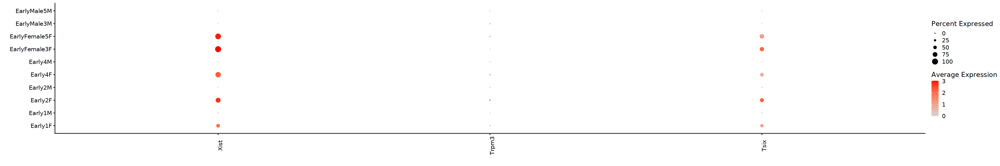

In [600]:
options(repr.plot.width=30, repr.plot.height=5)
plot <- DotPlot(tmp_sub, assay = "RNA", group.by = "orig.ident_Sex", scale=FALSE, cols = c("lightgrey", "red"), dot.scale = 5, features = rownames(res_top))
plot + theme(axis.text.x = element_text(angle = 90)) + labs(x = "", y= "")

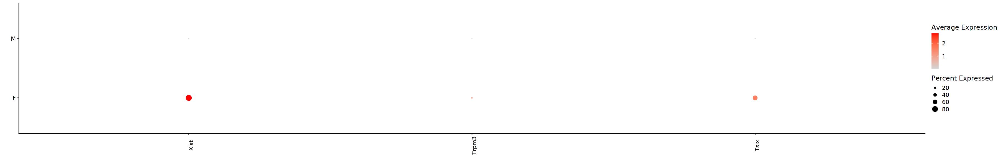

In [601]:
options(repr.plot.width=30, repr.plot.height=5)
plot <- DotPlot(tmp_sub, assay = "RNA", group.by = "Sex", scale=FALSE, cols = c("lightgrey", "red"), dot.scale = 5, features = rownames(res_top))
plot + theme(axis.text.x = element_text(angle = 90)) + labs(x = "", y= "")

In [602]:
HVGs.list[[cluster_choice]] <- rownames(res_filtered)

##### 3.2.3.4 Astro

In [603]:
cluster_choice <- "Astro"

In [604]:
table_sample_low <- table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$sample_id)[cluster_choice,][table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$sample_id)[cluster_choice,] <= 5]
table_sample_low

sample_keep <- names(timepoint_Sex_colors)[!names(timepoint_Sex_colors) %in% names(table_sample_low)]

named integer(0)

In [605]:
table_group_low <-table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$group_id)[cluster_choice,][table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$group_id)[cluster_choice,] <= 30]
table_group_low

group_keep <- names(sex_colors)[!names(sex_colors) %in% names(table_group_low)]

named integer(0)

In [606]:
cluster_metadata <- metadata[which(metadata$cluster_id == cluster_choice), ]

# Assign the rownames of the metadata to be the sample IDs
rownames(cluster_metadata) <- cluster_metadata$sample_id

In [607]:
#Remove sample and timepoint with low counts (sample<=5, timepoint<=30)
cluster_metadata <- cluster_metadata[(cluster_metadata$sample_id %in% sample_keep & cluster_metadata$group_id %in% group_keep),]

#new_sample_levels <- levels(cluster_metadata$sample_id)[levels(cluster_metadata$sample_id) %in% sample_keep]
#cluster_metadata$sample_id <- droplevels(cluster_metadata$sample_id)
#levels(cluster_metadata$sample_id) <- new_sample_levels

new_group_levels <- levels(cluster_metadata$group_id)[levels(cluster_metadata$group_id) %in% group_keep]
cluster_metadata$group_id <- droplevels(cluster_metadata$group_id)
levels(cluster_metadata$group_id) <- new_group_levels

In [608]:
cluster_metadata

,cluster_id,sample_id,group_id,debris_id
,<chr>,<chr>,<fct>,<chr>
Early1F,Astro,Early1F,F,Percoll
Early1M,Astro,Early1M,M,Percoll
Early2F,Astro,Early2F,F,Percoll
Early2M,Astro,Early2M,M,Percoll
Early4F,Astro,Early4F,F,Debris
Early4M,Astro,Early4M,M,Debris
EarlyFemale3F,Astro,EarlyFemale3F,F,Percoll
EarlyFemale5F,Astro,EarlyFemale5F,F,Debris
EarlyMale3M,Astro,EarlyMale3M,M,Percoll


In [609]:
# Subset the counts to only this cluster
counts <- pb[[cluster_choice]]

cluster_counts <- data.frame(counts[, which(colnames(counts) %in% rownames(cluster_metadata))])

# Check that all of the row names of the metadata are the same and in the same order as the column names of the counts in order to use as input to DESeq2
all(rownames(cluster_metadata) == colnames(cluster_counts))

[1] TRUE

In [610]:
dds <- DESeqDataSetFromMatrix(cluster_counts, colData = cluster_metadata, design = ~ group_id + debris_id)

converting counts to integer mode

Warning message in DESeqDataSet(se, design = design, ignoreRank):
"some variables in design formula are characters, converting to factors"


In [611]:
# Transform counts for data visualization
rld <- rlog(dds, blind=TRUE)

using ntop=500 top features by variance



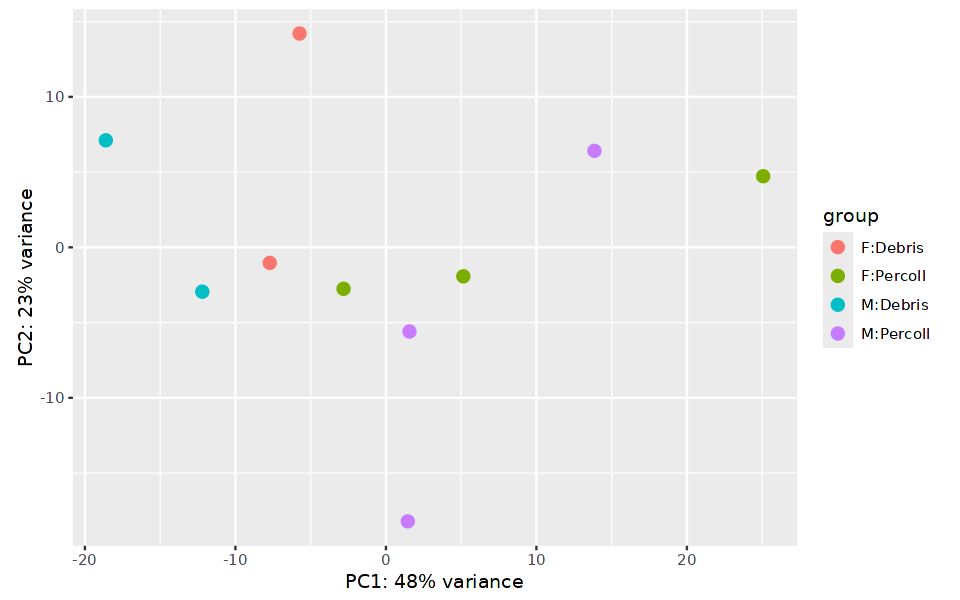

In [612]:
# Plot PCA
options(repr.plot.width=8, repr.plot.height=5)
DESeq2::plotPCA(rld, intgroup = c("group_id", "debris_id"))

In [613]:
# Extract the rlog matrix from the object and compute pairwise correlation values
rld_mat <- assay(rld)
rld_cor <- cor(rld_mat)

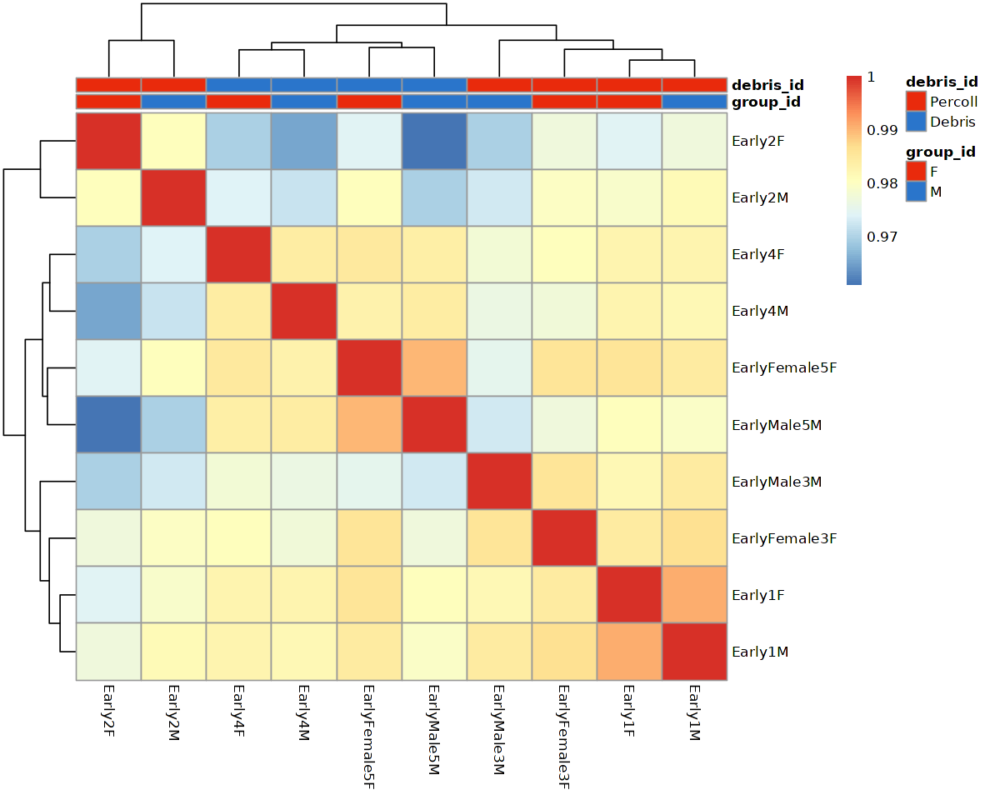

In [614]:
# Plot heatmap
options(repr.plot.width=10, repr.plot.height=8)
pheatmap(rld_cor, annotation = cluster_metadata[, c("group_id","debris_id"), drop=F], annotation_colors = list(group_id=sex_colors, debris_id=debris_colors))

In [615]:
# Run DESeq2 differential expression analysis
dds <- DESeq(dds)

estimating size factors

estimating dispersions

gene-wise dispersion estimates

mean-dispersion relationship

final dispersion estimates

fitting model and testing



In [616]:
libsize = data.frame(x=sizeFactors(dds), y=colSums(assay(dds)))

`geom_smooth()` using formula = 'y ~ x'


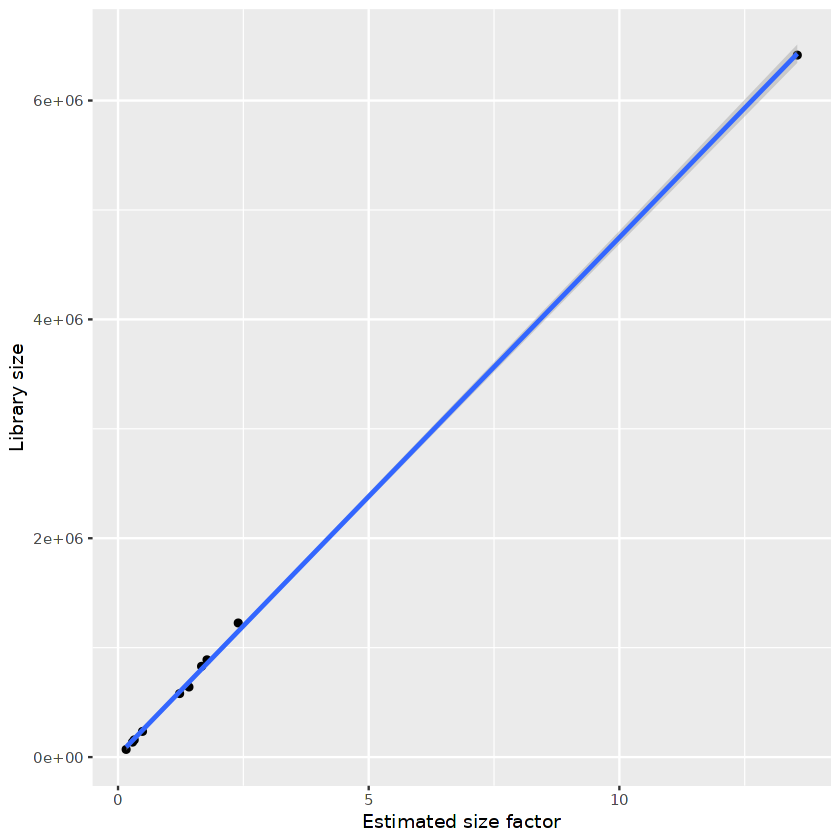

In [617]:
options(repr.plot.width=7, repr.plot.height=7)
ggplot(data=libsize, aes(x=x, y=y)) + geom_point() + geom_smooth(method="lm") + xlab("Estimated size factor") + ylab("Library size")

In [618]:
data.frame(colData(dds))

,cluster_id,sample_id,group_id,debris_id,sizeFactor
,<chr>,<chr>,<fct>,<fct>,<dbl>
Early1F,Astro,Early1F,F,Percoll,1.2291057
Early1M,Astro,Early1M,M,Percoll,1.4150757
Early2F,Astro,Early2F,F,Percoll,0.2894732
Early2M,Astro,Early2M,M,Percoll,0.1619579
Early4F,Astro,Early4F,F,Debris,0.4883572
Early4M,Astro,Early4M,M,Debris,0.3234997
EarlyFemale3F,Astro,EarlyFemale3F,F,Percoll,1.6661536
EarlyFemale5F,Astro,EarlyFemale5F,F,Debris,13.5492338
EarlyMale3M,Astro,EarlyMale3M,M,Percoll,1.7748795


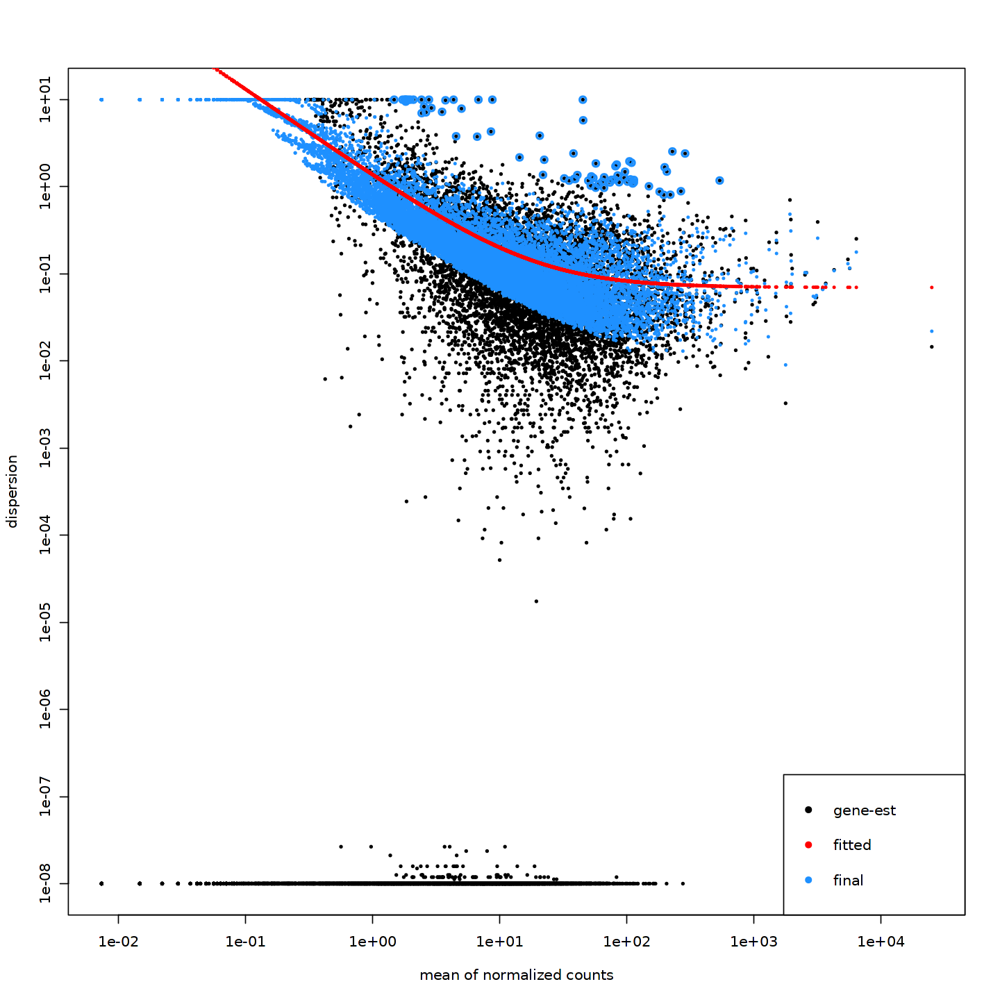

In [619]:
# Plot dispersion estimates
options(repr.plot.width=12, repr.plot.height=12)
plotDispEsts(dds)

In [620]:
condition1 = "M"
condition2 = "F"

In [621]:
contrast <- c("group_id", condition1, condition2)

# resultsNames(dds)
res <- results(dds, contrast = contrast, alpha = 0.05)

In [622]:
summary(res)


out of 14248 with nonzero total read count
adjusted p-value < 0.05
LFC > 0 (up)       : 2, 0.014%
LFC < 0 (down)     : 2, 0.014%
outliers [1]       : 5, 0.035%
low counts [2]     : 0, 0%
(mean count < 0)
[1] see 'cooksCutoff' argument of ?results
[2] see 'independentFiltering' argument of ?results



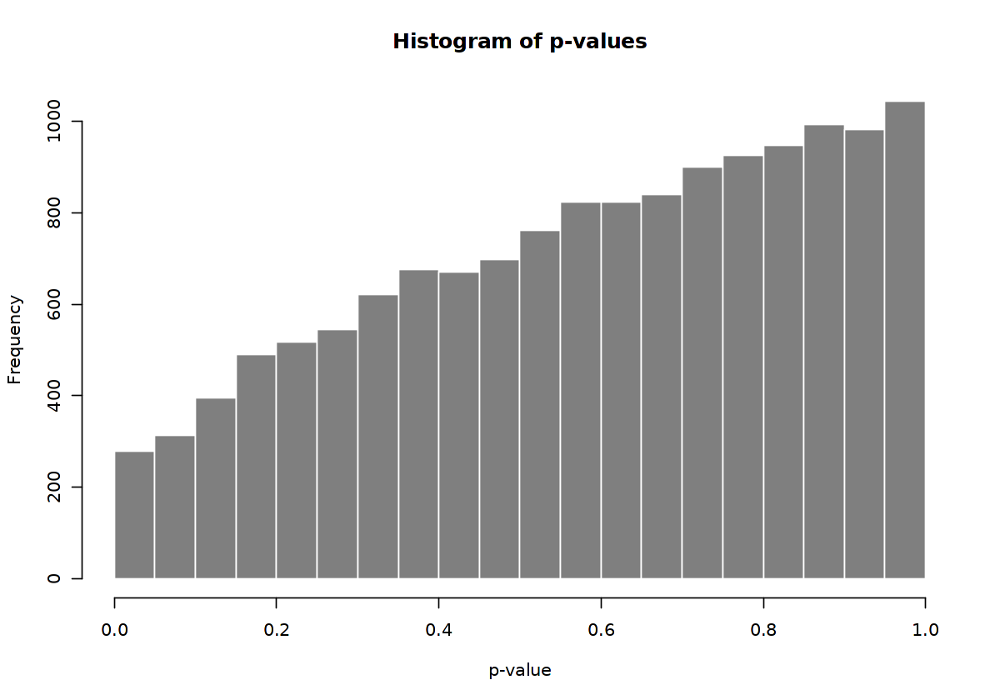

In [623]:
options(repr.plot.width=10, repr.plot.height=7)
hist(res$pvalue, breaks=0:20/20, col="grey50", border="white", xlim=c(0,1), main="Histogram of p-values", xlab="p-value")

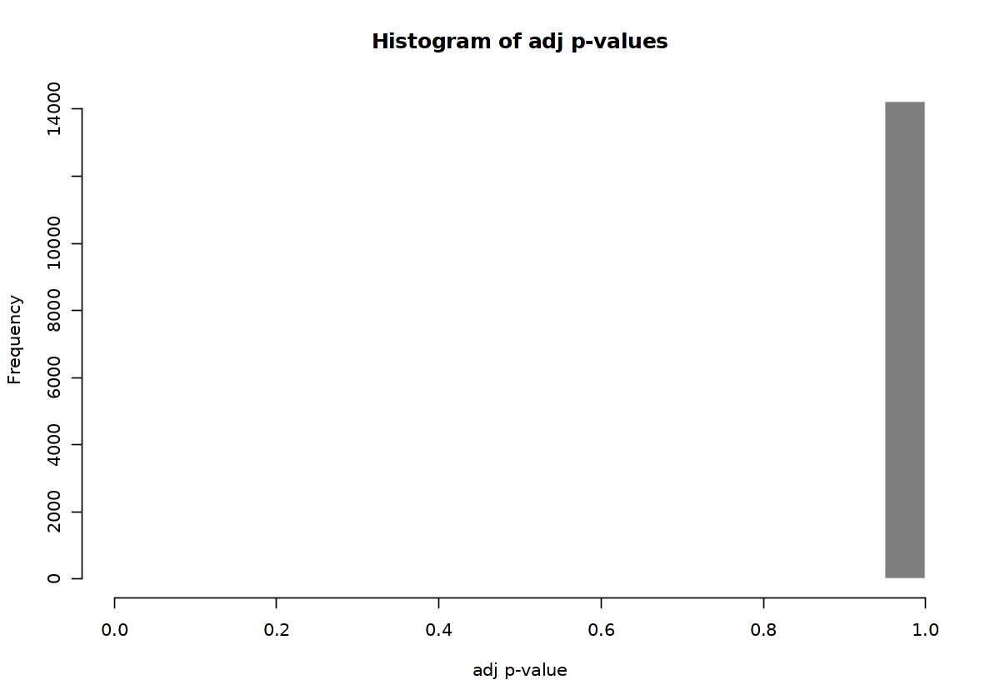

In [624]:
options(repr.plot.width=10, repr.plot.height=7)
hist(res$padj, breaks=0:20/20, col="grey50", border="white", xlim=c(0,1), main="Histogram of adj p-values", xlab="adj p-value")

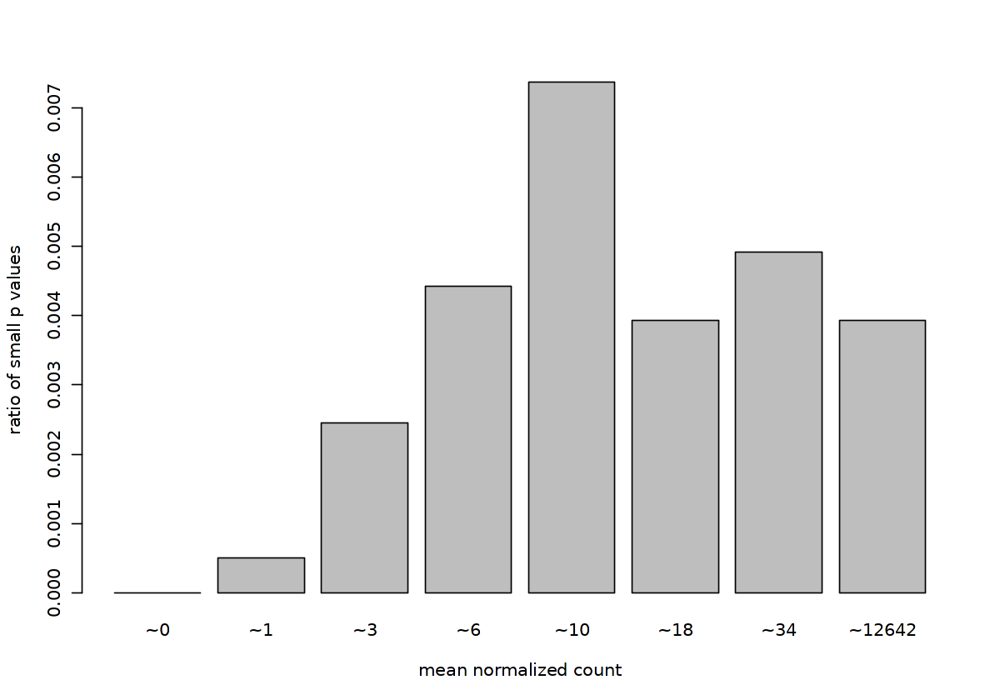

In [625]:
options(repr.plot.width=10, repr.plot.height=7)
qs <- c(0, quantile(res$baseMean[res$baseMean > 0], 0:7/7))
# cut the genes into the bins
bins <- cut(res$baseMean, qs)
# rename the levels of the bins using the middle point
levels(bins) <- paste0("~",round(.5*qs[-1] + .5*qs[-length(qs)]))
# calculate the ratio of $p$ values less than .01 for each bin
ratios <- tapply(res$pvalue, bins, function(p) mean(p < .01, na.rm=TRUE))
# plot these ratios
barplot(ratios, xlab="mean normalized count", ylab="ratio of small p values")

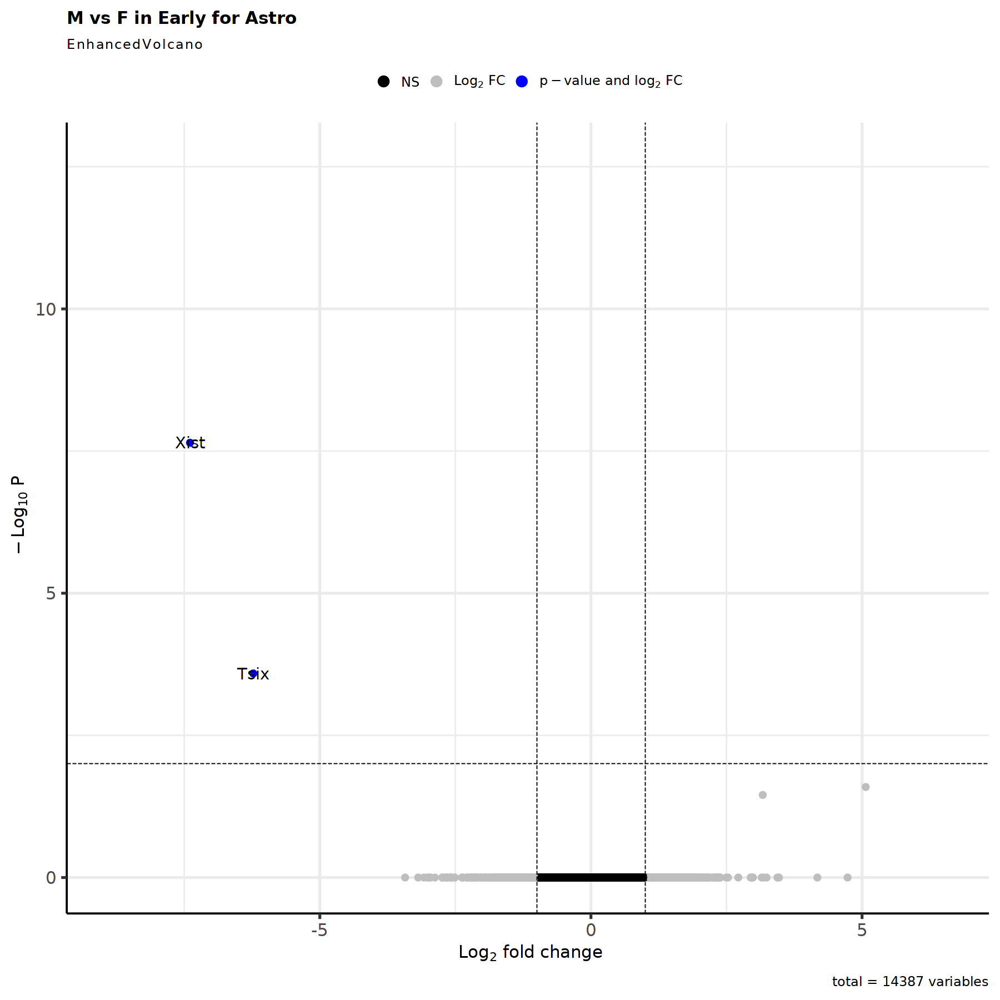

In [626]:
options(repr.plot.width=15, repr.plot.height=15)
#padj<0.001
EnhancedVolcano(res,
    lab = rownames(res),
    x = 'log2FoldChange',
    y = 'padj',
    title = paste0('M vs F in ',timepoint,' for ', cluster_choice),
    pCutoff = 0.01,
    FCcutoff = 1,
    pointSize = 3.0,
    labSize = 6.0,
    col=c('black', 'grey', 'grey', 'blue'),
    colAlpha = 1)

In [627]:
res <- res[complete.cases(res$padj),]

In [628]:
res_filtered <- res[(res$padj < 0.01 & abs(res$log2FoldChange) > 1 & res$baseMean > 1),]

In [629]:
res_filtered[order(abs(res_filtered$log2FoldChange), decreasing=TRUE),]

log2 fold change (MLE): group_id M vs F 
Wald test p-value: group id M vs F 
DataFrame with 2 rows and 6 columns
      baseMean log2FoldChange     lfcSE      stat      pvalue        padj
     <numeric>      <numeric> <numeric> <numeric>   <numeric>   <numeric>
Xist   540.473       -7.39381   1.04627  -7.06683 1.58516e-12 2.25774e-08
Tsix   107.268       -6.22637   1.13032  -5.50850 3.61895e-08 2.57724e-04

In [630]:
nrow(res_filtered)

[1] 2

In [631]:
top.genes.number <- ifelse(nrow(res_filtered)>100, 100, nrow(res_filtered))

In [632]:
res_top <- res_filtered[order(abs(res_filtered$log2FoldChange), decreasing=TRUE),][1:top.genes.number,]
res_top <- res_top[order(res_top$log2FoldChange, decreasing=FALSE),]

In [633]:
tmp_sub <- subset(tmp, subset = cellType == cluster_choice)

In [634]:
tmp_sub <- NormalizeData(tmp_sub, normalization.method = "LogNormalize", scale.factor = 10000, verbose = TRUE)

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


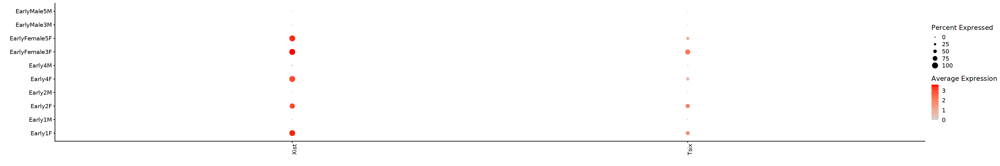

In [635]:
options(repr.plot.width=30, repr.plot.height=5)
plot <- DotPlot(tmp_sub, assay = "RNA", group.by = "orig.ident_Sex", scale=FALSE, cols = c("lightgrey", "red"), dot.scale = 5, features = rownames(res_top))
plot + theme(axis.text.x = element_text(angle = 90)) + labs(x = "", y= "")

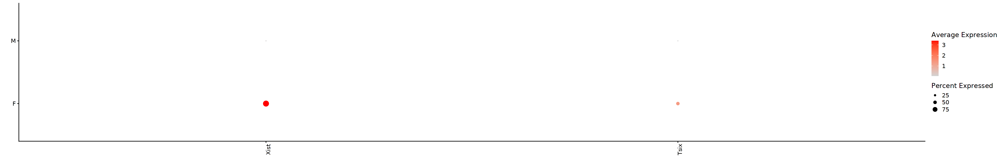

In [636]:
options(repr.plot.width=30, repr.plot.height=5)
plot <- DotPlot(tmp_sub, assay = "RNA", group.by = "Sex", scale=FALSE, cols = c("lightgrey", "red"), dot.scale = 5, features = rownames(res_top))
plot + theme(axis.text.x = element_text(angle = 90)) + labs(x = "", y= "")

In [637]:
HVGs.list[[cluster_choice]] <- rownames(res_filtered)

##### 3.2.3.5 Summary

In [638]:
listInput_upset <- HVGs.list
listInput_upset[sapply(listInput_upset, is.null)] <- NULL

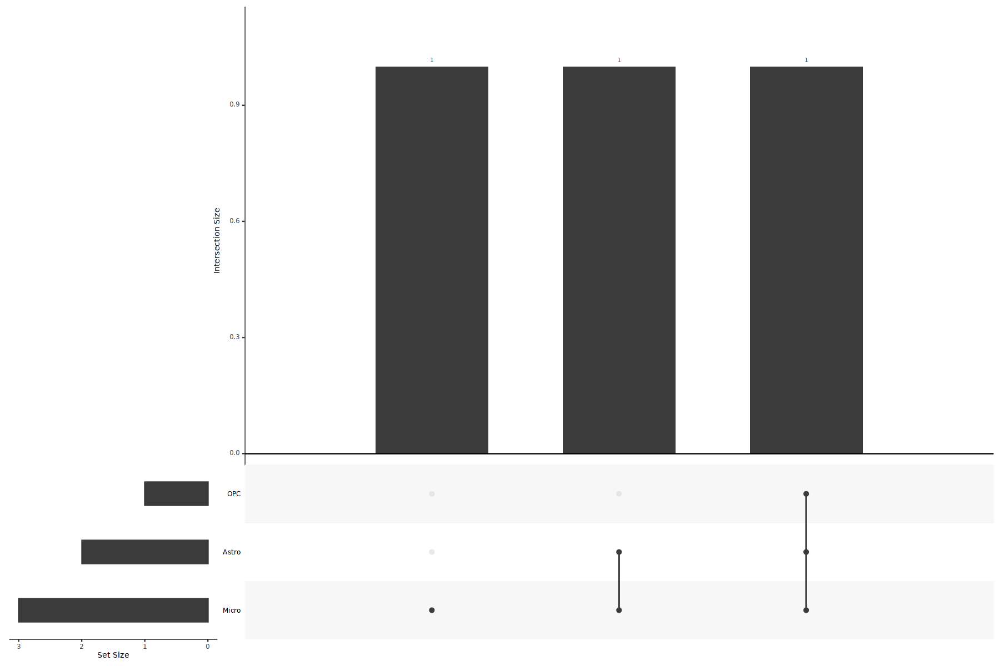

In [639]:
options(repr.plot.width=15, repr.plot.height=10)
upset(fromList(listInput_upset), order.by = "freq")

In [640]:
HVF <- unique(unlist(HVGs.list))

In [641]:
table_sample_low <- table(MORNAATACC_sce$sample_id)[table(MORNAATACC_sce$sample_id) <= 5]
table_group_low <- table(MORNAATACC_sce$group_id)[table(MORNAATACC_sce$group_id) <= 30]

In [642]:
#Remove sample with low number of cells
keepcells <- rownames(tmp@meta.data[!tmp$orig.ident %in% (names(table_sample_low)),])
tmp <- subset(tmp, cells=keepcells)

In [643]:
#Remove timepoint with low number of cells
keepcells <- rownames(tmp@meta.data[!tmp$orig.ident_Sex %in% (names(table_group_low)),])
tmp <- subset(tmp, cells=keepcells)

In [644]:
tmp <- NormalizeData(tmp, normalization.method = "LogNormalize", scale.factor = 10000, verbose = TRUE)

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


In [645]:
tmp <- ScaleData(tmp, features=rownames(tmp))

Centering and scaling data matrix

  |==========================================================================================| 100%


In [646]:
sub_timepoint_Sex_colors <- timepoint_Sex_colors[names(timepoint_Sex_colors) %in% names(table(tmp$orig.ident_Sex))]

In [647]:
tmp$orig.ident <- factor(x = tmp$orig.ident, levels = name_timepoint[!name_timepoint %in% names(table_sample_low)])
tmp$orig.ident_Sex <- factor(x = tmp$orig.ident_Sex, levels = names(sub_timepoint_Sex_colors)[!names(sub_timepoint_Sex_colors) %in% names(table_group_low)])

In [648]:
Idents(object = tmp) <- "orig.ident_Sex"

Warning message:
"CombinePlots is being deprecated. Plots should now be combined using the patchwork system."


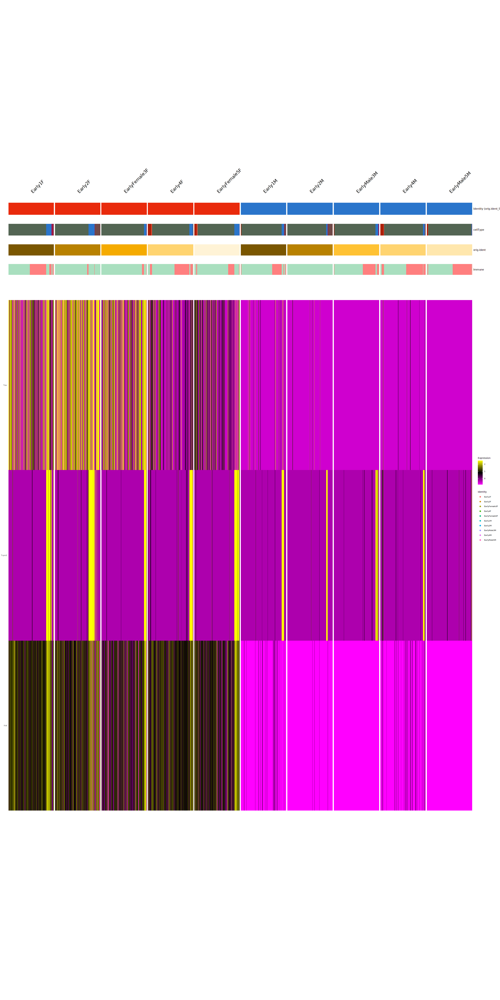

In [649]:
options(repr.plot.width=25, repr.plot.height=50)
DoMultiBarHeatmap(
    subset(tmp, downsample = 200),
    features = HVF,
    cells = NULL,
    group.by = "orig.ident_Sex",
    additional.group.by = c("cellType", "orig.ident", "Immune"),
    additional.group.sort.by = c("cellType", "orig.ident", "Immune"),
    cols.use = list(orig.ident_Sex=sub_timepoint_Sex_colors, cellType=cellType_colors, orig.ident=orig.ident_colors, Immune=immune_colors),
    group.bar = TRUE,
    disp.min = -2.5,
    disp.max = NULL,
    layer = "scale.data",
    assay = "RNA",
    label = TRUE,
    size = 5.5,
    hjust = 0,
    angle = 45,
    raster = TRUE,
    draw.lines = TRUE,
    lines.width = NULL,
    group.bar.height = 0.02,
    combine = TRUE
    ) + theme(text = element_text(size = 8))

In [650]:
sample_names <- levels(tmp$orig.ident_Sex)

In [651]:
gene_list <- HVF

In [652]:
tmp_markers <- as.data.frame(AggregateExpression(tmp, assays = "RNA", group.by = "orig.ident_Sex", normalization.method = "LogNormalize", scale.factor = 10000, return.seurat = TRUE)[["RNA"]]$data[gene_list,])

Centering and scaling data matrix

  |==========================================================================================| 100%
  |==========================================================================================| 100%


In [653]:
matrix <- tmp_markers/do.call(pmax, tmp_markers)

In [654]:
paletteLength <- 50
myColor <- colorRampPalette(c("#FFFFB3", "#5E3719"))(paletteLength/2)
myBreaks <- c(seq(0, max(matrix), length.out=floor(paletteLength/2)))

In [655]:
plot_height <- ifelse(as.integer(nrow(matrix)/20)<=5, 5, as.integer(nrow(matrix)/20))

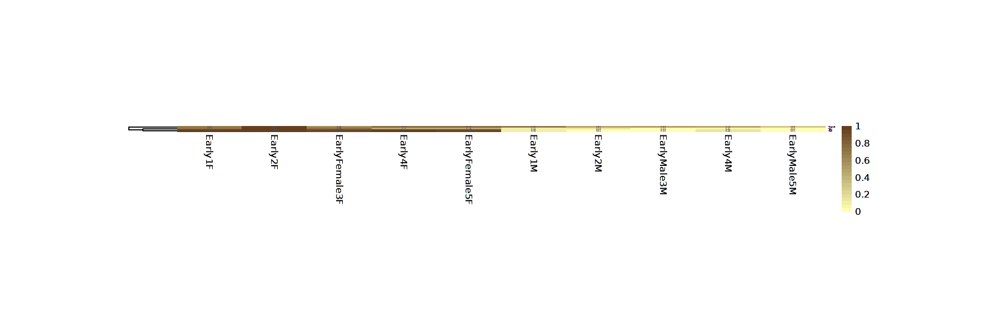

In [656]:
options(repr.plot.width=15, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = T, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=TRUE)
ph

In [657]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "DGE_Sex_sep_",timepoint,"_pseudobulk.pdf"), width=15, height=plot_height)

png 
  2

In [658]:
gene_list <- gene_list[ph$tree_row$order]

In [659]:
tmp_markers_mean <- data.frame(matrix(0L, ncol=1, nrow=length(gene_list), dimnames=list(gene_list, "Mean_Log2Exp")))

In [660]:
tmp_markers_mean[rownames(tmp_markers),"Mean_Log2Exp"] <- rowMeans(tmp_markers)

In [661]:
matrix <- tmp_markers_mean

In [662]:
paletteLength <- 50
myColor <- colorRampPalette(c("white", "black"))(paletteLength/2)
myBreaks <- c(seq(0, max(matrix), length.out=floor(paletteLength/2)))

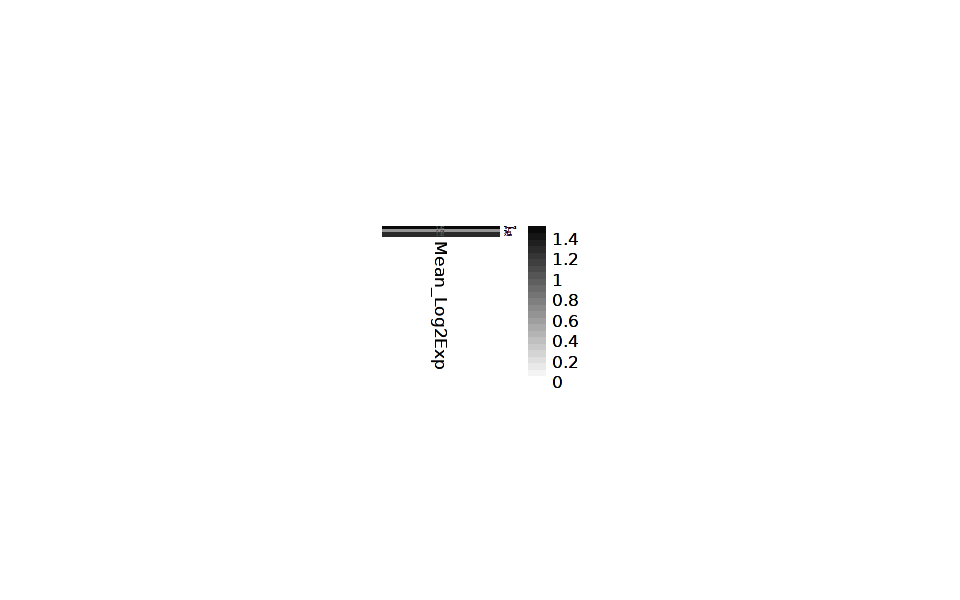

In [663]:
options(repr.plot.width=8, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = T, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=FALSE)
ph

In [664]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "DGE_Sex_sep_",timepoint,"_pseudobulk_mean.pdf"), width=8, height=plot_height)

png 
  2

In [665]:
tmp_markers_zscore <- t(apply(tmp_markers[gene_list,], 1, scale))
colnames(tmp_markers_zscore) <- paste0("zscore_", names(sub_timepoint_Sex_colors))
matrix <- tmp_markers_zscore

In [666]:
paletteLength <- 50
myColor <- colorRampPalette(c("blue", "white", "red"))(paletteLength/2)
myBreaks <- c(seq(min(matrix), max(matrix), length.out=floor(paletteLength/2)))

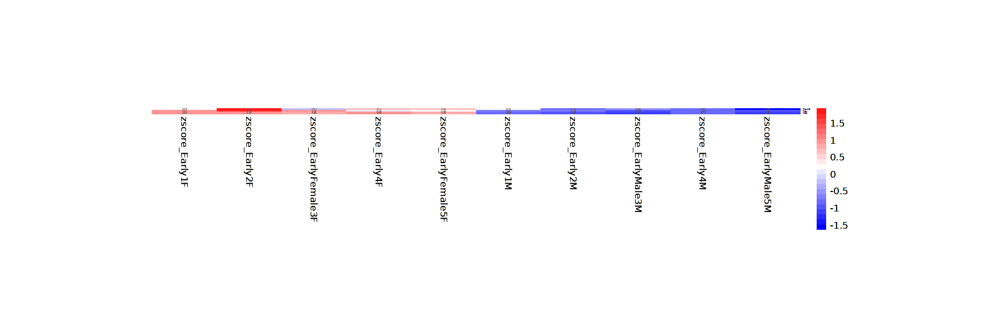

In [667]:
options(repr.plot.width=15, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = T, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=FALSE)
ph

In [668]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "DGE_Sex_sep_",timepoint,"_pseudobulk_zscore.pdf"), width=15, height=plot_height)

png 
  2

In [669]:
gene_list <- HVF

In [670]:
tmp_markers <- as.data.frame(AggregateExpression(tmp, assays = "RNA", group.by = "Sex", normalization.method = "LogNormalize", scale.factor = 10000, return.seurat = TRUE)[["RNA"]]$data[gene_list,])

Centering and scaling data matrix

  |==========================================================================================| 100%
  |==========================================================================================| 100%


In [671]:
matrix <- tmp_markers/do.call(pmax, tmp_markers)

In [672]:
paletteLength <- 50
myColor <- colorRampPalette(c("#FFFFB3", "#5E3719"))(paletteLength/2)
myBreaks <- c(seq(0, max(matrix), length.out=floor(paletteLength/2)))

In [673]:
plot_height <- ifelse(as.integer(nrow(matrix)/20) < 5, 5, as.integer(nrow(matrix)/20))

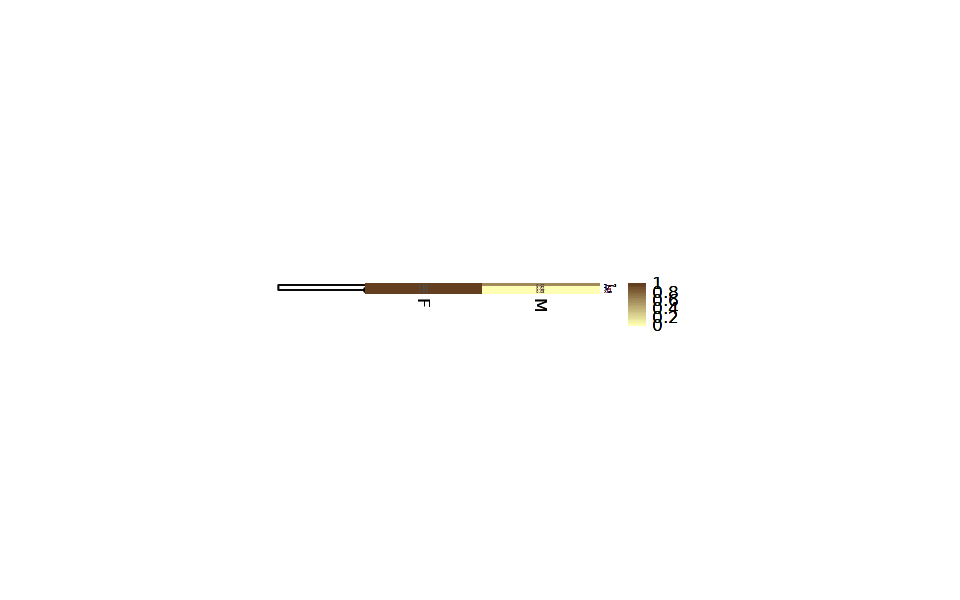

In [674]:
options(repr.plot.width=8, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = T, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=TRUE)
ph

In [675]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "DGE_Sex_",timepoint,"_pseudobulk.pdf"), width=8, height=plot_height)

png 
  2

In [676]:
gene_list <- gene_list[ph$tree_row$order]

In [677]:
tmp_markers_mean <- data.frame(matrix(0L, ncol=1, nrow=length(gene_list), dimnames=list(gene_list, "Mean_Log2Exp")))

In [678]:
tmp_markers_mean[rownames(tmp_markers),"Mean_Log2Exp"] <- rowMeans(tmp_markers)

In [679]:
matrix <- tmp_markers_mean

In [680]:
paletteLength <- 50
myColor <- colorRampPalette(c("white", "black"))(paletteLength/2)
myBreaks <- c(seq(0, max(matrix), length.out=floor(paletteLength/2)))

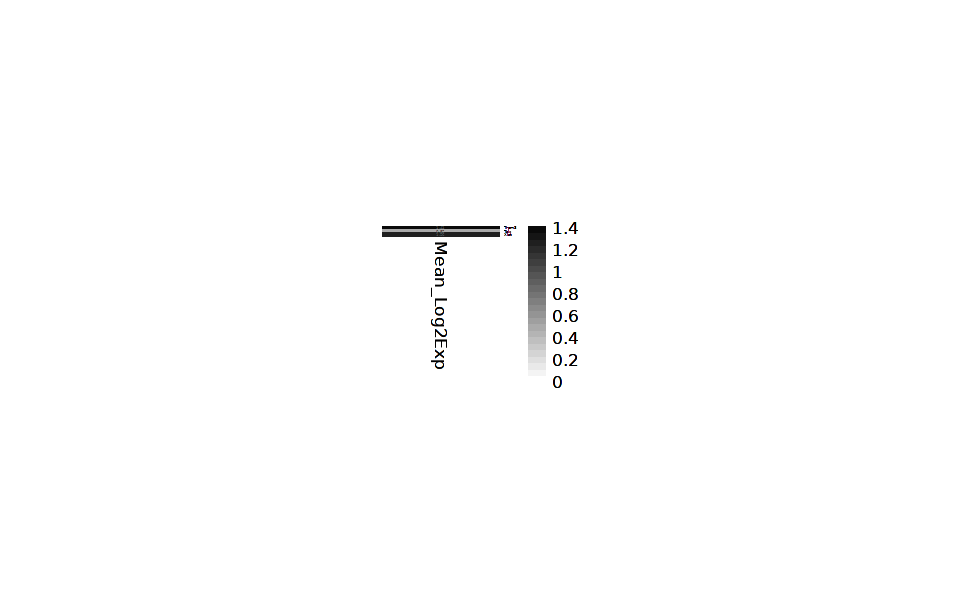

In [681]:
options(repr.plot.width=8, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = T, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=FALSE)
ph

In [682]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "DGE_Sex_",timepoint,"_pseudobulk_mean.pdf"), width=8, height=plot_height)

png 
  2

In [683]:
tmp_markers_zscore <- t(apply(tmp_markers[gene_list,], 1, scale))
colnames(tmp_markers_zscore) <- paste0("zscore_", names(sex_colors))
matrix <- tmp_markers_zscore

In [684]:
paletteLength <- 50
myColor <- colorRampPalette(c("blue", "white", "red"))(paletteLength/2)
myBreaks <- c(seq(min(matrix), max(matrix), length.out=floor(paletteLength/2)))

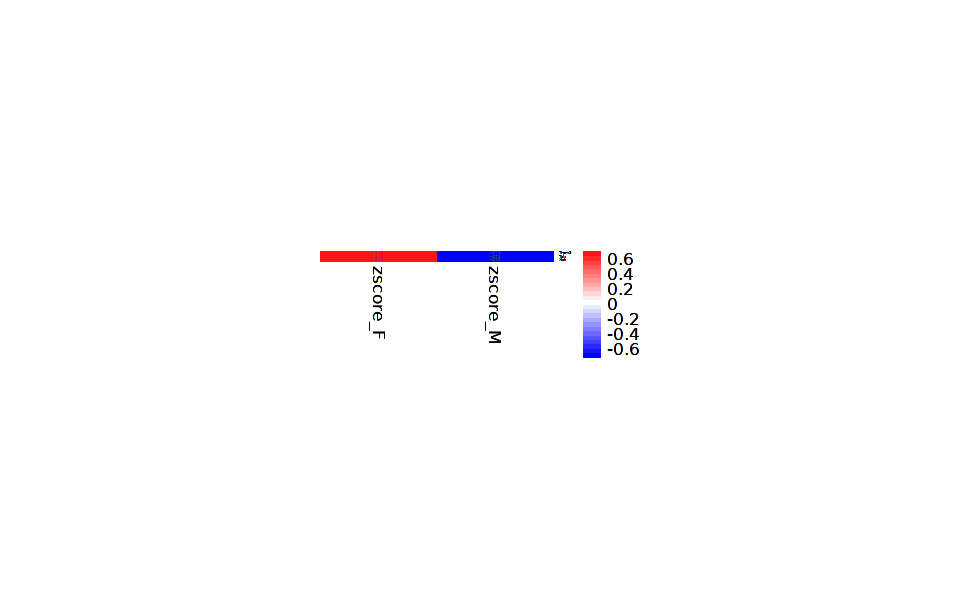

In [685]:
options(repr.plot.width=8, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = T, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=FALSE)
ph

In [686]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "DGE_Sex_",timepoint,"_pseudobulk_zscore.pdf"), width=8, height=plot_height)

png 
  2

#### 3.2.4 Peak

In [687]:
timepoint <- "Peak"
name_timepoint <- names_Peak

In [688]:
tmp <- subset(MORNAATACC, subset = orig.ident_merge == timepoint)

In [689]:
tmp <- NormalizeData(tmp, normalization.method = "LogNormalize", scale.factor = 10000, verbose = TRUE)

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


In [690]:
tmp <- ScaleData(tmp, features=rownames(tmp))

Centering and scaling data matrix

  |==========================================================================================| 100%


In [691]:
timepoint_Sex_colors <- c(rep(sex_colors["F"], length(name_timepoint)),rep(sex_colors["M"], length(name_timepoint)))
df_timepoint_Sex <- expand.grid(name_timepoint, names(sex_colors))
names(timepoint_Sex_colors) <- paste0(df_timepoint_Sex[,1],df_timepoint_Sex[,2])

In [692]:
tmp$orig.ident_Sex <- paste0(tmp$orig.ident,tmp$Sex)
tmp$orig.ident_Sex <- factor(paste0(tmp$orig.ident,tmp$Sex), levels=names(table(tmp$orig.ident_Sex)))

In [693]:
tmp$orig.ident <- factor(tmp$orig.ident, levels=name_timepoint)
tmp$cellType <- factor(tmp$cellType, levels=names(cellType_colors))
tmp$Sex <- factor(tmp$Sex, levels=names(sex_colors))

In [694]:
table(tmp$cellType, tmp$orig.ident_Sex)

        
         Peak2F Peak2M Peak3F Peak3M Peak5F Peak5M PeakFemale4F PeakMale4M
  OPC        13      8     21     11    112    225          103        187
  COP         0      1      2      0      5      7           18         90
  MOL       572    879   1629   1420    968   2384         3609       2984
  Astro       1     14      5      2      0      2            9          5
  Epen       12     17     47     36      2      2           29         43
  Micro     201     36    428    120    187    192           70         91
  Neuron      3      5      2      2      2      1            0          0

In [695]:
table(tmp$cellType, tmp$Sex)

        
            F    M
  OPC     249  431
  COP      25   98
  MOL    6778 7667
  Astro    15   23
  Epen     90   98
  Micro   886  439
  Neuron    7    8

In [696]:
table(tmp$orig.ident_Sex, tmp$Sex)

              
                  F    M
  Peak2F        802    0
  Peak2M          0  960
  Peak3F       2134    0
  Peak3M          0 1591
  Peak5F       1276    0
  Peak5M          0 2813
  PeakFemale4F 3838    0
  PeakMale4M      0 3400

In [697]:
MORNAATACC_sce <- as.SingleCellExperiment(tmp, assay="RNA")

In [698]:
MORNAATACC_sce <- prepSCE(MORNAATACC_sce, kid = "cellType", gid = "Sex", sid = "orig.ident_Sex", drop = FALSE)

In [699]:
kids <- purrr::set_names(levels(MORNAATACC_sce$cluster_id))

# Total number of clusters
nk <- length(kids)

# Named vector of sample names
sids <- purrr::set_names(levels(MORNAATACC_sce$sample_id))

# Total number of samples 
ns <- length(sids)

In [700]:
kids
sids

OPC      COP      MOL    Astro     Epen    Micro   Neuron 
   "OPC"    "COP"    "MOL"  "Astro"   "Epen"  "Micro" "Neuron"

Peak2F         Peak2M         Peak3F         Peak3M         Peak5F         Peak5M 
      "Peak2F"       "Peak2M"       "Peak3F"       "Peak3M"       "Peak5F"       "Peak5M" 
  PeakFemale4F     PeakMale4M 
"PeakFemale4F"   "PeakMale4M"

In [701]:
## Determine the number of cells per sample
table(MORNAATACC_sce$sample_id)

## Turn named vector into a numeric vector of number of cells per sample
n_cells <- as.numeric(table(MORNAATACC_sce$sample_id))

## Determine how to reoder the samples (rows) of the metadata to match the order of sample names in sids vector
m <- match(sids, MORNAATACC_sce$sample_id)

## Create the sample level metadata by combining the reordered metadata with the number of cells corresponding to each sample.
ei <- data.frame(colData(MORNAATACC_sce)[m, ], n_cells, row.names = NULL) %>% select(-"cluster_id")
ei


      Peak2F       Peak2M       Peak3F       Peak3M       Peak5F       Peak5M PeakFemale4F 
         802          960         2134         1591         1276         2813         3838 
  PeakMale4M 
        3400 

sample_id,group_id,orig.ident,nCount_RAW,nFeature_RAW,nCount_RNA,nFeature_RNA,nCount_ATAC,nFeature_ATAC,orig.ident_merge,batch,model,debrisRemoval,date_tissue_collection,date_experiment,nbMouse,EAE_score_mean,frequency_count,mononucleosomal,nucleosome_free,reads_count,percent.mt,log10GenesUMI,mitoRatio,S.Score,G2M.Score,Phase,CC.Difference,nucleosome_signal,nucleosome_percentile,TSS.enrichment,TSS.percentile,nCount_peaks,nFeature_peaks,FRiP,nCount_GenePromAcc,nFeature_GenePromAcc,pANN,DF.classifications,pct_chrY,pct_chrX,Xist_score,Sex_predictions,Sex_predictions_F,Sex_predictions_M,snn_RNA_res.1,seurat_clusters_RNA,snn_peaks_res.0.4,seurat_clusters_peaks,RNA.weight,⋯,pvalue_Naive.Tcell_cd8,Immune.Tcell_cd8,ImmuneScoreGenePromAcc,ImmuneScoreScaledGenePromAcc,zscore_NaiveGenePromAcc,pvalue_NaiveGenePromAcc,ImmuneGenePromAcc,ImmuneScoreGenePromAcc.complement,ImmuneScoreScaledGenePromAcc.complement,zscore_NaiveGenePromAcc.complement,pvalue_NaiveGenePromAcc.complement,ImmuneGenePromAcc.complement,ImmuneScoreGenePromAcc.pos_reg_imm_response,ImmuneScoreScaledGenePromAcc.pos_reg_imm_response,zscore_NaiveGenePromAcc.pos_reg_imm_response,pvalue_NaiveGenePromAcc.pos_reg_imm_response,ImmuneGenePromAcc.pos_reg_imm_response,ImmuneScoreGenePromAcc.neg_reg_imm_response,ImmuneScoreScaledGenePromAcc.neg_reg_imm_response,zscore_NaiveGenePromAcc.neg_reg_imm_response,pvalue_NaiveGenePromAcc.neg_reg_imm_response,ImmuneGenePromAcc.neg_reg_imm_response,ImmuneScoreGenePromAcc.antig_proc_presen,ImmuneScoreScaledGenePromAcc.antig_proc_presen,zscore_NaiveGenePromAcc.antig_proc_presen,pvalue_NaiveGenePromAcc.antig_proc_presen,ImmuneGenePromAcc.antig_proc_presen,ImmuneScoreGenePromAcc.pos_reg_int_media,ImmuneScoreScaledGenePromAcc.pos_reg_int_media,zscore_NaiveGenePromAcc.pos_reg_int_media,pvalue_NaiveGenePromAcc.pos_reg_int_media,ImmuneGenePromAcc.pos_reg_int_media,ImmuneScoreGenePromAcc.reg_cyto_prod,ImmuneScoreScaledGenePromAcc.reg_cyto_prod,zscore_NaiveGenePromAcc.reg_cyto_prod,pvalue_NaiveGenePromAcc.reg_cyto_prod,ImmuneGenePromAcc.reg_cyto_prod,ImmuneScoreGenePromAcc.Tcell_cd4,ImmuneScoreScaledGenePromAcc.Tcell_cd4,zscore_NaiveGenePromAcc.Tcell_cd4,pvalue_NaiveGenePromAcc.Tcell_cd4,ImmuneGenePromAcc.Tcell_cd4,ImmuneScoreGenePromAcc.Tcell_cd8,ImmuneScoreScaledGenePromAcc.Tcell_cd8,zscore_NaiveGenePromAcc.Tcell_cd8,pvalue_NaiveGenePromAcc.Tcell_cd8,ImmuneGenePromAcc.Tcell_cd8,ImmuneAll,ident,n_cells
<fct>,<fct>,<fct>,<dbl>,<int>,<dbl>,<int>,<dbl>,<int>,<fct>,<fct>,<fct>,<fct>,<fct>,<fct>,<chr>,<fct>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<int>,<dbl>,<dbl>,<int>,<dbl>,<chr>,<dbl>,<dbl>,<dbl>,<chr>,<dbl>,<dbl>,<fct>,<fct>,<fct>,<fct>,<dbl>,⋯,<dbl>,<fct>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<chr>,<fct>,<dbl>
Peak2F,F,Peak2,15720,4240,15699,4238,40509,15544,Peak,B1,EAE,Percoll,2021_05_03,2021_04_20,2,3,31092,11671,13372,117872,5.529015,0.8644594,0.05529015,-0.045481050,0.127928906,G2M,-0.173409956,0.8672652,0.88,6.102601,0.24,22463,14725,0.7224688,25945,9430,0.50000000,Singlet,0.0000000000,0.04414294,7.355,F,1.0000,0.0000,1,1,3,3,0.63167154,⋯,0.61731681,NonImmune,0.02619229,0.6318589,1.7389142,0.041024925,Immune,0.001932374,0.3802910,0.5634975,0.28654806,NonImmune,-0.0190835932,0.3998010,0.03165969,0.4873717,NonImmune,-0.043622477,0.2996954,-0.83426104,0.7979330,NonImmune,0.02914683,0.5017669,1.910684,0.028022596,Immune,0.05183927,0.5420597,2.4973448,6.256362e-03,Immune,-0.016804423,0.3028048,-0.0764829,0.53048254,NonImmune,0.044055458,0.4125380,1.0080379,0.1567181,NonImmune,0.040245006,0.4099646,0.7324957,0.23193303,NonImmune,Both,F,802
Peak2M,M,Peak2,8470,3002,8448,2996,34391,13654,Peak,B1,EAE,Percoll,2021_05_03,2021_04_20,2,3,25059,8437,12671,99085,4.237689,0.8853475,

In [702]:
## Remove lowly accessible features which have less than 10 cells with any counts
MORNAATACC_sce <- MORNAATACC_sce[rowSums(counts(MORNAATACC_sce) > 1) >= 10, ]

In [703]:
# Aggregate the counts per sample_id and cluster_id

# Subset metadata to only include the cluster and sample IDs to aggregate across
groups <- colData(MORNAATACC_sce)[, c("cluster_id", "sample_id")]

# Aggregate across cluster-sample groups
pb <- aggregate.Matrix(t(counts(MORNAATACC_sce)), groupings = groups, fun = "sum") 

In [704]:
splitf <- sapply(stringr::str_split(rownames(pb), pattern = "_", n = 2), `[`, 1)

In [705]:
pb <- split.data.frame(pb, factor(splitf)) %>% lapply(function(u) set_colnames(t(u), stringr::str_extract(rownames(u), "(?<=_)[:alnum:]+")))

class(pb)

# Explore the different components of list
str(pb)

[1] "list"

List of 7
 $ Astro :Formal class 'dgCMatrix' [package "Matrix"] with 6 slots
  .. ..@ i       : int [1:33072] 41 46 97 154 193 430 483 511 516 517 ...
  .. ..@ p       : int [1:8] 0 686 9183 13098 14761 18663 25564 33072
  .. ..@ Dim     : int [1:2] 14226 7
  .. ..@ Dimnames:List of 2
  .. .. ..$ : chr [1:14226] "0610009B22Rik" "0610009E02Rik" "0610009L18Rik" "0610010F05Rik" ...
  .. .. ..$ : chr [1:7] "Peak2F" "Peak2M" "Peak3F" "Peak3M" ...
  .. ..@ x       : num [1:33072] 1 1 1 1 1 1 1 1 30 1 ...
  .. ..@ factors : list()
 $ COP   :Formal class 'dgCMatrix' [package "Matrix"] with 6 slots
  .. ..@ i       : int [1:48214] 3 7 12 24 25 26 37 58 59 100 ...
  .. ..@ p       : int [1:7] 0 3316 7432 15958 25147 35306 48214
  .. ..@ Dim     : int [1:2] 14226 6
  .. ..@ Dimnames:List of 2
  .. .. ..$ : chr [1:14226] "0610009B22Rik" "0610009E02Rik" "0610009L18Rik" "0610010F05Rik" ...
  .. .. ..$ : chr [1:6] "Peak2M" "Peak3F" "Peak5F" "Peak5M" ...
  .. ..@ x       : num [1:48214] 2 1 1 2 1 1 1 

In [706]:
options(width = 100)
table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$group_id)

        
            F    M
  OPC     249  431
  COP      25   98
  MOL    6778 7667
  Astro    15   23
  Epen     90   98
  Micro   886  439
  Neuron    7    8

In [707]:
options(width = 100)
table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$sample_id)

        
         Peak2F Peak2M Peak3F Peak3M Peak5F Peak5M PeakFemale4F PeakMale4M
  OPC        13      8     21     11    112    225          103        187
  COP         0      1      2      0      5      7           18         90
  MOL       572    879   1629   1420    968   2384         3609       2984
  Astro       1     14      5      2      0      2            9          5
  Epen       12     17     47     36      2      2           29         43
  Micro     201     36    428    120    187    192           70         91
  Neuron      3      5      2      2      2      1            0          0

In [708]:
# Get sample names for each of the cell type clusters

# prep. data.frame for plotting
get_sample_ids <- function(x){pb[[x]] %>% colnames()}

de_samples <- purrr::map(1:length(kids), get_sample_ids) %>% unlist()

In [709]:
samples_list <- purrr::map(1:length(kids), get_sample_ids)

get_cluster_ids <- function(x){rep(names(pb)[x],each = length(samples_list[[x]]))}

de_cluster_ids <- purrr::map(1:length(kids), get_cluster_ids) %>% unlist()

In [710]:
combinaison_debris_sample <- unique(paste(colData(MORNAATACC_sce)$sample_id, colData(MORNAATACC_sce)$debrisRemoval, sep="_"))

In [711]:
de_debris_ids <- mapvalues(de_samples, 
from=unlist(lapply(strsplit(combinaison_debris_sample, "_"), function(x){x[1]})),
to=unlist(lapply(strsplit(combinaison_debris_sample, "_"), function(x){x[2]})))

In [712]:
gg_df <- data.frame(cluster_id = de_cluster_ids, sample_id = de_samples, debris_id=de_debris_ids)

gg_df <- left_join(gg_df, ei[, c("sample_id", "group_id")]) 

metadata <- gg_df %>% dplyr::select(cluster_id, sample_id, group_id, debris_id) 

Joining with `by = join_by(sample_id)`


In [713]:
levels(metadata$cluster_id) <- unique(metadata$cluster_id)

In [714]:
# Generate vector of cluster IDs
clusters <- levels(metadata$cluster_id)
clusters

[1] "Astro"  "COP"    "Epen"   "MOL"    "Micro"  "Neuron" "OPC"

In [715]:
HVGs.list <- list()

##### 3.2.4.1 MOL

In [716]:
cluster_choice <- "MOL"

In [717]:
table_sample_low <- table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$sample_id)[cluster_choice,][table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$sample_id)[cluster_choice,] <= 5]
table_sample_low

sample_keep <- names(timepoint_Sex_colors)[!names(timepoint_Sex_colors) %in% names(table_sample_low)]

named integer(0)

In [718]:
table_group_low <-table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$group_id)[cluster_choice,][table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$group_id)[cluster_choice,] <= 30]
table_group_low

group_keep <- names(sex_colors)[!names(sex_colors) %in% names(table_group_low)]

named integer(0)

In [719]:
cluster_metadata <- metadata[which(metadata$cluster_id == cluster_choice), ]

# Assign the rownames of the metadata to be the sample IDs
rownames(cluster_metadata) <- cluster_metadata$sample_id

In [720]:
#Remove sample and timepoint with low counts (sample<=5, timepoint<=30)
cluster_metadata <- cluster_metadata[(cluster_metadata$sample_id %in% sample_keep & cluster_metadata$group_id %in% group_keep),]

#new_sample_levels <- levels(cluster_metadata$sample_id)[levels(cluster_metadata$sample_id) %in% sample_keep]
#cluster_metadata$sample_id <- droplevels(cluster_metadata$sample_id)
#levels(cluster_metadata$sample_id) <- new_sample_levels

new_group_levels <- levels(cluster_metadata$group_id)[levels(cluster_metadata$group_id) %in% group_keep]
cluster_metadata$group_id <- droplevels(cluster_metadata$group_id)
levels(cluster_metadata$group_id) <- new_group_levels

In [721]:
cluster_metadata

,cluster_id,sample_id,group_id,debris_id
,<chr>,<chr>,<fct>,<chr>
Peak2F,MOL,Peak2F,F,Percoll
Peak2M,MOL,Peak2M,M,Percoll
Peak3F,MOL,Peak3F,F,Percoll
Peak3M,MOL,Peak3M,M,Percoll
Peak5F,MOL,Peak5F,F,Debris
Peak5M,MOL,Peak5M,M,Debris
PeakFemale4F,MOL,PeakFemale4F,F,Debris
PeakMale4M,MOL,PeakMale4M,M,Debris


In [722]:
# Subset the counts to only this cluster
counts <- pb[[cluster_choice]]

cluster_counts <- data.frame(counts[, which(colnames(counts) %in% rownames(cluster_metadata))])

# Check that all of the row names of the metadata are the same and in the same order as the column names of the counts in order to use as input to DESeq2
all(rownames(cluster_metadata) == colnames(cluster_counts))

[1] TRUE

In [723]:
dds <- DESeqDataSetFromMatrix(cluster_counts, colData = cluster_metadata, design = ~ group_id + debris_id)

converting counts to integer mode

Warning message in DESeqDataSet(se, design = design, ignoreRank):
"some variables in design formula are characters, converting to factors"


In [724]:
# Transform counts for data visualization
rld <- rlog(dds, blind=TRUE)

using ntop=500 top features by variance



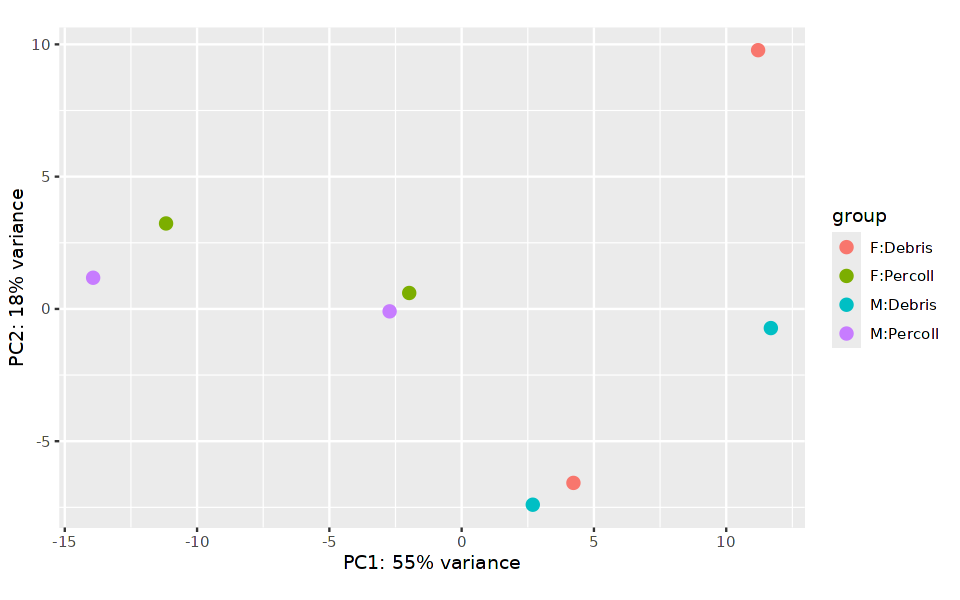

In [725]:
# Plot PCA
options(repr.plot.width=8, repr.plot.height=5)
DESeq2::plotPCA(rld, intgroup = c("group_id", "debris_id"))

In [726]:
# Extract the rlog matrix from the object and compute pairwise correlation values
rld_mat <- assay(rld)
rld_cor <- cor(rld_mat)

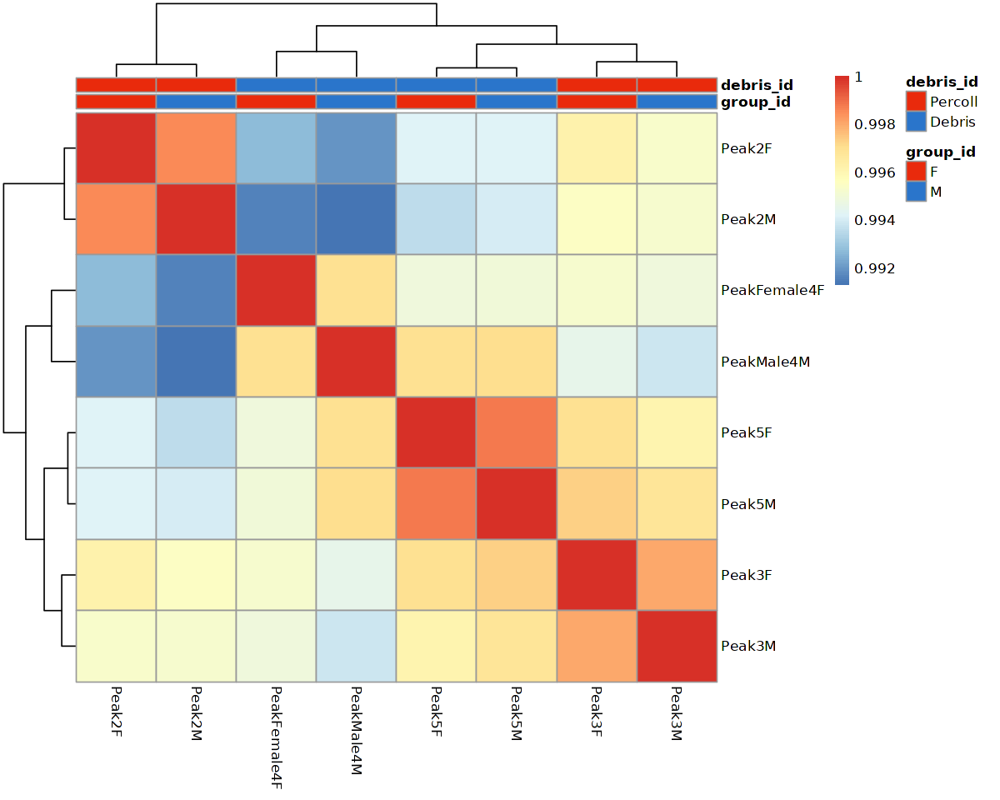

In [727]:
# Plot heatmap
options(repr.plot.width=10, repr.plot.height=8)
pheatmap(rld_cor, annotation = cluster_metadata[, c("group_id","debris_id"), drop=F], annotation_colors = list(group_id=sex_colors, debris_id=debris_colors))

In [728]:
# Run DESeq2 differential expression analysis
dds <- DESeq(dds)

estimating size factors

estimating dispersions

gene-wise dispersion estimates

mean-dispersion relationship

final dispersion estimates

fitting model and testing



In [729]:
libsize = data.frame(x=sizeFactors(dds), y=colSums(assay(dds)))

`geom_smooth()` using formula = 'y ~ x'


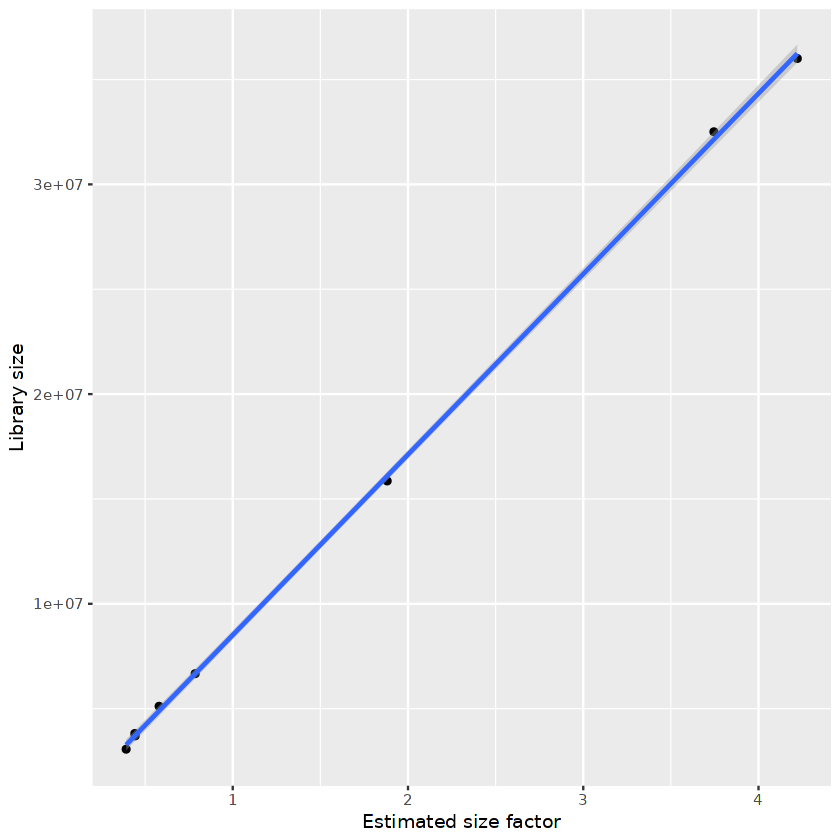

In [730]:
options(repr.plot.width=7, repr.plot.height=7)
ggplot(data=libsize, aes(x=x, y=y)) + geom_point() + geom_smooth(method="lm") + xlab("Estimated size factor") + ylab("Library size")

In [731]:
data.frame(colData(dds))

,cluster_id,sample_id,group_id,debris_id,sizeFactor
,<chr>,<chr>,<fct>,<fct>,<dbl>
Peak2F,MOL,Peak2F,F,Percoll,0.4414118
Peak2M,MOL,Peak2M,M,Percoll,0.5799771
Peak3F,MOL,Peak3F,F,Percoll,0.4433482
Peak3M,MOL,Peak3M,M,Percoll,0.3917761
Peak5F,MOL,Peak5F,F,Debris,0.7856445
Peak5M,MOL,Peak5M,M,Debris,1.8813043
PeakFemale4F,MOL,PeakFemale4F,F,Debris,3.7454725
PeakMale4M,MOL,PeakMale4M,M,Debris,4.2214546


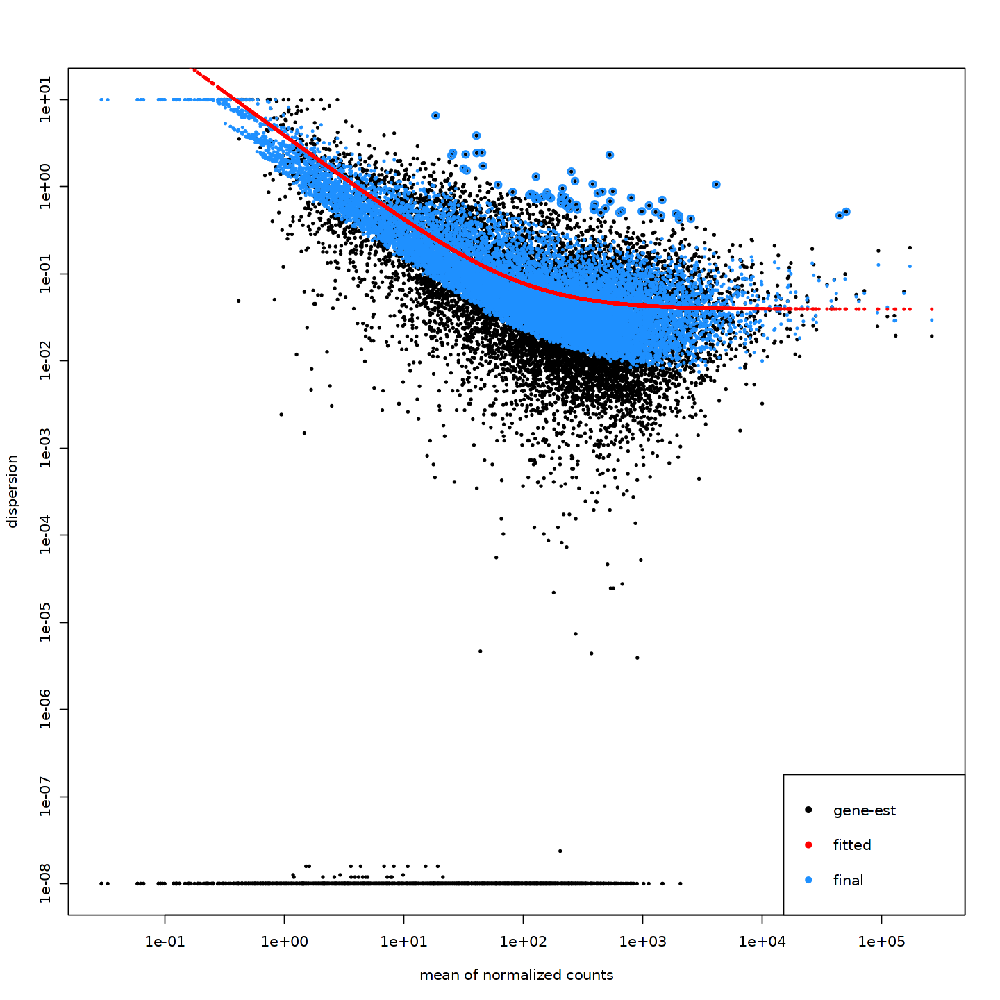

In [732]:
# Plot dispersion estimates
options(repr.plot.width=12, repr.plot.height=12)
plotDispEsts(dds)

In [733]:
condition1 = "M"
condition2 = "F"

In [734]:
contrast <- c("group_id", condition1, condition2)

# resultsNames(dds)
res <- results(dds, contrast = contrast, alpha = 0.05)

In [735]:
summary(res)


out of 14217 with nonzero total read count
adjusted p-value < 0.05
LFC > 0 (up)       : 4, 0.028%
LFC < 0 (down)     : 2, 0.014%
outliers [1]       : 0, 0%
low counts [2]     : 0, 0%
(mean count < 0)
[1] see 'cooksCutoff' argument of ?results
[2] see 'independentFiltering' argument of ?results



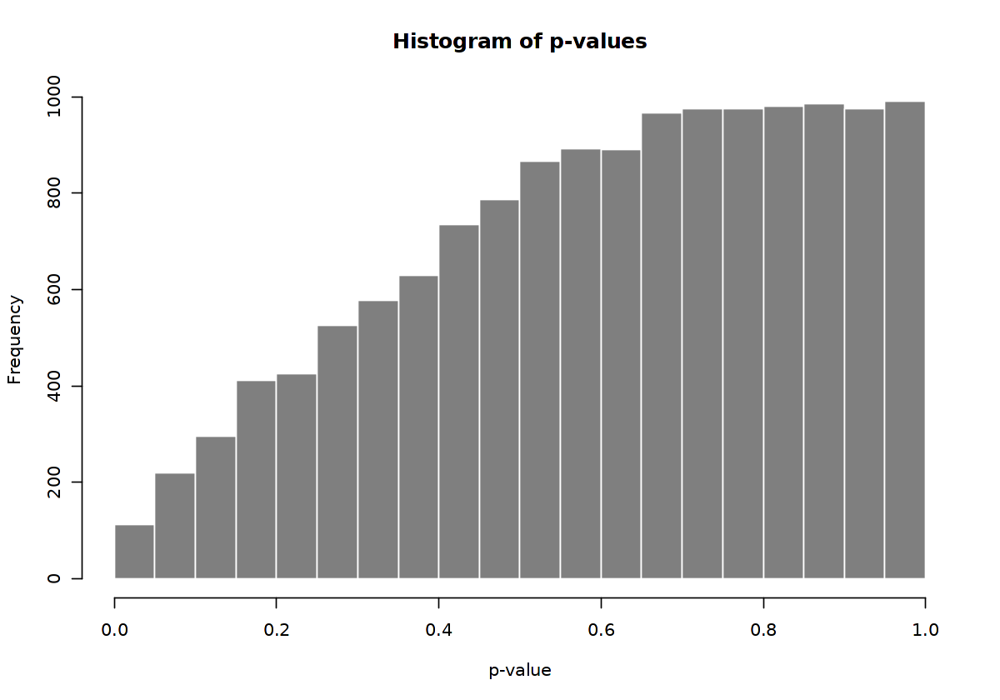

In [736]:
options(repr.plot.width=10, repr.plot.height=7)
hist(res$pvalue, breaks=0:20/20, col="grey50", border="white", xlim=c(0,1), main="Histogram of p-values", xlab="p-value")

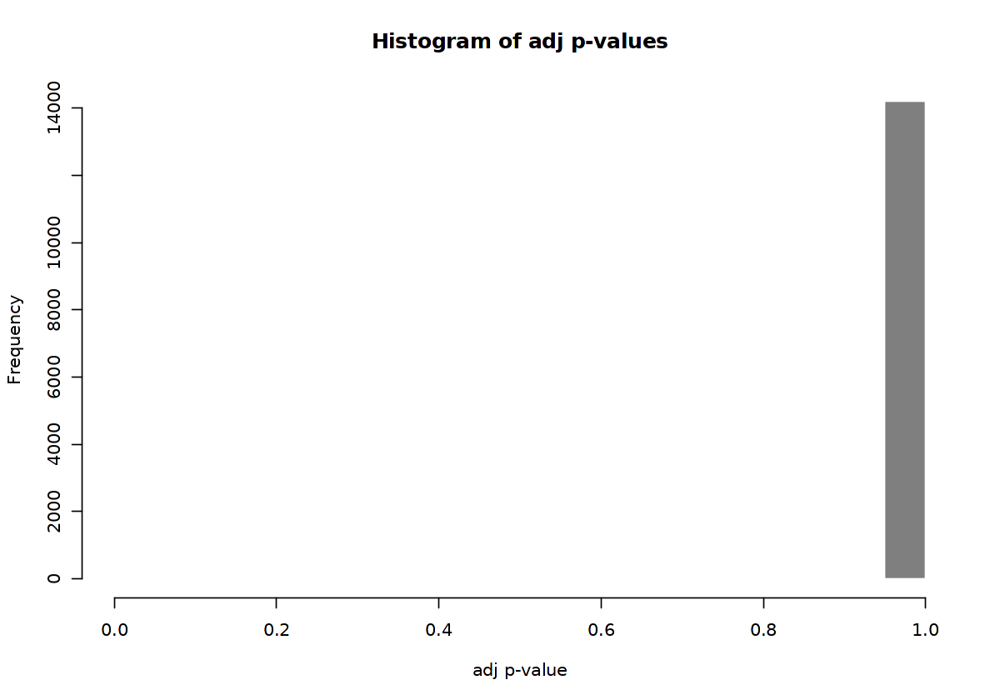

In [737]:
options(repr.plot.width=10, repr.plot.height=7)
hist(res$padj, breaks=0:20/20, col="grey50", border="white", xlim=c(0,1), main="Histogram of adj p-values", xlab="adj p-value")

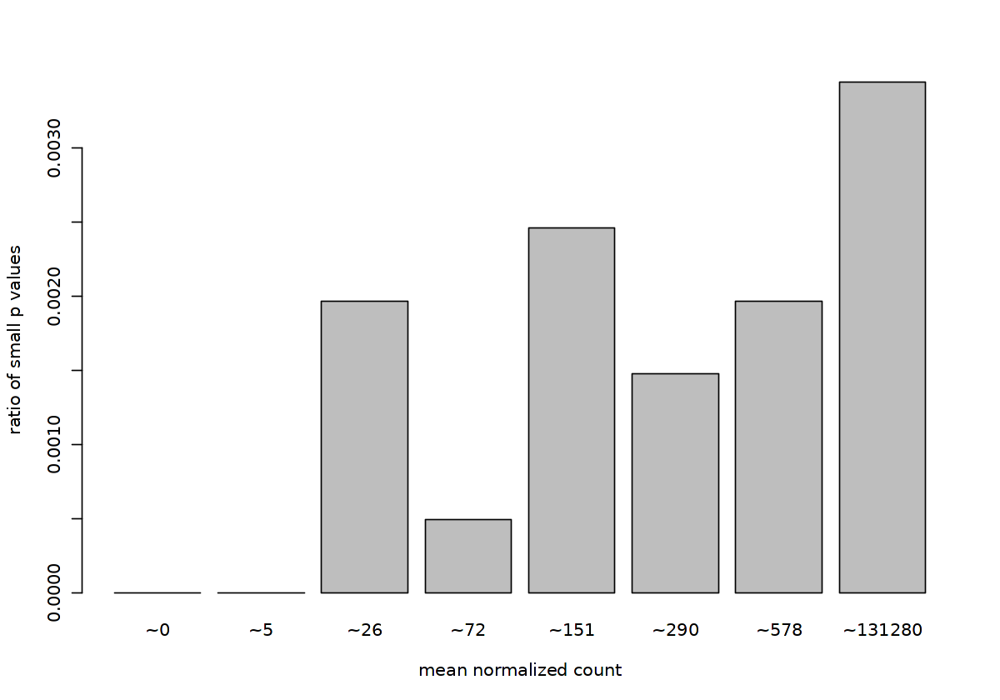

In [738]:
options(repr.plot.width=10, repr.plot.height=7)
qs <- c(0, quantile(res$baseMean[res$baseMean > 0], 0:7/7))
# cut the genes into the bins
bins <- cut(res$baseMean, qs)
# rename the levels of the bins using the middle point
levels(bins) <- paste0("~",round(.5*qs[-1] + .5*qs[-length(qs)]))
# calculate the ratio of $p$ values less than .01 for each bin
ratios <- tapply(res$pvalue, bins, function(p) mean(p < .01, na.rm=TRUE))
# plot these ratios
barplot(ratios, xlab="mean normalized count", ylab="ratio of small p values")

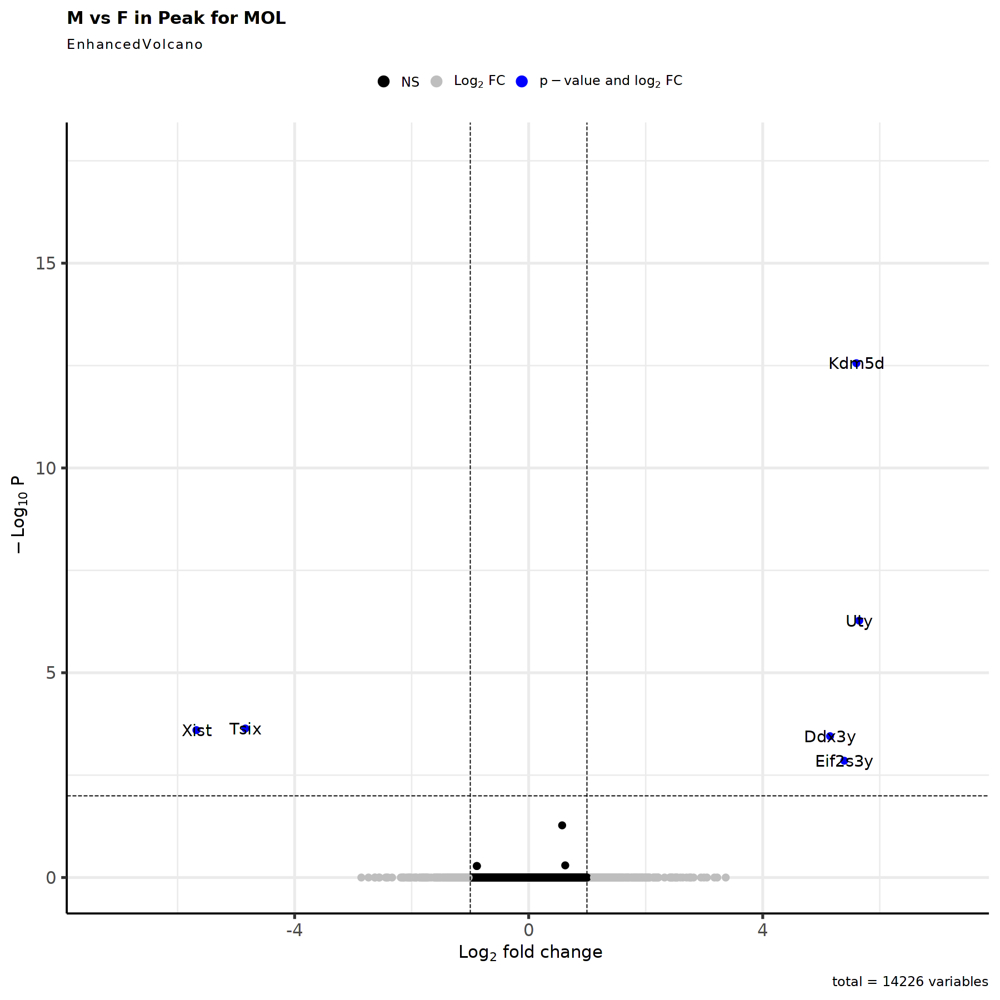

In [739]:
options(repr.plot.width=15, repr.plot.height=15)
#padj<0.001
EnhancedVolcano(res,
    lab = rownames(res),
    x = 'log2FoldChange',
    y = 'padj',
    title = paste0('M vs F in ',timepoint,' for ', cluster_choice),
    pCutoff = 0.01,
    FCcutoff = 1,
    pointSize = 3.0,
    labSize = 6.0,
    col=c('black', 'grey', 'grey', 'blue'),
    colAlpha = 1)

In [740]:
res <- res[complete.cases(res$padj),]

In [741]:
res_filtered <- res[(res$padj < 0.01 & abs(res$log2FoldChange) > 1 & res$baseMean > 1),]

In [742]:
res_filtered[order(abs(res_filtered$log2FoldChange), decreasing=TRUE),]

log2 fold change (MLE): group_id M vs F 
Wald test p-value: group id M vs F 
DataFrame with 6 rows and 6 columns
         baseMean log2FoldChange     lfcSE      stat      pvalue        padj
        <numeric>      <numeric> <numeric> <numeric>   <numeric>   <numeric>
Xist     4124.649       -5.67844  1.053725  -5.38892 7.08814e-08 2.51930e-04
Uty       532.927        5.64972  0.867850   6.51002 7.51395e-11 5.34129e-07
Kdm5d     154.360        5.60097  0.659183   8.49684 1.94830e-17 2.76989e-13
Eif2s3y   380.831        5.39348  1.080167   4.99319 5.93914e-07 1.40728e-03
Ddx3y     458.331        5.15047  0.974241   5.28665 1.24575e-07 3.54216e-04
Tsix      799.726       -4.84240  0.887434  -5.45663 4.85264e-08 2.29967e-04

In [743]:
nrow(res_filtered)

[1] 6

In [744]:
top.genes.number <- ifelse(nrow(res_filtered)>100, 100, nrow(res_filtered))

In [745]:
res_top <- res_filtered[order(abs(res_filtered$log2FoldChange), decreasing=TRUE),][1:top.genes.number,]
res_top <- res_top[order(res_top$log2FoldChange, decreasing=FALSE),]

In [746]:
tmp_sub <- subset(tmp, subset = cellType == cluster_choice)

In [747]:
tmp_sub <- NormalizeData(tmp_sub, normalization.method = "LogNormalize", scale.factor = 10000, verbose = TRUE)

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


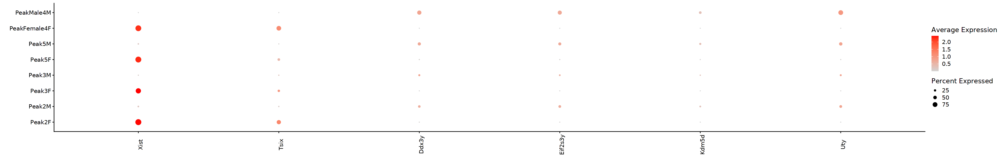

In [748]:
options(repr.plot.width=30, repr.plot.height=5)
plot <- DotPlot(tmp_sub, assay = "RNA", group.by = "orig.ident_Sex", scale=FALSE, cols = c("lightgrey", "red"), dot.scale = 5, features = rownames(res_top))
plot + theme(axis.text.x = element_text(angle = 90)) + labs(x = "", y= "")

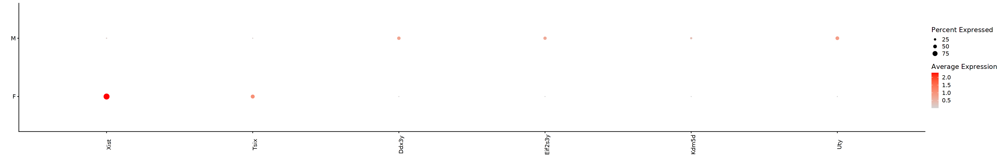

In [749]:
options(repr.plot.width=30, repr.plot.height=5)
plot <- DotPlot(tmp_sub, assay = "RNA", group.by = "Sex", scale=FALSE, cols = c("lightgrey", "red"), dot.scale = 5, features = rownames(res_top))
plot + theme(axis.text.x = element_text(angle = 90)) + labs(x = "", y= "")

In [750]:
HVGs.list[[cluster_choice]] <- rownames(res_filtered)

##### 3.2.4.2 OPC

In [751]:
cluster_choice <- "OPC"

In [752]:
table_sample_low <- table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$sample_id)[cluster_choice,][table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$sample_id)[cluster_choice,] <= 5]
table_sample_low

sample_keep <- names(timepoint_Sex_colors)[!names(timepoint_Sex_colors) %in% names(table_sample_low)]

named integer(0)

In [753]:
table_group_low <-table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$group_id)[cluster_choice,][table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$group_id)[cluster_choice,] <= 30]
table_group_low

group_keep <- names(sex_colors)[!names(sex_colors) %in% names(table_group_low)]

named integer(0)

In [754]:
cluster_metadata <- metadata[which(metadata$cluster_id == cluster_choice), ]

# Assign the rownames of the metadata to be the sample IDs
rownames(cluster_metadata) <- cluster_metadata$sample_id

In [755]:
#Remove sample and timepoint with low counts (sample<=5, timepoint<=30)
cluster_metadata <- cluster_metadata[(cluster_metadata$sample_id %in% sample_keep & cluster_metadata$group_id %in% group_keep),]

#new_sample_levels <- levels(cluster_metadata$sample_id)[levels(cluster_metadata$sample_id) %in% sample_keep]
#cluster_metadata$sample_id <- droplevels(cluster_metadata$sample_id)
#levels(cluster_metadata$sample_id) <- new_sample_levels

new_group_levels <- levels(cluster_metadata$group_id)[levels(cluster_metadata$group_id) %in% group_keep]
cluster_metadata$group_id <- droplevels(cluster_metadata$group_id)
levels(cluster_metadata$group_id) <- new_group_levels

In [756]:
cluster_metadata

,cluster_id,sample_id,group_id,debris_id
,<chr>,<chr>,<fct>,<chr>
Peak2F,OPC,Peak2F,F,Percoll
Peak2M,OPC,Peak2M,M,Percoll
Peak3F,OPC,Peak3F,F,Percoll
Peak3M,OPC,Peak3M,M,Percoll
Peak5F,OPC,Peak5F,F,Debris
Peak5M,OPC,Peak5M,M,Debris
PeakFemale4F,OPC,PeakFemale4F,F,Debris
PeakMale4M,OPC,PeakMale4M,M,Debris


In [757]:
# Subset the counts to only this cluster
counts <- pb[[cluster_choice]]

cluster_counts <- data.frame(counts[, which(colnames(counts) %in% rownames(cluster_metadata))])

# Check that all of the row names of the metadata are the same and in the same order as the column names of the counts in order to use as input to DESeq2
all(rownames(cluster_metadata) == colnames(cluster_counts))

[1] TRUE

In [758]:
dds <- DESeqDataSetFromMatrix(cluster_counts, colData = cluster_metadata, design = ~ group_id + debris_id)

converting counts to integer mode

Warning message in DESeqDataSet(se, design = design, ignoreRank):
"some variables in design formula are characters, converting to factors"


In [759]:
# Transform counts for data visualization
rld <- rlog(dds, blind=TRUE)

using ntop=500 top features by variance



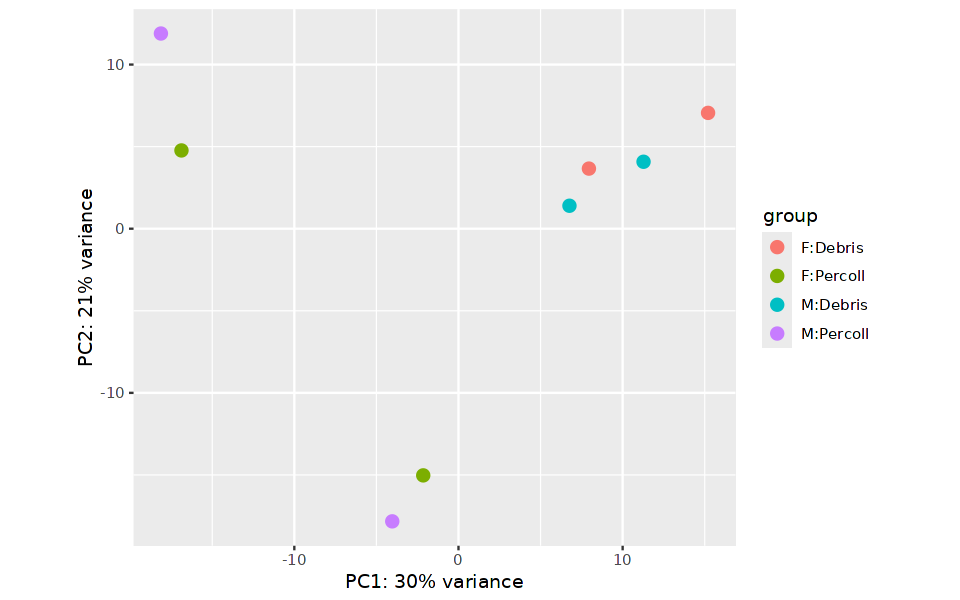

In [760]:
# Plot PCA
options(repr.plot.width=8, repr.plot.height=5)
DESeq2::plotPCA(rld, intgroup = c("group_id", "debris_id"))

In [761]:
# Extract the rlog matrix from the object and compute pairwise correlation values
rld_mat <- assay(rld)
rld_cor <- cor(rld_mat)

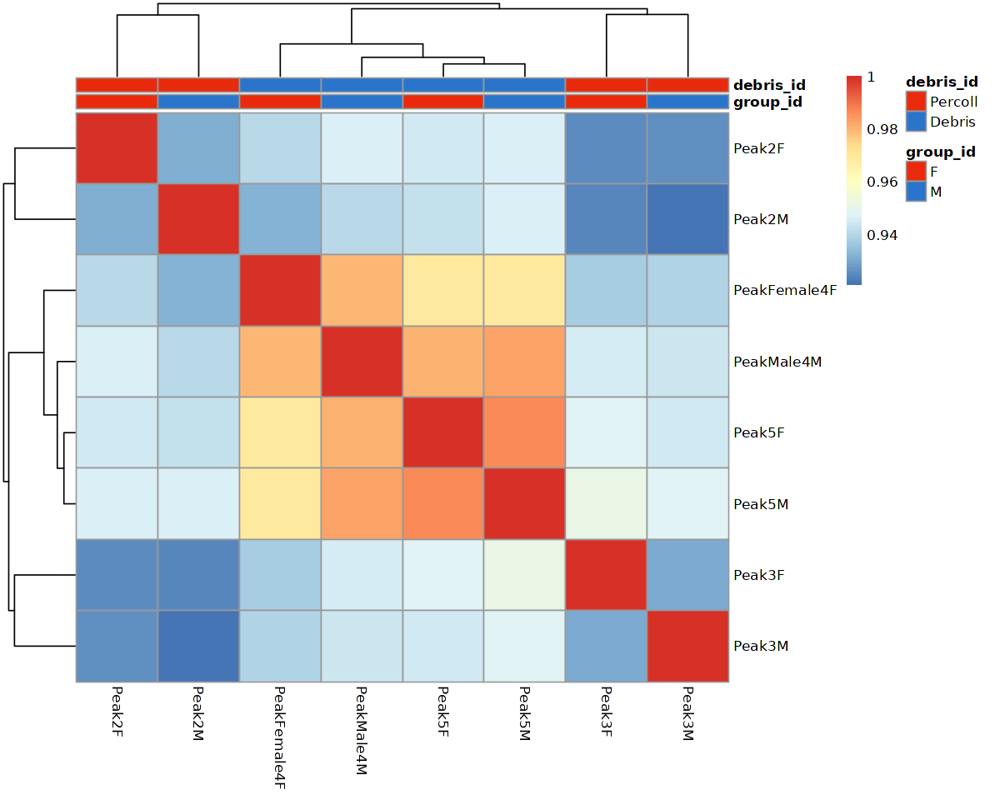

In [762]:
# Plot heatmap
options(repr.plot.width=10, repr.plot.height=8)
pheatmap(rld_cor, annotation = cluster_metadata[, c("group_id","debris_id"), drop=F], annotation_colors = list(group_id=sex_colors, debris_id=debris_colors))

In [763]:
# Run DESeq2 differential expression analysis
dds <- DESeq(dds)

estimating size factors

estimating dispersions

gene-wise dispersion estimates

mean-dispersion relationship

final dispersion estimates

fitting model and testing



In [764]:
libsize = data.frame(x=sizeFactors(dds), y=colSums(assay(dds)))

`geom_smooth()` using formula = 'y ~ x'


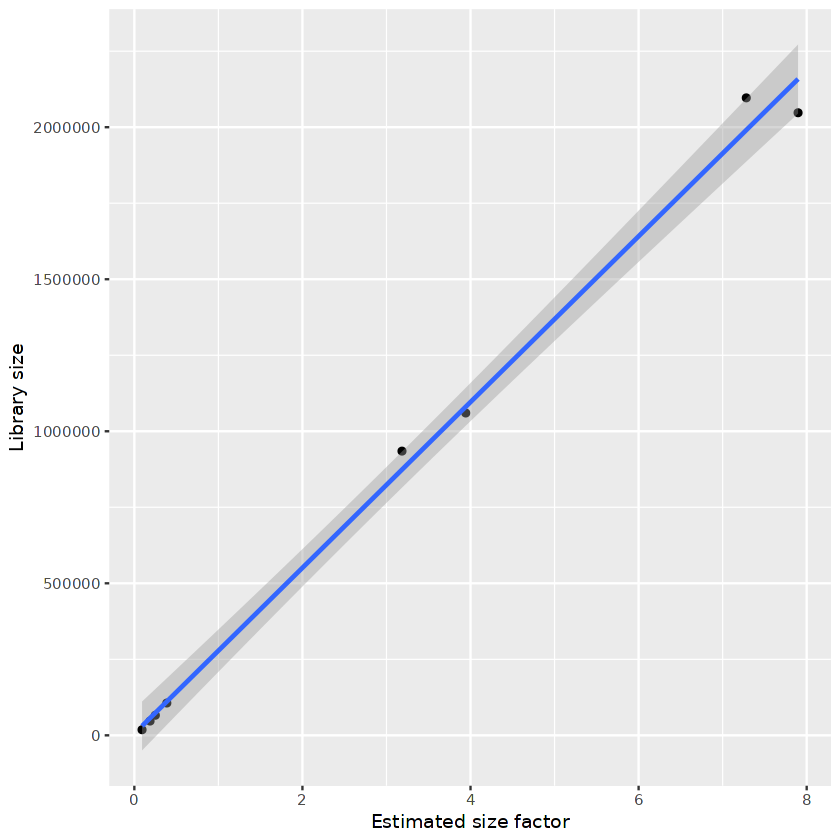

In [765]:
options(repr.plot.width=7, repr.plot.height=7)
ggplot(data=libsize, aes(x=x, y=y)) + geom_point() + geom_smooth(method="lm") + xlab("Estimated size factor") + ylab("Library size")

In [766]:
data.frame(colData(dds))

,cluster_id,sample_id,group_id,debris_id,sizeFactor
,<chr>,<chr>,<fct>,<fct>,<dbl>
Peak2F,OPC,Peak2F,F,Percoll,0.38659269
Peak2M,OPC,Peak2M,M,Percoll,0.24978999
Peak3F,OPC,Peak3F,F,Percoll,0.18702081
Peak3M,OPC,Peak3M,M,Percoll,0.09165978
Peak5F,OPC,Peak5F,F,Debris,3.94304968
Peak5M,OPC,Peak5M,M,Debris,7.89737578
PeakFemale4F,OPC,PeakFemale4F,F,Debris,3.18459887
PeakMale4M,OPC,PeakMale4M,M,Debris,7.28130103


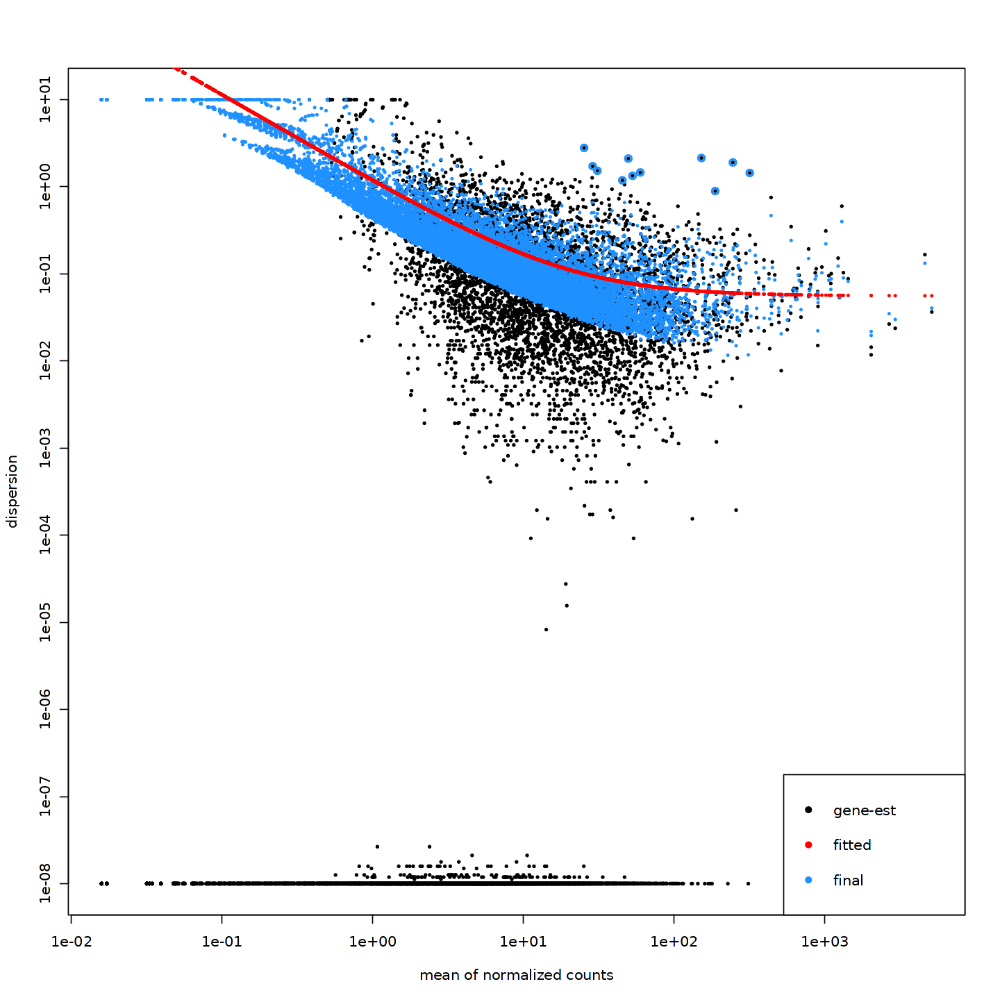

In [767]:
# Plot dispersion estimates
options(repr.plot.width=12, repr.plot.height=12)
plotDispEsts(dds)

In [768]:
condition1 = "M"
condition2 = "F"

In [769]:
contrast <- c("group_id", condition1, condition2)

# resultsNames(dds)
res <- results(dds, contrast = contrast, alpha = 0.05)

In [770]:
summary(res)


out of 14011 with nonzero total read count
adjusted p-value < 0.05
LFC > 0 (up)       : 3, 0.021%
LFC < 0 (down)     : 2, 0.014%
outliers [1]       : 0, 0%
low counts [2]     : 0, 0%
(mean count < 0)
[1] see 'cooksCutoff' argument of ?results
[2] see 'independentFiltering' argument of ?results



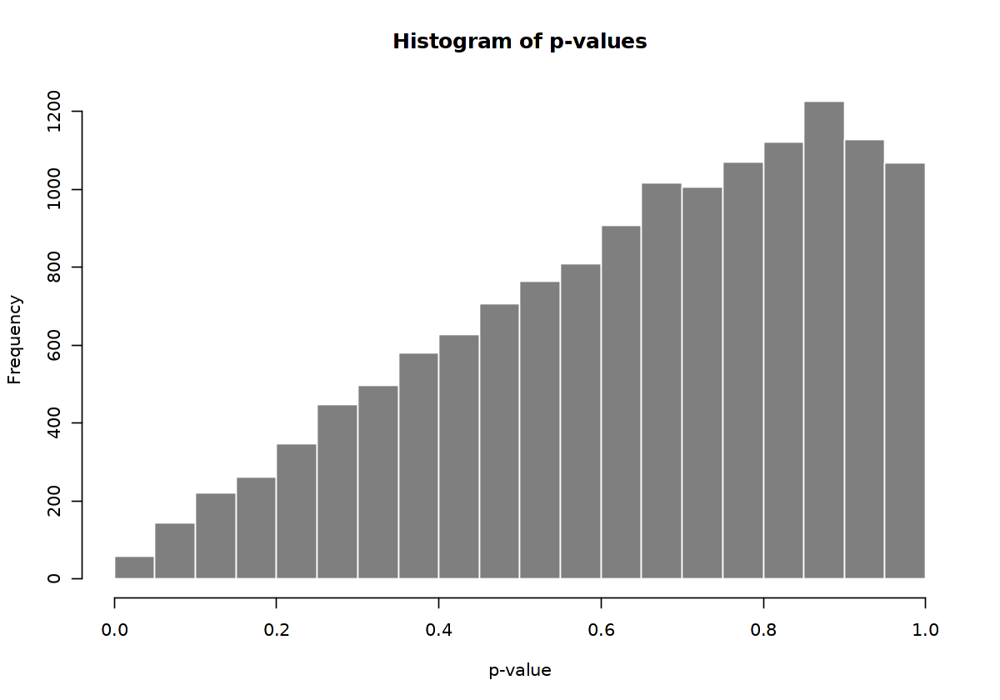

In [771]:
options(repr.plot.width=10, repr.plot.height=7)
hist(res$pvalue, breaks=0:20/20, col="grey50", border="white", xlim=c(0,1), main="Histogram of p-values", xlab="p-value")

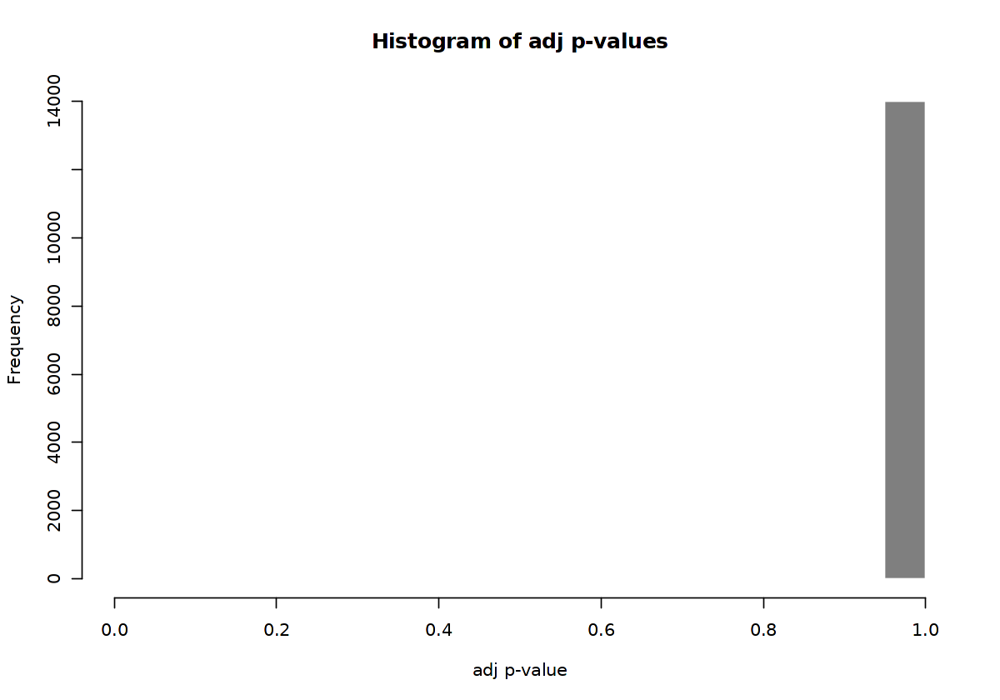

In [772]:
options(repr.plot.width=10, repr.plot.height=7)
hist(res$padj, breaks=0:20/20, col="grey50", border="white", xlim=c(0,1), main="Histogram of adj p-values", xlab="adj p-value")

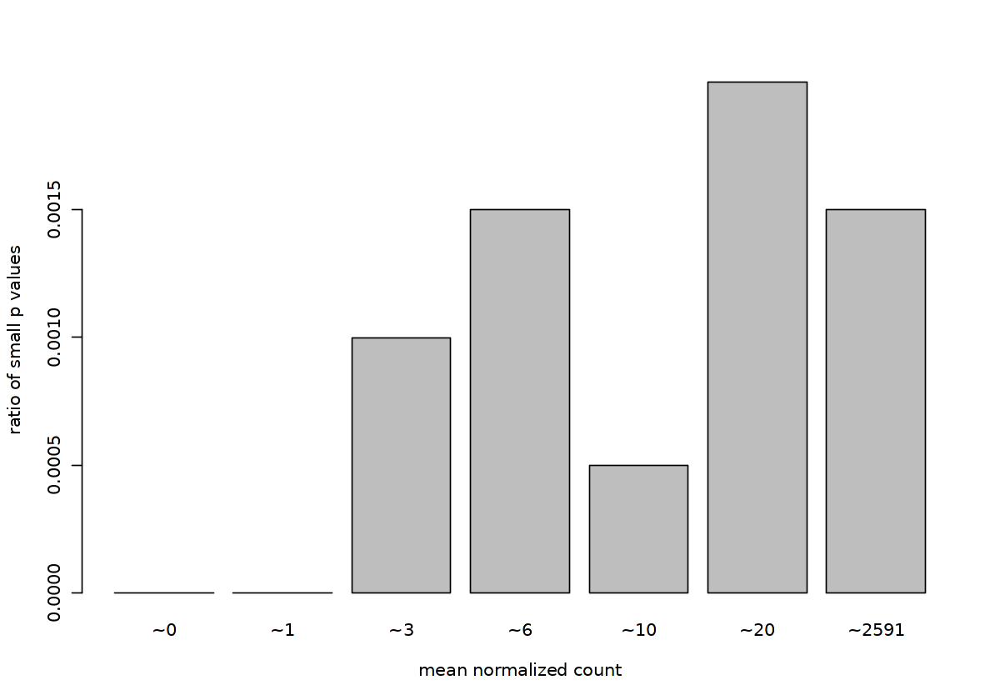

In [773]:
options(repr.plot.width=10, repr.plot.height=7)
qs <- c(0, quantile(res$baseMean[res$baseMean > 0], 0:7/7))
# cut the genes into the bins
bins <- cut(res$baseMean, qs)
# rename the levels of the bins using the middle point
levels(bins) <- paste0("~",round(.5*qs[-1] + .5*qs[-length(qs)]))
# calculate the ratio of $p$ values less than .01 for each bin
ratios <- tapply(res$pvalue, bins, function(p) mean(p < .01, na.rm=TRUE))
# plot these ratios
barplot(ratios, xlab="mean normalized count", ylab="ratio of small p values")

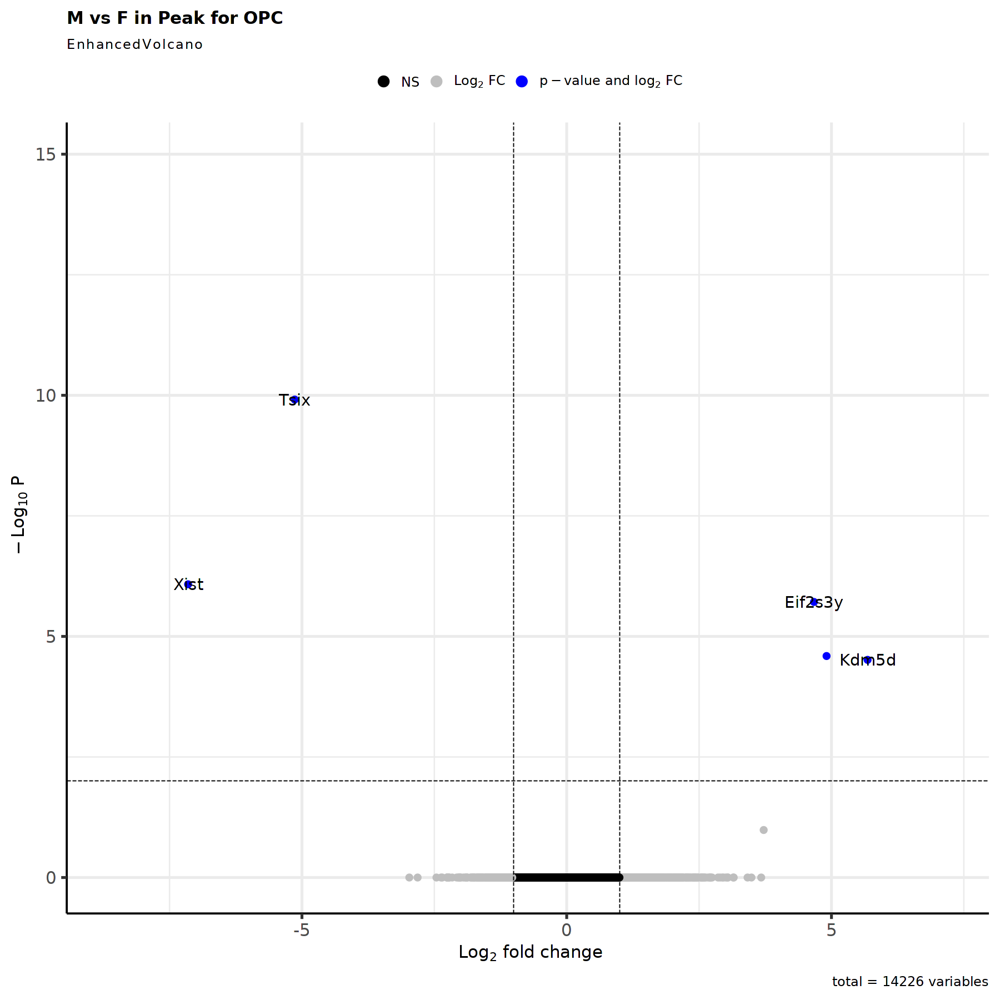

In [774]:
options(repr.plot.width=15, repr.plot.height=15)
#padj<0.001
EnhancedVolcano(res,
    lab = rownames(res),
    x = 'log2FoldChange',
    y = 'padj',
    title = paste0('M vs F in ',timepoint,' for ', cluster_choice),
    pCutoff = 0.01,
    FCcutoff = 1,
    pointSize = 3.0,
    labSize = 6.0,
    col=c('black', 'grey', 'grey', 'blue'),
    colAlpha = 1)

In [775]:
res <- res[complete.cases(res$padj),]

In [776]:
res_filtered <- res[(res$padj < 0.01 & abs(res$log2FoldChange) > 1 & res$baseMean > 1),]

In [777]:
res_filtered[order(abs(res_filtered$log2FoldChange), decreasing=TRUE),]

log2 fold change (MLE): group_id M vs F 
Wald test p-value: group id M vs F 
DataFrame with 5 rows and 6 columns
         baseMean log2FoldChange     lfcSE      stat      pvalue        padj
        <numeric>      <numeric> <numeric> <numeric>   <numeric>   <numeric>
Xist    188.11310       -7.14997  1.110060  -6.44107 1.18635e-10 8.31097e-07
Kdm5d     5.84586        5.68208  0.994137   5.71559 1.09323e-08 3.06344e-05
Tsix     37.01161       -5.13633  0.662218  -7.75625 8.74782e-15 1.22566e-10
Uty      22.08525        4.90733  0.848403   5.78420 7.28578e-09 2.55203e-05
Eif2s3y  14.44336        4.67001  0.747328   6.24895 4.13218e-10 1.92987e-06

In [778]:
nrow(res_filtered)

[1] 5

In [779]:
top.genes.number <- ifelse(nrow(res_filtered)>100, 100, nrow(res_filtered))

In [780]:
res_top <- res_filtered[order(abs(res_filtered$log2FoldChange), decreasing=TRUE),][1:top.genes.number,]
res_top <- res_top[order(res_top$log2FoldChange, decreasing=FALSE),]

In [781]:
tmp_sub <- subset(tmp, subset = cellType == cluster_choice)

In [782]:
tmp_sub <- NormalizeData(tmp_sub, normalization.method = "LogNormalize", scale.factor = 10000, verbose = TRUE)

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


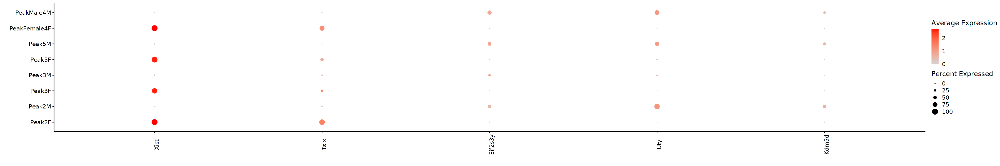

In [783]:
options(repr.plot.width=30, repr.plot.height=5)
plot <- DotPlot(tmp_sub, assay = "RNA", group.by = "orig.ident_Sex", scale=FALSE, cols = c("lightgrey", "red"), dot.scale = 5, features = rownames(res_top))
plot + theme(axis.text.x = element_text(angle = 90)) + labs(x = "", y= "")

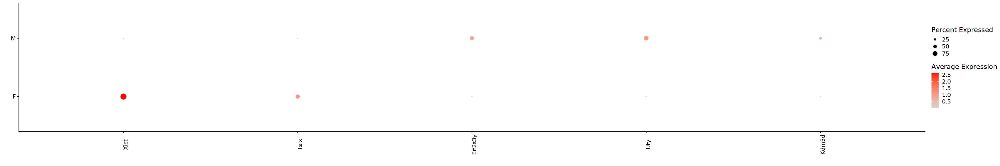

In [784]:
options(repr.plot.width=30, repr.plot.height=5)
plot <- DotPlot(tmp_sub, assay = "RNA", group.by = "Sex", scale=FALSE, cols = c("lightgrey", "red"), dot.scale = 5, features = rownames(res_top))
plot + theme(axis.text.x = element_text(angle = 90)) + labs(x = "", y= "")

In [785]:
HVGs.list[[cluster_choice]] <- rownames(res_filtered)

##### 3.2.4.3 Micro

In [786]:
cluster_choice <- "Micro"

In [787]:
table_sample_low <- table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$sample_id)[cluster_choice,][table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$sample_id)[cluster_choice,] <= 5]
table_sample_low

sample_keep <- names(timepoint_Sex_colors)[!names(timepoint_Sex_colors) %in% names(table_sample_low)]

named integer(0)

In [788]:
table_group_low <-table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$group_id)[cluster_choice,][table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$group_id)[cluster_choice,] <= 30]
table_group_low

group_keep <- names(sex_colors)[!names(sex_colors) %in% names(table_group_low)]

named integer(0)

In [789]:
cluster_metadata <- metadata[which(metadata$cluster_id == cluster_choice), ]

# Assign the rownames of the metadata to be the sample IDs
rownames(cluster_metadata) <- cluster_metadata$sample_id

In [790]:
#Remove sample and timepoint with low counts (sample<=5, timepoint<=30)
cluster_metadata <- cluster_metadata[(cluster_metadata$sample_id %in% sample_keep & cluster_metadata$group_id %in% group_keep),]

#new_sample_levels <- levels(cluster_metadata$sample_id)[levels(cluster_metadata$sample_id) %in% sample_keep]
#cluster_metadata$sample_id <- droplevels(cluster_metadata$sample_id)
#levels(cluster_metadata$sample_id) <- new_sample_levels

new_group_levels <- levels(cluster_metadata$group_id)[levels(cluster_metadata$group_id) %in% group_keep]
cluster_metadata$group_id <- droplevels(cluster_metadata$group_id)
levels(cluster_metadata$group_id) <- new_group_levels

In [791]:
cluster_metadata

,cluster_id,sample_id,group_id,debris_id
,<chr>,<chr>,<fct>,<chr>
Peak2F,Micro,Peak2F,F,Percoll
Peak2M,Micro,Peak2M,M,Percoll
Peak3F,Micro,Peak3F,F,Percoll
Peak3M,Micro,Peak3M,M,Percoll
Peak5F,Micro,Peak5F,F,Debris
Peak5M,Micro,Peak5M,M,Debris
PeakFemale4F,Micro,PeakFemale4F,F,Debris
PeakMale4M,Micro,PeakMale4M,M,Debris


In [792]:
# Subset the counts to only this cluster
counts <- pb[[cluster_choice]]

cluster_counts <- data.frame(counts[, which(colnames(counts) %in% rownames(cluster_metadata))])

# Check that all of the row names of the metadata are the same and in the same order as the column names of the counts in order to use as input to DESeq2
all(rownames(cluster_metadata) == colnames(cluster_counts))

[1] TRUE

In [793]:
dds <- DESeqDataSetFromMatrix(cluster_counts, colData = cluster_metadata, design = ~ group_id + debris_id)

converting counts to integer mode

Warning message in DESeqDataSet(se, design = design, ignoreRank):
"some variables in design formula are characters, converting to factors"


In [794]:
# Transform counts for data visualization
rld <- rlog(dds, blind=TRUE)

using ntop=500 top features by variance



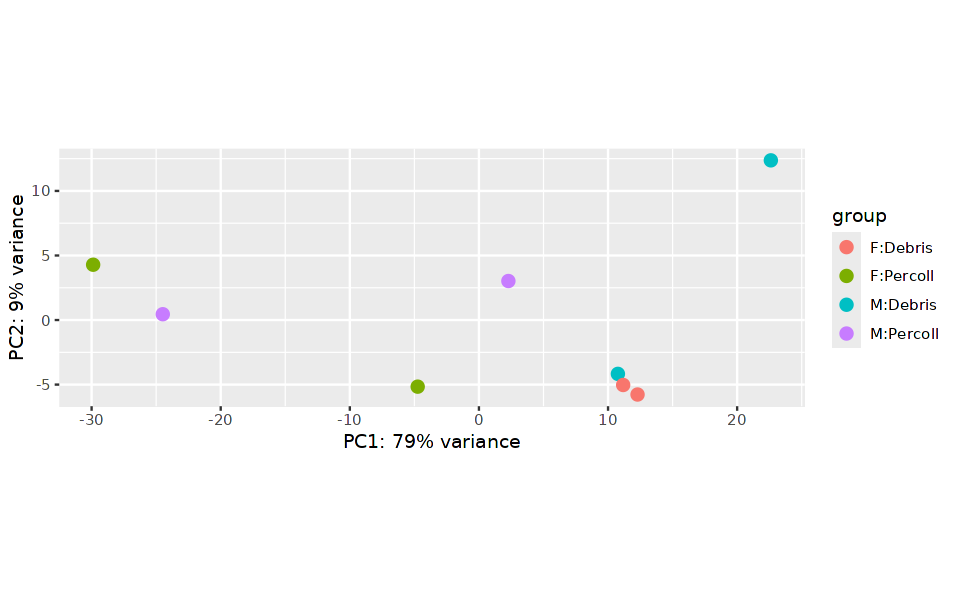

In [795]:
# Plot PCA
options(repr.plot.width=8, repr.plot.height=5)
DESeq2::plotPCA(rld, intgroup = c("group_id", "debris_id"))

In [796]:
# Extract the rlog matrix from the object and compute pairwise correlation values
rld_mat <- assay(rld)
rld_cor <- cor(rld_mat)

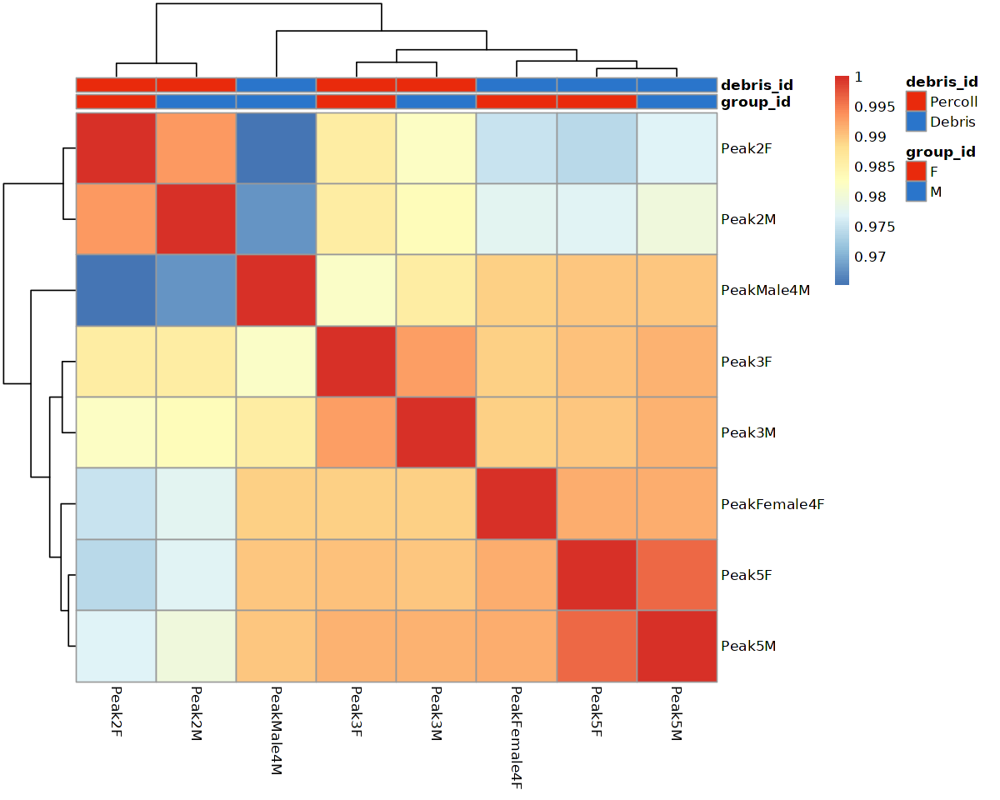

In [797]:
# Plot heatmap
options(repr.plot.width=10, repr.plot.height=8)
pheatmap(rld_cor, annotation = cluster_metadata[, c("group_id","debris_id"), drop=F], annotation_colors = list(group_id=sex_colors, debris_id=debris_colors))

In [798]:
# Run DESeq2 differential expression analysis
dds <- DESeq(dds)

estimating size factors

estimating dispersions

gene-wise dispersion estimates

mean-dispersion relationship

final dispersion estimates

fitting model and testing



In [799]:
libsize = data.frame(x=sizeFactors(dds), y=colSums(assay(dds)))

`geom_smooth()` using formula = 'y ~ x'


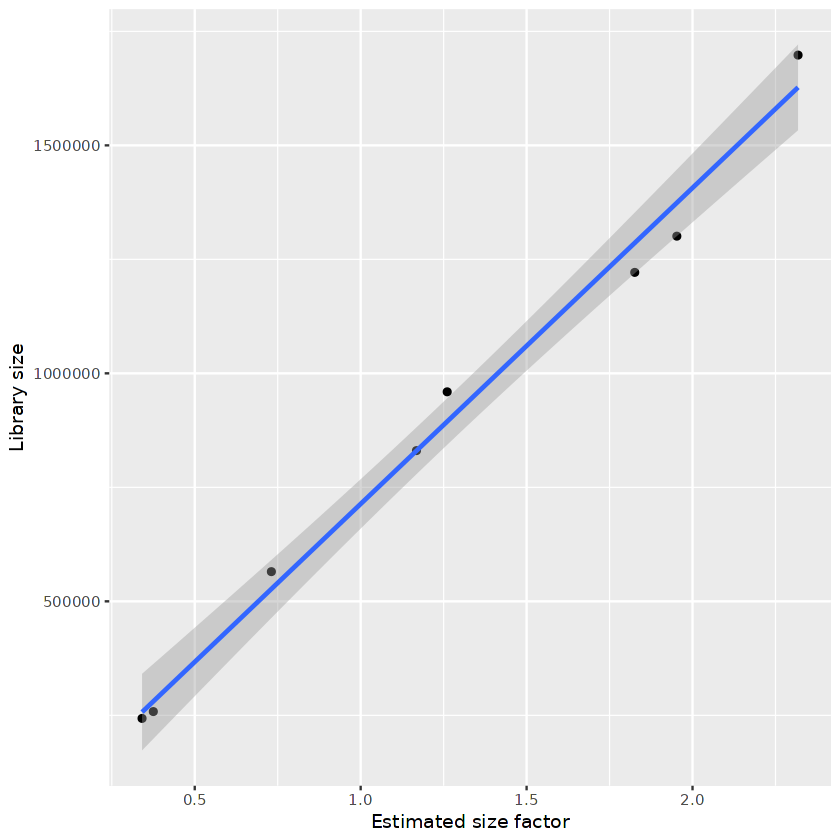

In [800]:
options(repr.plot.width=7, repr.plot.height=7)
ggplot(data=libsize, aes(x=x, y=y)) + geom_point() + geom_smooth(method="lm") + xlab("Estimated size factor") + ylab("Library size")

In [801]:
data.frame(colData(dds))

,cluster_id,sample_id,group_id,debris_id,sizeFactor
,<chr>,<chr>,<fct>,<fct>,<dbl>
Peak2F,Micro,Peak2F,F,Percoll,2.3180466
Peak2M,Micro,Peak2M,M,Percoll,0.3412134
Peak3F,Micro,Peak3F,F,Percoll,1.1681679
Peak3M,Micro,Peak3M,M,Percoll,0.3751517
Peak5F,Micro,Peak5F,F,Debris,1.8258951
Peak5M,Micro,Peak5M,M,Debris,1.9527467
PeakFemale4F,Micro,PeakFemale4F,F,Debris,0.7309148
PeakMale4M,Micro,PeakMale4M,M,Debris,1.2607253


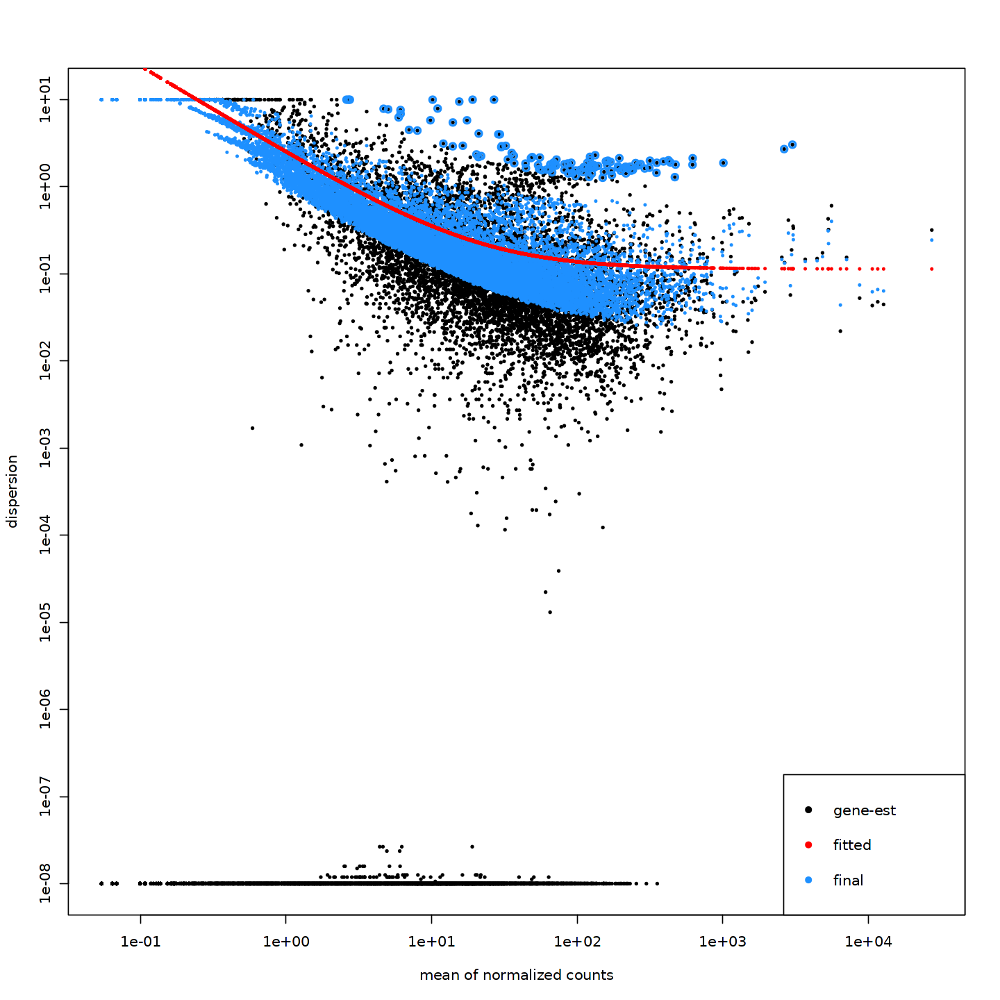

In [802]:
# Plot dispersion estimates
options(repr.plot.width=12, repr.plot.height=12)
plotDispEsts(dds)

In [803]:
condition1 = "M"
condition2 = "F"

In [804]:
contrast <- c("group_id", condition1, condition2)

# resultsNames(dds)
res <- results(dds, contrast = contrast, alpha = 0.05)

In [805]:
summary(res)


out of 14065 with nonzero total read count
adjusted p-value < 0.05
LFC > 0 (up)       : 4, 0.028%
LFC < 0 (down)     : 2, 0.014%
outliers [1]       : 0, 0%
low counts [2]     : 0, 0%
(mean count < 0)
[1] see 'cooksCutoff' argument of ?results
[2] see 'independentFiltering' argument of ?results



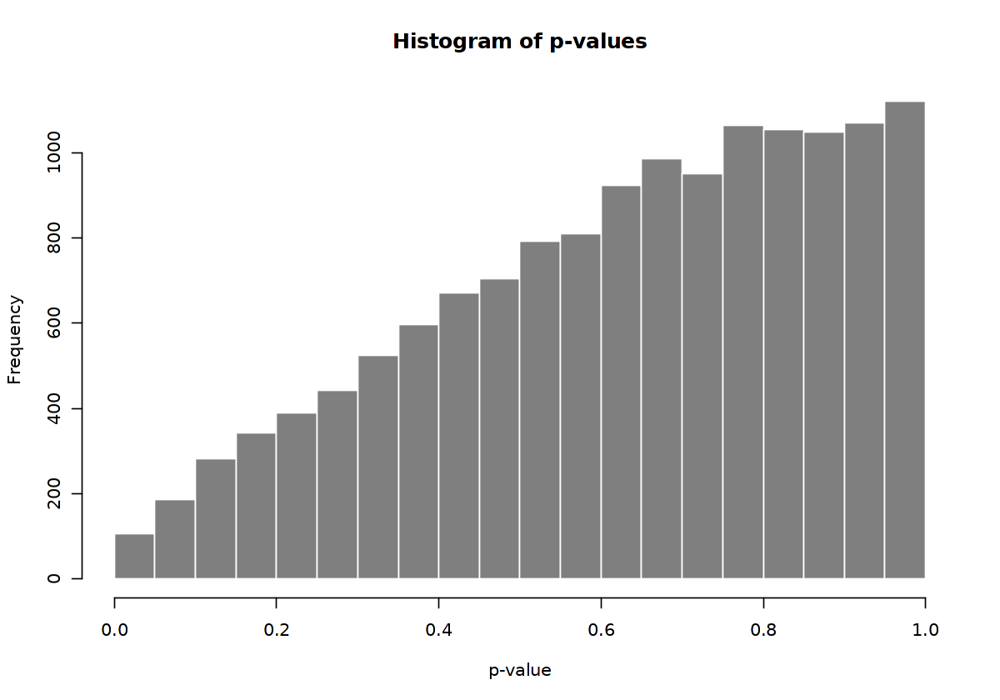

In [806]:
options(repr.plot.width=10, repr.plot.height=7)
hist(res$pvalue, breaks=0:20/20, col="grey50", border="white", xlim=c(0,1), main="Histogram of p-values", xlab="p-value")

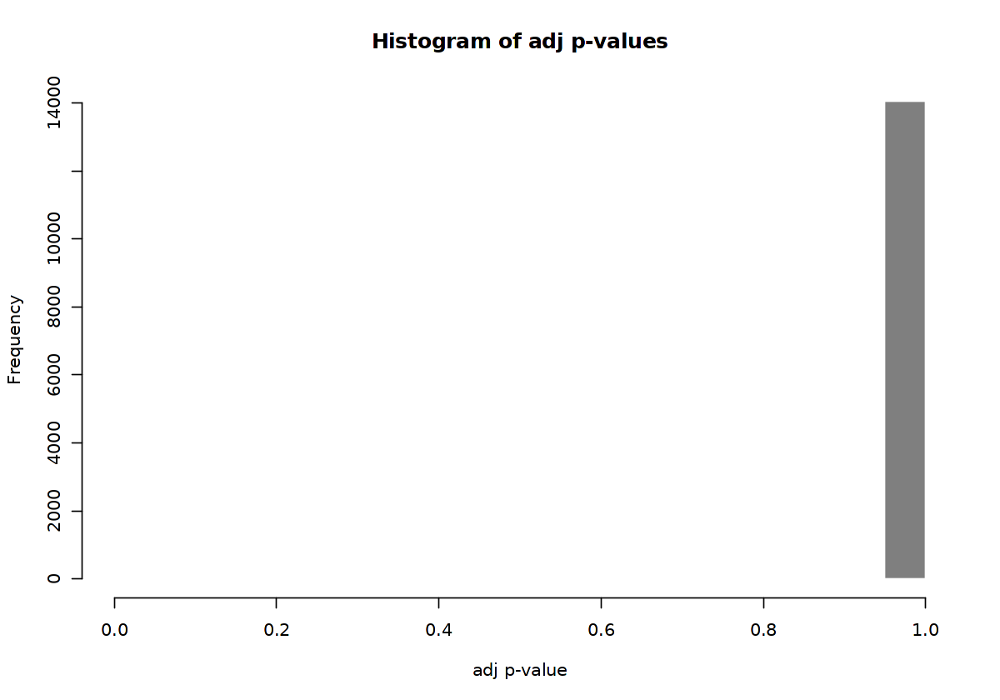

In [807]:
options(repr.plot.width=10, repr.plot.height=7)
hist(res$padj, breaks=0:20/20, col="grey50", border="white", xlim=c(0,1), main="Histogram of adj p-values", xlab="adj p-value")

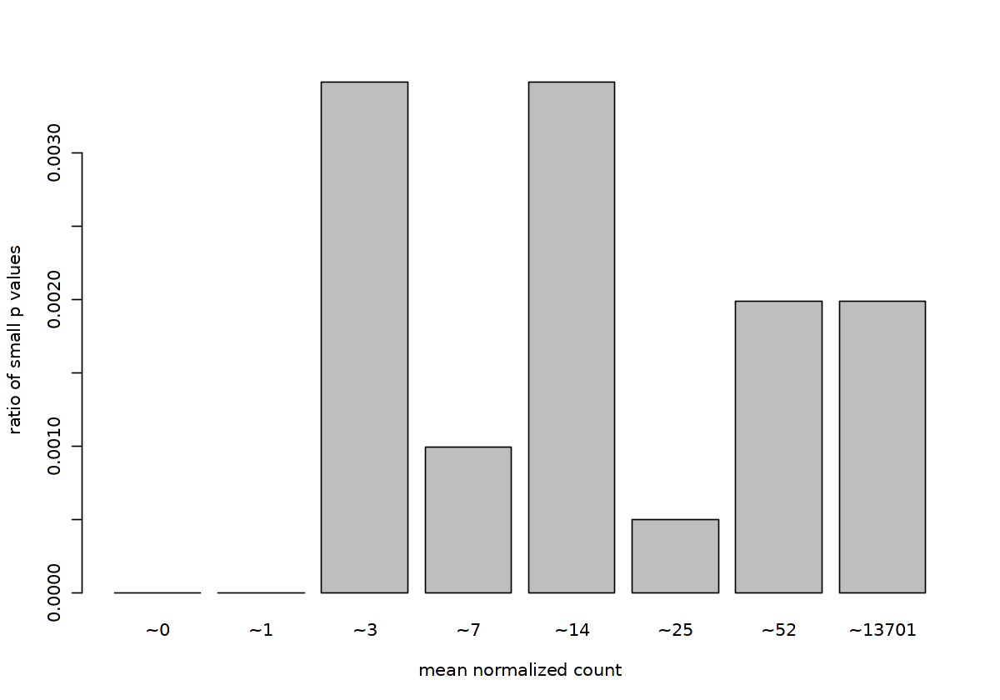

In [808]:
options(repr.plot.width=10, repr.plot.height=7)
qs <- c(0, quantile(res$baseMean[res$baseMean > 0], 0:7/7))
# cut the genes into the bins
bins <- cut(res$baseMean, qs)
# rename the levels of the bins using the middle point
levels(bins) <- paste0("~",round(.5*qs[-1] + .5*qs[-length(qs)]))
# calculate the ratio of $p$ values less than .01 for each bin
ratios <- tapply(res$pvalue, bins, function(p) mean(p < .01, na.rm=TRUE))
# plot these ratios
barplot(ratios, xlab="mean normalized count", ylab="ratio of small p values")

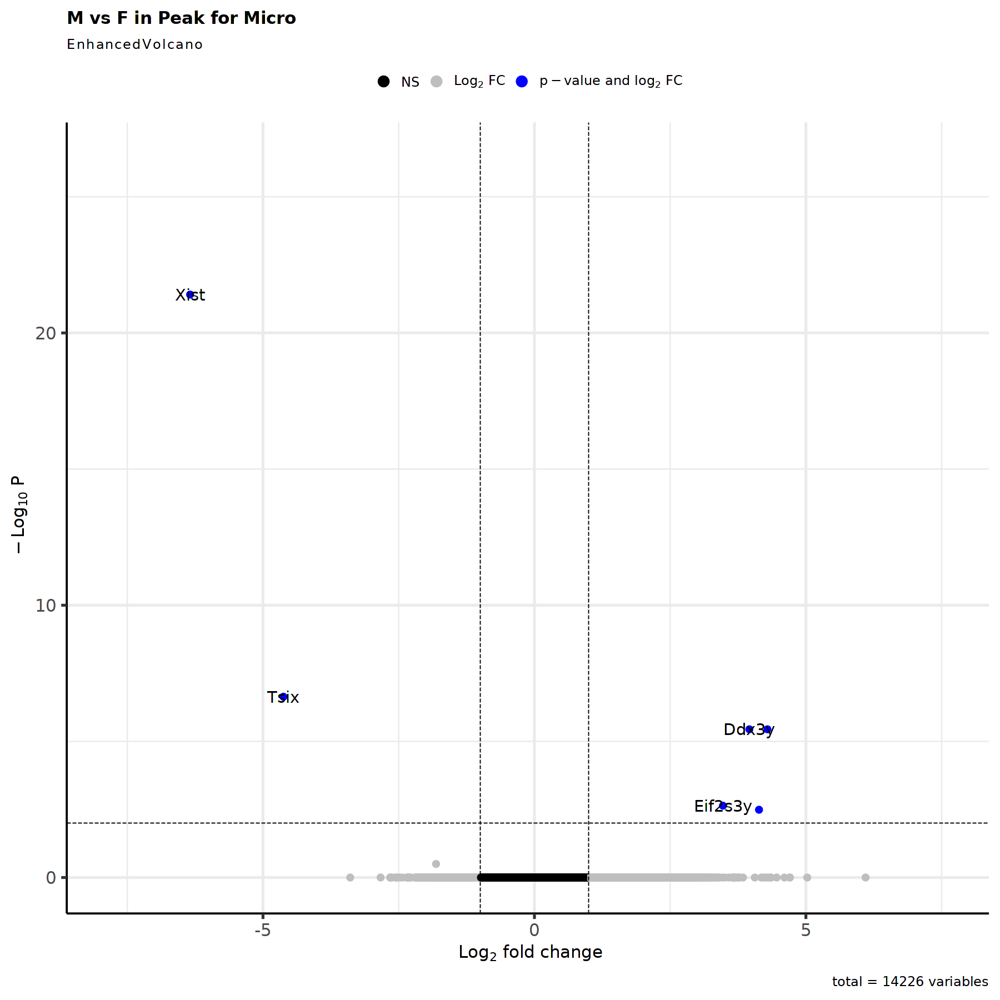

In [809]:
options(repr.plot.width=15, repr.plot.height=15)
#padj<0.001
EnhancedVolcano(res,
    lab = rownames(res),
    x = 'log2FoldChange',
    y = 'padj',
    title = paste0('M vs F in ',timepoint,' for ', cluster_choice),
    pCutoff = 0.01,
    FCcutoff = 1,
    pointSize = 3.0,
    labSize = 6.0,
    col=c('black', 'grey', 'grey', 'blue'),
    colAlpha = 1)

In [810]:
res <- res[complete.cases(res$padj),]

In [811]:
res_filtered <- res[(res$padj < 0.01 & abs(res$log2FoldChange) > 1 & res$baseMean > 1),]

In [812]:
res_filtered[order(abs(res_filtered$log2FoldChange), decreasing=TRUE),]

log2 fold change (MLE): group_id M vs F 
Wald test p-value: group id M vs F 
DataFrame with 6 rows and 6 columns
         baseMean log2FoldChange     lfcSE      stat      pvalue        padj
        <numeric>      <numeric> <numeric> <numeric>   <numeric>   <numeric>
Xist     412.0559       -6.34241  0.597978 -10.60641 2.78224e-26 3.91322e-22
Tsix      88.3479       -4.62300  0.696826  -6.63436 3.25911e-11 2.29197e-07
Uty       47.3583        4.29137  0.702222   6.11113 9.89305e-10 3.60566e-06
Kdm5d     10.9531        4.13626  0.856834   4.82738 1.38341e-06 3.24293e-03
Ddx3y     53.6882        3.95841  0.648345   6.10540 1.02543e-09 3.60566e-06
Eif2s3y   30.7160        3.47189  0.704138   4.93069 8.19403e-07 2.30498e-03

In [813]:
nrow(res_filtered)

[1] 6

In [814]:
top.genes.number <- ifelse(nrow(res_filtered)>100, 100, nrow(res_filtered))

In [815]:
res_top <- res_filtered[order(abs(res_filtered$log2FoldChange), decreasing=TRUE),][1:top.genes.number,]
res_top <- res_top[order(res_top$log2FoldChange, decreasing=FALSE),]

In [816]:
tmp_sub <- subset(tmp, subset = cellType == cluster_choice)

In [817]:
tmp_sub <- NormalizeData(tmp_sub, normalization.method = "LogNormalize", scale.factor = 10000, verbose = TRUE)

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


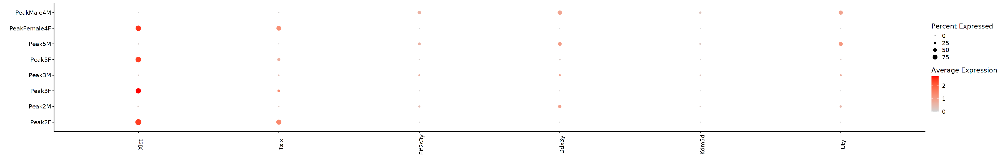

In [818]:
options(repr.plot.width=30, repr.plot.height=5)
plot <- DotPlot(tmp_sub, assay = "RNA", group.by = "orig.ident_Sex", scale=FALSE, cols = c("lightgrey", "red"), dot.scale = 5, features = rownames(res_top))
plot + theme(axis.text.x = element_text(angle = 90)) + labs(x = "", y= "")

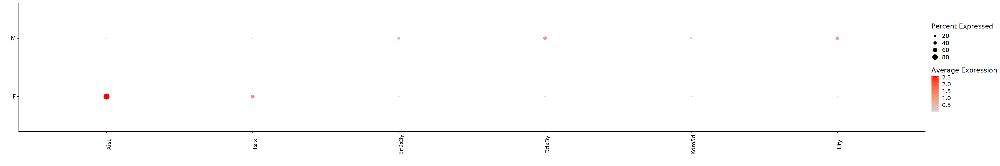

In [819]:
options(repr.plot.width=30, repr.plot.height=5)
plot <- DotPlot(tmp_sub, assay = "RNA", group.by = "Sex", scale=FALSE, cols = c("lightgrey", "red"), dot.scale = 5, features = rownames(res_top))
plot + theme(axis.text.x = element_text(angle = 90)) + labs(x = "", y= "")

In [820]:
HVGs.list[[cluster_choice]] <- rownames(res_filtered)

##### 3.2.4.4 Astro

In [821]:
cluster_choice <- "Astro"

In [822]:
table_sample_low <- table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$sample_id)[cluster_choice,][table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$sample_id)[cluster_choice,] <= 5]
table_sample_low

sample_keep <- names(timepoint_Sex_colors)[!names(timepoint_Sex_colors) %in% names(table_sample_low)]

Peak2F     Peak3F     Peak3M     Peak5F     Peak5M PeakMale4M 
         1          5          2          0          2          5

In [823]:
table_group_low <-table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$group_id)[cluster_choice,][table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$group_id)[cluster_choice,] <= 30]
table_group_low

group_keep <- names(sex_colors)[!names(sex_colors) %in% names(table_group_low)]

F  M 
15 23

In [824]:
#Not enough cells

##### 3.2.4.5 Summary

In [825]:
listInput_upset <- HVGs.list
listInput_upset[sapply(listInput_upset, is.null)] <- NULL

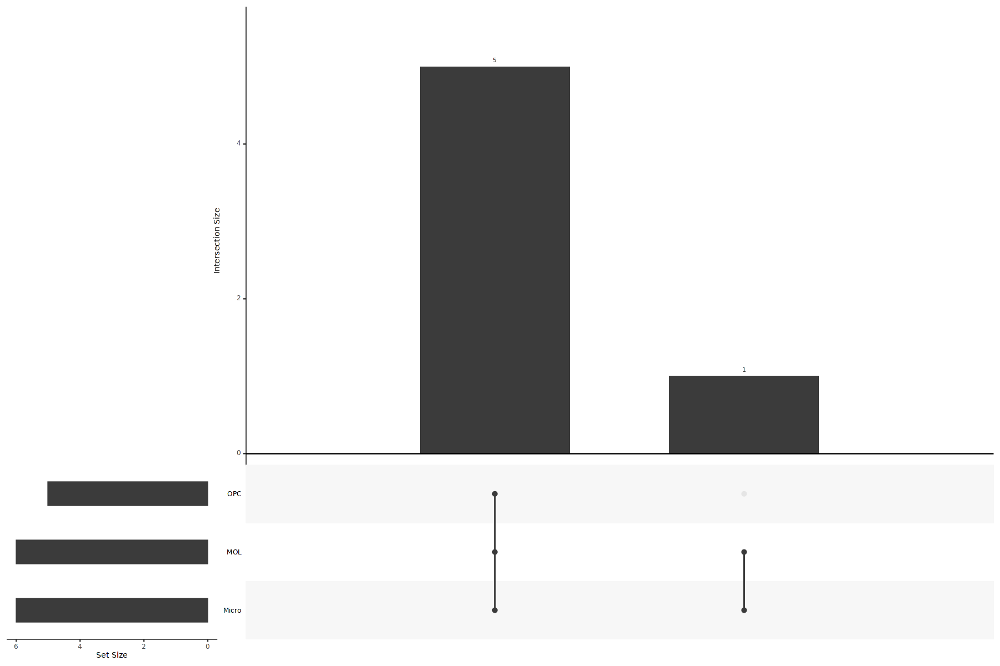

In [826]:
options(repr.plot.width=15, repr.plot.height=10)
upset(fromList(listInput_upset), order.by = "freq")

In [827]:
HVF <- unique(unlist(HVGs.list))

In [828]:
table_sample_low <- table(MORNAATACC_sce$sample_id)[table(MORNAATACC_sce$sample_id) <= 5]
table_group_low <- table(MORNAATACC_sce$group_id)[table(MORNAATACC_sce$group_id) <= 30]

In [829]:
#Remove sample with low number of cells
keepcells <- rownames(tmp@meta.data[!tmp$orig.ident %in% (names(table_sample_low)),])
tmp <- subset(tmp, cells=keepcells)

In [830]:
#Remove timepoint with low number of cells
keepcells <- rownames(tmp@meta.data[!tmp$orig.ident_Sex %in% (names(table_group_low)),])
tmp <- subset(tmp, cells=keepcells)

In [831]:
tmp <- NormalizeData(tmp, normalization.method = "LogNormalize", scale.factor = 10000, verbose = TRUE)

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


In [832]:
tmp <- ScaleData(tmp, features=rownames(tmp))

Centering and scaling data matrix

  |==========================================================================================| 100%


In [833]:
sub_timepoint_Sex_colors <- timepoint_Sex_colors[names(timepoint_Sex_colors) %in% names(table(tmp$orig.ident_Sex))]

In [834]:
tmp$orig.ident <- factor(x = tmp$orig.ident, levels = name_timepoint[!name_timepoint %in% names(table_sample_low)])
tmp$orig.ident_Sex <- factor(x = tmp$orig.ident_Sex, levels = names(sub_timepoint_Sex_colors)[!names(sub_timepoint_Sex_colors) %in% names(table_group_low)])

In [835]:
Idents(object = tmp) <- "orig.ident_Sex"

Warning message:
"CombinePlots is being deprecated. Plots should now be combined using the patchwork system."


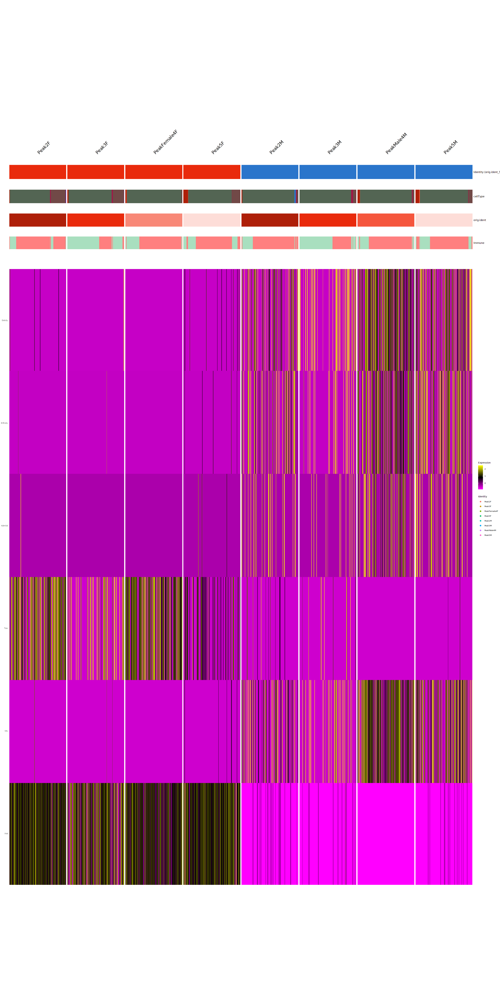

In [836]:
options(repr.plot.width=25, repr.plot.height=50)
DoMultiBarHeatmap(
    subset(tmp, downsample = 200),
    features = HVF,
    cells = NULL,
    group.by = "orig.ident_Sex",
    additional.group.by = c("cellType", "orig.ident", "Immune"),
    additional.group.sort.by = c("cellType", "orig.ident", "Immune"),
    cols.use = list(orig.ident_Sex=sub_timepoint_Sex_colors, cellType=cellType_colors, orig.ident=orig.ident_colors, Immune=immune_colors),
    group.bar = TRUE,
    disp.min = -2.5,
    disp.max = NULL,
    layer = "scale.data",
    assay = "RNA",
    label = TRUE,
    size = 5.5,
    hjust = 0,
    angle = 45,
    raster = TRUE,
    draw.lines = TRUE,
    lines.width = NULL,
    group.bar.height = 0.02,
    combine = TRUE
    ) + theme(text = element_text(size = 8))

In [837]:
sample_names <- levels(tmp$orig.ident_Sex)

In [838]:
gene_list <- HVF

In [839]:
tmp_markers <- as.data.frame(AggregateExpression(tmp, assays = "RNA", group.by = "orig.ident_Sex", normalization.method = "LogNormalize", scale.factor = 10000, return.seurat = TRUE)[["RNA"]]$data[gene_list,])

Centering and scaling data matrix

  |==========================================================================================| 100%
  |==========================================================================================| 100%


In [840]:
matrix <- tmp_markers/do.call(pmax, tmp_markers)

In [841]:
paletteLength <- 50
myColor <- colorRampPalette(c("#FFFFB3", "#5E3719"))(paletteLength/2)
myBreaks <- c(seq(0, max(matrix), length.out=floor(paletteLength/2)))

In [842]:
plot_height <- ifelse(as.integer(nrow(matrix)/20)<=5, 5, as.integer(nrow(matrix)/20))

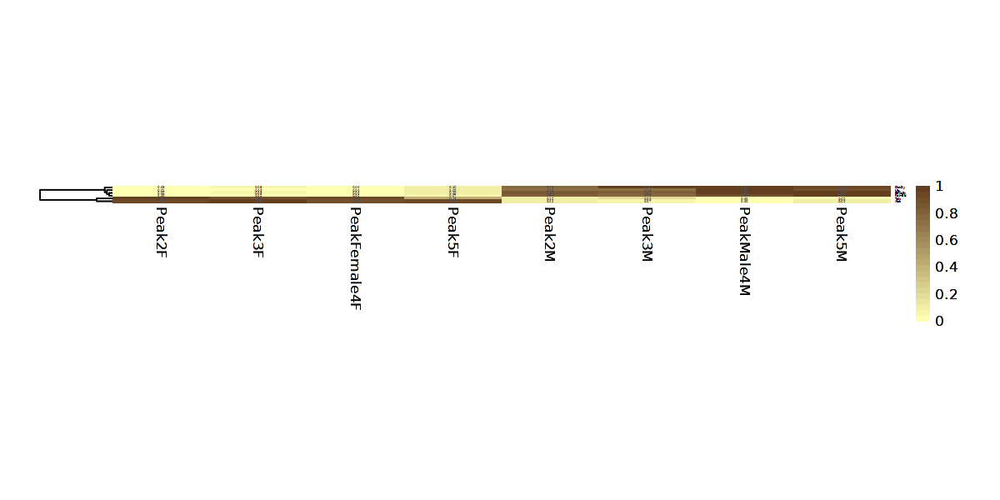

In [843]:
options(repr.plot.width=10, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = T, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=TRUE)
ph

In [844]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "DGE_Sex_sep_",timepoint,"_pseudobulk.pdf"), width=8, height=plot_height)

png 
  2

In [845]:
gene_list <- gene_list[ph$tree_row$order]

In [846]:
tmp_markers_mean <- data.frame(matrix(0L, ncol=1, nrow=length(gene_list), dimnames=list(gene_list, "Mean_Log2Exp")))

In [847]:
tmp_markers_mean[rownames(tmp_markers),"Mean_Log2Exp"] <- rowMeans(tmp_markers)

In [848]:
matrix <- tmp_markers_mean

In [849]:
paletteLength <- 50
myColor <- colorRampPalette(c("white", "black"))(paletteLength/2)
myBreaks <- c(seq(0, max(matrix), length.out=floor(paletteLength/2)))

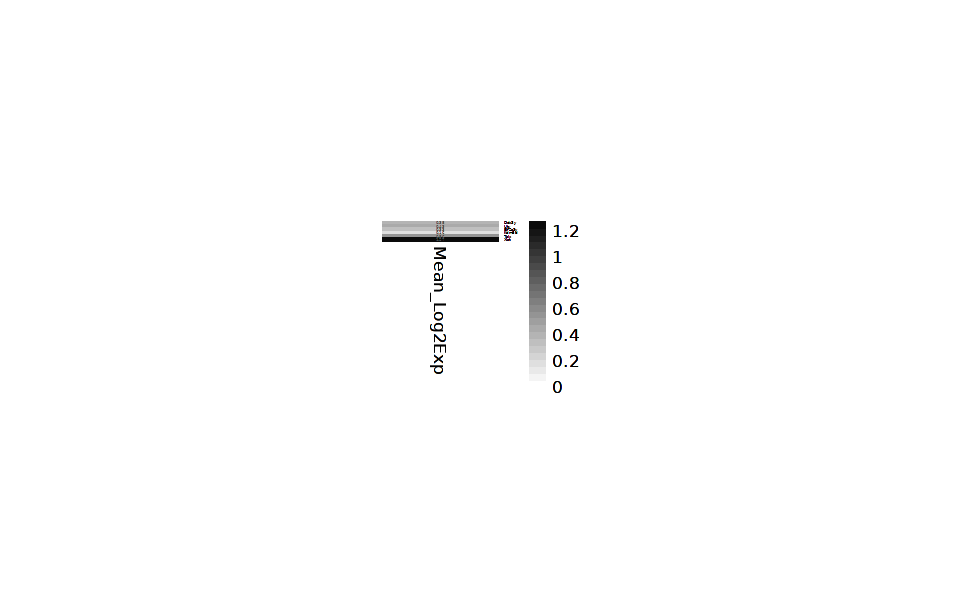

In [850]:
options(repr.plot.width=8, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = T, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=FALSE)
ph

In [851]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "DGE_Sex_sep_",timepoint,"_pseudobulk_mean.pdf"), width=8, height=plot_height)

png 
  2

In [852]:
tmp_markers_zscore <- t(apply(tmp_markers[gene_list,], 1, scale))
colnames(tmp_markers_zscore) <- paste0("zscore_", names(sub_timepoint_Sex_colors))
matrix <- tmp_markers_zscore

In [853]:
paletteLength <- 50
myColor <- colorRampPalette(c("blue", "white", "red"))(paletteLength/2)
myBreaks <- c(seq(min(matrix), max(matrix), length.out=floor(paletteLength/2)))

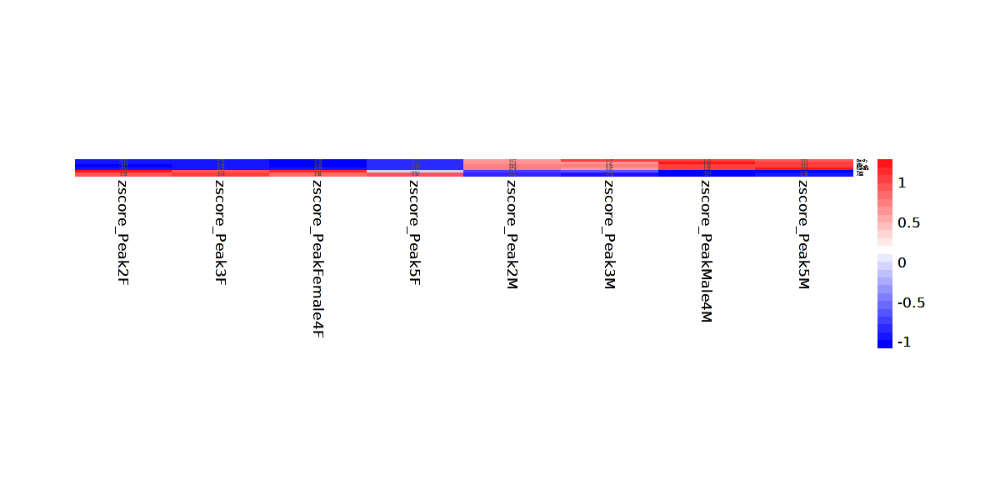

In [854]:
options(repr.plot.width=10, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = T, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=FALSE)
ph

In [855]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "DGE_Sex_sep_",timepoint,"_pseudobulk_zscore.pdf"), width=8, height=plot_height)

png 
  2

In [856]:
gene_list <- HVF

In [857]:
tmp_markers <- as.data.frame(AggregateExpression(tmp, assays = "RNA", group.by = "Sex", normalization.method = "LogNormalize", scale.factor = 10000, return.seurat = TRUE)[["RNA"]]$data[gene_list,])

Centering and scaling data matrix

  |==========================================================================================| 100%
  |==========================================================================================| 100%


In [858]:
matrix <- tmp_markers/do.call(pmax, tmp_markers)

In [859]:
paletteLength <- 50
myColor <- colorRampPalette(c("#FFFFB3", "#5E3719"))(paletteLength/2)
myBreaks <- c(seq(0, max(matrix), length.out=floor(paletteLength/2)))

In [860]:
plot_height <- ifelse(as.integer(nrow(matrix)/20) < 5, 5, as.integer(nrow(matrix)/20))

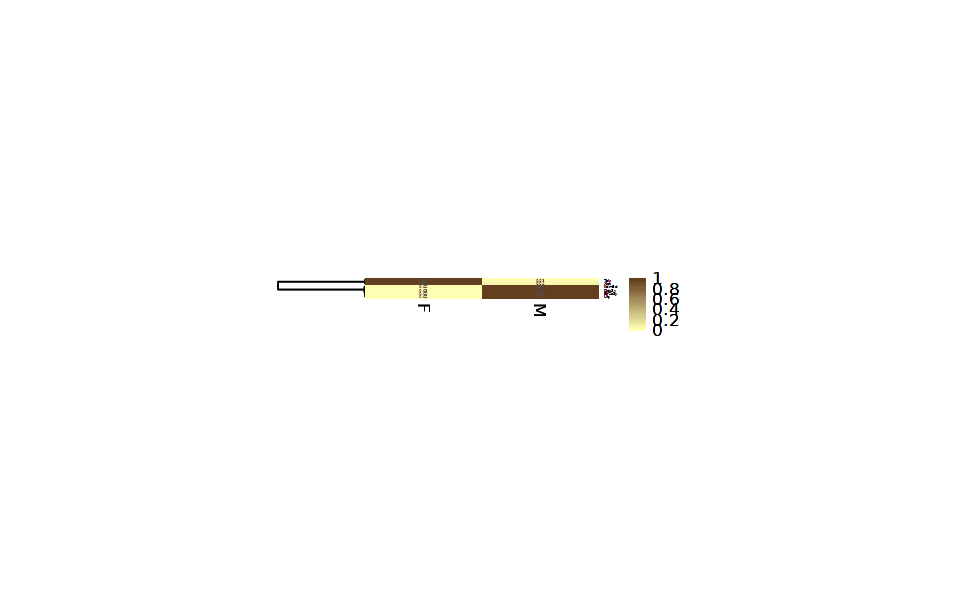

In [861]:
options(repr.plot.width=8, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = T, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=TRUE)
ph

In [862]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "DGE_Sex_",timepoint,"_pseudobulk.pdf"), width=8, height=plot_height)

png 
  2

In [863]:
gene_list <- gene_list[ph$tree_row$order]

In [864]:
tmp_markers_mean <- data.frame(matrix(0L, ncol=1, nrow=length(gene_list), dimnames=list(gene_list, "Mean_Log2Exp")))

In [865]:
tmp_markers_mean[rownames(tmp_markers),"Mean_Log2Exp"] <- rowMeans(tmp_markers)

In [866]:
matrix <- tmp_markers_mean

In [867]:
paletteLength <- 50
myColor <- colorRampPalette(c("white", "black"))(paletteLength/2)
myBreaks <- c(seq(0, max(matrix), length.out=floor(paletteLength/2)))

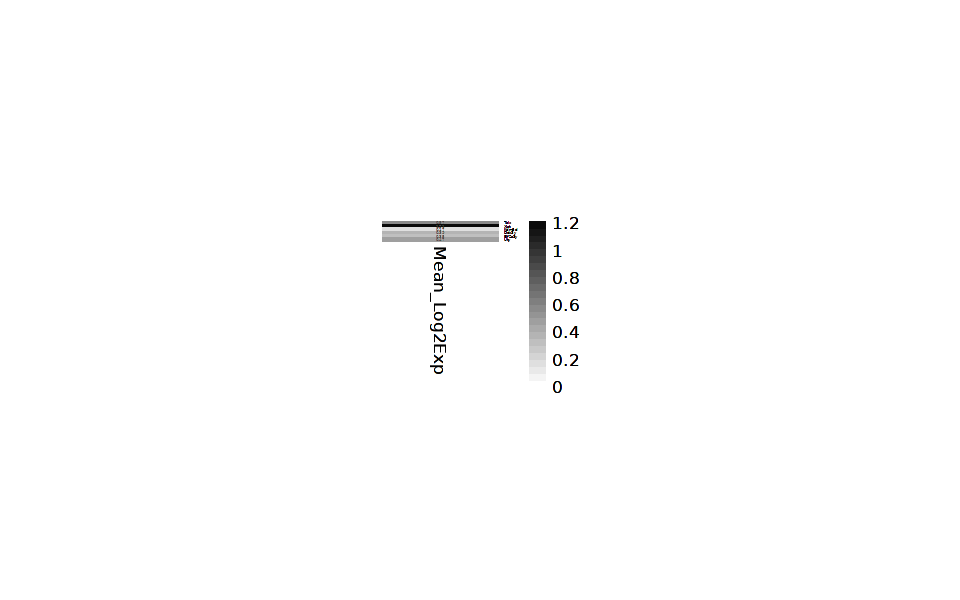

In [868]:
options(repr.plot.width=8, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = T, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=FALSE)
ph

In [869]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "DGE_Sex_",timepoint,"_pseudobulk_mean.pdf"), width=8, height=plot_height)

png 
  2

In [870]:
tmp_markers_zscore <- t(apply(tmp_markers[gene_list,], 1, scale))
colnames(tmp_markers_zscore) <- paste0("zscore_", names(sex_colors))
matrix <- tmp_markers_zscore

In [871]:
paletteLength <- 50
myColor <- colorRampPalette(c("blue", "white", "red"))(paletteLength/2)
myBreaks <- c(seq(min(matrix), max(matrix), length.out=floor(paletteLength/2)))

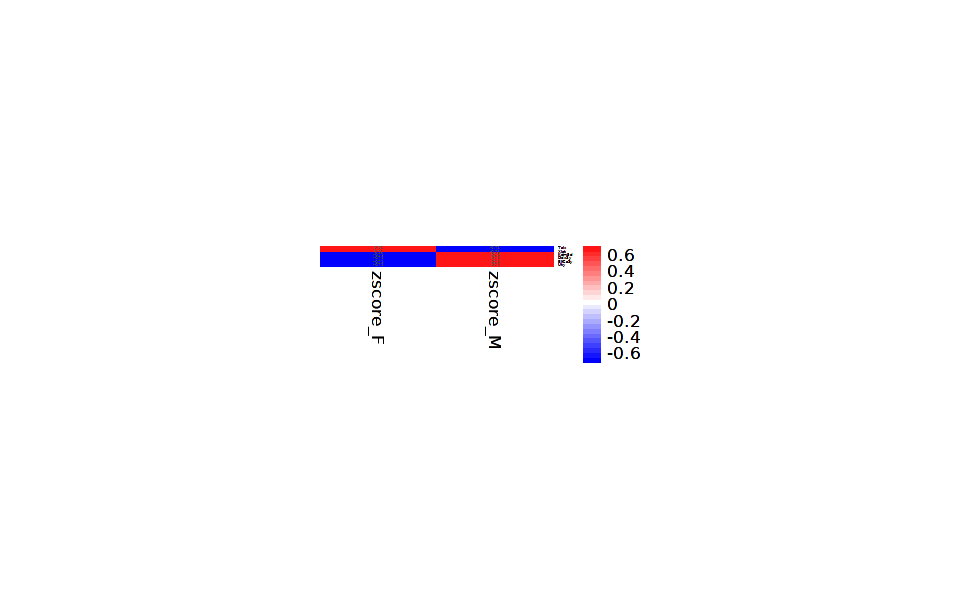

In [872]:
options(repr.plot.width=8, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = T, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=FALSE)
ph

In [873]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "DGE_Sex_",timepoint,"_pseudobulk_zscore.pdf"), width=8, height=plot_height)

png 
  2

#### 3.2.5 Late

In [874]:
timepoint <- "Late"
name_timepoint <- names_Late

In [875]:
tmp <- subset(MORNAATACC, subset = orig.ident_merge == timepoint)

In [876]:
tmp <- NormalizeData(tmp, normalization.method = "LogNormalize", scale.factor = 10000, verbose = TRUE)

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


In [877]:
tmp <- ScaleData(tmp, features=rownames(tmp))

Centering and scaling data matrix

  |==========================================================================================| 100%


In [878]:
timepoint_Sex_colors <- c(rep(sex_colors["F"], length(name_timepoint)),rep(sex_colors["M"], length(name_timepoint)))
df_timepoint_Sex <- expand.grid(name_timepoint, names(sex_colors))
names(timepoint_Sex_colors) <- paste0(df_timepoint_Sex[,1],df_timepoint_Sex[,2])

In [879]:
tmp$orig.ident_Sex <- paste0(tmp$orig.ident,tmp$Sex)
tmp$orig.ident_Sex <- factor(paste0(tmp$orig.ident,tmp$Sex), levels=names(table(tmp$orig.ident_Sex)))

In [880]:
tmp$orig.ident <- factor(tmp$orig.ident, levels=name_timepoint)
tmp$cellType <- factor(tmp$cellType, levels=names(cellType_colors))
tmp$Sex <- factor(tmp$Sex, levels=names(sex_colors))

In [881]:
table(tmp$cellType, tmp$orig.ident_Sex)

        
         Late1F Late1M Late2F Late2M Late3F Late3M Late5F Late5M LateFemale4F LateMale4M
  OPC         3      5     10     68      9     12    260    313          505        210
  COP         0      0      0      7      2      5     30     39          290        248
  MOL      1437   3000    590    792   1242   2658   2815   2704         9054       4397
  Astro       7      6      6      0      5     11     14      2           19          6
  Epen        5      3      5      2      2     13      1      0           63         38
  Micro      22     19     70    132    121    227     25     11          139         73
  Neuron      5      3      0      0      0      3      1      1            2          1

In [882]:
table(tmp$cellType, tmp$Sex)

        
             F     M
  OPC      787   608
  COP      322   299
  MOL    15138 13551
  Astro     51    25
  Epen      76    56
  Micro    377   462
  Neuron     8     8

In [883]:
table(tmp$orig.ident_Sex, tmp$Sex)

              
                   F     M
  Late1F        1479     0
  Late1M           0  3036
  Late2F         681     0
  Late2M           0  1001
  Late3F        1381     0
  Late3M           0  2929
  Late5F        3146     0
  Late5M           0  3070
  LateFemale4F 10072     0
  LateMale4M       0  4973

In [884]:
MORNAATACC_sce <- as.SingleCellExperiment(tmp, assay="RNA")

In [885]:
MORNAATACC_sce <- prepSCE(MORNAATACC_sce, kid = "cellType", gid = "Sex", sid = "orig.ident_Sex", drop = FALSE)

In [886]:
kids <- purrr::set_names(levels(MORNAATACC_sce$cluster_id))

# Total number of clusters
nk <- length(kids)

# Named vector of sample names
sids <- purrr::set_names(levels(MORNAATACC_sce$sample_id))

# Total number of samples 
ns <- length(sids)

In [887]:
kids
sids

OPC      COP      MOL    Astro     Epen    Micro   Neuron 
   "OPC"    "COP"    "MOL"  "Astro"   "Epen"  "Micro" "Neuron"

Late1F         Late1M         Late2F         Late2M         Late3F         Late3M 
      "Late1F"       "Late1M"       "Late2F"       "Late2M"       "Late3F"       "Late3M" 
        Late5F         Late5M   LateFemale4F     LateMale4M 
      "Late5F"       "Late5M" "LateFemale4F"   "LateMale4M"

In [888]:
## Determine the number of cells per sample
table(MORNAATACC_sce$sample_id)

## Turn named vector into a numeric vector of number of cells per sample
n_cells <- as.numeric(table(MORNAATACC_sce$sample_id))

## Determine how to reoder the samples (rows) of the metadata to match the order of sample names in sids vector
m <- match(sids, MORNAATACC_sce$sample_id)

## Create the sample level metadata by combining the reordered metadata with the number of cells corresponding to each sample.
ei <- data.frame(colData(MORNAATACC_sce)[m, ], n_cells, row.names = NULL) %>% select(-"cluster_id")
ei


      Late1F       Late1M       Late2F       Late2M       Late3F       Late3M       Late5F 
        1479         3036          681         1001         1381         2929         3146 
      Late5M LateFemale4F   LateMale4M 
        3070        10072         4973 

sample_id,group_id,orig.ident,nCount_RAW,nFeature_RAW,nCount_RNA,nFeature_RNA,nCount_ATAC,nFeature_ATAC,orig.ident_merge,batch,model,debrisRemoval,date_tissue_collection,date_experiment,nbMouse,EAE_score_mean,frequency_count,mononucleosomal,nucleosome_free,reads_count,percent.mt,log10GenesUMI,mitoRatio,S.Score,G2M.Score,Phase,CC.Difference,nucleosome_signal,nucleosome_percentile,TSS.enrichment,TSS.percentile,nCount_peaks,nFeature_peaks,FRiP,nCount_GenePromAcc,nFeature_GenePromAcc,pANN,DF.classifications,pct_chrY,pct_chrX,Xist_score,Sex_predictions,Sex_predictions_F,Sex_predictions_M,snn_RNA_res.1,seurat_clusters_RNA,snn_peaks_res.0.4,seurat_clusters_peaks,RNA.weight,⋯,pvalue_Naive.Tcell_cd8,Immune.Tcell_cd8,ImmuneScoreGenePromAcc,ImmuneScoreScaledGenePromAcc,zscore_NaiveGenePromAcc,pvalue_NaiveGenePromAcc,ImmuneGenePromAcc,ImmuneScoreGenePromAcc.complement,ImmuneScoreScaledGenePromAcc.complement,zscore_NaiveGenePromAcc.complement,pvalue_NaiveGenePromAcc.complement,ImmuneGenePromAcc.complement,ImmuneScoreGenePromAcc.pos_reg_imm_response,ImmuneScoreScaledGenePromAcc.pos_reg_imm_response,zscore_NaiveGenePromAcc.pos_reg_imm_response,pvalue_NaiveGenePromAcc.pos_reg_imm_response,ImmuneGenePromAcc.pos_reg_imm_response,ImmuneScoreGenePromAcc.neg_reg_imm_response,ImmuneScoreScaledGenePromAcc.neg_reg_imm_response,zscore_NaiveGenePromAcc.neg_reg_imm_response,pvalue_NaiveGenePromAcc.neg_reg_imm_response,ImmuneGenePromAcc.neg_reg_imm_response,ImmuneScoreGenePromAcc.antig_proc_presen,ImmuneScoreScaledGenePromAcc.antig_proc_presen,zscore_NaiveGenePromAcc.antig_proc_presen,pvalue_NaiveGenePromAcc.antig_proc_presen,ImmuneGenePromAcc.antig_proc_presen,ImmuneScoreGenePromAcc.pos_reg_int_media,ImmuneScoreScaledGenePromAcc.pos_reg_int_media,zscore_NaiveGenePromAcc.pos_reg_int_media,pvalue_NaiveGenePromAcc.pos_reg_int_media,ImmuneGenePromAcc.pos_reg_int_media,ImmuneScoreGenePromAcc.reg_cyto_prod,ImmuneScoreScaledGenePromAcc.reg_cyto_prod,zscore_NaiveGenePromAcc.reg_cyto_prod,pvalue_NaiveGenePromAcc.reg_cyto_prod,ImmuneGenePromAcc.reg_cyto_prod,ImmuneScoreGenePromAcc.Tcell_cd4,ImmuneScoreScaledGenePromAcc.Tcell_cd4,zscore_NaiveGenePromAcc.Tcell_cd4,pvalue_NaiveGenePromAcc.Tcell_cd4,ImmuneGenePromAcc.Tcell_cd4,ImmuneScoreGenePromAcc.Tcell_cd8,ImmuneScoreScaledGenePromAcc.Tcell_cd8,zscore_NaiveGenePromAcc.Tcell_cd8,pvalue_NaiveGenePromAcc.Tcell_cd8,ImmuneGenePromAcc.Tcell_cd8,ImmuneAll,ident,n_cells
<fct>,<fct>,<fct>,<dbl>,<int>,<dbl>,<int>,<dbl>,<int>,<fct>,<fct>,<fct>,<fct>,<fct>,<fct>,<chr>,<fct>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<int>,<dbl>,<dbl>,<int>,<dbl>,<chr>,<dbl>,<dbl>,<dbl>,<chr>,<dbl>,<dbl>,<fct>,<fct>,<fct>,<fct>,<dbl>,⋯,<dbl>,<fct>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<chr>,<fct>,<dbl>
Late1F,F,Late1,4582,1961,4275,1877,22183,9622,Late,B2,EAE,Percoll,2021_05_31,2021_04_20,2,2.25,31144,10748,12417,111039,4.514620,0.9015483,0.04514620,0.003887269,0.006334057,G2M,-0.002446788,0.8706140,0.88,4.309839,0.02,12979,9440,0.4167416,20344,7895,0.03333333,Singlet,0.0000000000,0.03508772,8.075,F,1.0000,0.0000,4,4,4,4,3.613654e-03,⋯,0.03803514,Immune,0.038935842,0.7789968,3.51007428,0.0002239908,Immune,0.068427958,0.6594356,3.29559228,0.0004910722,Immune,-0.026672047,0.3752511,-0.2384356,5.942284e-01,NonImmune,0.052185833,0.5538597,1.7124645,0.04340555,Immune,7.472444e-03,0.4328352,1.1256130,0.1301647,NonImmune,0.029532426,0.4776478,1.78688577,0.03697798,Immune,0.065243588,0.4846827,2.2030268,0.0137964287,Immune,0.036212028,0.3977761,0.8385845,0.2008513,NonImmune,-0.043488069,0.2836391,-0.5449817,0.70711696,NonImmune,GenePromAcc,F,1479
Late1M,M,Late1,9776,3323,9720,3320,32135,12072,Late,B2,EAE,Percoll,2021_05_31,2021_04_20,2,2.25,24153,8165,10442,86167,5.432099

In [889]:
## Remove lowly accessible features which have less than 10 cells with any counts
MORNAATACC_sce <- MORNAATACC_sce[rowSums(counts(MORNAATACC_sce) > 1) >= 10, ]

In [890]:
# Aggregate the counts per sample_id and cluster_id

# Subset metadata to only include the cluster and sample IDs to aggregate across
groups <- colData(MORNAATACC_sce)[, c("cluster_id", "sample_id")]

# Aggregate across cluster-sample groups
pb <- aggregate.Matrix(t(counts(MORNAATACC_sce)), groupings = groups, fun = "sum") 

In [891]:
splitf <- sapply(stringr::str_split(rownames(pb), pattern = "_", n = 2), `[`, 1)

In [892]:
pb <- split.data.frame(pb, factor(splitf)) %>% lapply(function(u) set_colnames(t(u), stringr::str_extract(rownames(u), "(?<=_)[:alnum:]+")))

class(pb)

# Explore the different components of list
str(pb)

[1] "list"

List of 7
 $ Astro :Formal class 'dgCMatrix' [package "Matrix"] with 6 slots
  .. ..@ i       : int [1:57251] 3 5 6 10 12 15 23 31 33 38 ...
  .. ..@ p       : int [1:10] 0 7064 12286 17647 23841 31348 38240 44089 51771 57251
  .. ..@ Dim     : int [1:2] 15013 9
  .. ..@ Dimnames:List of 2
  .. .. ..$ : chr [1:15013] "0610009B22Rik" "0610009E02Rik" "0610009L18Rik" "0610010F05Rik" ...
  .. .. ..$ : chr [1:9] "Late1F" "Late1M" "Late2F" "Late3F" ...
  .. ..@ x       : num [1:57251] 1 1 4 3 4 1 5 2 1 3 ...
  .. ..@ factors : list()
 $ COP   :Formal class 'dgCMatrix' [package "Matrix"] with 6 slots
  .. ..@ i       : int [1:74404] 0 2 3 5 6 7 9 11 12 13 ...
  .. ..@ p       : int [1:8] 0 9309 14777 22579 34482 46677 60610 74404
  .. ..@ Dim     : int [1:2] 15013 7
  .. ..@ Dimnames:List of 2
  .. .. ..$ : chr [1:15013] "0610009B22Rik" "0610009E02Rik" "0610009L18Rik" "0610010F05Rik" ...
  .. .. ..$ : chr [1:7] "Late2M" "Late3F" "Late3M" "Late5F" ...
  .. ..@ x       : num [1:74404] 3 1 5 2 1

In [893]:
options(width = 100)
table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$group_id)

        
             F     M
  OPC      787   608
  COP      322   299
  MOL    15138 13551
  Astro     51    25
  Epen      76    56
  Micro    377   462
  Neuron     8     8

In [894]:
options(width = 100)
table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$sample_id)

        
         Late1F Late1M Late2F Late2M Late3F Late3M Late5F Late5M LateFemale4F LateMale4M
  OPC         3      5     10     68      9     12    260    313          505        210
  COP         0      0      0      7      2      5     30     39          290        248
  MOL      1437   3000    590    792   1242   2658   2815   2704         9054       4397
  Astro       7      6      6      0      5     11     14      2           19          6
  Epen        5      3      5      2      2     13      1      0           63         38
  Micro      22     19     70    132    121    227     25     11          139         73
  Neuron      5      3      0      0      0      3      1      1            2          1

In [895]:
# Get sample names for each of the cell type clusters

# prep. data.frame for plotting
get_sample_ids <- function(x){pb[[x]] %>% colnames()}

de_samples <- purrr::map(1:length(kids), get_sample_ids) %>% unlist()

In [896]:
samples_list <- purrr::map(1:length(kids), get_sample_ids)

get_cluster_ids <- function(x){rep(names(pb)[x],each = length(samples_list[[x]]))}

de_cluster_ids <- purrr::map(1:length(kids), get_cluster_ids) %>% unlist()

In [897]:
combinaison_debris_sample <- unique(paste(colData(MORNAATACC_sce)$sample_id, colData(MORNAATACC_sce)$debrisRemoval, sep="_"))

In [898]:
de_debris_ids <- mapvalues(de_samples, 
from=unlist(lapply(strsplit(combinaison_debris_sample, "_"), function(x){x[1]})),
to=unlist(lapply(strsplit(combinaison_debris_sample, "_"), function(x){x[2]})))

In [899]:
gg_df <- data.frame(cluster_id = de_cluster_ids, sample_id = de_samples, debris_id=de_debris_ids)

gg_df <- left_join(gg_df, ei[, c("sample_id", "group_id")]) 

metadata <- gg_df %>% dplyr::select(cluster_id, sample_id, group_id, debris_id) 

Joining with `by = join_by(sample_id)`


In [900]:
levels(metadata$cluster_id) <- unique(metadata$cluster_id)

In [901]:
# Generate vector of cluster IDs
clusters <- levels(metadata$cluster_id)
clusters

[1] "Astro"  "COP"    "Epen"   "MOL"    "Micro"  "Neuron" "OPC"

In [902]:
HVGs.list <- list()

##### 3.2.5.1 MOL

In [903]:
cluster_choice <- "MOL"

In [904]:
table_sample_low <- table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$sample_id)[cluster_choice,][table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$sample_id)[cluster_choice,] <= 5]
table_sample_low

sample_keep <- names(timepoint_Sex_colors)[!names(timepoint_Sex_colors) %in% names(table_sample_low)]

named integer(0)

In [905]:
table_group_low <-table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$group_id)[cluster_choice,][table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$group_id)[cluster_choice,] <= 30]
table_group_low

group_keep <- names(sex_colors)[!names(sex_colors) %in% names(table_group_low)]

named integer(0)

In [906]:
cluster_metadata <- metadata[which(metadata$cluster_id == cluster_choice), ]

# Assign the rownames of the metadata to be the sample IDs
rownames(cluster_metadata) <- cluster_metadata$sample_id

In [907]:
#Remove sample and timepoint with low counts (sample<=5, timepoint<=30)
cluster_metadata <- cluster_metadata[(cluster_metadata$sample_id %in% sample_keep & cluster_metadata$group_id %in% group_keep),]

#new_sample_levels <- levels(cluster_metadata$sample_id)[levels(cluster_metadata$sample_id) %in% sample_keep]
#cluster_metadata$sample_id <- droplevels(cluster_metadata$sample_id)
#levels(cluster_metadata$sample_id) <- new_sample_levels

new_group_levels <- levels(cluster_metadata$group_id)[levels(cluster_metadata$group_id) %in% group_keep]
cluster_metadata$group_id <- droplevels(cluster_metadata$group_id)
levels(cluster_metadata$group_id) <- new_group_levels

In [908]:
cluster_metadata

,cluster_id,sample_id,group_id,debris_id
,<chr>,<chr>,<fct>,<chr>
Late1F,MOL,Late1F,F,Percoll
Late1M,MOL,Late1M,M,Percoll
Late2F,MOL,Late2F,F,Percoll
Late2M,MOL,Late2M,M,Percoll
Late3F,MOL,Late3F,F,Percoll
Late3M,MOL,Late3M,M,Percoll
Late5F,MOL,Late5F,F,Debris
Late5M,MOL,Late5M,M,Debris
LateFemale4F,MOL,LateFemale4F,F,Debris


In [909]:
# Subset the counts to only this cluster
counts <- pb[[cluster_choice]]

cluster_counts <- data.frame(counts[, which(colnames(counts) %in% rownames(cluster_metadata))])

# Check that all of the row names of the metadata are the same and in the same order as the column names of the counts in order to use as input to DESeq2
all(rownames(cluster_metadata) == colnames(cluster_counts))

[1] TRUE

In [910]:
dds <- DESeqDataSetFromMatrix(cluster_counts, colData = cluster_metadata, design = ~ group_id + debris_id)

converting counts to integer mode

Warning message in DESeqDataSet(se, design = design, ignoreRank):
"some variables in design formula are characters, converting to factors"


In [911]:
# Transform counts for data visualization
rld <- rlog(dds, blind=TRUE)

using ntop=500 top features by variance



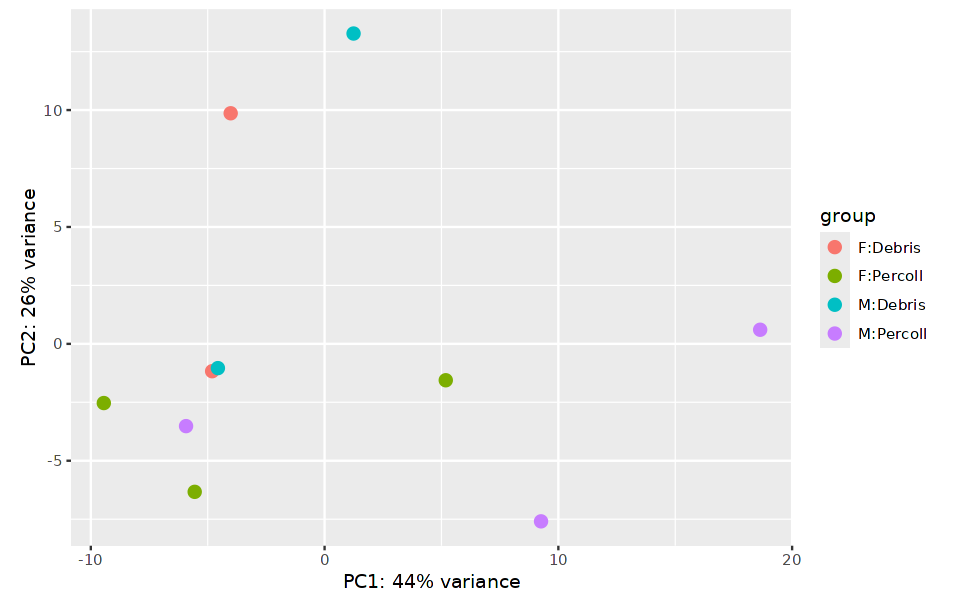

In [912]:
# Plot PCA
options(repr.plot.width=8, repr.plot.height=5)
DESeq2::plotPCA(rld, intgroup = c("group_id", "debris_id"))

In [913]:
# Extract the rlog matrix from the object and compute pairwise correlation values
rld_mat <- assay(rld)
rld_cor <- cor(rld_mat)

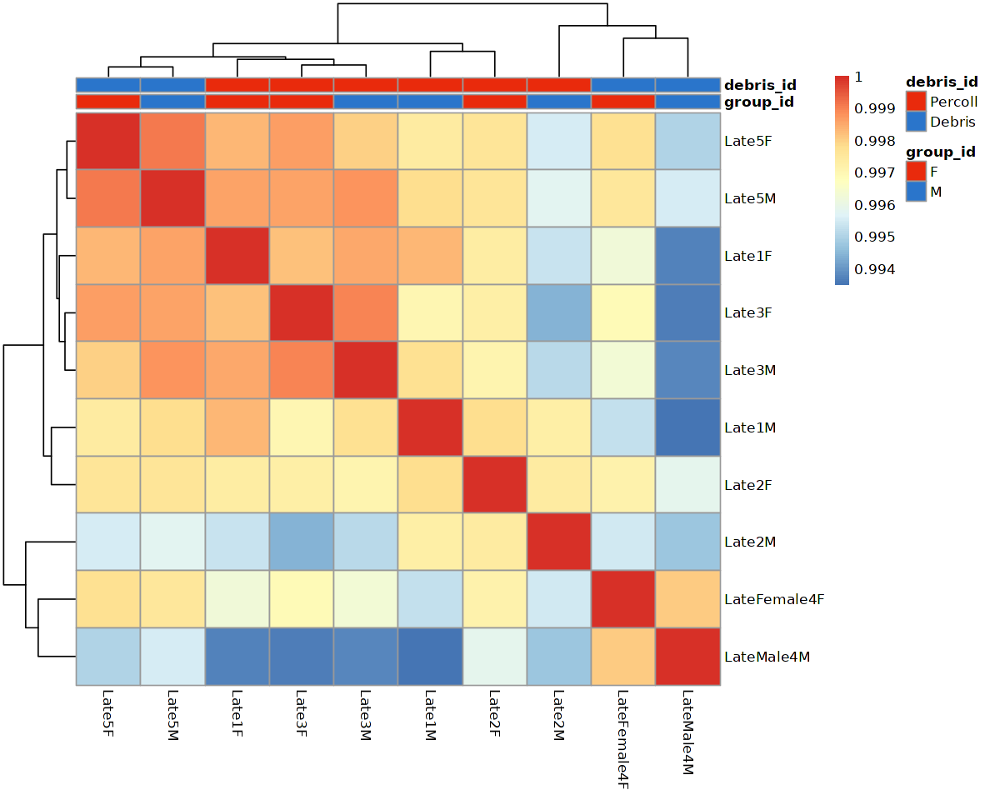

In [914]:
# Plot heatmap
options(repr.plot.width=10, repr.plot.height=8)
pheatmap(rld_cor, annotation = cluster_metadata[, c("group_id","debris_id"), drop=F], annotation_colors = list(group_id=sex_colors, debris_id=debris_colors))

In [915]:
# Run DESeq2 differential expression analysis
dds <- DESeq(dds)

estimating size factors

estimating dispersions

gene-wise dispersion estimates

mean-dispersion relationship

final dispersion estimates

fitting model and testing



In [916]:
libsize = data.frame(x=sizeFactors(dds), y=colSums(assay(dds)))

`geom_smooth()` using formula = 'y ~ x'


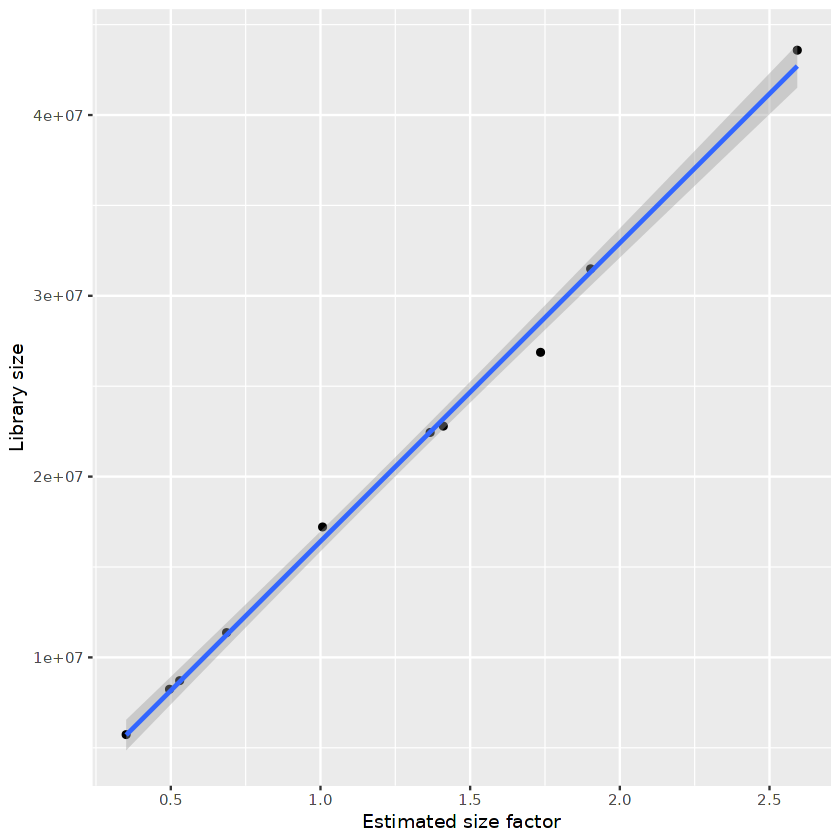

In [917]:
options(repr.plot.width=7, repr.plot.height=7)
ggplot(data=libsize, aes(x=x, y=y)) + geom_point() + geom_smooth(method="lm") + xlab("Estimated size factor") + ylab("Library size")

In [918]:
data.frame(colData(dds))

,cluster_id,sample_id,group_id,debris_id,sizeFactor
,<chr>,<chr>,<fct>,<fct>,<dbl>
Late1F,MOL,Late1F,F,Percoll,0.6862890
Late1M,MOL,Late1M,M,Percoll,1.4103370
Late2F,MOL,Late2F,F,Percoll,0.3507934
Late2M,MOL,Late2M,M,Percoll,0.5295928
Late3F,MOL,Late3F,F,Percoll,0.4956448
Late3M,MOL,Late3M,M,Percoll,1.0069853
Late5F,MOL,Late5F,F,Debris,1.7351885
Late5M,MOL,Late5M,M,Debris,1.3663861
LateFemale4F,MOL,LateFemale4F,F,Debris,2.5928973


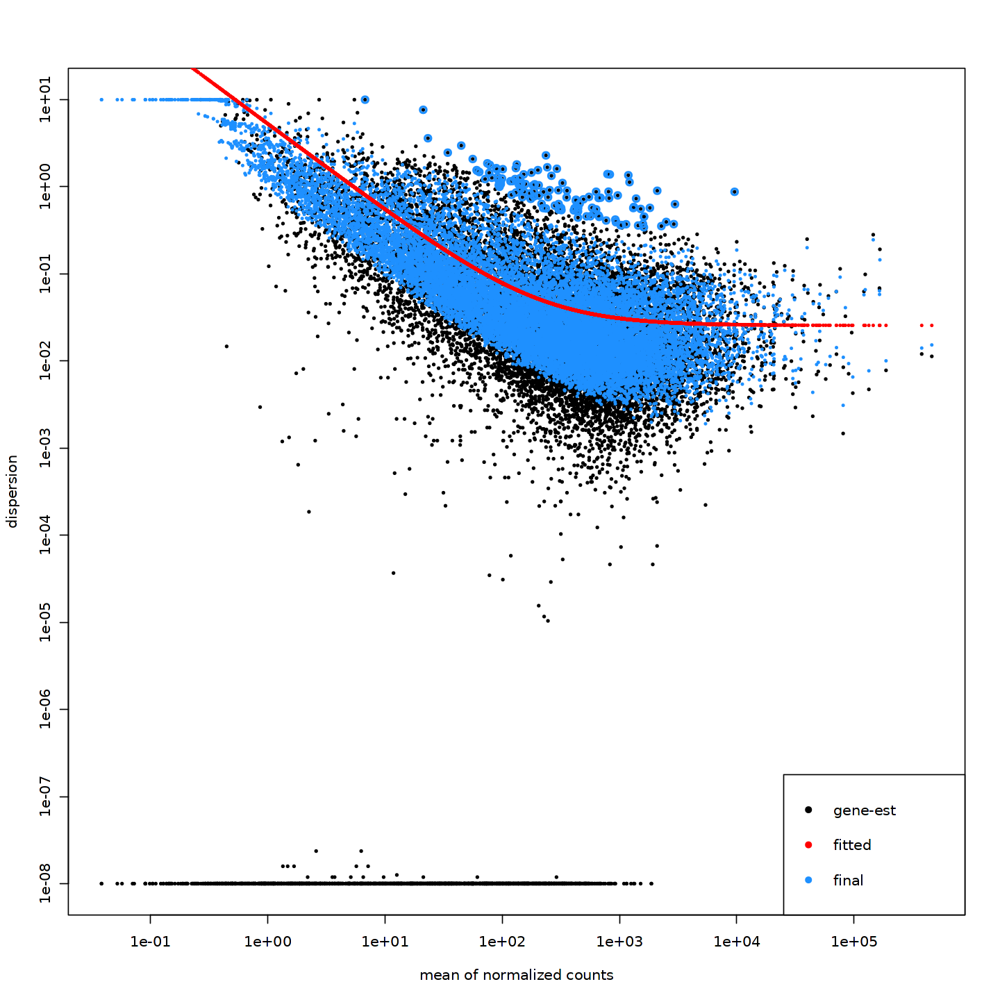

In [919]:
# Plot dispersion estimates
options(repr.plot.width=12, repr.plot.height=12)
plotDispEsts(dds)

In [920]:
condition1 = "M"
condition2 = "F"

In [921]:
contrast <- c("group_id", condition1, condition2)

# resultsNames(dds)
res <- results(dds, contrast = contrast, alpha = 0.05)

In [922]:
summary(res)


out of 15010 with nonzero total read count
adjusted p-value < 0.05
LFC > 0 (up)       : 4, 0.027%
LFC < 0 (down)     : 3, 0.02%
outliers [1]       : 11, 0.073%
low counts [2]     : 0, 0%
(mean count < 0)
[1] see 'cooksCutoff' argument of ?results
[2] see 'independentFiltering' argument of ?results



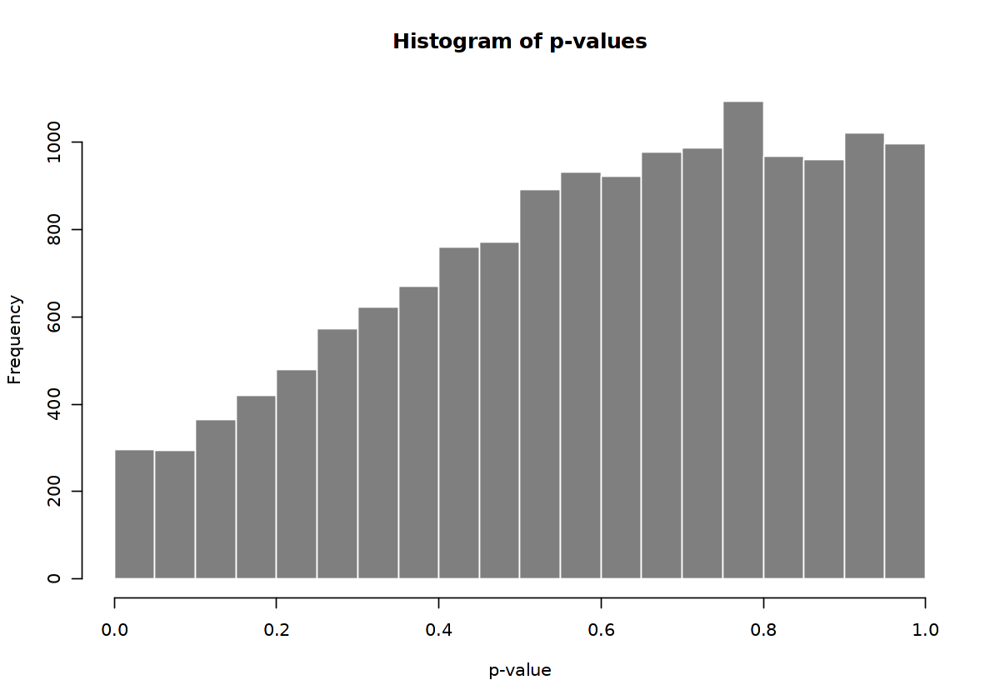

In [923]:
options(repr.plot.width=10, repr.plot.height=7)
hist(res$pvalue, breaks=0:20/20, col="grey50", border="white", xlim=c(0,1), main="Histogram of p-values", xlab="p-value")

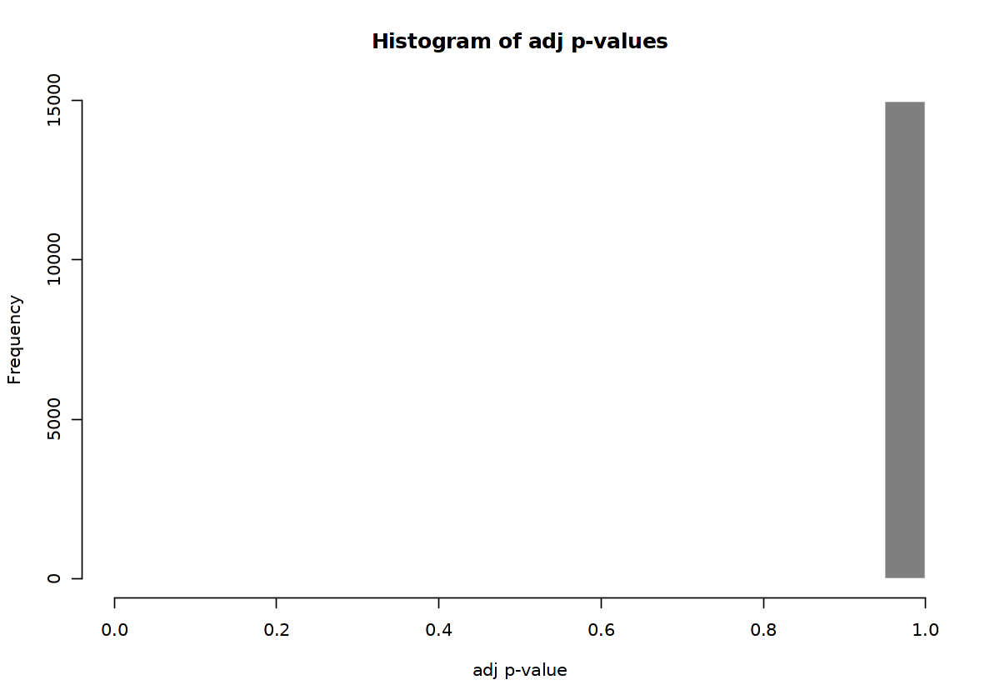

In [924]:
options(repr.plot.width=10, repr.plot.height=7)
hist(res$padj, breaks=0:20/20, col="grey50", border="white", xlim=c(0,1), main="Histogram of adj p-values", xlab="adj p-value")

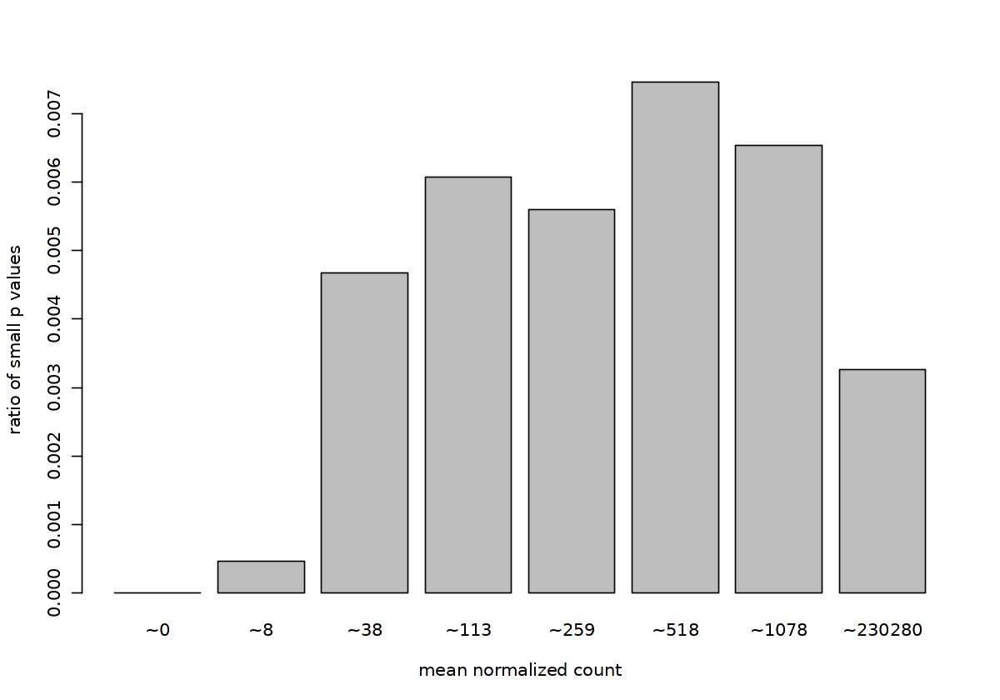

In [925]:
options(repr.plot.width=10, repr.plot.height=7)
qs <- c(0, quantile(res$baseMean[res$baseMean > 0], 0:7/7))
# cut the genes into the bins
bins <- cut(res$baseMean, qs)
# rename the levels of the bins using the middle point
levels(bins) <- paste0("~",round(.5*qs[-1] + .5*qs[-length(qs)]))
# calculate the ratio of $p$ values less than .01 for each bin
ratios <- tapply(res$pvalue, bins, function(p) mean(p < .01, na.rm=TRUE))
# plot these ratios
barplot(ratios, xlab="mean normalized count", ylab="ratio of small p values")

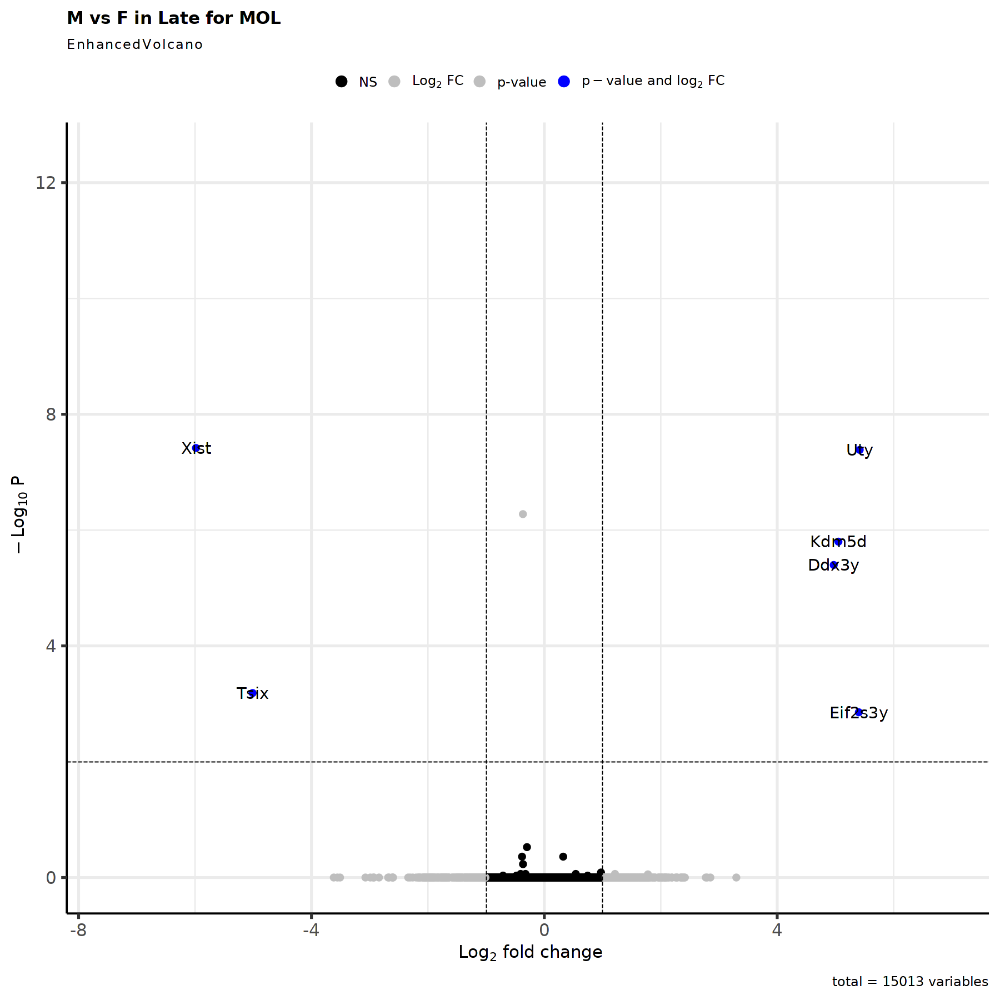

In [926]:
options(repr.plot.width=15, repr.plot.height=15)
#padj<0.001
EnhancedVolcano(res,
    lab = rownames(res),
    x = 'log2FoldChange',
    y = 'padj',
    title = paste0('M vs F in ',timepoint,' for ', cluster_choice),
    pCutoff = 0.01,
    FCcutoff = 1,
    pointSize = 3.0,
    labSize = 6.0,
    col=c('black', 'grey', 'grey', 'blue'),
    colAlpha = 1)

In [927]:
res <- res[complete.cases(res$padj),]

In [928]:
res_filtered <- res[(res$padj < 0.01 & abs(res$log2FoldChange) > 1 & res$baseMean > 1),]

In [929]:
res_filtered[order(abs(res_filtered$log2FoldChange), decreasing=TRUE),]

log2 fold change (MLE): group_id M vs F 
Wald test p-value: group id M vs F 
DataFrame with 6 rows and 6 columns
         baseMean log2FoldChange     lfcSE      stat      pvalue        padj
        <numeric>      <numeric> <numeric> <numeric>   <numeric>   <numeric>
Xist     9576.793       -5.98380  0.854742  -7.00070 2.54678e-12 3.81991e-08
Uty      1387.365        5.41694  0.785949   6.89222 5.49283e-12 4.11935e-08
Eif2s3y   790.500        5.40217  1.085941   4.97465 6.53667e-07 1.40062e-03
Kdm5d     354.795        5.05166  0.808841   6.24556 4.22294e-10 1.58350e-06
Tsix     1218.425       -5.01099  0.973005  -5.15002 2.60465e-07 6.51119e-04
Ddx3y     967.024        4.97080  0.819846   6.06309 1.33529e-09 4.00561e-06

In [930]:
nrow(res_filtered)

[1] 6

In [931]:
top.genes.number <- ifelse(nrow(res_filtered)>100, 100, nrow(res_filtered))

In [932]:
res_top <- res_filtered[order(abs(res_filtered$log2FoldChange), decreasing=TRUE),][1:top.genes.number,]
res_top <- res_top[order(res_top$log2FoldChange, decreasing=FALSE),]

In [933]:
tmp_sub <- subset(tmp, subset = cellType == cluster_choice)

In [934]:
tmp_sub <- NormalizeData(tmp_sub, normalization.method = "LogNormalize", scale.factor = 10000, verbose = TRUE)

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


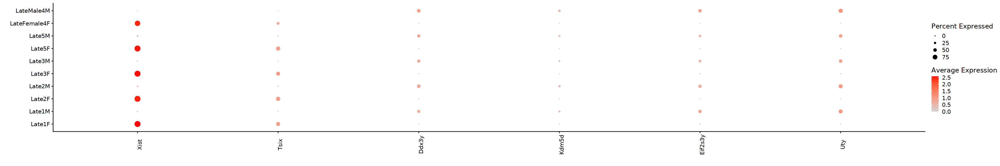

In [935]:
options(repr.plot.width=30, repr.plot.height=5)
plot <- DotPlot(tmp_sub, assay = "RNA", group.by = "orig.ident_Sex", scale=FALSE, cols = c("lightgrey", "red"), dot.scale = 5, features = rownames(res_top))
plot + theme(axis.text.x = element_text(angle = 90)) + labs(x = "", y= "")

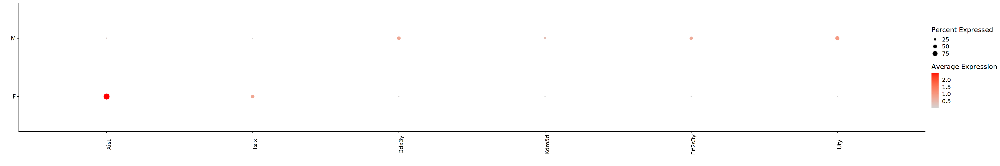

In [936]:
options(repr.plot.width=30, repr.plot.height=5)
plot <- DotPlot(tmp_sub, assay = "RNA", group.by = "Sex", scale=FALSE, cols = c("lightgrey", "red"), dot.scale = 5, features = rownames(res_top))
plot + theme(axis.text.x = element_text(angle = 90)) + labs(x = "", y= "")

In [937]:
HVGs.list[[cluster_choice]] <- rownames(res_filtered)

##### 3.2.5.2 OPC

In [938]:
cluster_choice <- "OPC"

In [939]:
table_sample_low <- table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$sample_id)[cluster_choice,][table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$sample_id)[cluster_choice,] <= 5]
table_sample_low

sample_keep <- names(timepoint_Sex_colors)[!names(timepoint_Sex_colors) %in% names(table_sample_low)]

Late1F Late1M 
     3      5

In [940]:
table_group_low <-table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$group_id)[cluster_choice,][table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$group_id)[cluster_choice,] <= 30]
table_group_low

group_keep <- names(sex_colors)[!names(sex_colors) %in% names(table_group_low)]

named integer(0)

In [941]:
cluster_metadata <- metadata[which(metadata$cluster_id == cluster_choice), ]

# Assign the rownames of the metadata to be the sample IDs
rownames(cluster_metadata) <- cluster_metadata$sample_id

In [942]:
#Remove sample and timepoint with low counts (sample<=5, timepoint<=30)
cluster_metadata <- cluster_metadata[(cluster_metadata$sample_id %in% sample_keep & cluster_metadata$group_id %in% group_keep),]

#new_sample_levels <- levels(cluster_metadata$sample_id)[levels(cluster_metadata$sample_id) %in% sample_keep]
#cluster_metadata$sample_id <- droplevels(cluster_metadata$sample_id)
#levels(cluster_metadata$sample_id) <- new_sample_levels

new_group_levels <- levels(cluster_metadata$group_id)[levels(cluster_metadata$group_id) %in% group_keep]
cluster_metadata$group_id <- droplevels(cluster_metadata$group_id)
levels(cluster_metadata$group_id) <- new_group_levels

In [943]:
cluster_metadata

,cluster_id,sample_id,group_id,debris_id
,<chr>,<chr>,<fct>,<chr>
Late2F,OPC,Late2F,F,Percoll
Late2M,OPC,Late2M,M,Percoll
Late3F,OPC,Late3F,F,Percoll
Late3M,OPC,Late3M,M,Percoll
Late5F,OPC,Late5F,F,Debris
Late5M,OPC,Late5M,M,Debris
LateFemale4F,OPC,LateFemale4F,F,Debris
LateMale4M,OPC,LateMale4M,M,Debris


In [944]:
# Subset the counts to only this cluster
counts <- pb[[cluster_choice]]

cluster_counts <- data.frame(counts[, which(colnames(counts) %in% rownames(cluster_metadata))])

# Check that all of the row names of the metadata are the same and in the same order as the column names of the counts in order to use as input to DESeq2
all(rownames(cluster_metadata) == colnames(cluster_counts))

[1] TRUE

In [945]:
dds <- DESeqDataSetFromMatrix(cluster_counts, colData = cluster_metadata, design = ~ group_id + debris_id)

converting counts to integer mode

Warning message in DESeqDataSet(se, design = design, ignoreRank):
"some variables in design formula are characters, converting to factors"


In [946]:
# Transform counts for data visualization
rld <- rlog(dds, blind=TRUE)

using ntop=500 top features by variance



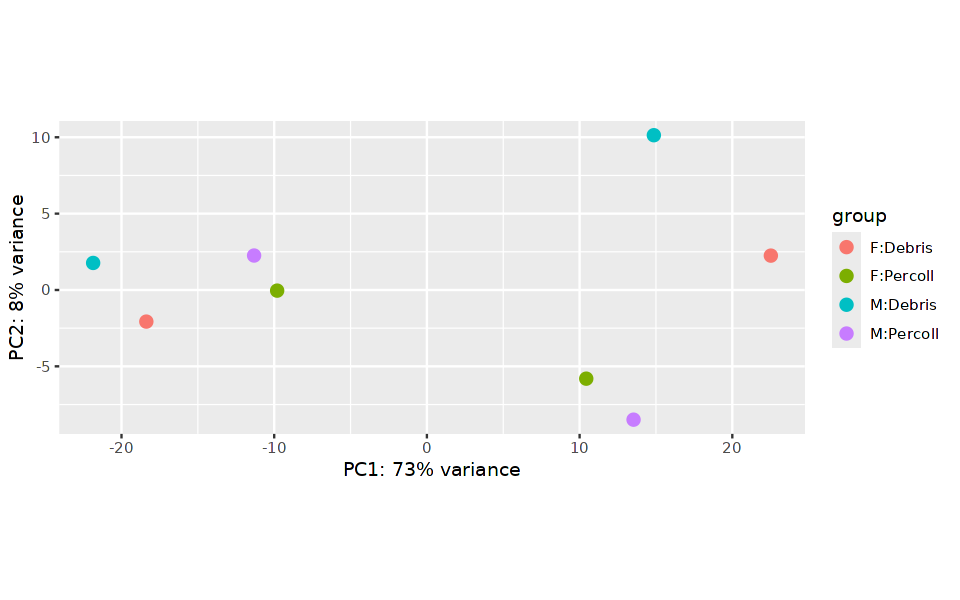

In [947]:
# Plot PCA
options(repr.plot.width=8, repr.plot.height=5)
DESeq2::plotPCA(rld, intgroup = c("group_id", "debris_id"))

In [948]:
# Extract the rlog matrix from the object and compute pairwise correlation values
rld_mat <- assay(rld)
rld_cor <- cor(rld_mat)

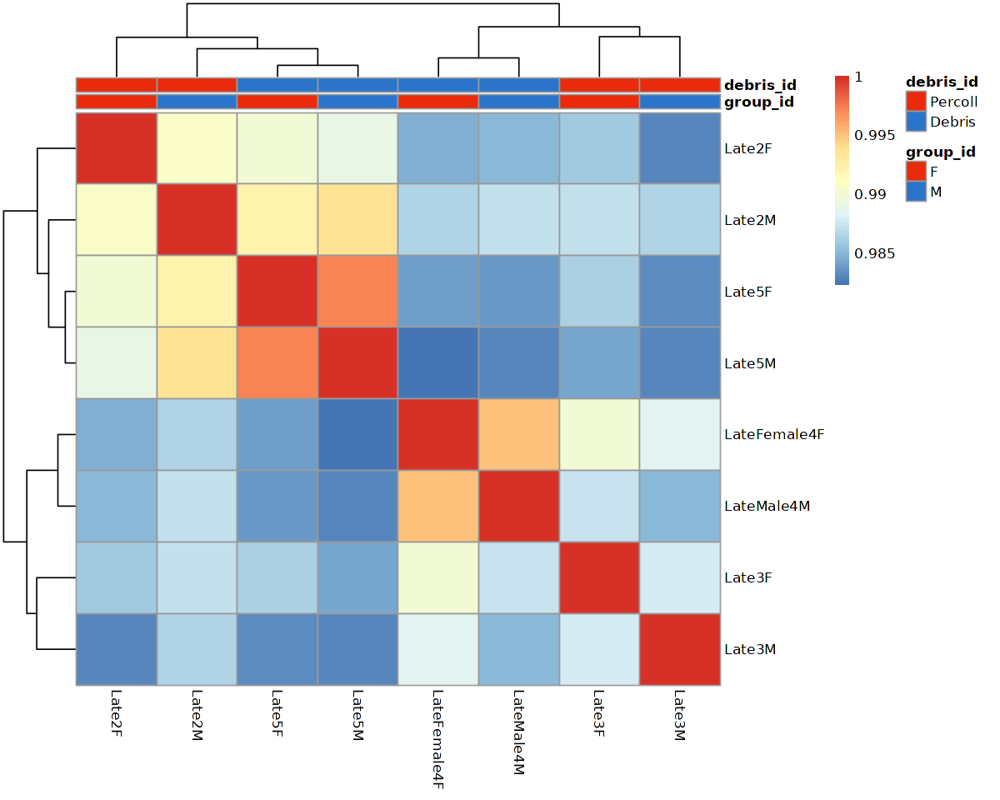

In [949]:
# Plot heatmap
options(repr.plot.width=10, repr.plot.height=8)
pheatmap(rld_cor, annotation = cluster_metadata[, c("group_id","debris_id"), drop=F], annotation_colors = list(group_id=sex_colors, debris_id=debris_colors))

In [950]:
# Run DESeq2 differential expression analysis
dds <- DESeq(dds)

estimating size factors

estimating dispersions

gene-wise dispersion estimates

mean-dispersion relationship

final dispersion estimates

fitting model and testing



In [951]:
libsize = data.frame(x=sizeFactors(dds), y=colSums(assay(dds)))

`geom_smooth()` using formula = 'y ~ x'


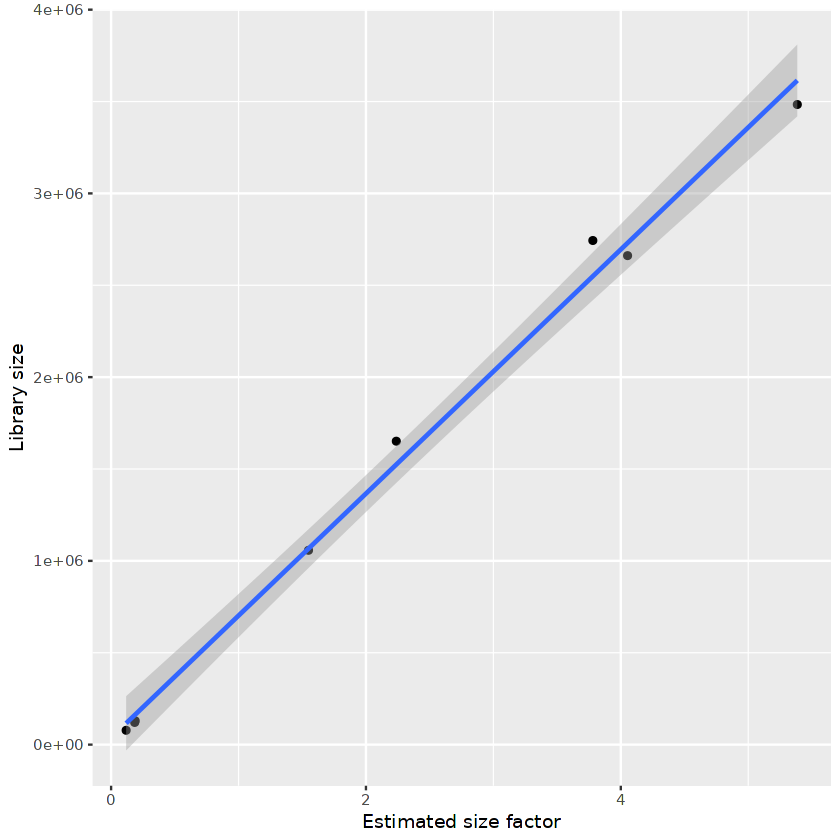

In [952]:
options(repr.plot.width=7, repr.plot.height=7)
ggplot(data=libsize, aes(x=x, y=y)) + geom_point() + geom_smooth(method="lm") + xlab("Estimated size factor") + ylab("Library size")

In [953]:
data.frame(colData(dds))

,cluster_id,sample_id,group_id,debris_id,sizeFactor
,<chr>,<chr>,<fct>,<fct>,<dbl>
Late2F,OPC,Late2F,F,Percoll,0.1890451
Late2M,OPC,Late2M,M,Percoll,1.5492179
Late3F,OPC,Late3F,F,Percoll,0.1180089
Late3M,OPC,Late3M,M,Percoll,0.1851036
Late5F,OPC,Late5F,F,Debris,4.0532431
Late5M,OPC,Late5M,M,Debris,5.3851929
LateFemale4F,OPC,LateFemale4F,F,Debris,3.7804800
LateMale4M,OPC,LateMale4M,M,Debris,2.2382109


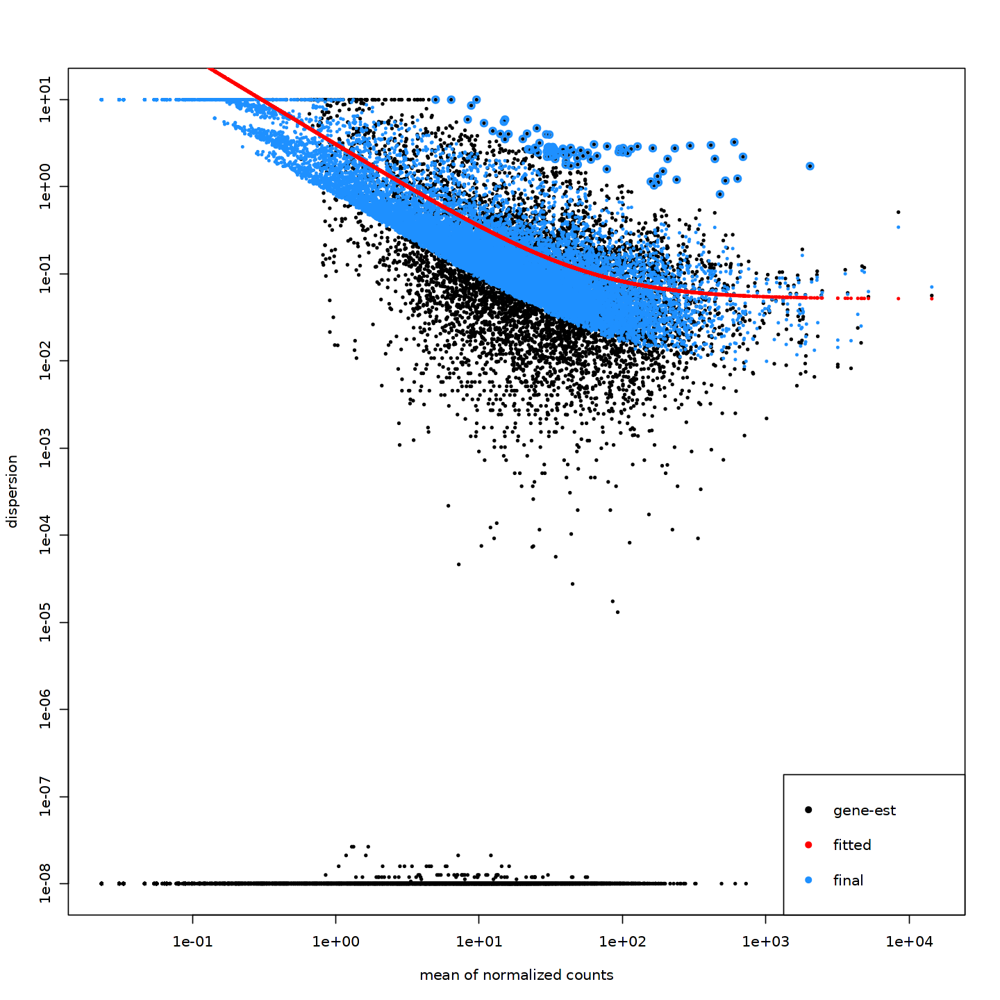

In [954]:
# Plot dispersion estimates
options(repr.plot.width=12, repr.plot.height=12)
plotDispEsts(dds)

In [955]:
condition1 = "M"
condition2 = "F"

In [956]:
contrast <- c("group_id", condition1, condition2)

# resultsNames(dds)
res <- results(dds, contrast = contrast, alpha = 0.05)

In [957]:
summary(res)


out of 14786 with nonzero total read count
adjusted p-value < 0.05
LFC > 0 (up)       : 4, 0.027%
LFC < 0 (down)     : 2, 0.014%
outliers [1]       : 0, 0%
low counts [2]     : 0, 0%
(mean count < 0)
[1] see 'cooksCutoff' argument of ?results
[2] see 'independentFiltering' argument of ?results



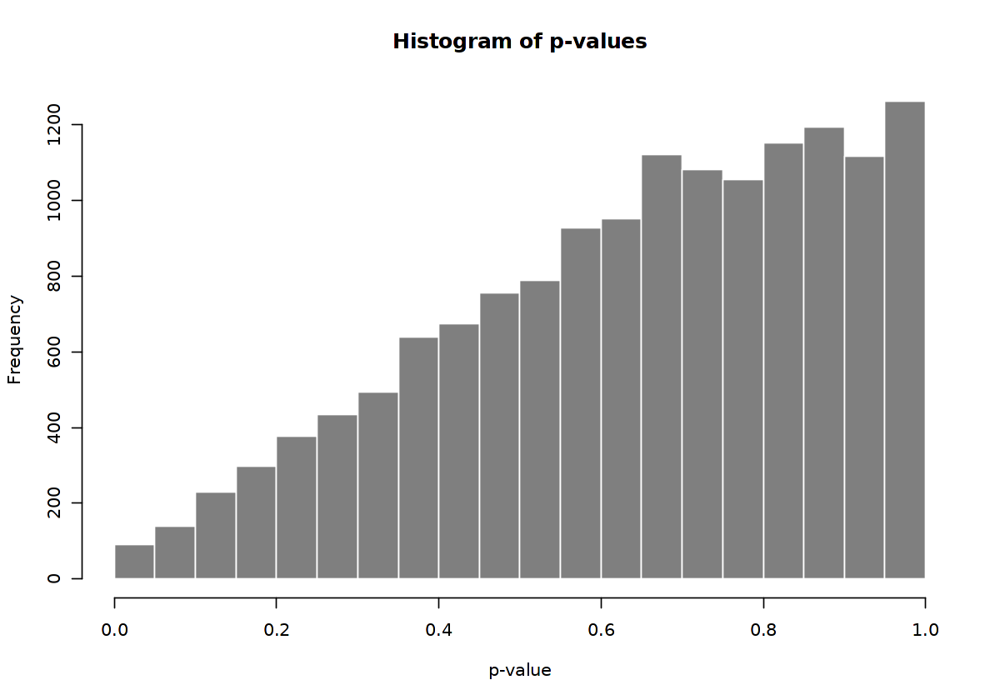

In [958]:
options(repr.plot.width=10, repr.plot.height=7)
hist(res$pvalue, breaks=0:20/20, col="grey50", border="white", xlim=c(0,1), main="Histogram of p-values", xlab="p-value")

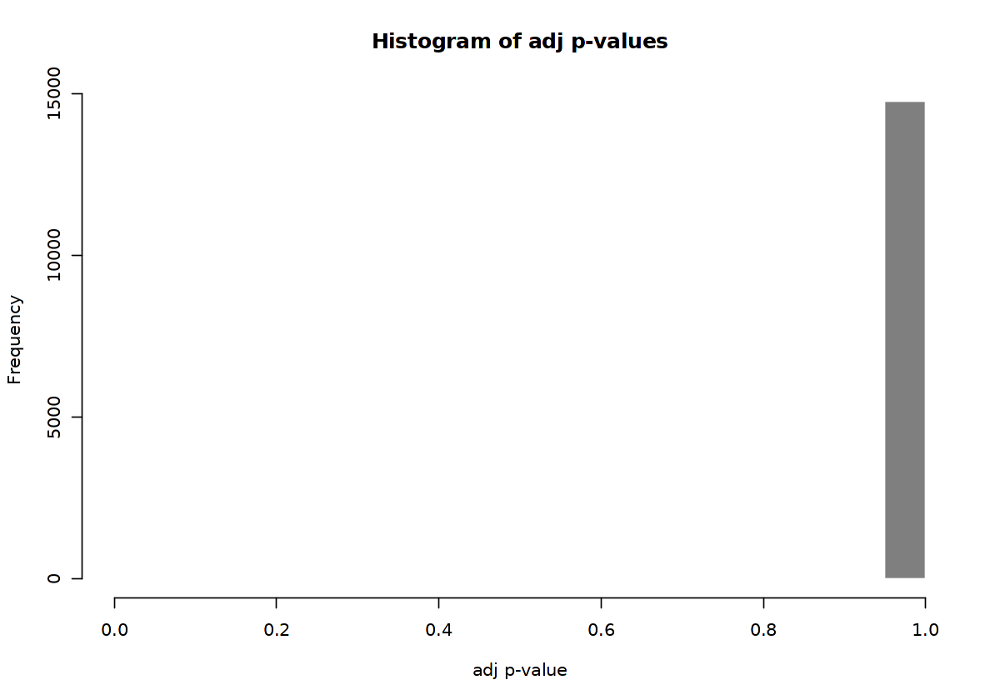

In [959]:
options(repr.plot.width=10, repr.plot.height=7)
hist(res$padj, breaks=0:20/20, col="grey50", border="white", xlim=c(0,1), main="Histogram of adj p-values", xlab="adj p-value")

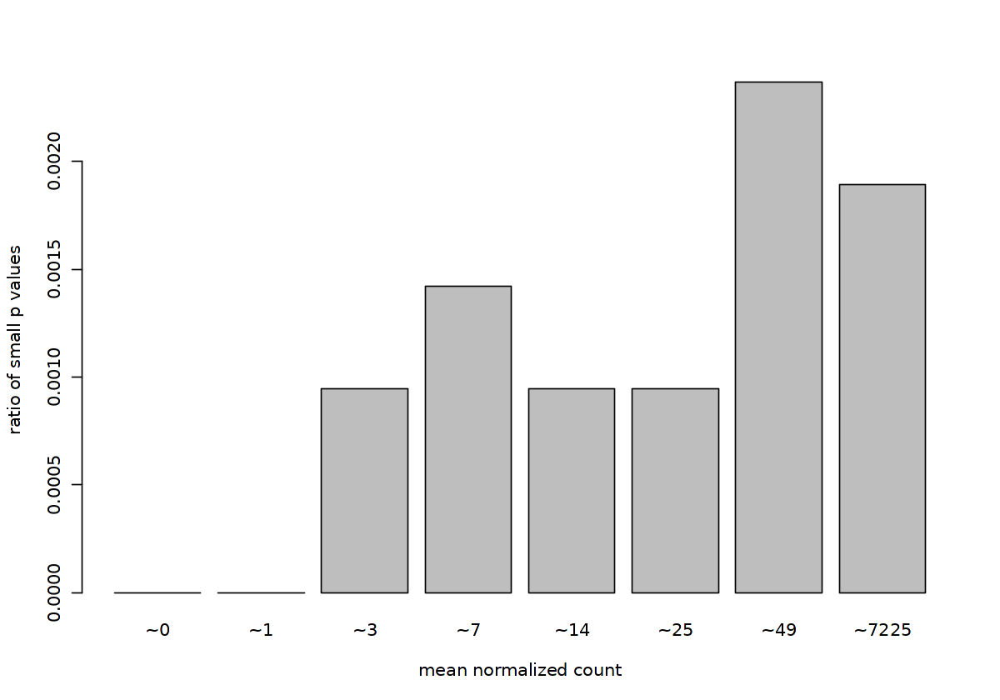

In [960]:
options(repr.plot.width=10, repr.plot.height=7)
qs <- c(0, quantile(res$baseMean[res$baseMean > 0], 0:7/7))
# cut the genes into the bins
bins <- cut(res$baseMean, qs)
# rename the levels of the bins using the middle point
levels(bins) <- paste0("~",round(.5*qs[-1] + .5*qs[-length(qs)]))
# calculate the ratio of $p$ values less than .01 for each bin
ratios <- tapply(res$pvalue, bins, function(p) mean(p < .01, na.rm=TRUE))
# plot these ratios
barplot(ratios, xlab="mean normalized count", ylab="ratio of small p values")

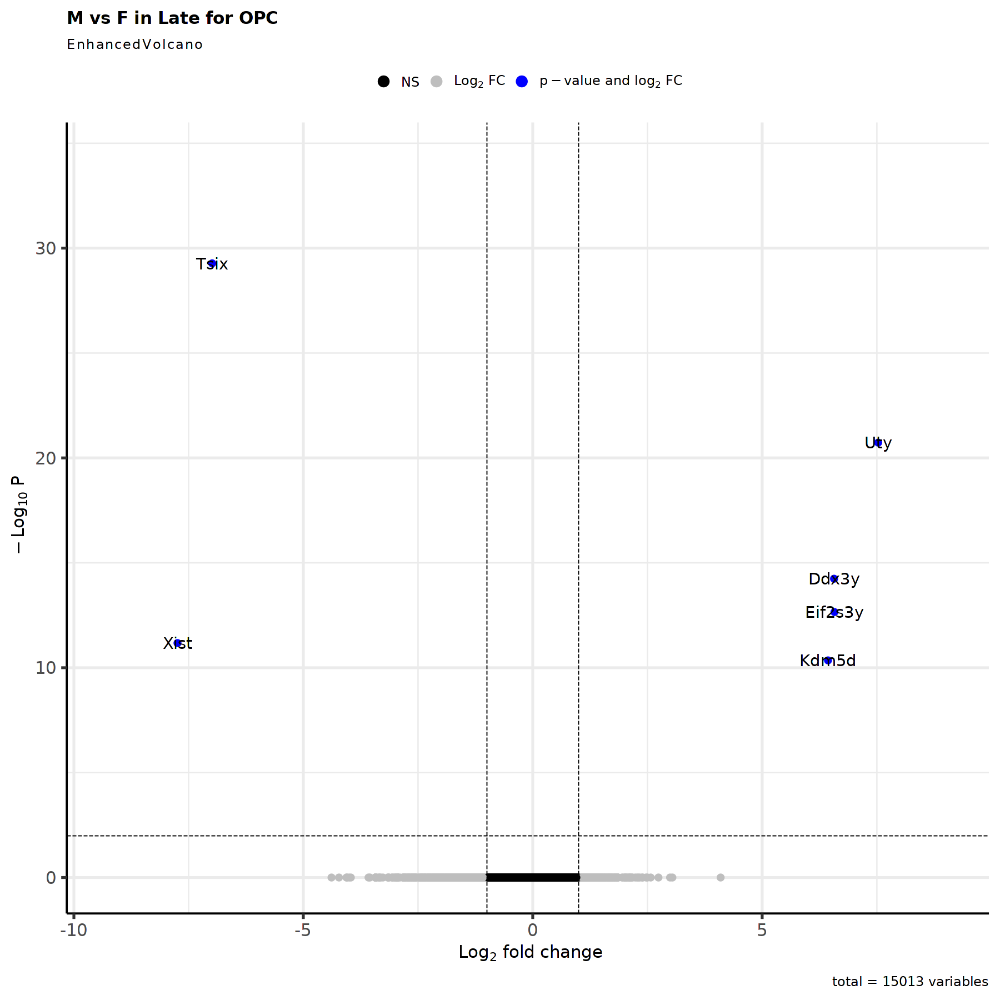

In [961]:
options(repr.plot.width=15, repr.plot.height=15)
#padj<0.001
EnhancedVolcano(res,
    lab = rownames(res),
    x = 'log2FoldChange',
    y = 'padj',
    title = paste0('M vs F in ',timepoint,' for ', cluster_choice),
    pCutoff = 0.01,
    FCcutoff = 1,
    pointSize = 3.0,
    labSize = 6.0,
    col=c('black', 'grey', 'grey', 'blue'),
    colAlpha = 1)

In [962]:
res <- res[complete.cases(res$padj),]

In [963]:
res_filtered <- res[(res$padj < 0.01 & abs(res$log2FoldChange) > 1 & res$baseMean > 1),]

In [964]:
res_filtered[order(abs(res_filtered$log2FoldChange), decreasing=TRUE),]

log2 fold change (MLE): group_id M vs F 
Wald test p-value: group id M vs F 
DataFrame with 6 rows and 6 columns
         baseMean log2FoldChange     lfcSE      stat      pvalue        padj
        <numeric>      <numeric> <numeric> <numeric>   <numeric>   <numeric>
Xist     479.1580       -7.74214  0.976755  -7.92639 2.25614e-15 6.67185e-12
Uty       53.2151        7.52853  0.724001  10.39851 2.51847e-25 1.86191e-21
Tsix      65.6178       -6.98616  0.573185 -12.18832 3.58738e-34 5.30430e-30
Eif2s3y   24.9432        6.57514  0.786014   8.36517 6.00268e-17 2.21889e-13
Ddx3y     32.1255        6.56690  0.744679   8.81843 1.16078e-18 5.72109e-15
Kdm5d     17.9822        6.43527  0.839765   7.66318 1.81387e-14 4.46998e-11

In [965]:
nrow(res_filtered)

[1] 6

In [966]:
top.genes.number <- ifelse(nrow(res_filtered)>100, 100, nrow(res_filtered))

In [967]:
res_top <- res_filtered[order(abs(res_filtered$log2FoldChange), decreasing=TRUE),][1:top.genes.number,]
res_top <- res_top[order(res_top$log2FoldChange, decreasing=FALSE),]

In [968]:
tmp_sub <- subset(tmp, subset = cellType == cluster_choice)

In [969]:
tmp_sub <- NormalizeData(tmp_sub, normalization.method = "LogNormalize", scale.factor = 10000, verbose = TRUE)

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


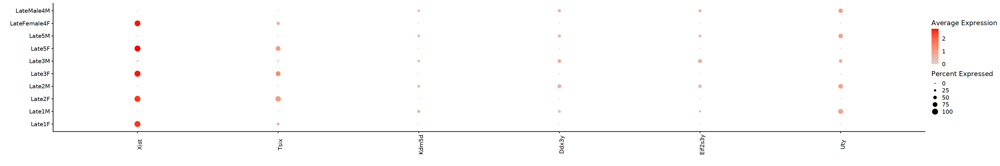

In [970]:
options(repr.plot.width=30, repr.plot.height=5)
plot <- DotPlot(tmp_sub, assay = "RNA", group.by = "orig.ident_Sex", scale=FALSE, cols = c("lightgrey", "red"), dot.scale = 5, features = rownames(res_top))
plot + theme(axis.text.x = element_text(angle = 90)) + labs(x = "", y= "")

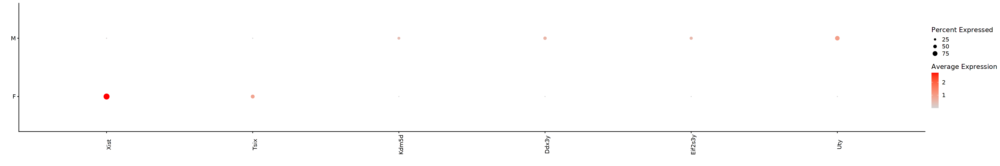

In [971]:
options(repr.plot.width=30, repr.plot.height=5)
plot <- DotPlot(tmp_sub, assay = "RNA", group.by = "Sex", scale=FALSE, cols = c("lightgrey", "red"), dot.scale = 5, features = rownames(res_top))
plot + theme(axis.text.x = element_text(angle = 90)) + labs(x = "", y= "")

In [972]:
HVGs.list[[cluster_choice]] <- rownames(res_filtered)

##### 3.2.5.3 Micro

In [973]:
cluster_choice <- "Micro"

In [974]:
table_sample_low <- table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$sample_id)[cluster_choice,][table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$sample_id)[cluster_choice,] <= 5]
table_sample_low

sample_keep <- names(timepoint_Sex_colors)[!names(timepoint_Sex_colors) %in% names(table_sample_low)]

named integer(0)

In [975]:
table_group_low <-table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$group_id)[cluster_choice,][table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$group_id)[cluster_choice,] <= 30]
table_group_low

group_keep <- names(sex_colors)[!names(sex_colors) %in% names(table_group_low)]

named integer(0)

In [976]:
cluster_metadata <- metadata[which(metadata$cluster_id == cluster_choice), ]

# Assign the rownames of the metadata to be the sample IDs
rownames(cluster_metadata) <- cluster_metadata$sample_id

In [977]:
#Remove sample and timepoint with low counts (sample<=5, timepoint<=30)
cluster_metadata <- cluster_metadata[(cluster_metadata$sample_id %in% sample_keep & cluster_metadata$group_id %in% group_keep),]

#new_sample_levels <- levels(cluster_metadata$sample_id)[levels(cluster_metadata$sample_id) %in% sample_keep]
#cluster_metadata$sample_id <- droplevels(cluster_metadata$sample_id)
#levels(cluster_metadata$sample_id) <- new_sample_levels

new_group_levels <- levels(cluster_metadata$group_id)[levels(cluster_metadata$group_id) %in% group_keep]
cluster_metadata$group_id <- droplevels(cluster_metadata$group_id)
levels(cluster_metadata$group_id) <- new_group_levels

In [978]:
cluster_metadata

,cluster_id,sample_id,group_id,debris_id
,<chr>,<chr>,<fct>,<chr>
Late1F,Micro,Late1F,F,Percoll
Late1M,Micro,Late1M,M,Percoll
Late2F,Micro,Late2F,F,Percoll
Late2M,Micro,Late2M,M,Percoll
Late3F,Micro,Late3F,F,Percoll
Late3M,Micro,Late3M,M,Percoll
Late5F,Micro,Late5F,F,Debris
Late5M,Micro,Late5M,M,Debris
LateFemale4F,Micro,LateFemale4F,F,Debris


In [979]:
# Subset the counts to only this cluster
counts <- pb[[cluster_choice]]

cluster_counts <- data.frame(counts[, which(colnames(counts) %in% rownames(cluster_metadata))])

# Check that all of the row names of the metadata are the same and in the same order as the column names of the counts in order to use as input to DESeq2
all(rownames(cluster_metadata) == colnames(cluster_counts))

[1] TRUE

In [980]:
dds <- DESeqDataSetFromMatrix(cluster_counts, colData = cluster_metadata, design = ~ group_id + debris_id)

converting counts to integer mode

Warning message in DESeqDataSet(se, design = design, ignoreRank):
"some variables in design formula are characters, converting to factors"


In [981]:
# Transform counts for data visualization
rld <- rlog(dds, blind=TRUE)

using ntop=500 top features by variance



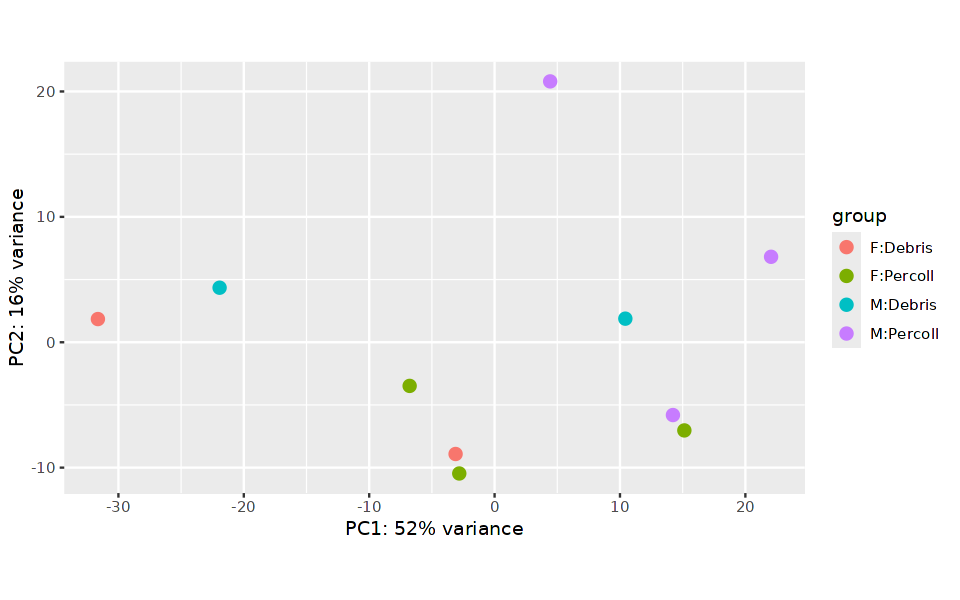

In [982]:
# Plot PCA
options(repr.plot.width=8, repr.plot.height=5)
DESeq2::plotPCA(rld, intgroup = c("group_id", "debris_id"))

In [983]:
# Extract the rlog matrix from the object and compute pairwise correlation values
rld_mat <- assay(rld)
rld_cor <- cor(rld_mat)

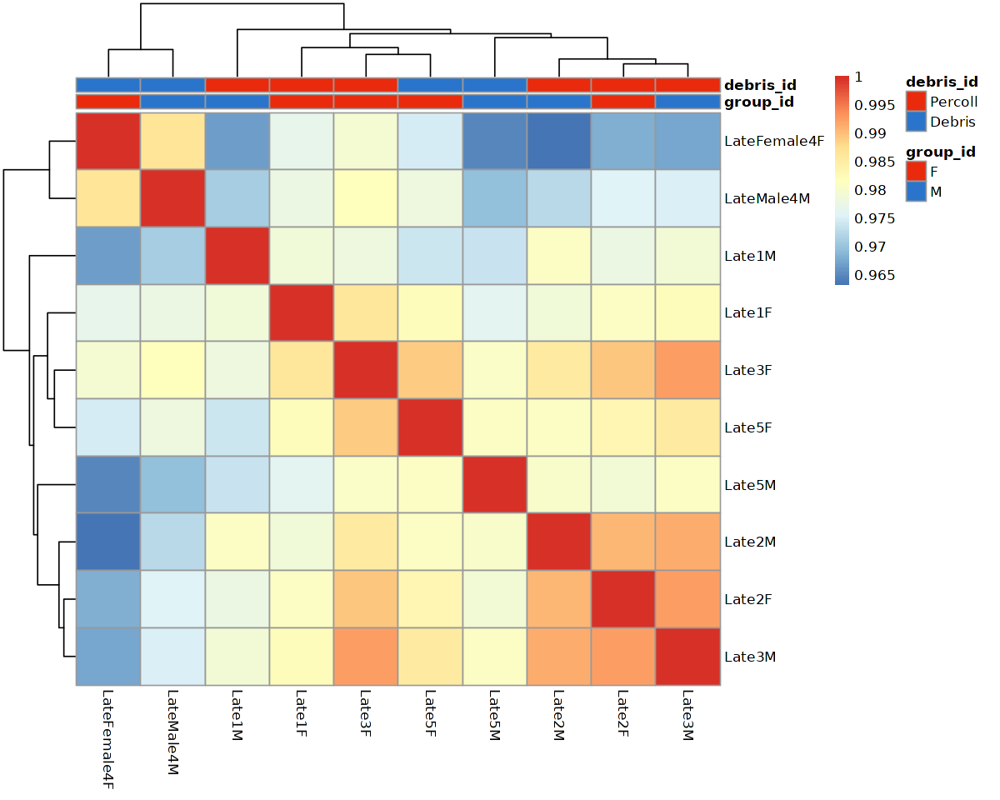

In [984]:
# Plot heatmap
options(repr.plot.width=10, repr.plot.height=8)
pheatmap(rld_cor, annotation = cluster_metadata[, c("group_id","debris_id"), drop=F], annotation_colors = list(group_id=sex_colors, debris_id=debris_colors))

In [985]:
# Run DESeq2 differential expression analysis
dds <- DESeq(dds)

estimating size factors

estimating dispersions

gene-wise dispersion estimates

mean-dispersion relationship

final dispersion estimates

fitting model and testing



In [986]:
libsize = data.frame(x=sizeFactors(dds), y=colSums(assay(dds)))

`geom_smooth()` using formula = 'y ~ x'


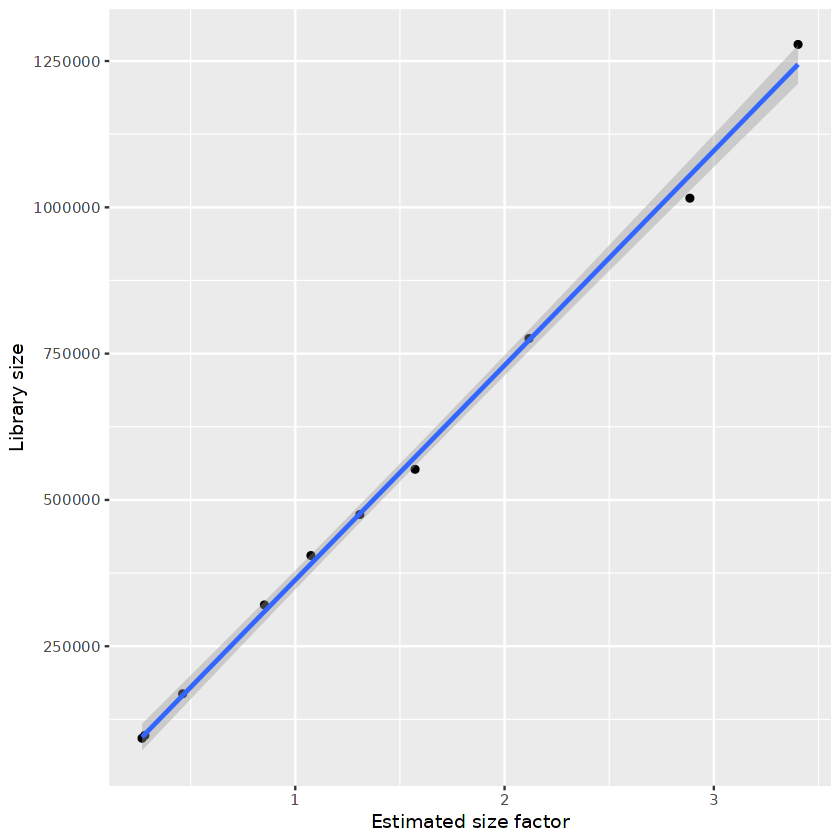

In [987]:
options(repr.plot.width=7, repr.plot.height=7)
ggplot(data=libsize, aes(x=x, y=y)) + geom_point() + geom_smooth(method="lm") + xlab("Estimated size factor") + ylab("Library size")

In [988]:
data.frame(colData(dds))

,cluster_id,sample_id,group_id,debris_id,sizeFactor
,<chr>,<chr>,<fct>,<fct>,<dbl>
Late1F,Micro,Late1F,F,Percoll,0.4619165
Late1M,Micro,Late1M,M,Percoll,0.2679499
Late2F,Micro,Late2F,F,Percoll,1.5724924
Late2M,Micro,Late2M,M,Percoll,2.8855045
Late3F,Micro,Late3F,F,Percoll,2.1166395
Late3M,Micro,Late3M,M,Percoll,3.4024546
Late5F,Micro,Late5F,F,Debris,0.8526164
Late5M,Micro,Late5M,M,Debris,0.2814354
LateFemale4F,Micro,LateFemale4F,F,Debris,1.3085555


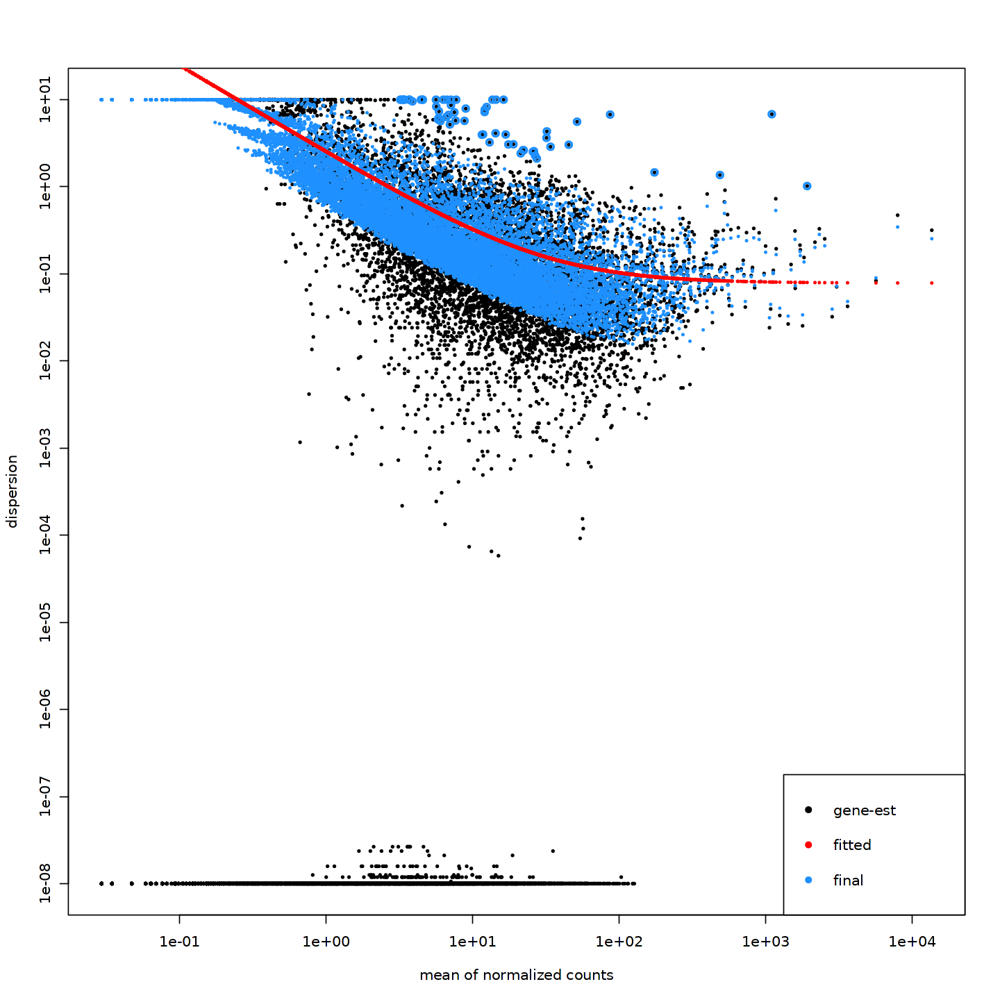

In [989]:
# Plot dispersion estimates
options(repr.plot.width=12, repr.plot.height=12)
plotDispEsts(dds)

In [990]:
condition1 = "M"
condition2 = "F"

In [991]:
contrast <- c("group_id", condition1, condition2)

# resultsNames(dds)
res <- results(dds, contrast = contrast, alpha = 0.05)

In [992]:
summary(res)


out of 14500 with nonzero total read count
adjusted p-value < 0.05
LFC > 0 (up)       : 5, 0.034%
LFC < 0 (down)     : 3, 0.021%
outliers [1]       : 8, 0.055%
low counts [2]     : 0, 0%
(mean count < 0)
[1] see 'cooksCutoff' argument of ?results
[2] see 'independentFiltering' argument of ?results



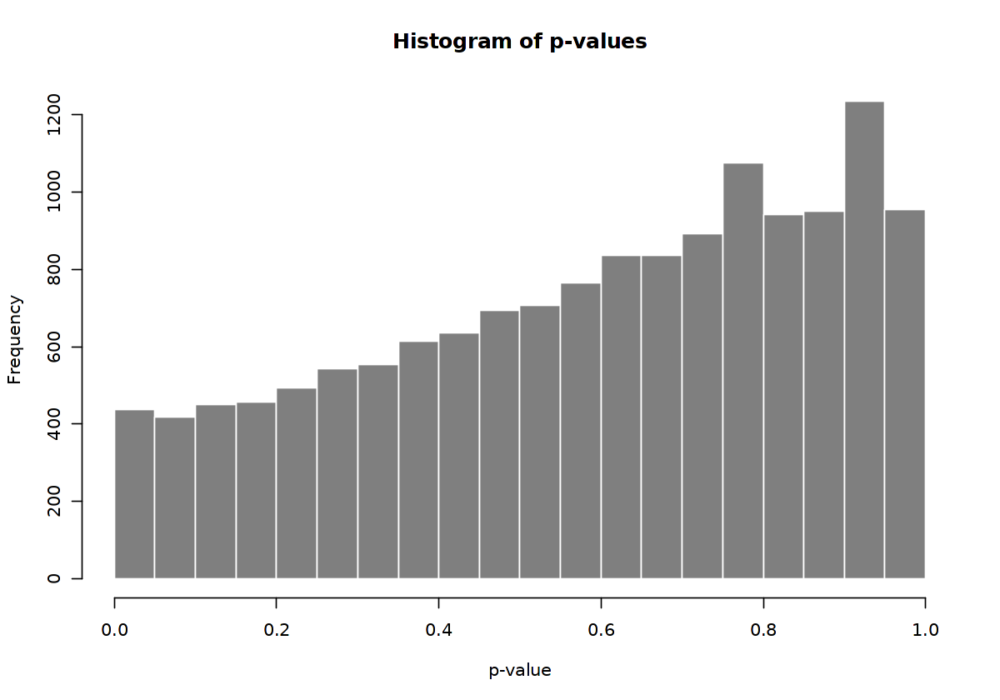

In [993]:
options(repr.plot.width=10, repr.plot.height=7)
hist(res$pvalue, breaks=0:20/20, col="grey50", border="white", xlim=c(0,1), main="Histogram of p-values", xlab="p-value")

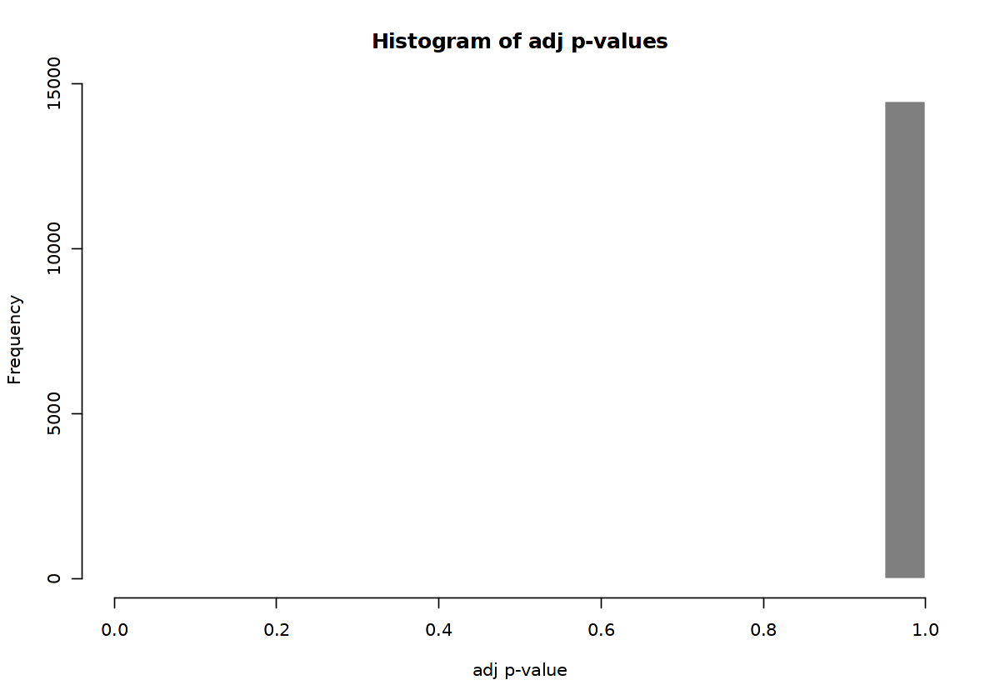

In [994]:
options(repr.plot.width=10, repr.plot.height=7)
hist(res$padj, breaks=0:20/20, col="grey50", border="white", xlim=c(0,1), main="Histogram of adj p-values", xlab="adj p-value")

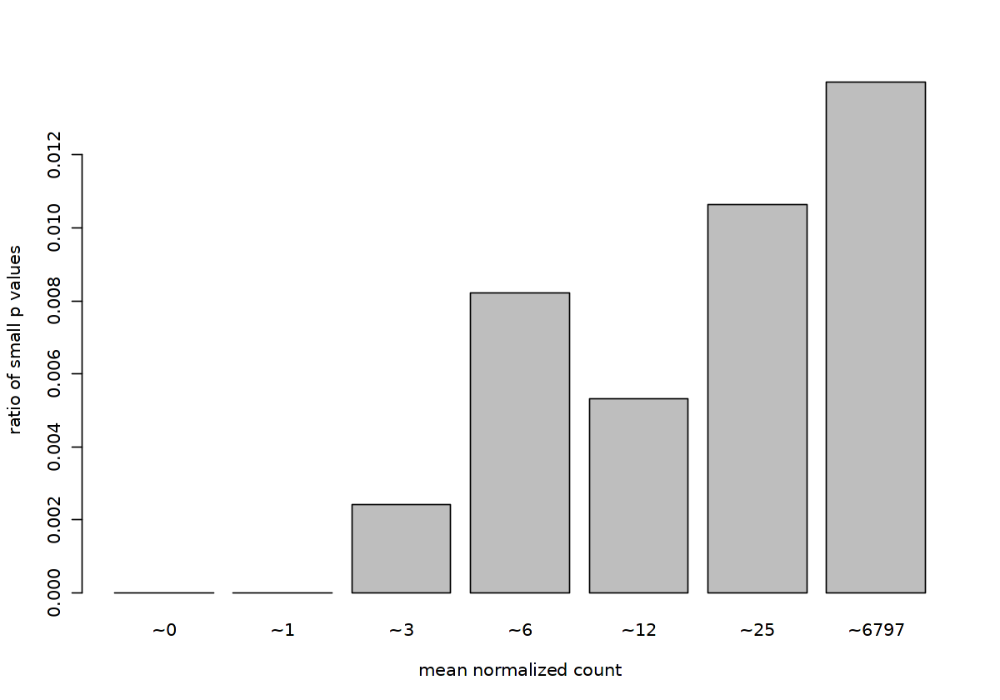

In [995]:
options(repr.plot.width=10, repr.plot.height=7)
qs <- c(0, quantile(res$baseMean[res$baseMean > 0], 0:7/7))
# cut the genes into the bins
bins <- cut(res$baseMean, qs)
# rename the levels of the bins using the middle point
levels(bins) <- paste0("~",round(.5*qs[-1] + .5*qs[-length(qs)]))
# calculate the ratio of $p$ values less than .01 for each bin
ratios <- tapply(res$pvalue, bins, function(p) mean(p < .01, na.rm=TRUE))
# plot these ratios
barplot(ratios, xlab="mean normalized count", ylab="ratio of small p values")

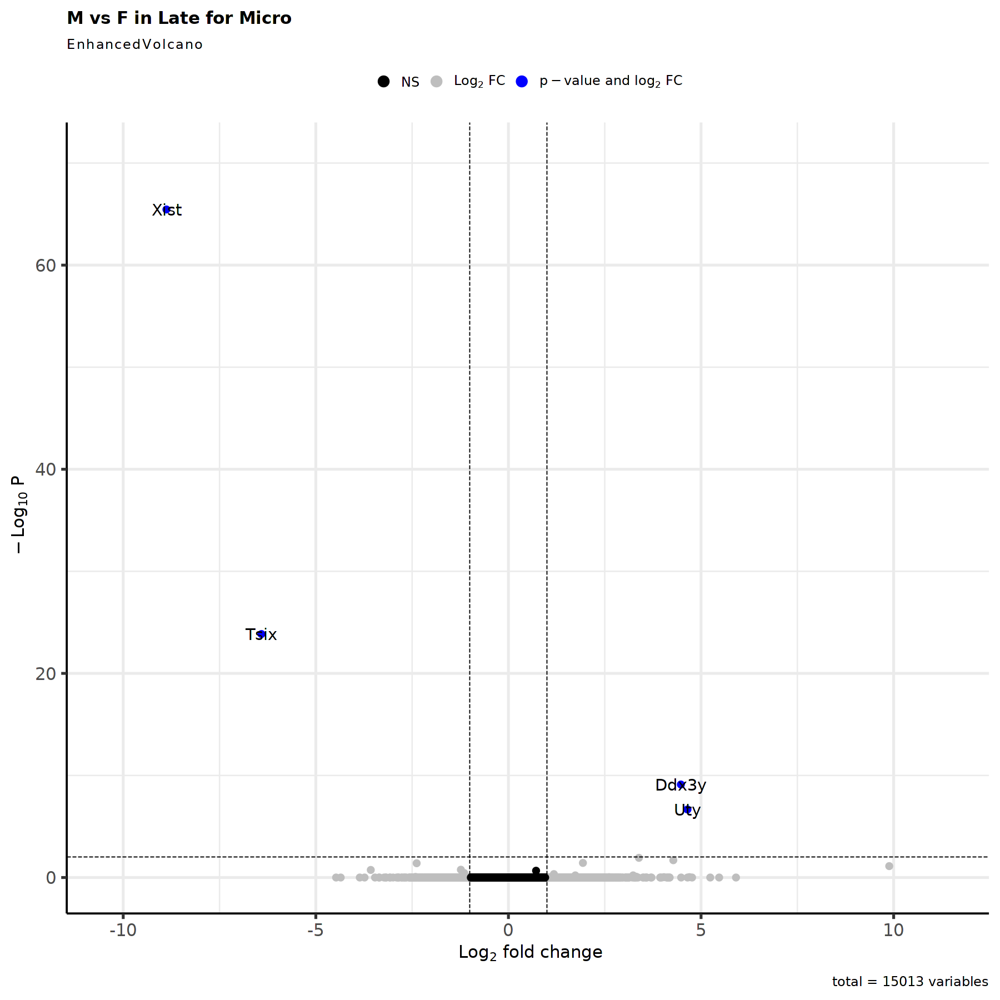

In [996]:
options(repr.plot.width=15, repr.plot.height=15)
#padj<0.001
EnhancedVolcano(res,
    lab = rownames(res),
    x = 'log2FoldChange',
    y = 'padj',
    title = paste0('M vs F in ',timepoint,' for ', cluster_choice),
    pCutoff = 0.01,
    FCcutoff = 1,
    pointSize = 3.0,
    labSize = 6.0,
    col=c('black', 'grey', 'grey', 'blue'),
    colAlpha = 1)

In [997]:
res <- res[complete.cases(res$padj),]

In [998]:
res_filtered <- res[(res$padj < 0.01 & abs(res$log2FoldChange) > 1 & res$baseMean > 1),]

In [999]:
res_filtered[order(abs(res_filtered$log2FoldChange), decreasing=TRUE),]

log2 fold change (MLE): group_id M vs F 
Wald test p-value: group id M vs F 
DataFrame with 4 rows and 6 columns
       baseMean log2FoldChange     lfcSE      stat      pvalue        padj
      <numeric>      <numeric> <numeric> <numeric>   <numeric>   <numeric>
Xist   264.2889       -8.87754  0.500690 -17.73059 2.43458e-70 3.52819e-66
Tsix    34.7737       -6.41181  0.579655 -11.06142 1.93010e-28 1.39855e-24
Uty     28.8200        4.64734  0.709987   6.54567 5.92285e-11 2.14585e-07
Ddx3y   38.1112        4.47643  0.606657   7.37884 1.59669e-13 7.71309e-10

In [1000]:
nrow(res_filtered)

[1] 4

In [1001]:
top.genes.number <- ifelse(nrow(res_filtered)>100, 100, nrow(res_filtered))

In [1002]:
res_top <- res_filtered[order(abs(res_filtered$log2FoldChange), decreasing=TRUE),][1:top.genes.number,]
res_top <- res_top[order(res_top$log2FoldChange, decreasing=FALSE),]

In [1003]:
tmp_sub <- subset(tmp, subset = cellType == cluster_choice)

In [1004]:
tmp_sub <- NormalizeData(tmp_sub, normalization.method = "LogNormalize", scale.factor = 10000, verbose = TRUE)

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


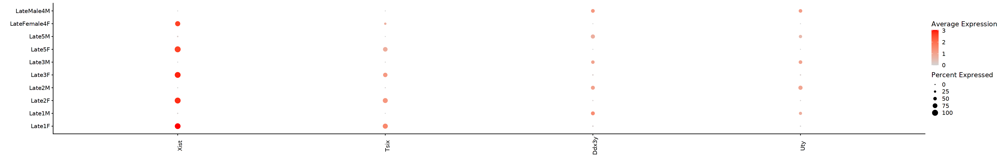

In [1005]:
options(repr.plot.width=30, repr.plot.height=5)
plot <- DotPlot(tmp_sub, assay = "RNA", group.by = "orig.ident_Sex", scale=FALSE, cols = c("lightgrey", "red"), dot.scale = 5, features = rownames(res_top))
plot + theme(axis.text.x = element_text(angle = 90)) + labs(x = "", y= "")

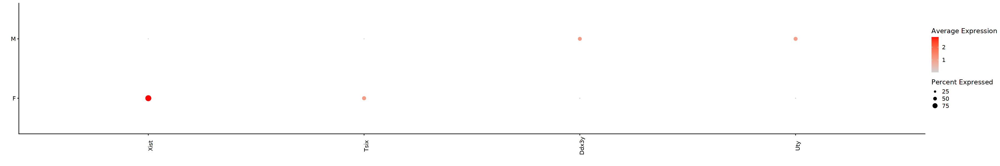

In [1006]:
options(repr.plot.width=30, repr.plot.height=5)
plot <- DotPlot(tmp_sub, assay = "RNA", group.by = "Sex", scale=FALSE, cols = c("lightgrey", "red"), dot.scale = 5, features = rownames(res_top))
plot + theme(axis.text.x = element_text(angle = 90)) + labs(x = "", y= "")

In [1007]:
HVGs.list[[cluster_choice]] <- rownames(res_filtered)

##### 3.2.5.4 Astro

In [ ]:
#Not enough cells

##### 3.2.5.5 Summary

In [1022]:
listInput_upset <- HVGs.list
listInput_upset[sapply(listInput_upset, is.null)] <- NULL

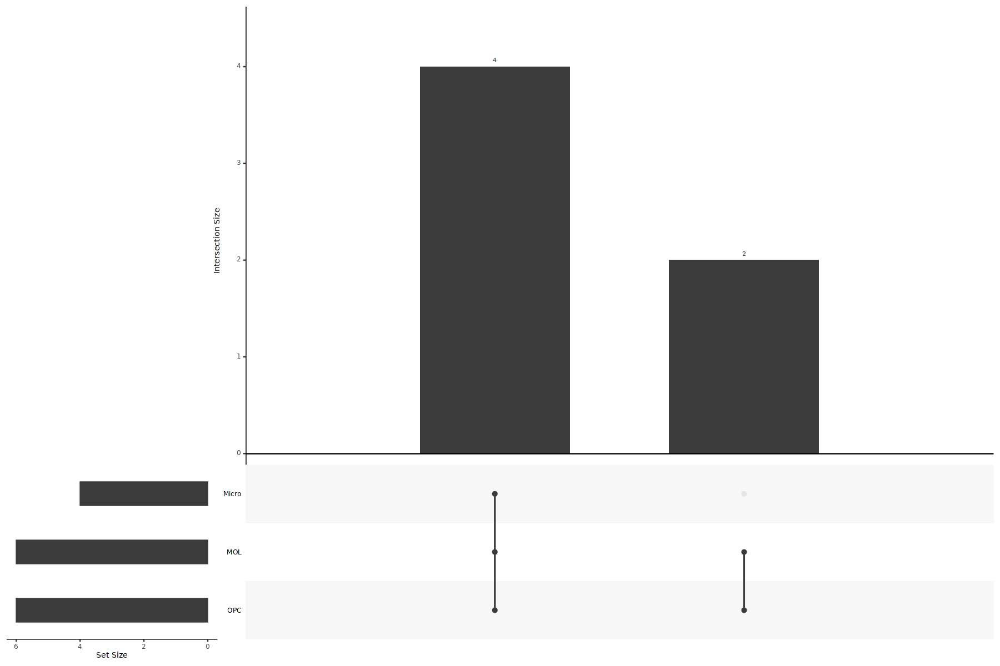

In [1023]:
options(repr.plot.width=15, repr.plot.height=10)
upset(fromList(listInput_upset), order.by = "freq")

In [1024]:
HVF <- unique(unlist(HVGs.list))

In [1025]:
table_sample_low <- table(MORNAATACC_sce$sample_id)[table(MORNAATACC_sce$sample_id) <= 5]
table_group_low <- table(MORNAATACC_sce$group_id)[table(MORNAATACC_sce$group_id) <= 30]

In [1026]:
#Remove sample with low number of cells
keepcells <- rownames(tmp@meta.data[!tmp$orig.ident %in% (names(table_sample_low)),])
tmp <- subset(tmp, cells=keepcells)

In [1027]:
#Remove timepoint with low number of cells
keepcells <- rownames(tmp@meta.data[!tmp$orig.ident_Sex %in% (names(table_group_low)),])
tmp <- subset(tmp, cells=keepcells)

In [1028]:
tmp <- NormalizeData(tmp, normalization.method = "LogNormalize", scale.factor = 10000, verbose = TRUE)

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


In [1029]:
tmp <- ScaleData(tmp, features=rownames(tmp))

Centering and scaling data matrix

  |==========================================================================================| 100%


In [1030]:
sub_timepoint_Sex_colors <- timepoint_Sex_colors[names(timepoint_Sex_colors) %in% names(table(tmp$orig.ident_Sex))]

In [1031]:
tmp$orig.ident <- factor(x = tmp$orig.ident, levels = name_timepoint[!name_timepoint %in% names(table_sample_low)])
tmp$orig.ident_Sex <- factor(x = tmp$orig.ident_Sex, levels = names(sub_timepoint_Sex_colors)[!names(sub_timepoint_Sex_colors) %in% names(table_group_low)])

In [1032]:
Idents(object = tmp) <- "orig.ident_Sex"

Warning message:
"CombinePlots is being deprecated. Plots should now be combined using the patchwork system."


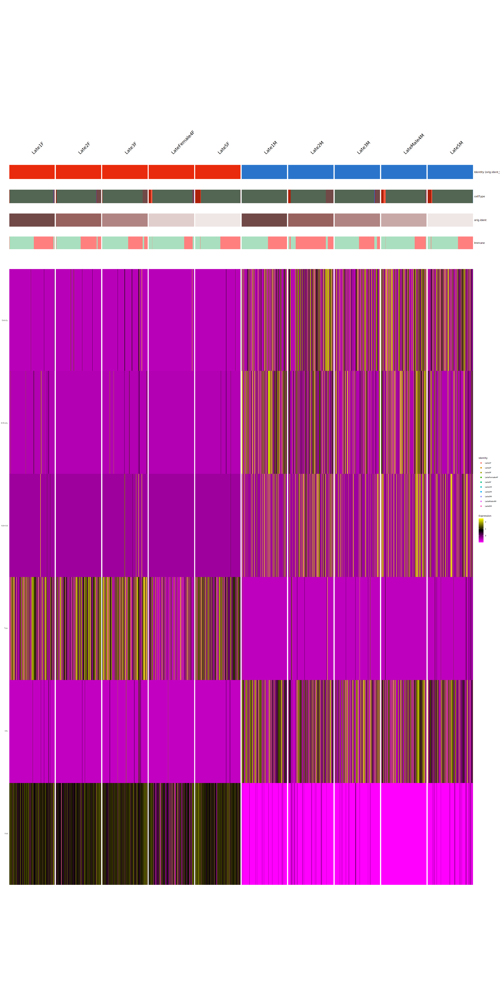

In [1033]:
options(repr.plot.width=25, repr.plot.height=50)
DoMultiBarHeatmap(
    subset(tmp, downsample = 200),
    features = HVF,
    cells = NULL,
    group.by = "orig.ident_Sex",
    additional.group.by = c("cellType", "orig.ident", "Immune"),
    additional.group.sort.by = c("cellType", "orig.ident", "Immune"),
    cols.use = list(orig.ident_Sex=sub_timepoint_Sex_colors, cellType=cellType_colors, orig.ident=orig.ident_colors, Immune=immune_colors),
    group.bar = TRUE,
    disp.min = -2.5,
    disp.max = NULL,
    layer = "scale.data",
    assay = "RNA",
    label = TRUE,
    size = 5.5,
    hjust = 0,
    angle = 45,
    raster = TRUE,
    draw.lines = TRUE,
    lines.width = NULL,
    group.bar.height = 0.02,
    combine = TRUE
    ) + theme(text = element_text(size = 8))

In [1034]:
sample_names <- levels(tmp$orig.ident_Sex)

In [1035]:
gene_list <- HVF

In [1036]:
tmp_markers <- as.data.frame(AggregateExpression(tmp, assays = "RNA", group.by = "orig.ident_Sex", normalization.method = "LogNormalize", scale.factor = 10000, return.seurat = TRUE)[["RNA"]]$data[gene_list,])

Centering and scaling data matrix

  |==========================================================================================| 100%
  |==========================================================================================| 100%


In [1037]:
matrix <- tmp_markers/do.call(pmax, tmp_markers)

In [1038]:
paletteLength <- 50
myColor <- colorRampPalette(c("#FFFFB3", "#5E3719"))(paletteLength/2)
myBreaks <- c(seq(0, max(matrix), length.out=floor(paletteLength/2)))

In [1039]:
plot_height <- ifelse(as.integer(nrow(matrix)/20)<=5, 5, as.integer(nrow(matrix)/20))

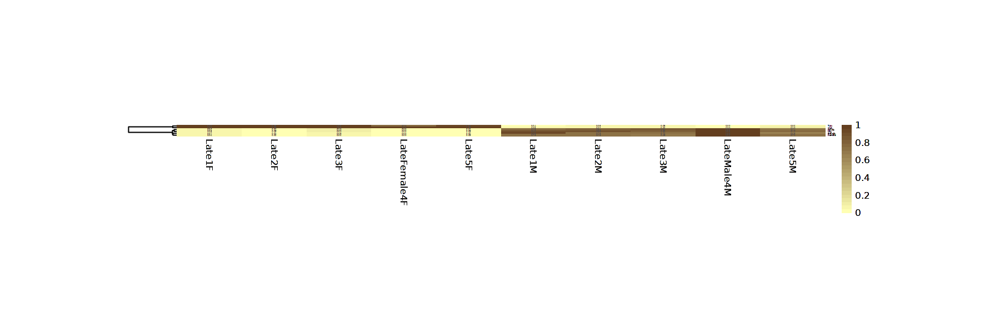

In [1040]:
options(repr.plot.width=15, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = T, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=TRUE)
ph

In [1041]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "DGE_Sex_sep_",timepoint,"_pseudobulk.pdf"), width=15, height=plot_height)

png 
  2

In [1042]:
gene_list <- gene_list[ph$tree_row$order]

In [1043]:
tmp_markers_mean <- data.frame(matrix(0L, ncol=1, nrow=length(gene_list), dimnames=list(gene_list, "Mean_Log2Exp")))

In [1044]:
tmp_markers_mean[rownames(tmp_markers),"Mean_Log2Exp"] <- rowMeans(tmp_markers)

In [1045]:
matrix <- tmp_markers_mean

In [1046]:
paletteLength <- 50
myColor <- colorRampPalette(c("white", "black"))(paletteLength/2)
myBreaks <- c(seq(0, max(matrix), length.out=floor(paletteLength/2)))

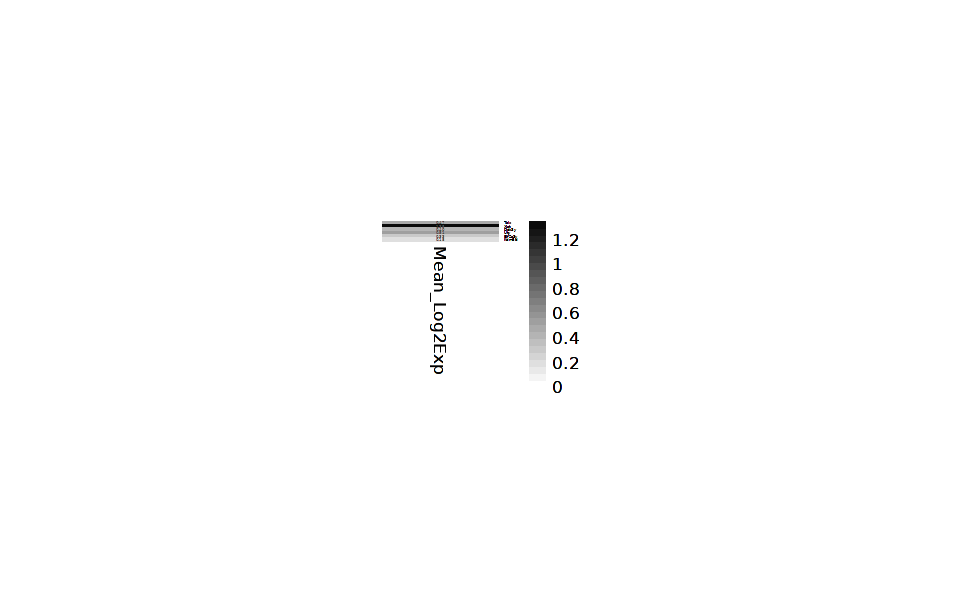

In [1047]:
options(repr.plot.width=8, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = T, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=FALSE)
ph

In [1048]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "DGE_Sex_sep_",timepoint,"_pseudobulk_mean.pdf"), width=8, height=plot_height)

png 
  2

In [1049]:
tmp_markers_zscore <- t(apply(tmp_markers[gene_list,], 1, scale))
colnames(tmp_markers_zscore) <- paste0("zscore_", names(sub_timepoint_Sex_colors))
matrix <- tmp_markers_zscore

In [1050]:
paletteLength <- 50
myColor <- colorRampPalette(c("blue", "white", "red"))(paletteLength/2)
myBreaks <- c(seq(min(matrix), max(matrix), length.out=floor(paletteLength/2)))

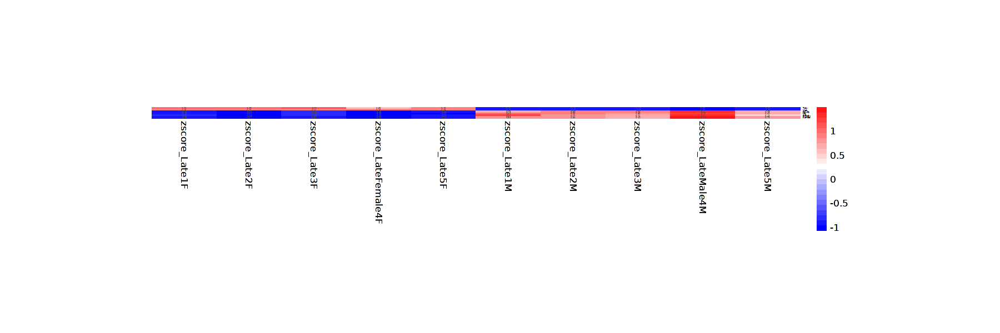

In [1051]:
options(repr.plot.width=15, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = T, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=FALSE)
ph

In [1052]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "DGE_Sex_sep_",timepoint,"_pseudobulk_zscore.pdf"), width=15, height=plot_height)

png 
  2

In [1053]:
gene_list <- HVF

In [1054]:
tmp_markers <- as.data.frame(AggregateExpression(tmp, assays = "RNA", group.by = "Sex", normalization.method = "LogNormalize", scale.factor = 10000, return.seurat = TRUE)[["RNA"]]$data[gene_list,])

  |==========================================================================================| 100%
Centering and scaling data matrix

  |==========================================================================================| 100%


In [1055]:
matrix <- tmp_markers/do.call(pmax, tmp_markers)

In [1056]:
paletteLength <- 50
myColor <- colorRampPalette(c("#FFFFB3", "#5E3719"))(paletteLength/2)
myBreaks <- c(seq(0, max(matrix), length.out=floor(paletteLength/2)))

In [1057]:
plot_height <- ifelse(as.integer(nrow(matrix)/20) < 5, 5, as.integer(nrow(matrix)/20))

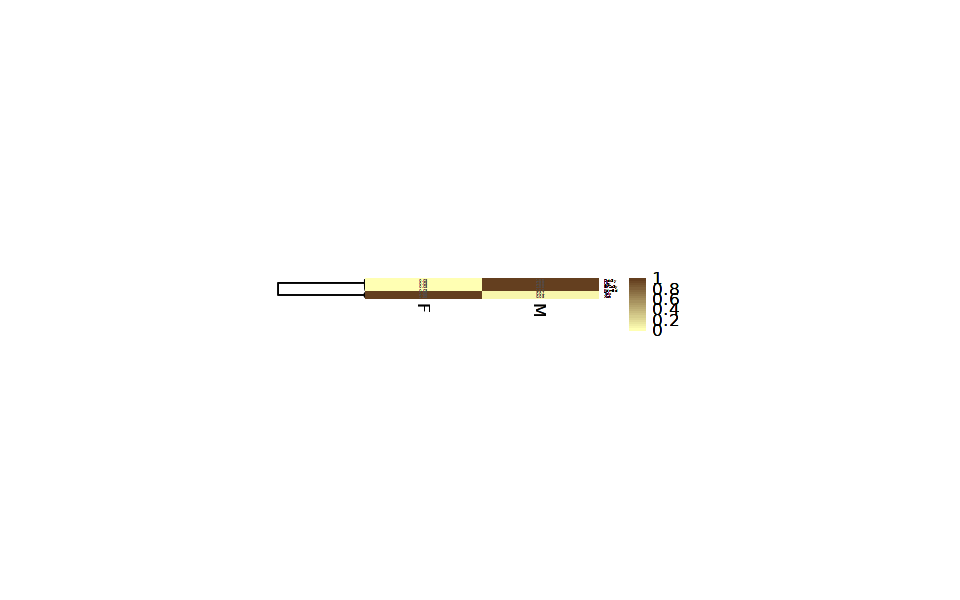

In [1058]:
options(repr.plot.width=8, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = T, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=TRUE)
ph

In [1059]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "DGE_Sex_",timepoint,"_pseudobulk.pdf"), width=8, height=plot_height)

png 
  2

In [1060]:
gene_list <- gene_list[ph$tree_row$order]

In [1061]:
tmp_markers_mean <- data.frame(matrix(0L, ncol=1, nrow=length(gene_list), dimnames=list(gene_list, "Mean_Log2Exp")))

In [1062]:
tmp_markers_mean[rownames(tmp_markers),"Mean_Log2Exp"] <- rowMeans(tmp_markers)

In [1063]:
matrix <- tmp_markers_mean

In [1064]:
paletteLength <- 50
myColor <- colorRampPalette(c("white", "black"))(paletteLength/2)
myBreaks <- c(seq(0, max(matrix), length.out=floor(paletteLength/2)))

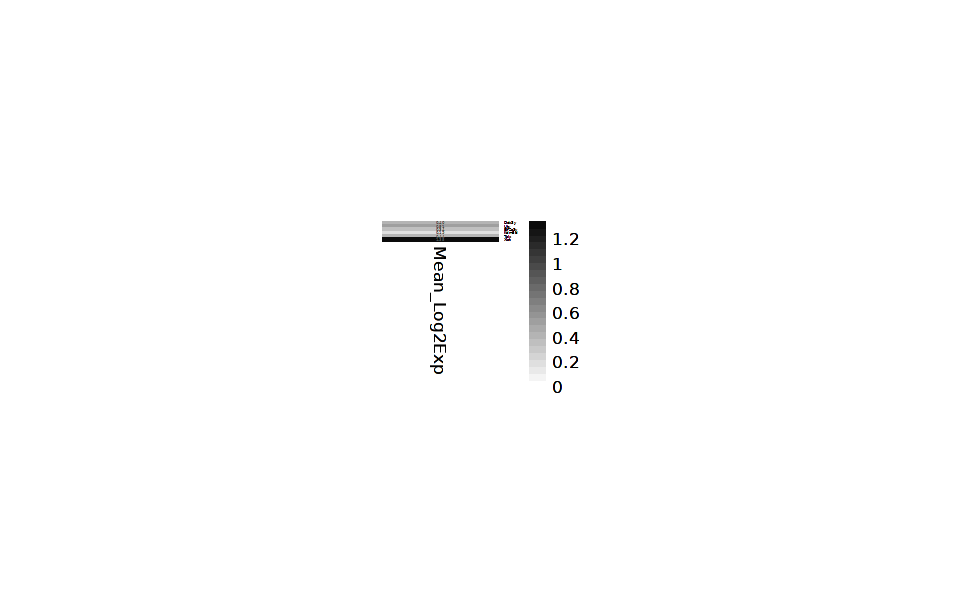

In [1065]:
options(repr.plot.width=8, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = T, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=FALSE)
ph

In [1066]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "DGE_Sex_",timepoint,"_pseudobulk_mean.pdf"), width=8, height=plot_height)

png 
  2

In [1067]:
tmp_markers_zscore <- t(apply(tmp_markers[gene_list,], 1, scale))
colnames(tmp_markers_zscore) <- paste0("zscore_", names(sex_colors))
matrix <- tmp_markers_zscore

In [1068]:
paletteLength <- 50
myColor <- colorRampPalette(c("blue", "white", "red"))(paletteLength/2)
myBreaks <- c(seq(min(matrix), max(matrix), length.out=floor(paletteLength/2)))

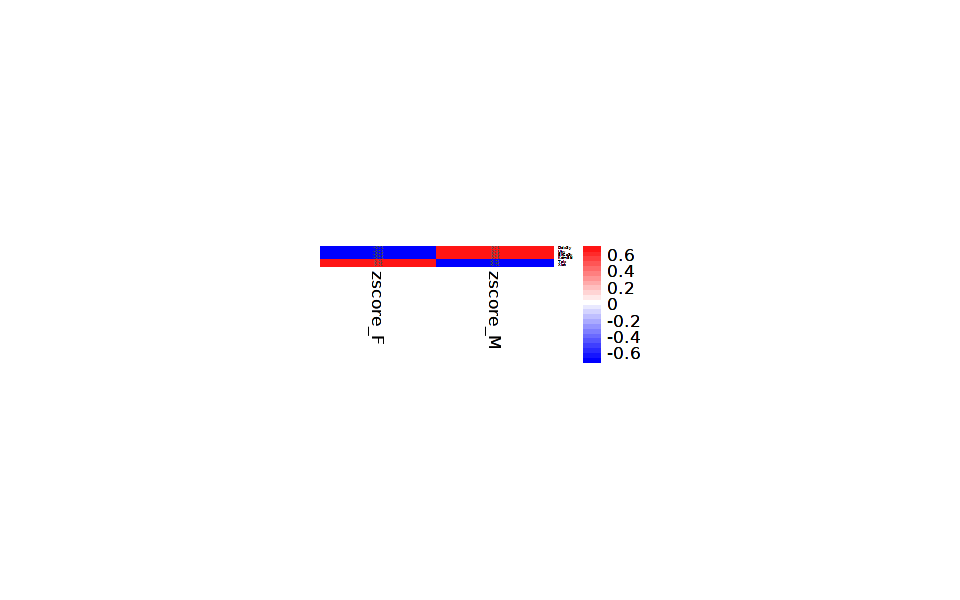

In [1069]:
options(repr.plot.width=8, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = T, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=FALSE)
ph

In [1070]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "DGE_Sex_",timepoint,"_pseudobulk_zscore.pdf"), width=8, height=plot_height)

png 
  2

### 3.3 Overall

In [1071]:
tmp <- subset(MORNAATACC, subset = cellType %in% c("MOL", "COP", "OPC"))

In [1072]:
tmp <- NormalizeData(tmp, normalization.method = "LogNormalize", scale.factor = 10000, verbose = TRUE)

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


In [1073]:
tmp$cellType_Sex <- paste0(tmp$cellType,"_",tmp$Sex)

In [1074]:
sample_names <- c('MOL_M','MOL_F','COP_M','COP_F','OPC_M','OPC_F')

In [1075]:
tmp$cellType_Sex <- factor(x = tmp$cellType_Sex, levels = sample_names)

In [1076]:
#Gene list from MOL and OPC
gene_list <- c('Tsix','Xist','Uty','Kdm5d','Ddx3y','Eif2s3y')

In [1077]:
Idents(object = tmp) <- "cellType_Sex"

In [1078]:
tmp_markers <- as.data.frame(AggregateExpression(tmp, assays = "RNA", group.by = "cellType_Sex", normalization.method = "LogNormalize", scale.factor = 10000, return.seurat = TRUE)[["RNA"]]$data[gene_list,])

Names of identity class contain underscores ('_'), replacing with dashes ('-')
This message is displayed once every 8 hours.
Centering and scaling data matrix

  |==========================================================================================| 100%
  |==========================================================================================| 100%


In [1079]:
matrix <- tmp_markers/do.call(pmax, tmp_markers)

In [1080]:
paletteLength <- 50
myColor <- colorRampPalette(c("#FFFFB3", "#5E3719"))(paletteLength/2)
myBreaks <- c(seq(0, max(matrix), length.out=floor(paletteLength/2)))

In [1081]:
plot_height <- ifelse(as.integer(nrow(matrix)/20)<=5, 5, as.integer(nrow(matrix)/20))

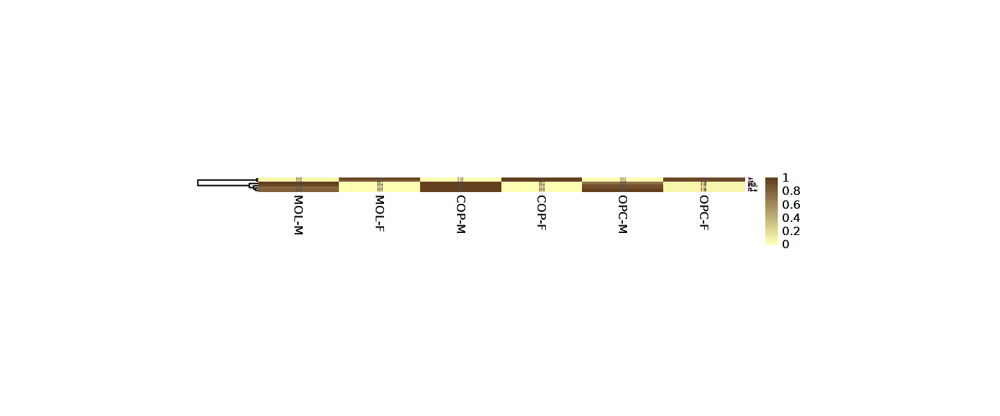

In [1082]:
options(repr.plot.width=12, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = T, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=TRUE)
ph

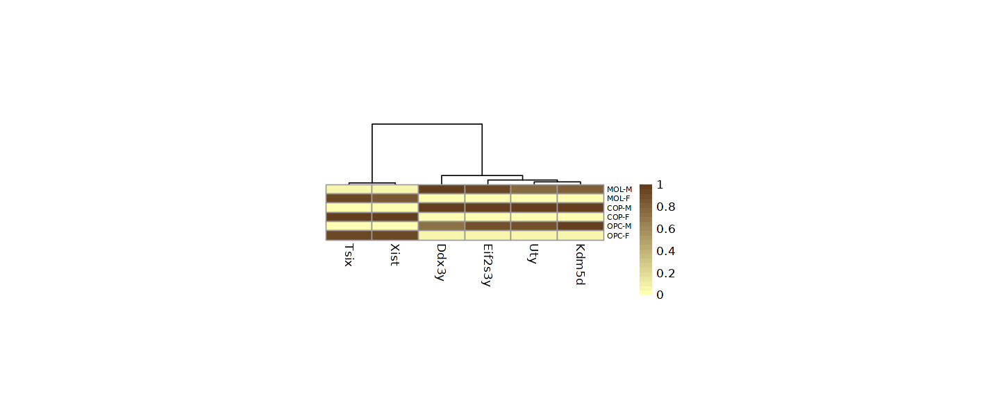

In [1083]:
options(repr.plot.width=12, repr.plot.height=plot_height)
pheatmap(t(matrix), cellheight = 8, cellwidth = 40, fontsize_number = 6, fontsize_row=6, display_numbers = F, color=myColor, breaks=myBreaks, cluster_cols=TRUE, cluster_rows=FALSE)

In [1084]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "DGE_Sex_pseudobulk.pdf"), width=8, height=plot_height)

png 
  2

In [1085]:
gene_list <- gene_list[ph$tree_row$order]

In [1086]:
tmp_markers_mean <- data.frame(matrix(0L, ncol=1, nrow=length(gene_list), dimnames=list(gene_list, "Mean_Log2Exp")))

In [1087]:
tmp_markers_mean[rownames(tmp_markers),"Mean_Log2Exp"] <- rowMeans(tmp_markers)

In [1088]:
matrix <- tmp_markers_mean

In [1089]:
paletteLength <- 50
myColor <- colorRampPalette(c("white", "black"))(paletteLength/2)
myBreaks <- c(seq(0, max(matrix), length.out=floor(paletteLength/2)))

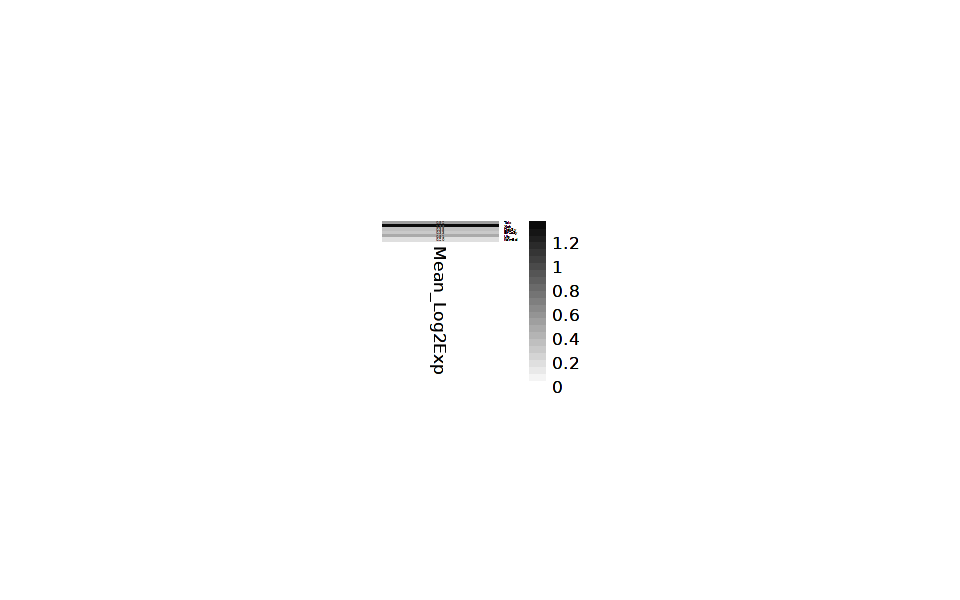

In [1090]:
options(repr.plot.width=8, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = T, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=FALSE)
ph

In [1091]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "DGE_Sex_pseudobulk_mean.pdf"), width=8, height=plot_height)

png 
  2

In [1092]:
tmp_markers_zscore <- t(apply(tmp_markers[gene_list,], 1, scale))
colnames(tmp_markers_zscore) <- paste0("zscore_", sample_names)
matrix <- tmp_markers_zscore

In [1093]:
paletteLength <- 50
myColor <- colorRampPalette(c("blue", "white", "red"))(paletteLength/2)
myBreaks <- c(seq(min(matrix), max(matrix), length.out=floor(paletteLength/2)))

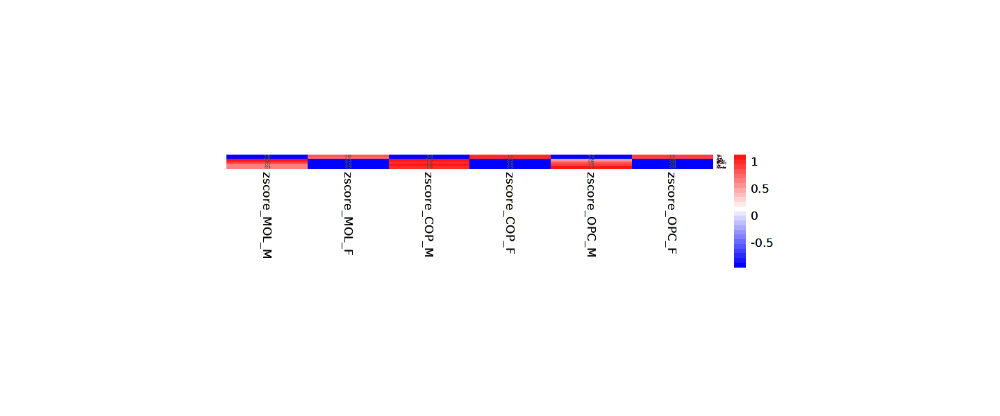

In [1094]:
options(repr.plot.width=12, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = T, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=FALSE)
ph

In [1095]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "DGE_Sex_pseudobulk_zscore.pdf"), width=8, height=plot_height)

png 
  2